## Import libraries

In [1]:
# Python libraries
import os
import sys
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
import tensorflow as tf
from sklearn.model_selection import train_test_split
from datetime import datetime
import time

# Plotting
import matplotlib.pyplot as plt

# To enable LaTeX and select a font
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": "Helvetica",
})

# Using ipynb import functions defined in other nb
sys.path.append("myfun/")
from ipynb.fs.defs.myfun_load_dataset import *
from ipynb.fs.full.myfun_model_nn import *
from ipynb.fs.defs.myfun_plot import *

2024-02-13 00:29:34.159014: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-13 00:29:34.159074: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-13 00:29:34.186873: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-13 00:29:34.254435: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-13 00:29:35.338648: W tensorflow/compiler/tf2

## Data Acquisition

In [2]:
# Load the dataset
par_dir = os.path.dirname(os.getcwd()) # parent dir
dir_name = par_dir + "/NN-interaction"

In [3]:
processed_flag = 'pre'
# load the data
_, dflist = load_dataset(dir_name, processed_flag)
dataset = dflist

print(f"In this dataset we have {np.sum([d.shape[0] for d in dataset])} scenes")

In this dataset we have 671 scenes


## Params

In [4]:
DOE =[1,1,1,1] #Design of experiment

In [5]:
v0 = 30
NUM_ITER = 500
LEARNING_RATE_v0 = 0.5
test = 0.33

plot_flag = True
flag_save = True

----------------------------------------------------------------------------------------------------
Analyzing 10 dfs. NN structure: 1-1-1-1
****************************************************************************************************
Analyzing 1/10 dfs.
In DataFrame n.1 we have 109 scenes.
    To train the model we use 73 scenes, the remaining 36 to test the model.

Training step. (73 scenes)
DataFrame n.1. Scene n.1/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [239.44,240.24]


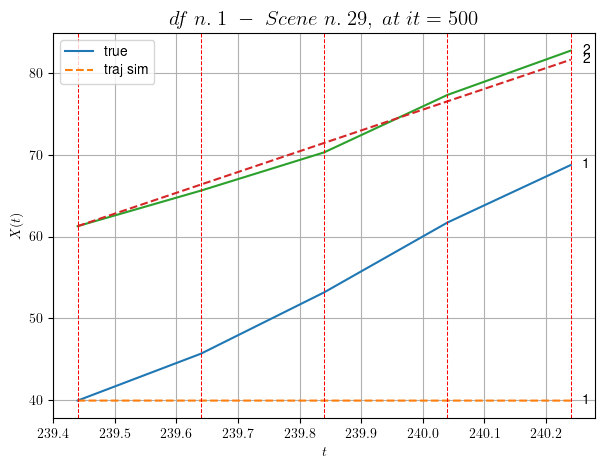

----------------------------------------------------------------------------------------------------
        For scene 1/73:
        * After LR finder: LR_NN=0.001 with mse=2.5672414006183035 at it=24
        * v0 = 25.426381424530113
        * MSE = 35.99176117549988
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [310.84,311.24]


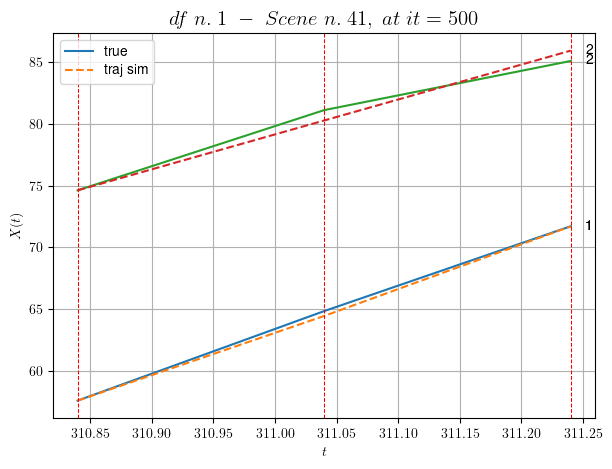

----------------------------------------------------------------------------------------------------
        For scene 2/73:
        * After LR finder: LR_NN=0.01 with mse=0.4924062931956249 at it=24
        * v0 = 28.339874463060305
        * MSE = 0.26161443311769106
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [52.84,53.84]


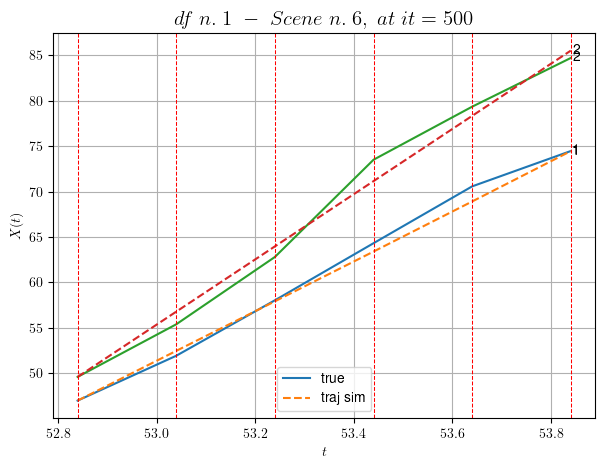

----------------------------------------------------------------------------------------------------
        For scene 3/73:
        * After LR finder: LR_NN=0.001 with mse=8.328159308569225 at it=24
        * v0 = 35.9128223540259
        * MSE = 1.1946052011275845
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [362.84,364.04]


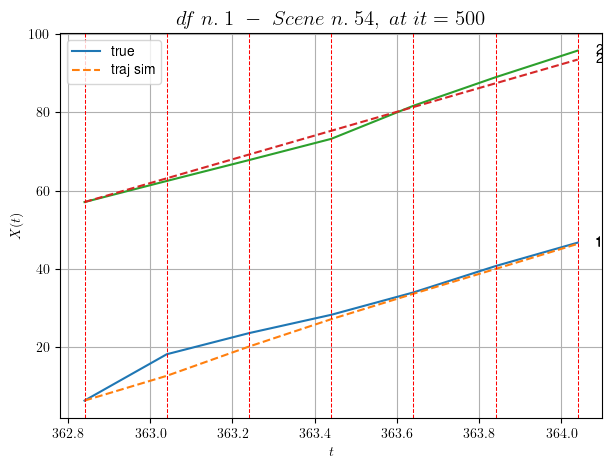

----------------------------------------------------------------------------------------------------
        For scene 4/73:
        * After LR finder: LR_NN=0.005 with mse=3.9881914524608524 at it=24
        * v0 = 30.313976428340936
        * MSE = 3.8159712351889006
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [444.24,445.24]


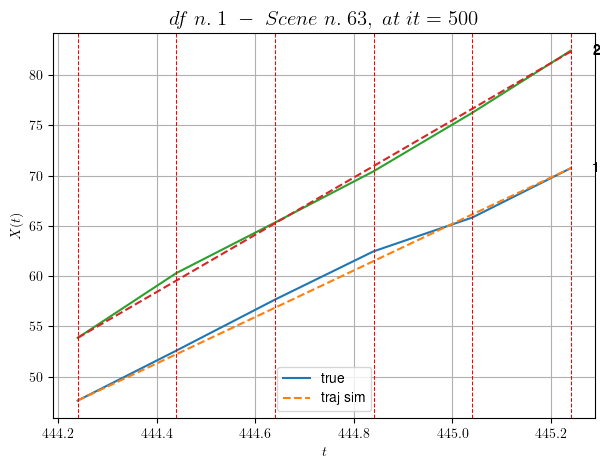

----------------------------------------------------------------------------------------------------
        For scene 5/73:
        * After LR finder: LR_NN=0.001 with mse=0.7580525485259525 at it=24
        * v0 = 28.494973095574913
        * MSE = 0.23530987490834016
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [307.24,307.64]


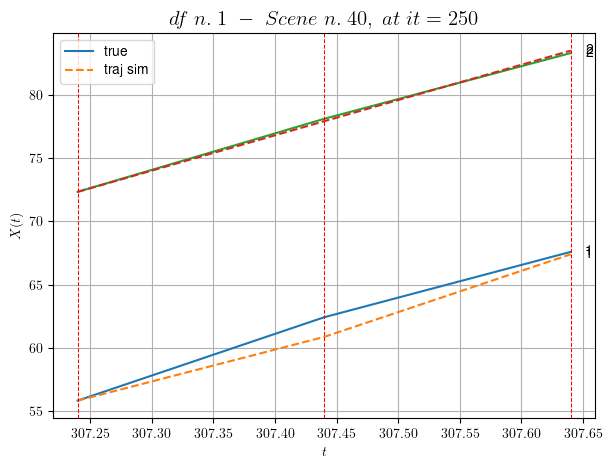

----------------------------------------------------------------------------------------------------
        For scene 6/73:
        * After LR finder: LR_NN=0.01 with mse=0.7171263046969871 at it=24
        * v0 = 27.87317010381038
        * MSE = 0.4178647036497353
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [294.64,295.24]


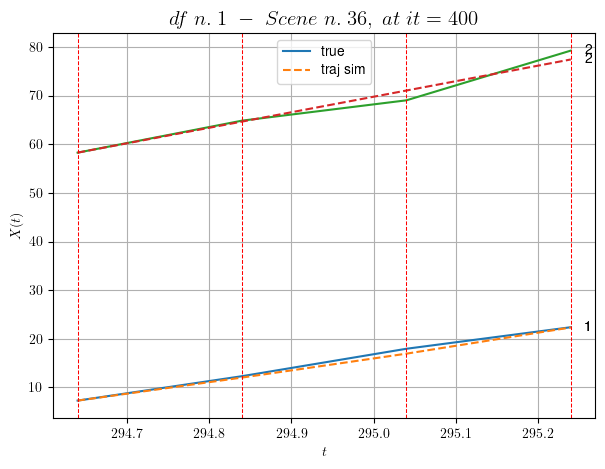

----------------------------------------------------------------------------------------------------
        For scene 7/73:
        * After LR finder: LR_NN=0.01 with mse=1.6184041460162586 at it=24
        * v0 = 31.912591416728382
        * MSE = 1.057518144593082
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [130.64,131.44]


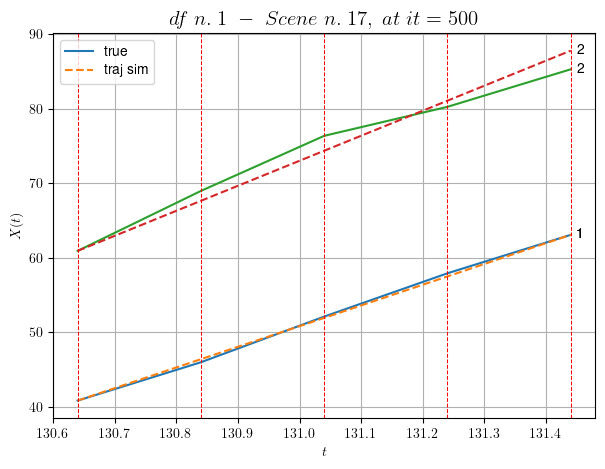

----------------------------------------------------------------------------------------------------
        For scene 8/73:
        * After LR finder: LR_NN=0.001 with mse=1.8790809713952452 at it=24
        * v0 = 33.61924590429472
        * MSE = 1.1439077214485287
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [496.84,497.64]


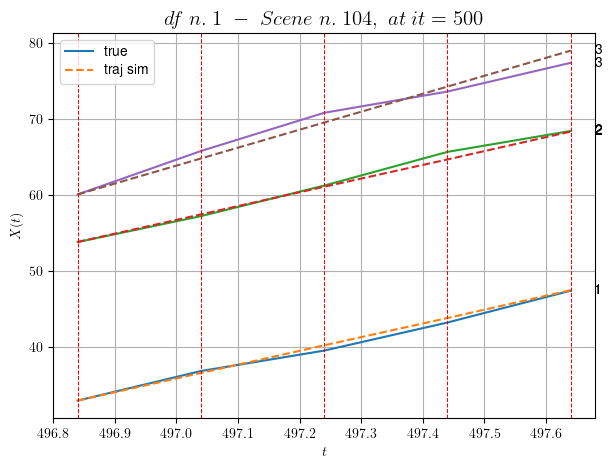

----------------------------------------------------------------------------------------------------
        For scene 9/73:
        * After LR finder: LR_NN=0.005 with mse=4.531625432789204 at it=24
        * v0 = 23.671022130117702
        * MSE = 0.5058776583358893
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [291.64,292.64]


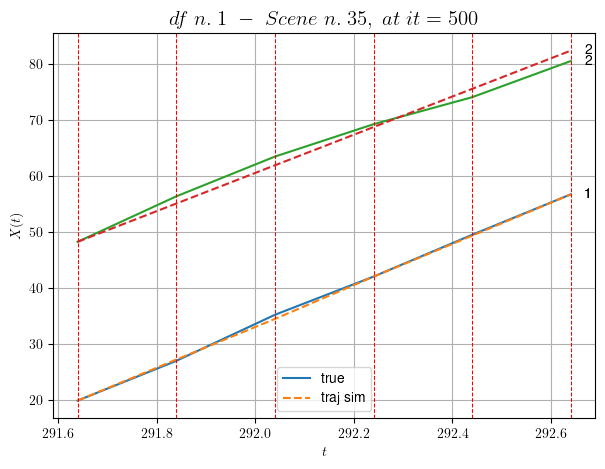

----------------------------------------------------------------------------------------------------
        For scene 10/73:
        * After LR finder: LR_NN=0.005 with mse=2.7436063979256797 at it=24
        * v0 = 34.11909568874962
        * MSE = 0.783688180555737
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [472.24,473.24]


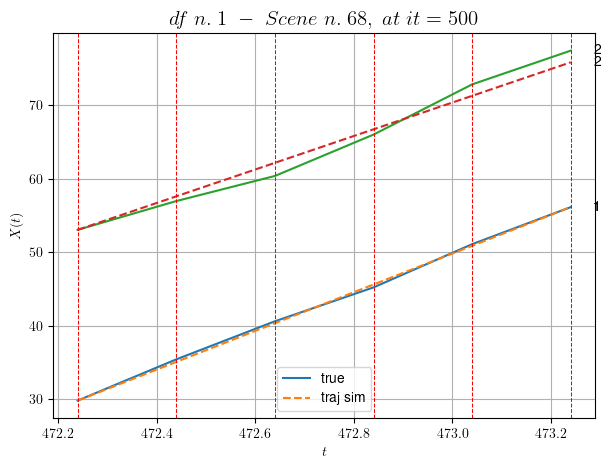

----------------------------------------------------------------------------------------------------
        For scene 11/73:
        * After LR finder: LR_NN=5e-05 with mse=8.503974398729751 at it=24
        * v0 = 22.764702156056323
        * MSE = 0.785522425876012
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [56.84,57.64]


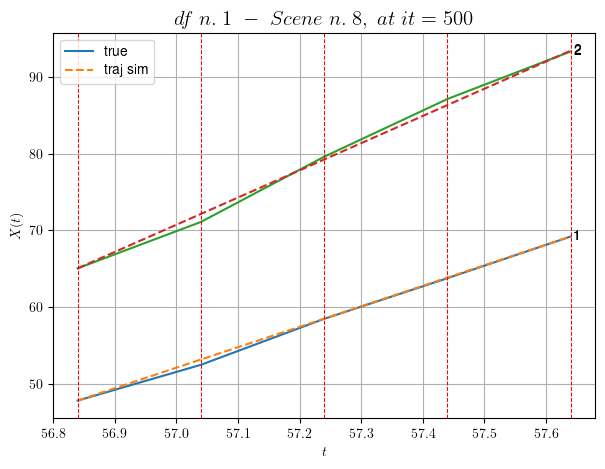

----------------------------------------------------------------------------------------------------
        For scene 12/73:
        * After LR finder: LR_NN=0.001 with mse=14.322263476928875 at it=24
        * v0 = 35.496956490177844
        * MSE = 0.23507162366342343
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [320.44,321.24]


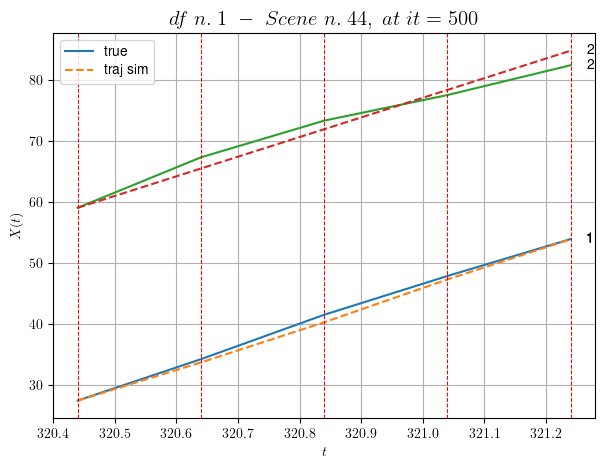

----------------------------------------------------------------------------------------------------
        For scene 13/73:
        * After LR finder: LR_NN=0.01 with mse=1.2507377404182445 at it=24
        * v0 = 32.19336724924304
        * MSE = 1.1421236369240801
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [463.04,463.64]


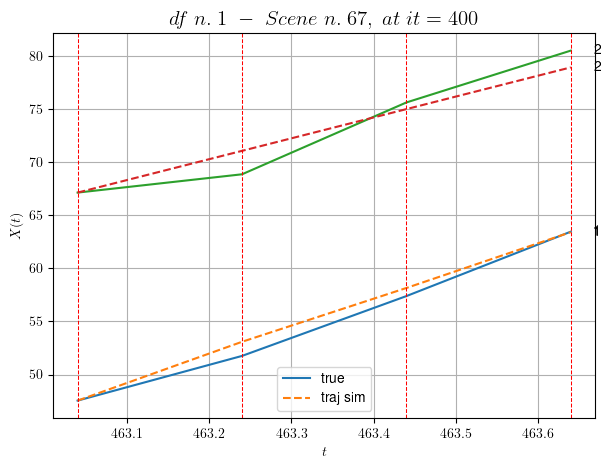

----------------------------------------------------------------------------------------------------
        For scene 14/73:
        * After LR finder: LR_NN=0.005 with mse=6.835103041115731 at it=24
        * v0 = 19.66200606094634
        * MSE = 1.1835187984103028
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [529.64,530.64]


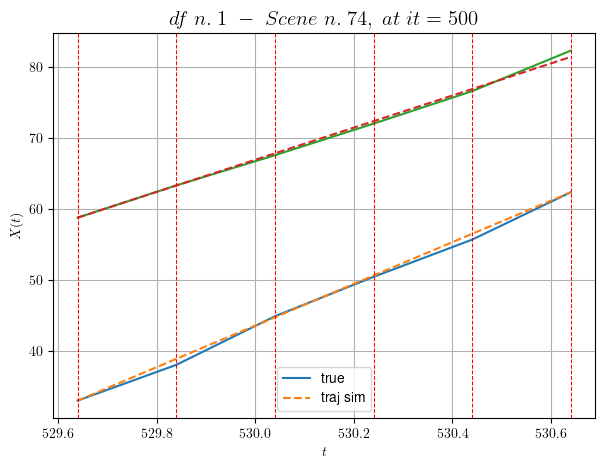

----------------------------------------------------------------------------------------------------
        For scene 15/73:
        * After LR finder: LR_NN=0.001 with mse=9.756612258819855 at it=24
        * v0 = 22.628998285036243
        * MSE = 0.20799653595140538
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [230.04,230.64]


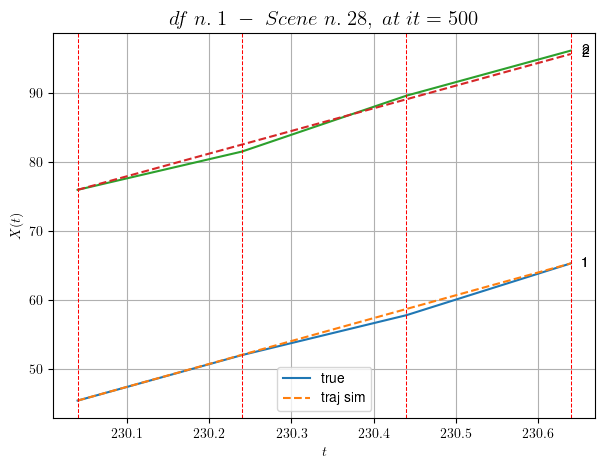

----------------------------------------------------------------------------------------------------
        For scene 16/73:
        * After LR finder: LR_NN=0.0005 with mse=13.883557014780742 at it=24
        * v0 = 32.80710231491528
        * MSE = 0.2931246706124804
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [146.24,146.64]


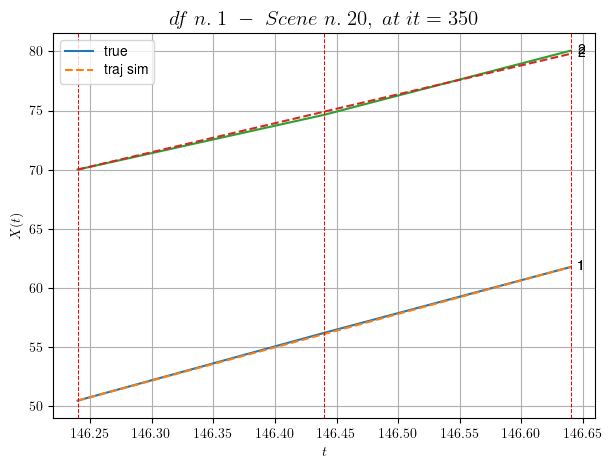

----------------------------------------------------------------------------------------------------
        For scene 17/73:
        * After LR finder: LR_NN=0.005 with mse=0.94323495313035 at it=24
        * v0 = 24.481033392773433
        * MSE = 0.022991732824860237
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [164.04,164.64]


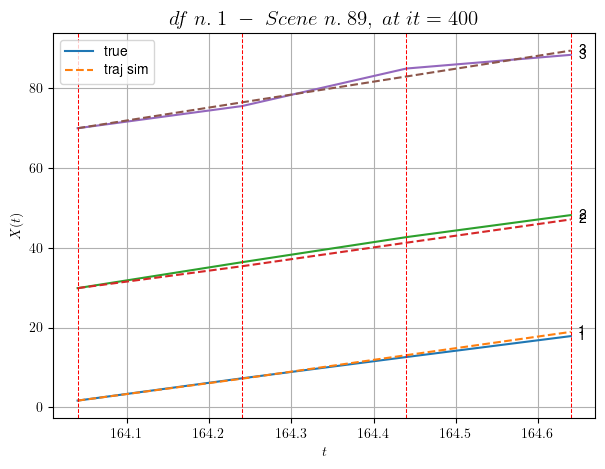

----------------------------------------------------------------------------------------------------
        For scene 18/73:
        * After LR finder: LR_NN=0.01 with mse=1.1826489411098813 at it=24
        * v0 = 32.43284780828867
        * MSE = 0.9564794819870229
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [262.64,263.64]


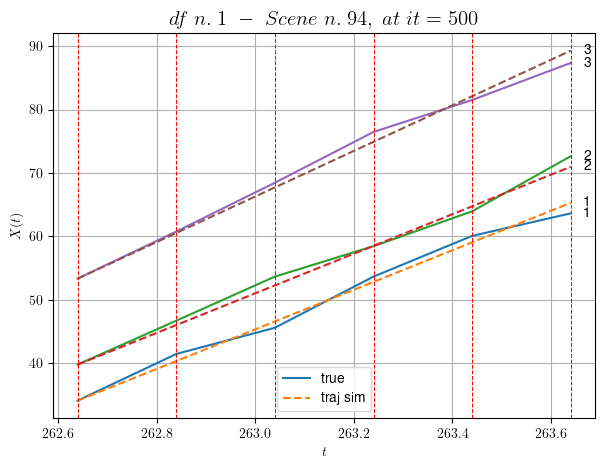

----------------------------------------------------------------------------------------------------
        For scene 19/73:
        * After LR finder: LR_NN=0.0005 with mse=12.948520623520364 at it=24
        * v0 = 35.931097427464636
        * MSE = 1.0620908493766663
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [209.64,210.24]


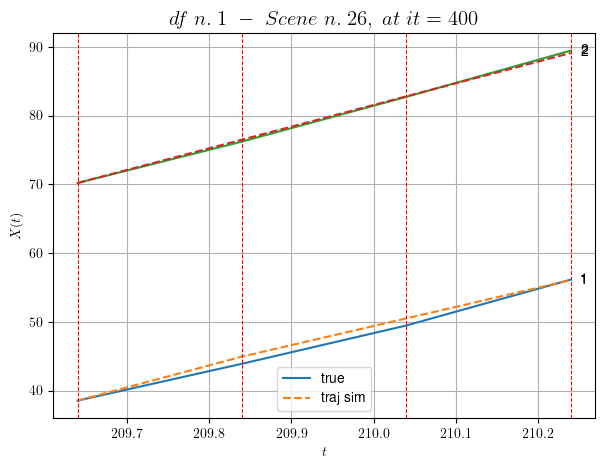

----------------------------------------------------------------------------------------------------
        For scene 20/73:
        * After LR finder: LR_NN=0.01 with mse=57.49917978451626 at it=24
        * v0 = 31.507071370302537
        * MSE = 0.29150568209570915
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [60.04,60.84]


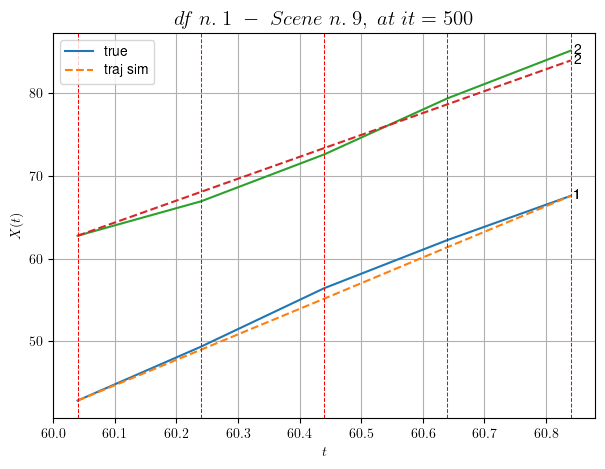

----------------------------------------------------------------------------------------------------
        For scene 21/73:
        * After LR finder: LR_NN=0.001 with mse=1.5495513642989978 at it=24
        * v0 = 26.521619591085848
        * MSE = 0.5933302547091547
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [447.44,448.04]


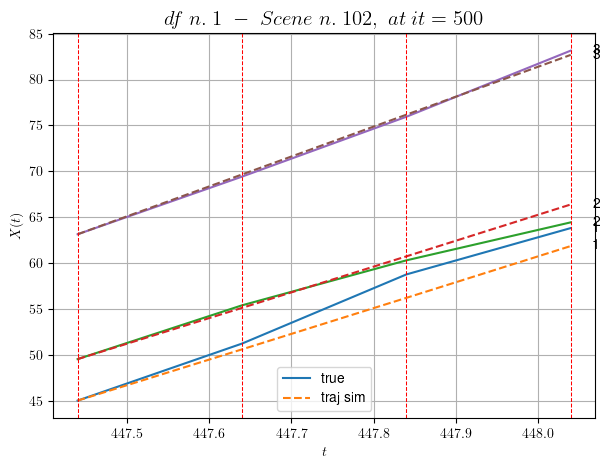

----------------------------------------------------------------------------------------------------
        For scene 22/73:
        * After LR finder: LR_NN=0.001 with mse=14.640992355496872 at it=24
        * v0 = 32.584860045177464
        * MSE = 1.2592213678404867
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [351.64,352.24]


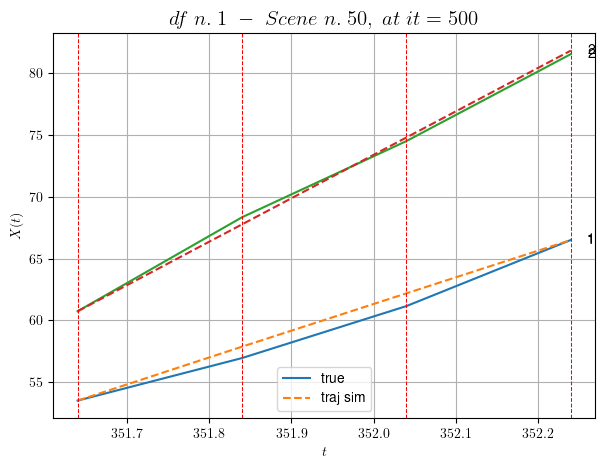

----------------------------------------------------------------------------------------------------
        For scene 23/73:
        * After LR finder: LR_NN=0.001 with mse=2.019955327440044 at it=24
        * v0 = 35.128237730719775
        * MSE = 0.2996416237801333
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [109.24,109.84]


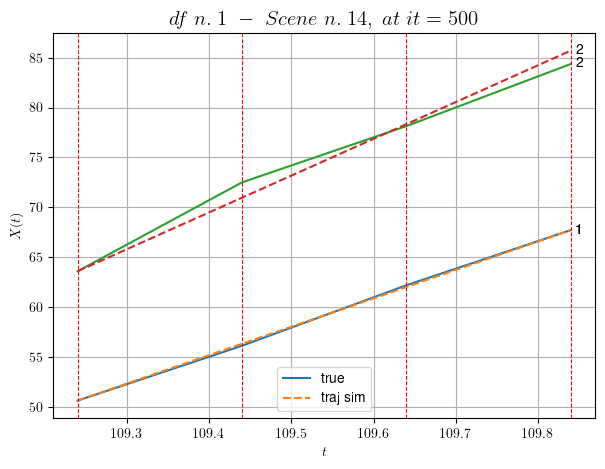

----------------------------------------------------------------------------------------------------
        For scene 24/73:
        * After LR finder: LR_NN=0.0005 with mse=2.9367753119068394 at it=24
        * v0 = 36.87036026795266
        * MSE = 0.4596517571971882
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/73
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [571.04,572.64]


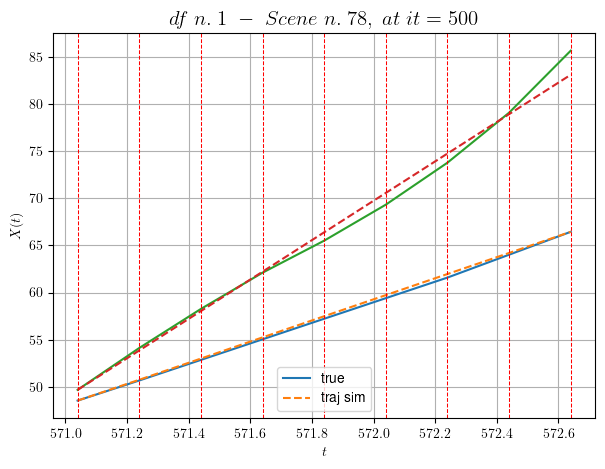

----------------------------------------------------------------------------------------------------
        For scene 25/73:
        * After LR finder: LR_NN=0.005 with mse=37.015808926740206 at it=24
        * v0 = 20.877122500554435
        * MSE = 0.5717489772919574
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [200.44,201.24]


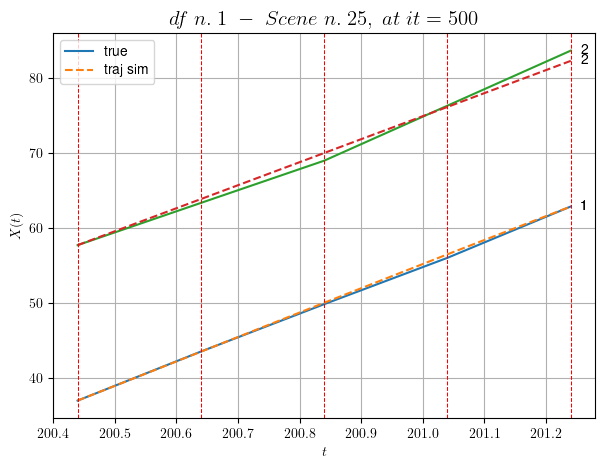

----------------------------------------------------------------------------------------------------
        For scene 26/73:
        * After LR finder: LR_NN=0.005 with mse=0.5225998246769723 at it=24
        * v0 = 30.71027389121789
        * MSE = 0.3450603231450966
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [37.44,38.24]


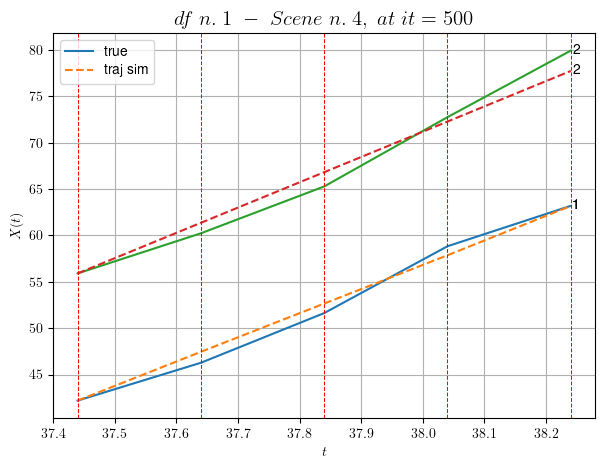

----------------------------------------------------------------------------------------------------
        For scene 27/73:
        * After LR finder: LR_NN=0.001 with mse=1.4476998056748667 at it=24
        * v0 = 27.29525416582105
        * MSE = 1.0976590534729007
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [140.64,141.24]


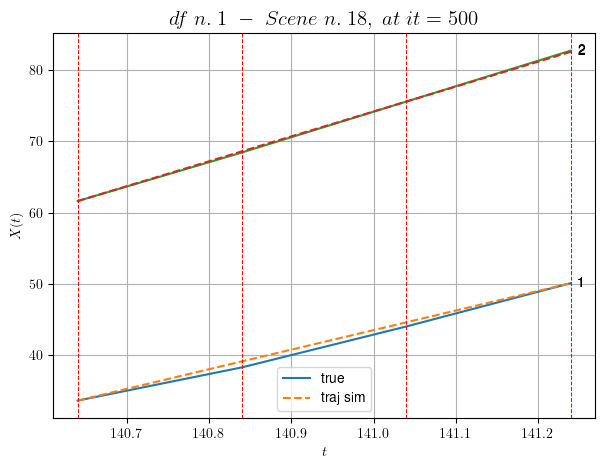

----------------------------------------------------------------------------------------------------
        For scene 28/73:
        * After LR finder: LR_NN=0.0005 with mse=2.0295726302109465 at it=24
        * v0 = 34.928349100204755
        * MSE = 0.13715732739718145
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [301.44,302.44]


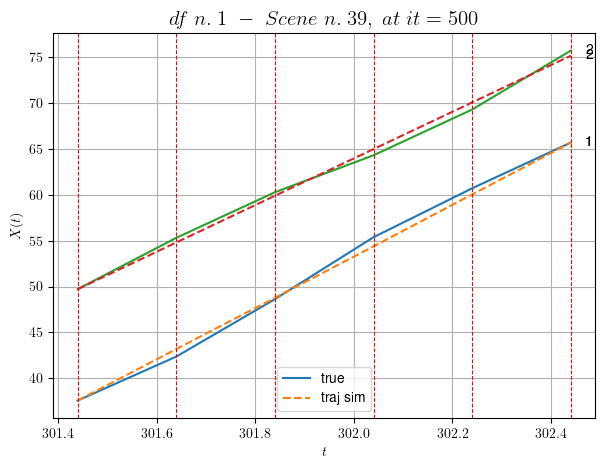

----------------------------------------------------------------------------------------------------
        For scene 29/73:
        * After LR finder: LR_NN=0.001 with mse=4.312096127325788 at it=24
        * v0 = 25.446081747008822
        * MSE = 0.3237950051279168
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [131.64,132.04]


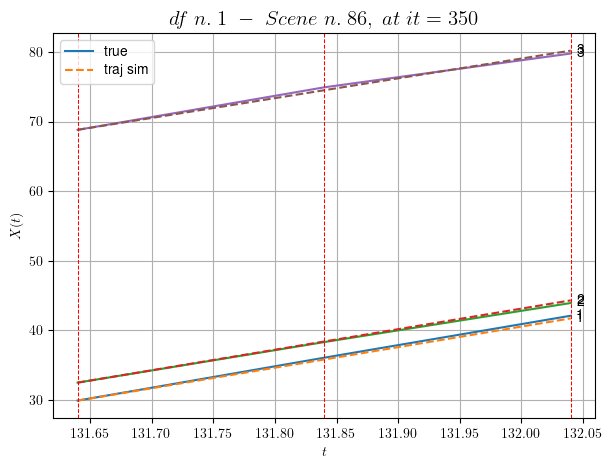

----------------------------------------------------------------------------------------------------
        For scene 30/73:
        * After LR finder: LR_NN=0.0005 with mse=14.87899032974179 at it=24
        * v0 = 28.44290395364186
        * MSE = 0.0785081051376652
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [54.84,55.24]


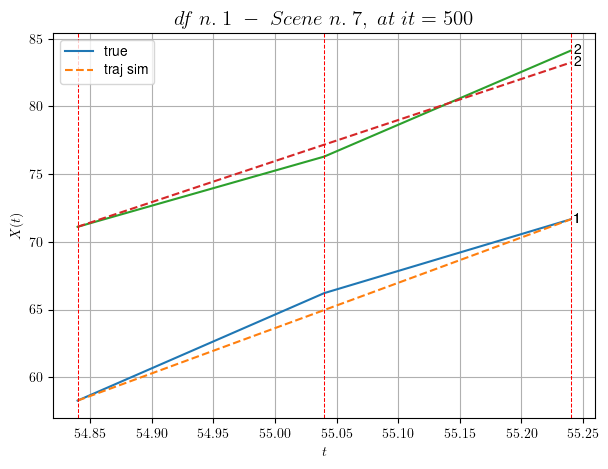

----------------------------------------------------------------------------------------------------
        For scene 31/73:
        * After LR finder: LR_NN=0.0001 with mse=0.3114765368834976 at it=24
        * v0 = 30.333444658289434
        * MSE = 0.5183189984868566
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [499.04,499.44]


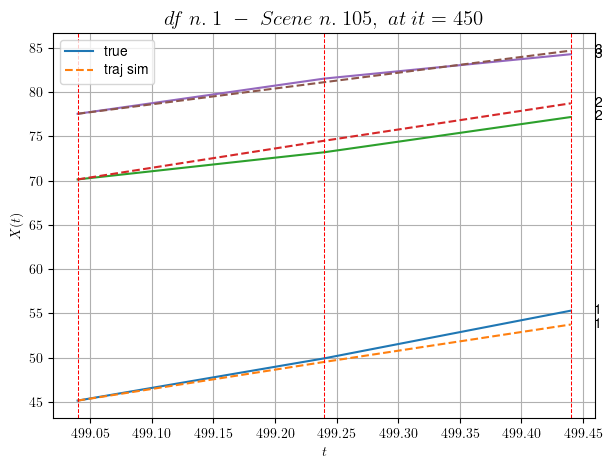

----------------------------------------------------------------------------------------------------
        For scene 32/73:
        * After LR finder: LR_NN=0.005 with mse=4.2899158633597665 at it=24
        * v0 = 17.832165951474558
        * MSE = 0.7786730940506651
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [325.24,326.44]


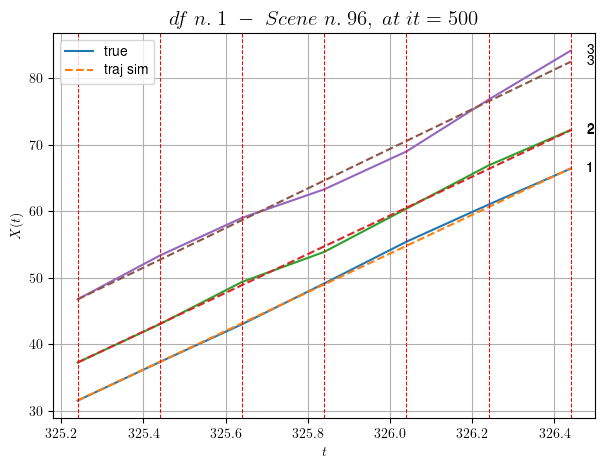

----------------------------------------------------------------------------------------------------
        For scene 33/73:
        * After LR finder: LR_NN=0.001 with mse=17.68494694045503 at it=24
        * v0 = 29.804033810067608
        * MSE = 0.45094315664753065
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [240.64,241.04]


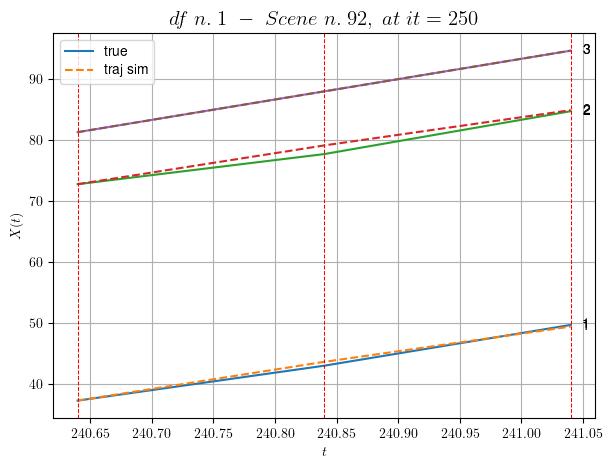

----------------------------------------------------------------------------------------------------
        For scene 34/73:
        * After LR finder: LR_NN=0.005 with mse=0.5431385826666991 at it=24
        * v0 = 33.344048426807795
        * MSE = 0.26658162688872983
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [380.24,380.64]


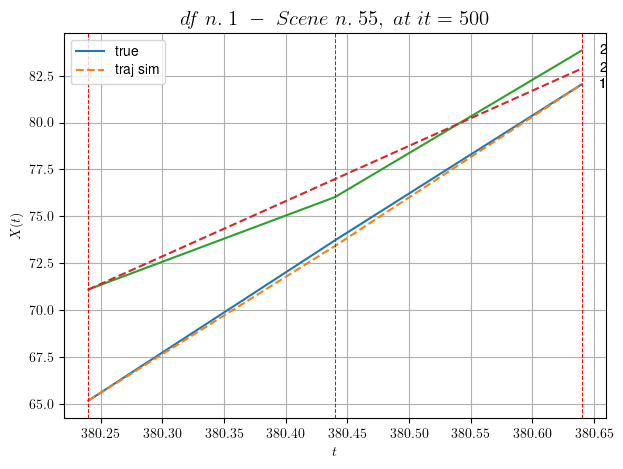

----------------------------------------------------------------------------------------------------
        For scene 35/73:
        * After LR finder: LR_NN=0.01 with mse=0.3136029556795087 at it=24
        * v0 = 29.441226265332435
        * MSE = 0.323859062650335
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [352.84,353.84]


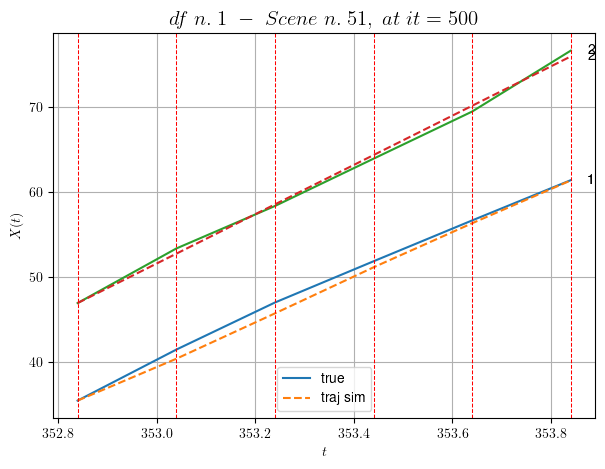

----------------------------------------------------------------------------------------------------
        For scene 36/73:
        * After LR finder: LR_NN=0.01 with mse=0.5023951730723086 at it=24
        * v0 = 29.028563577794568
        * MSE = 0.31557218124304376
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.37/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [386.64,387.44]


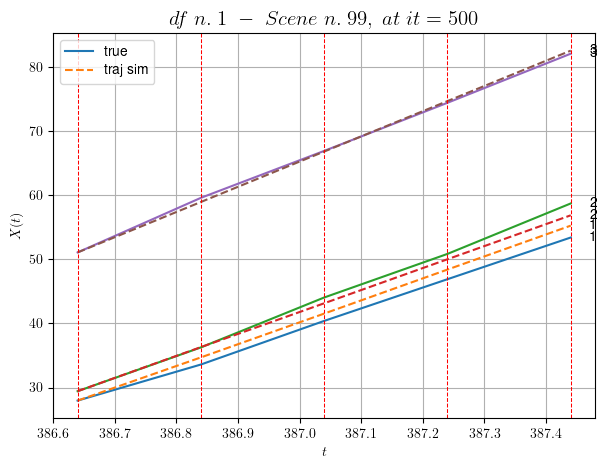

----------------------------------------------------------------------------------------------------
        For scene 37/73:
        * After LR finder: LR_NN=0.001 with mse=7.470003769681995 at it=24
        * v0 = 39.34610016762286
        * MSE = 0.9267293441657279
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.38/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [335.24,335.84]


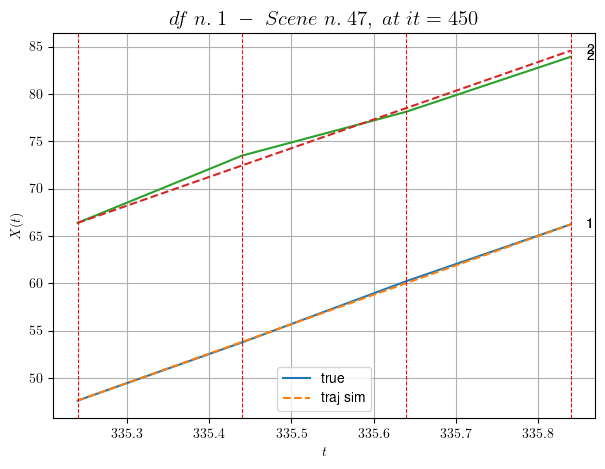

----------------------------------------------------------------------------------------------------
        For scene 38/73:
        * After LR finder: LR_NN=0.0001 with mse=0.188339538580633 at it=24
        * v0 = 30.337239387419242
        * MSE = 0.21070479753361196
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.39/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [72.44,73.44]


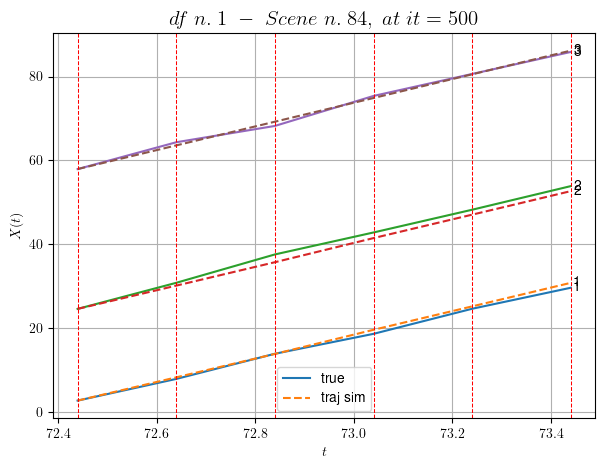

----------------------------------------------------------------------------------------------------
        For scene 39/73:
        * After LR finder: LR_NN=0.005 with mse=1.175152752109175 at it=24
        * v0 = 28.250920573908594
        * MSE = 0.7327581266778515
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.40/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [431.04,432.24]


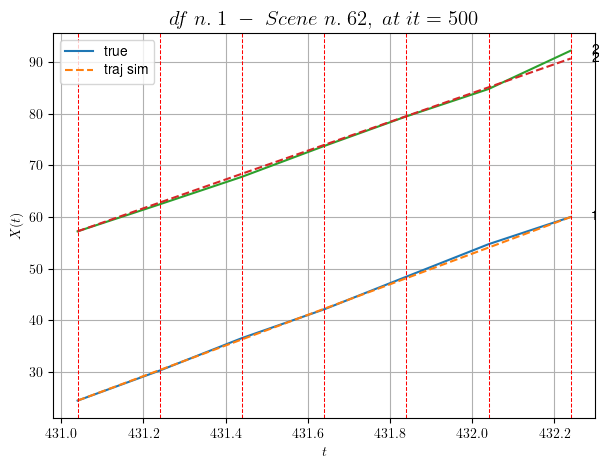

----------------------------------------------------------------------------------------------------
        For scene 40/73:
        * After LR finder: LR_NN=5e-05 with mse=1.0739145002748893 at it=24
        * v0 = 27.91482717316305
        * MSE = 0.2540839597953666
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.41/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [500.64,501.04]


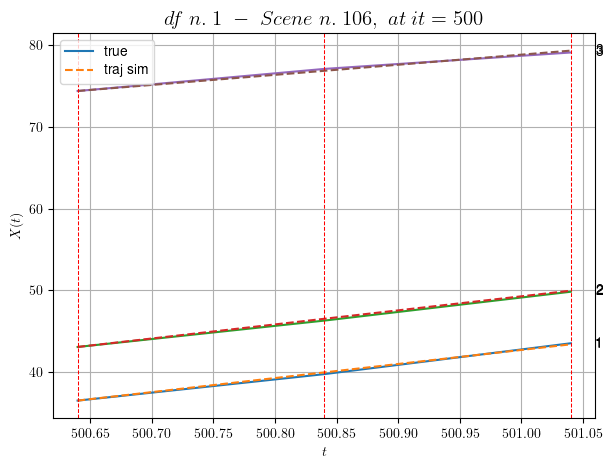

----------------------------------------------------------------------------------------------------
        For scene 41/73:
        * After LR finder: LR_NN=0.001 with mse=12.506569042034764 at it=24
        * v0 = 12.361370218692302
        * MSE = 0.02599318040517538
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.42/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [446.24,446.84]


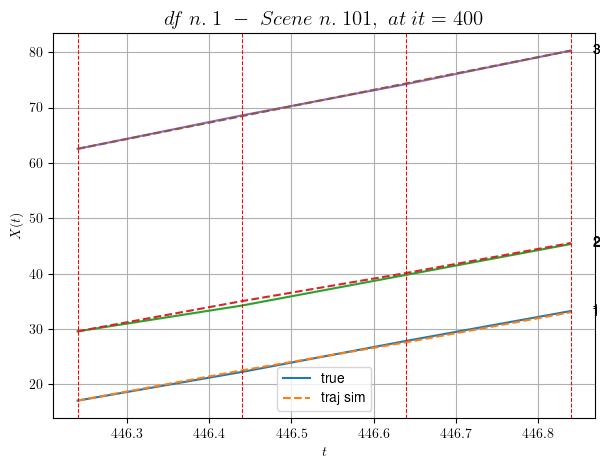

----------------------------------------------------------------------------------------------------
        For scene 42/73:
        * After LR finder: LR_NN=0.01 with mse=0.09992799869869677 at it=24
        * v0 = 29.554429783834713
        * MSE = 0.08380511807674751
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.43/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [316.44,317.04]


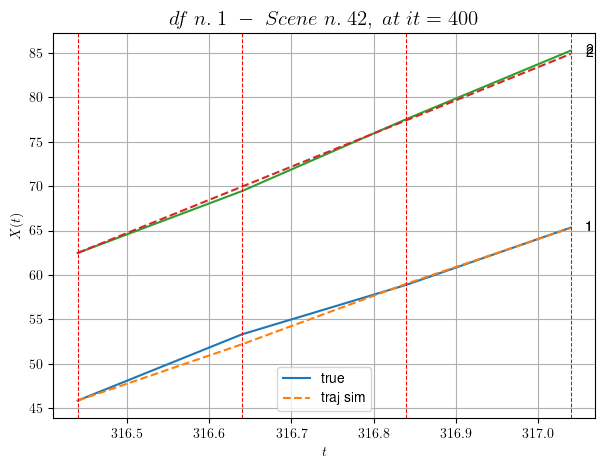

----------------------------------------------------------------------------------------------------
        For scene 43/73:
        * After LR finder: LR_NN=0.005 with mse=4.321132765894353 at it=24
        * v0 = 37.33434121772217
        * MSE = 0.20972738917157052
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.44/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [403.64,404.64]


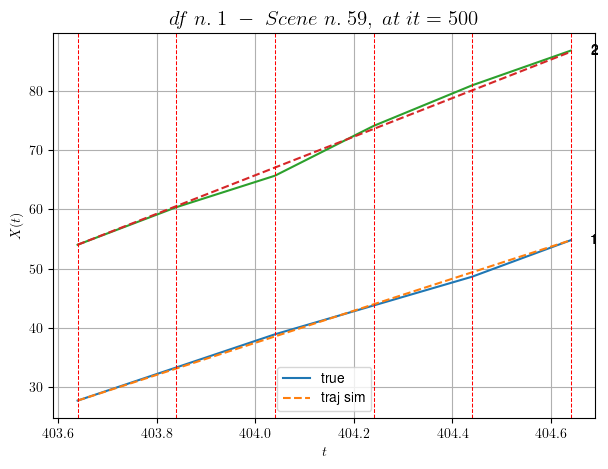

----------------------------------------------------------------------------------------------------
        For scene 44/73:
        * After LR finder: LR_NN=0.0001 with mse=1.9149634099635475 at it=24
        * v0 = 32.579782853264525
        * MSE = 0.30927887594480913
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.45/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [349.64,350.44]


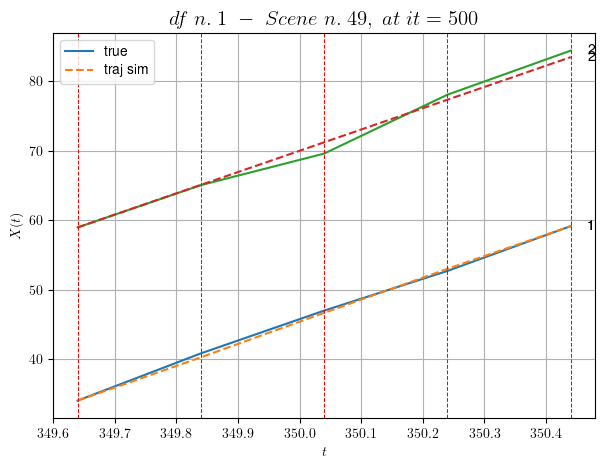

----------------------------------------------------------------------------------------------------
        For scene 45/73:
        * After LR finder: LR_NN=0.005 with mse=0.5833189232013829 at it=24
        * v0 = 30.663808885196822
        * MSE = 0.4554333823818888
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.46/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [314.84,315.64]


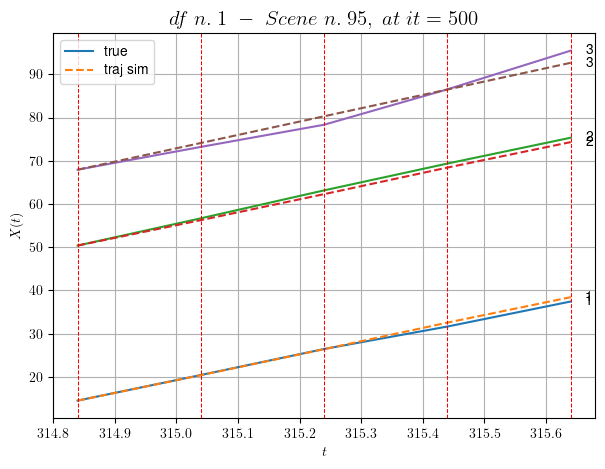

----------------------------------------------------------------------------------------------------
        For scene 46/73:
        * After LR finder: LR_NN=0.01 with mse=1.373460454625963 at it=24
        * v0 = 30.926247858926708
        * MSE = 1.1466282546968118
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.47/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [402.04,402.84]


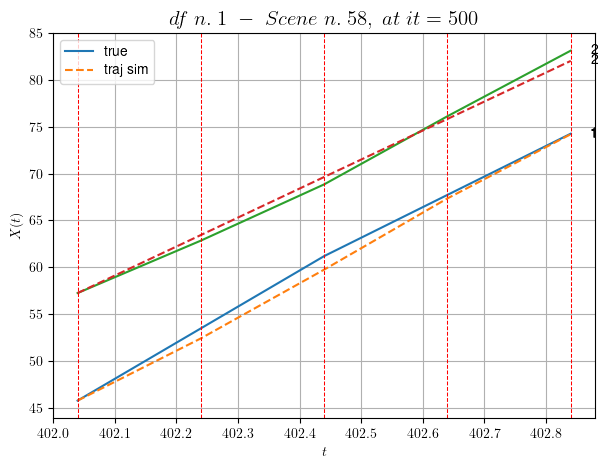

----------------------------------------------------------------------------------------------------
        For scene 47/73:
        * After LR finder: LR_NN=0.01 with mse=0.6407327421013657 at it=24
        * v0 = 31.006759212236545
        * MSE = 0.40099635617513507
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.48/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [561.44,561.84]


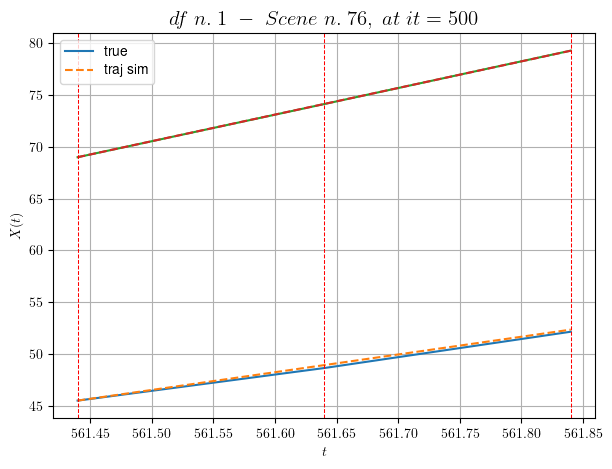

----------------------------------------------------------------------------------------------------
        For scene 48/73:
        * After LR finder: LR_NN=5e-05 with mse=0.6070722902065065 at it=24
        * v0 = 25.727722160463763
        * MSE = 0.0201822765103219
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.49/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [271.04,271.64]


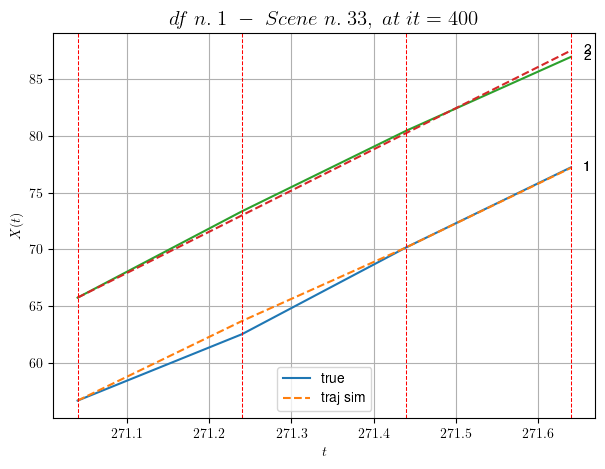

----------------------------------------------------------------------------------------------------
        For scene 49/73:
        * After LR finder: LR_NN=0.005 with mse=2.740654777669438 at it=24
        * v0 = 36.298884656917686
        * MSE = 0.22903658900965856
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.50/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [573.84,574.44]


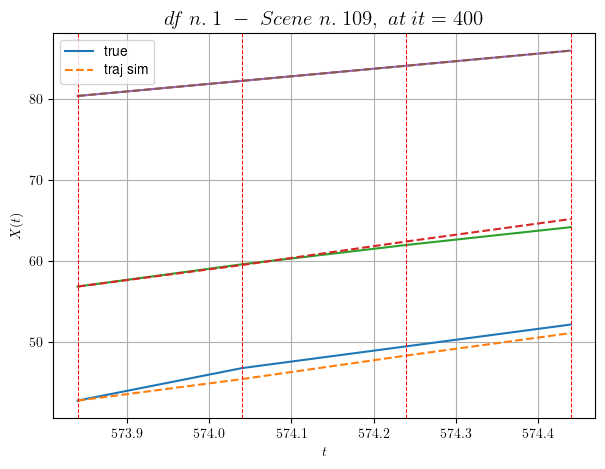

----------------------------------------------------------------------------------------------------
        For scene 50/73:
        * After LR finder: LR_NN=0.01 with mse=20.396010957329747 at it=24
        * v0 = 9.338746310354574
        * MSE = 0.45486807717448396
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.51/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [411.64,412.64]


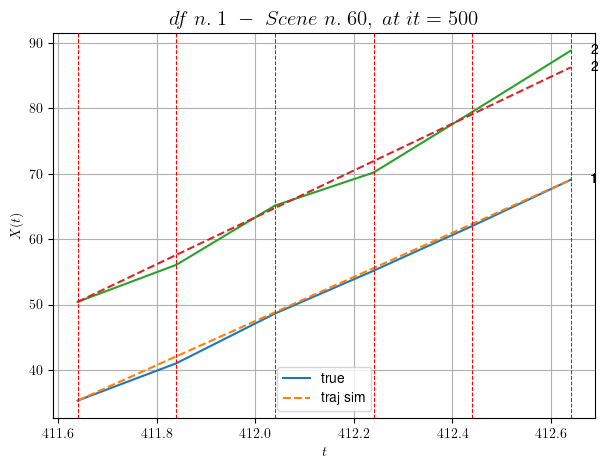

----------------------------------------------------------------------------------------------------
        For scene 51/73:
        * After LR finder: LR_NN=0.0005 with mse=9.094296684221343 at it=24
        * v0 = 35.852941117113666
        * MSE = 1.1282838805125823
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.52/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [454.24,454.64]


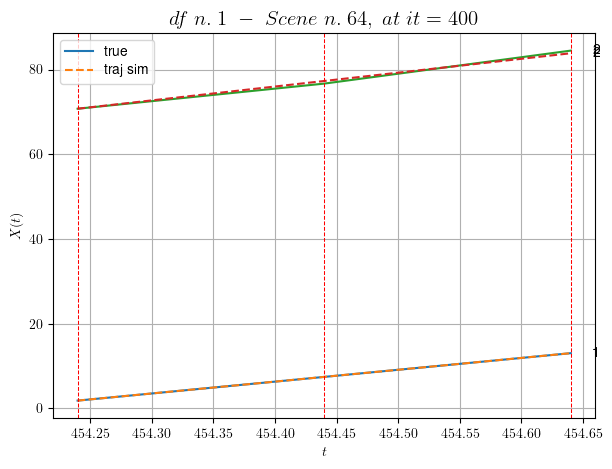

----------------------------------------------------------------------------------------------------
        For scene 52/73:
        * After LR finder: LR_NN=0.0001 with mse=0.4982892277094519 at it=24
        * v0 = 32.76709592908923
        * MSE = 0.12846004493641835
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.53/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [502.24,503.04]


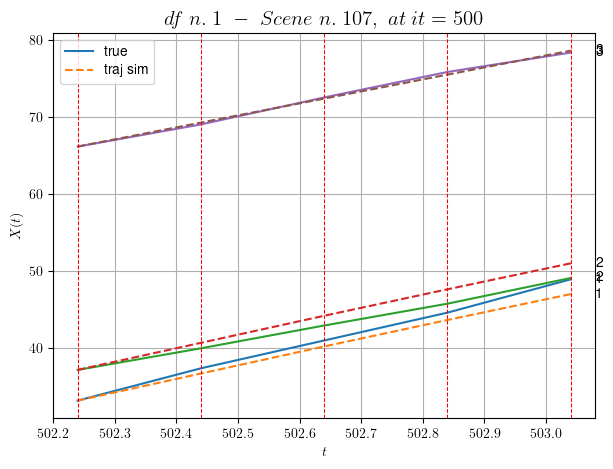

----------------------------------------------------------------------------------------------------
        For scene 53/73:
        * After LR finder: LR_NN=0.01 with mse=17.48985004861939 at it=24
        * v0 = 15.581016722933809
        * MSE = 1.0098969642466227
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.54/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [298.04,298.84]


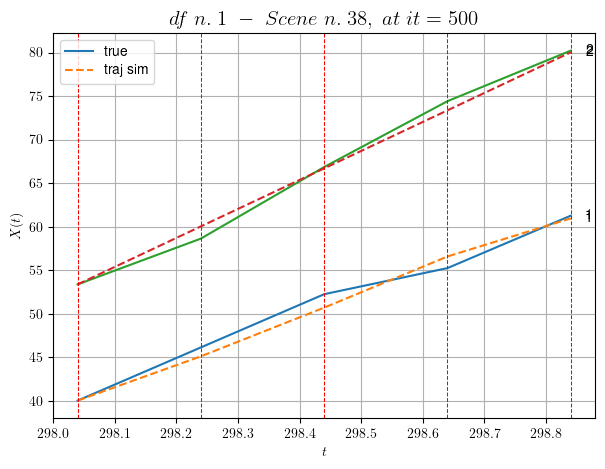

----------------------------------------------------------------------------------------------------
        For scene 54/73:
        * After LR finder: LR_NN=0.01 with mse=2.8097305453014725 at it=24
        * v0 = 33.34266245904782
        * MSE = 0.8437479034013855
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.55/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [249.84,250.44]


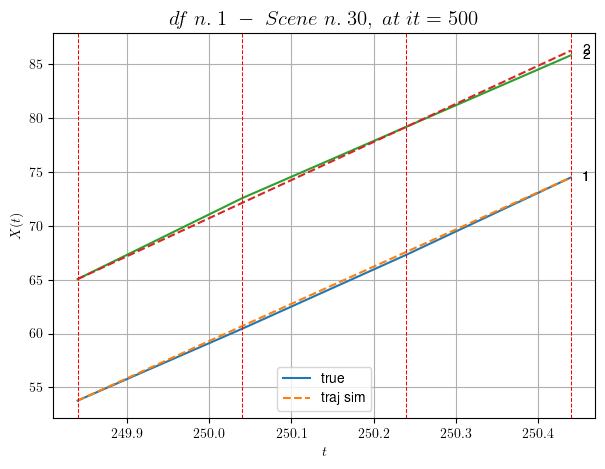

----------------------------------------------------------------------------------------------------
        For scene 55/73:
        * After LR finder: LR_NN=0.0005 with mse=1.8710358287211075 at it=24
        * v0 = 35.36623656084933
        * MSE = 0.058239575409614365
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.56/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [363.44,364.04]


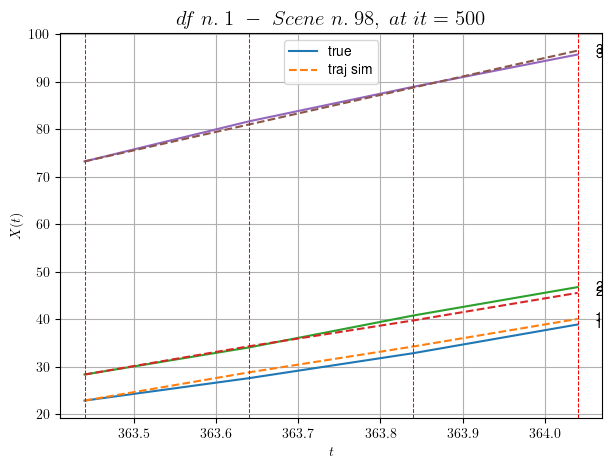

----------------------------------------------------------------------------------------------------
        For scene 56/73:
        * After LR finder: LR_NN=0.01 with mse=3.9723589297910578 at it=24
        * v0 = 38.92349444301338
        * MSE = 0.7131084189701972
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.57/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [16.44,16.84]


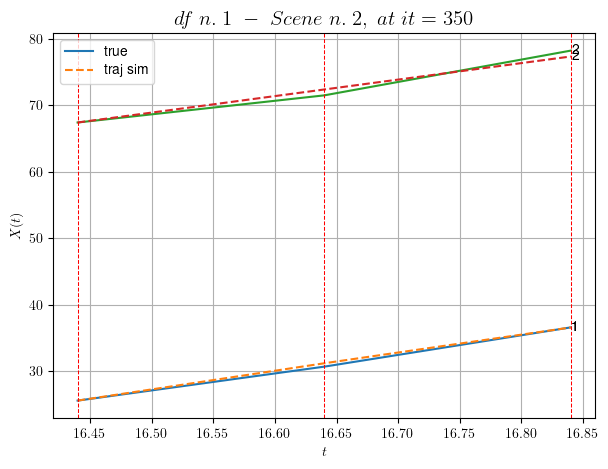

----------------------------------------------------------------------------------------------------
        For scene 57/73:
        * After LR finder: LR_NN=0.005 with mse=0.8990668279755722 at it=24
        * v0 = 24.819169927141726
        * MSE = 0.28330900364331146
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.58/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [361.24,361.64]


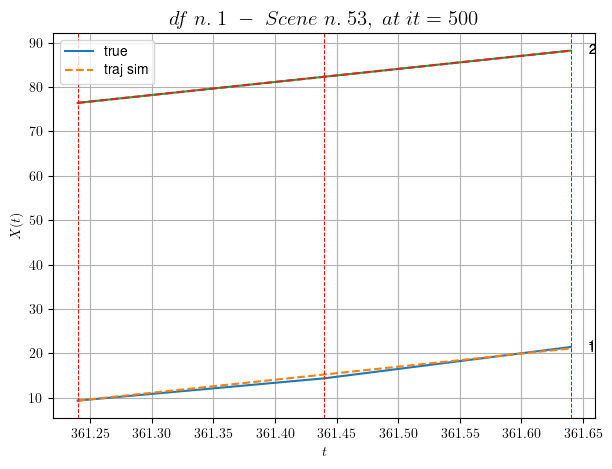

----------------------------------------------------------------------------------------------------
        For scene 58/73:
        * After LR finder: LR_NN=1e-05 with mse=0.1492527578644617 at it=24
        * v0 = 29.45386090862075
        * MSE = 0.13937403990512273
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.59/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [193.24,193.64]


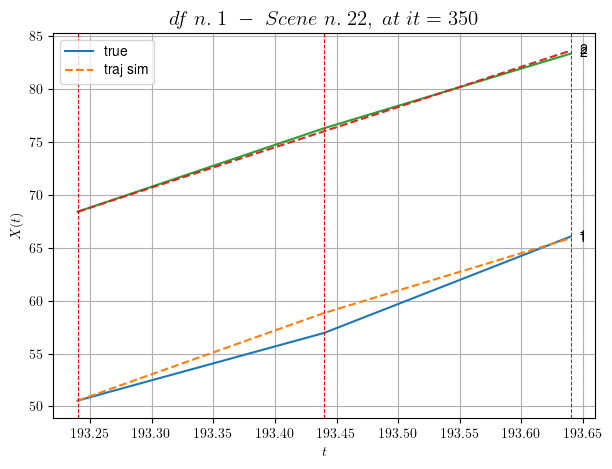

----------------------------------------------------------------------------------------------------
        For scene 59/73:
        * After LR finder: LR_NN=0.005 with mse=2.773613344628424 at it=24
        * v0 = 38.08399924109427
        * MSE = 0.6249983256149018
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.60/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [33.44,34.04]


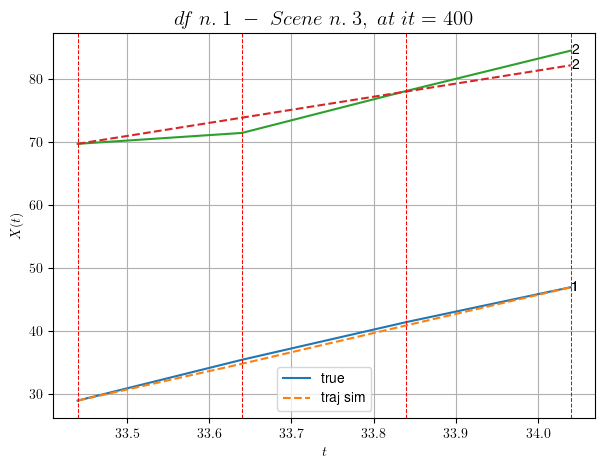

----------------------------------------------------------------------------------------------------
        For scene 60/73:
        * After LR finder: LR_NN=0.005 with mse=5.32297741521559 at it=24
        * v0 = 20.73562399714918
        * MSE = 1.3125580030575088
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.61/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [199.44,199.84]


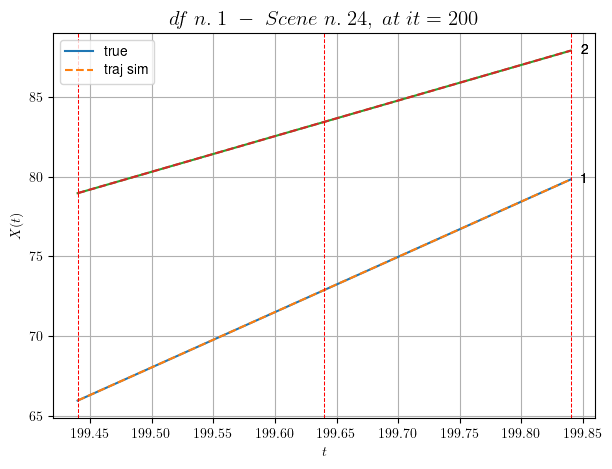

----------------------------------------------------------------------------------------------------
        For scene 61/73:
        * After LR finder: LR_NN=0.005 with mse=1.923812396153854 at it=24
        * v0 = 22.403293039969412
        * MSE = 3.340078780658737e-06
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.62/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [161.64,162.04]


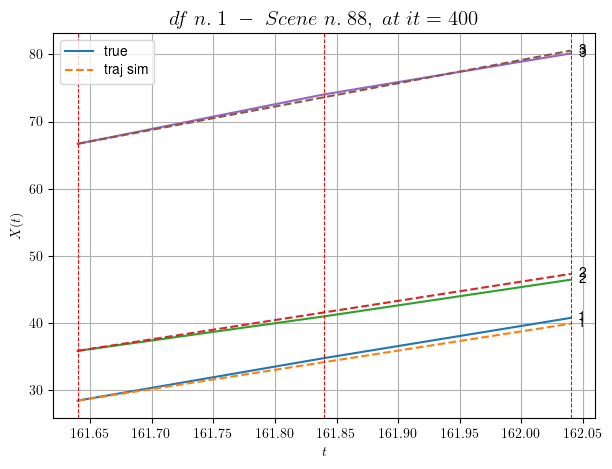

----------------------------------------------------------------------------------------------------
        For scene 62/73:
        * After LR finder: LR_NN=0.0005 with mse=13.75933816965624 at it=24
        * v0 = 34.711809120615214
        * MSE = 0.27989092119200604
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.63/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [431.84,432.24]


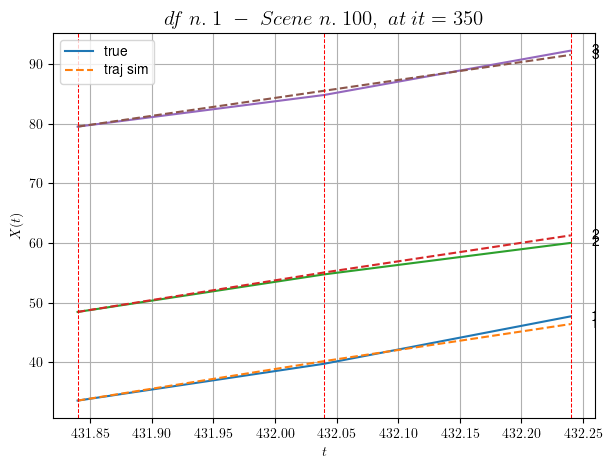

----------------------------------------------------------------------------------------------------
        For scene 63/73:
        * After LR finder: LR_NN=0.01 with mse=0.5338458413273705 at it=24
        * v0 = 30.084161028056336
        * MSE = 0.5067979303540768
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.64/73
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [531.64,533.24]


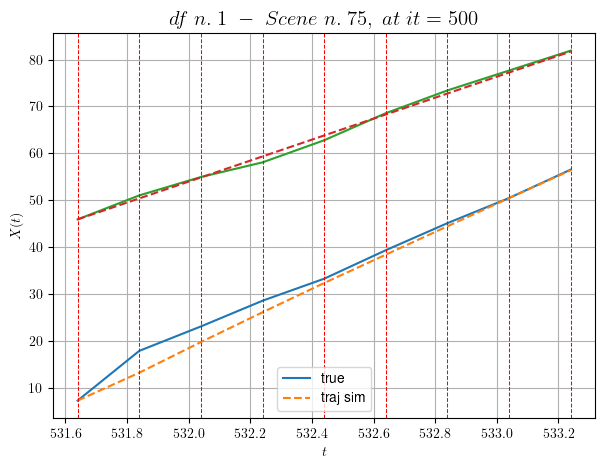

----------------------------------------------------------------------------------------------------
        For scene 64/73:
        * After LR finder: LR_NN=0.005 with mse=27.5244302710106 at it=24
        * v0 = 22.382648405901485
        * MSE = 1.7368430424911834
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.65/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [148.04,148.44]


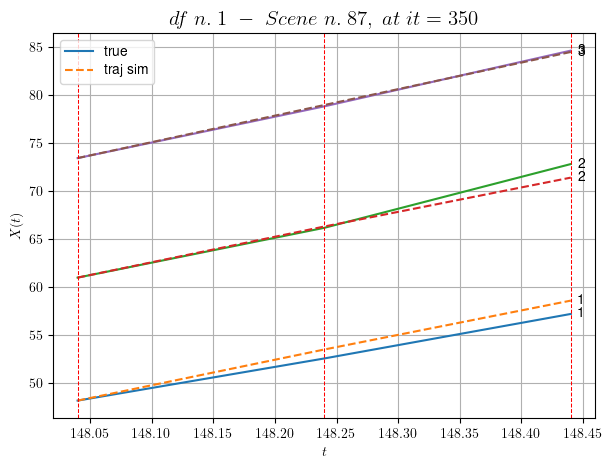

----------------------------------------------------------------------------------------------------
        For scene 65/73:
        * After LR finder: LR_NN=0.005 with mse=0.6573916431763978 at it=24
        * v0 = 27.62167390672279
        * MSE = 0.5383696206592216
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.66/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


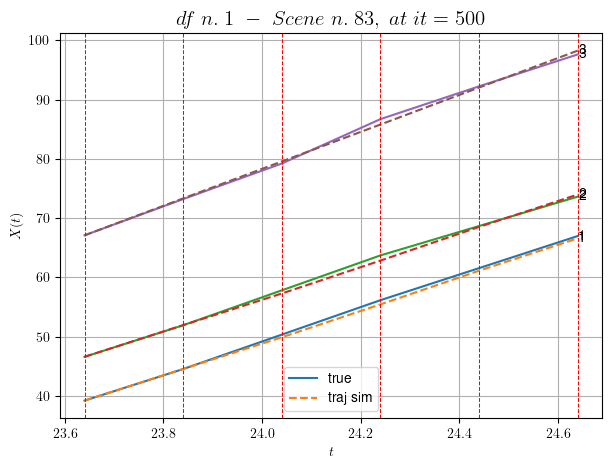

----------------------------------------------------------------------------------------------------
        For scene 66/73:
        * After LR finder: LR_NN=0.01 with mse=0.34600352070061335 at it=24
        * v0 = 31.18442056584025
        * MSE = 0.1935239664709072
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.67/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [159.84,160.64]


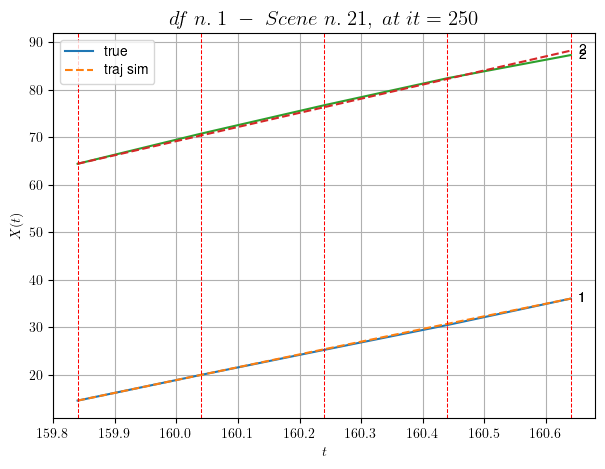

----------------------------------------------------------------------------------------------------
        For scene 67/73:
        * After LR finder: LR_NN=0.005 with mse=0.15296065560898756 at it=24
        * v0 = 29.799065986140825
        * MSE = 0.1289184355942984
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.68/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [429.24,429.84]


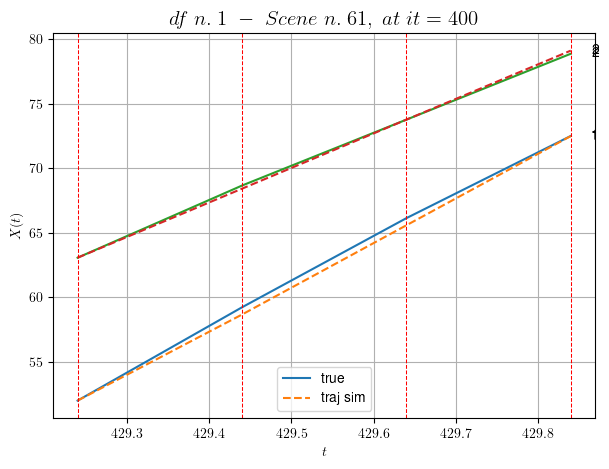

----------------------------------------------------------------------------------------------------
        For scene 68/73:
        * After LR finder: LR_NN=0.005 with mse=0.9269100152044806 at it=24
        * v0 = 26.764923518889663
        * MSE = 0.0910464699954082
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.69/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [489.04,489.84]


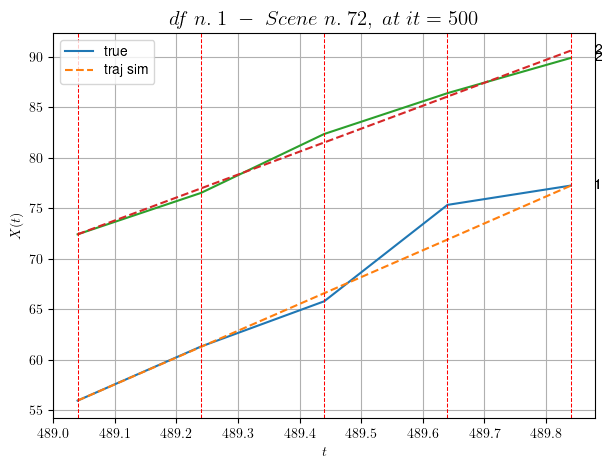

----------------------------------------------------------------------------------------------------
        For scene 69/73:
        * After LR finder: LR_NN=0.0001 with mse=7.574019145402728 at it=24
        * v0 = 22.729734196719107
        * MSE = 1.278294796496861
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.70/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [116.04,117.04]


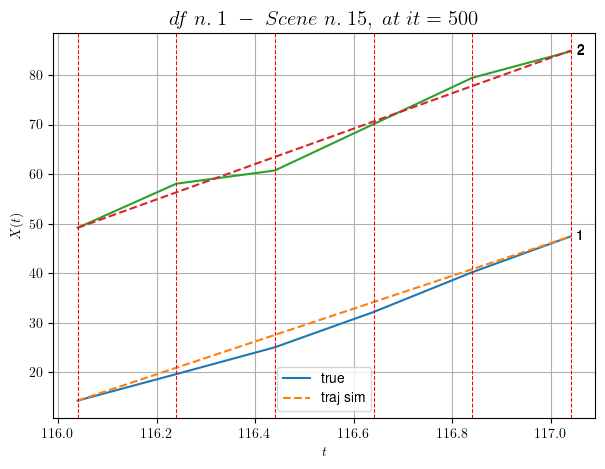

----------------------------------------------------------------------------------------------------
        For scene 70/73:
        * After LR finder: LR_NN=5e-05 with mse=8.066285118543858 at it=24
        * v0 = 35.754459494761726
        * MSE = 1.8550651576783577
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.71/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [253.64,254.04]


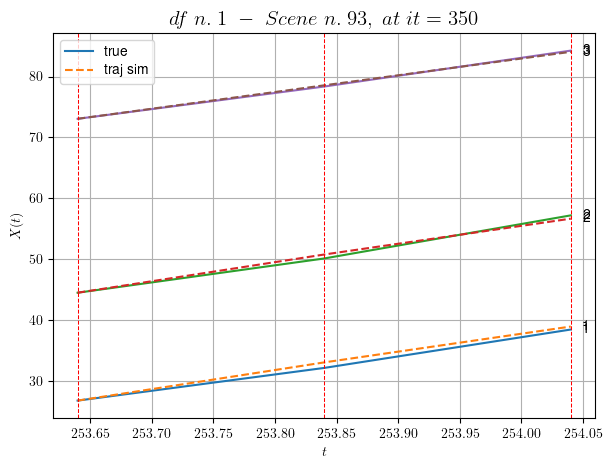

----------------------------------------------------------------------------------------------------
        For scene 71/73:
        * After LR finder: LR_NN=0.005 with mse=0.34686411222299635 at it=24
        * v0 = 27.474897828444636
        * MSE = 0.20593712477108164
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.72/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [358.84,359.64]


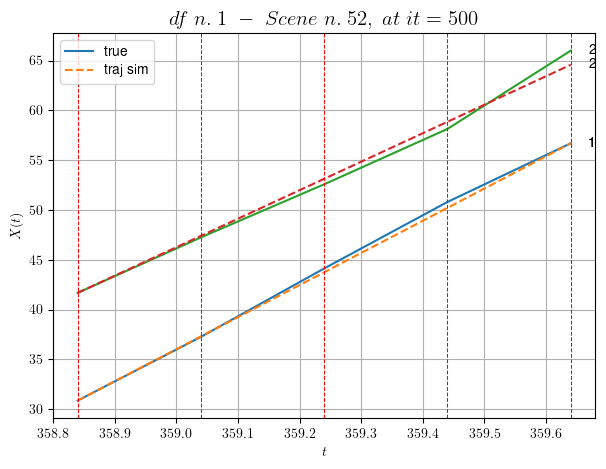

----------------------------------------------------------------------------------------------------
        For scene 72/73:
        * After LR finder: LR_NN=0.001 with mse=1.5110775254227045 at it=24
        * v0 = 28.626441976922006
        * MSE = 0.3241203029559196
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.73/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [495.84,496.24]


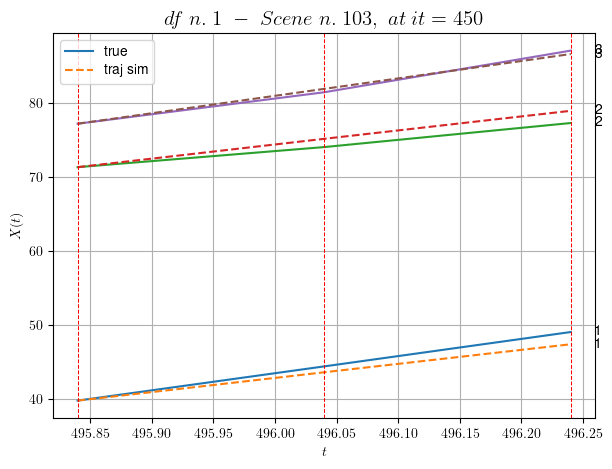

----------------------------------------------------------------------------------------------------
        For scene 73/73:
        * After LR finder: LR_NN=0.005 with mse=1.6429571701266468 at it=24
        * v0 = 23.563094778663604
        * MSE = 0.8582198210274283
        * iterations = 450
----------------------------------------------------------------------------------------------------


MSE train: 1.0836643629917333
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (36 scenes)
DataFrame n.1. Scene n.1/36


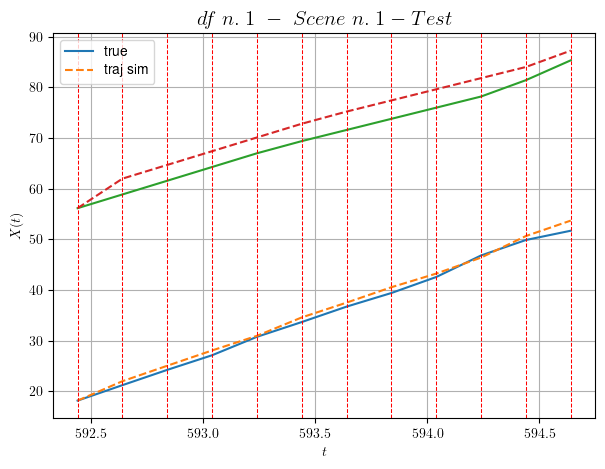

        For scene 1/36:
        * MSE = 5.1687888354119655
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/36


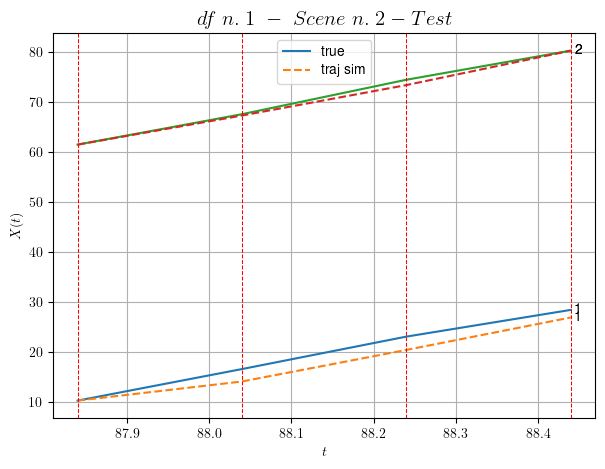

        For scene 2/36:
        * MSE = 2.1040443233325314
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/36


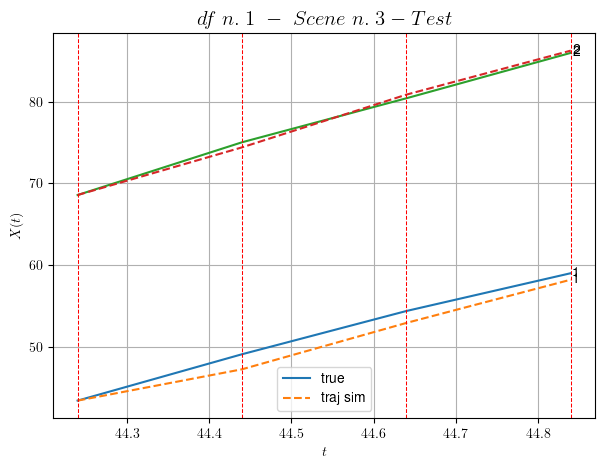

        For scene 3/36:
        * MSE = 0.8508310500435827
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/36


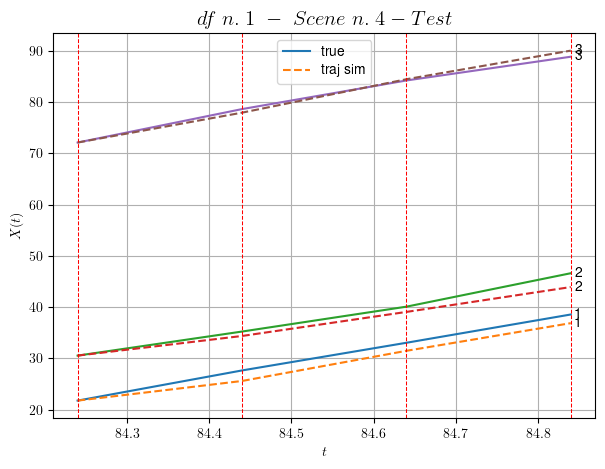

        For scene 4/36:
        * MSE = 1.7166379282729156
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/36


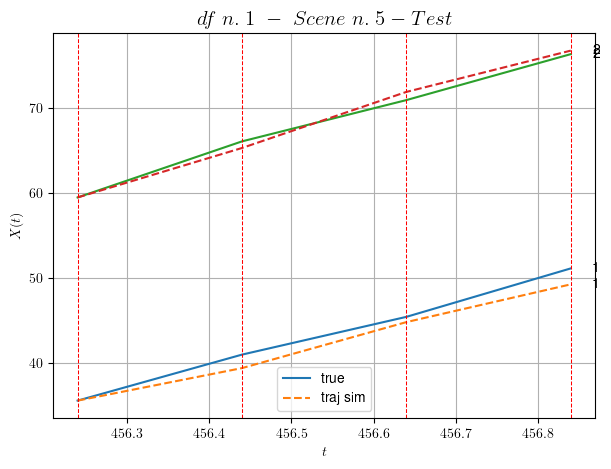

        For scene 5/36:
        * MSE = 1.0177414241462346
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/36


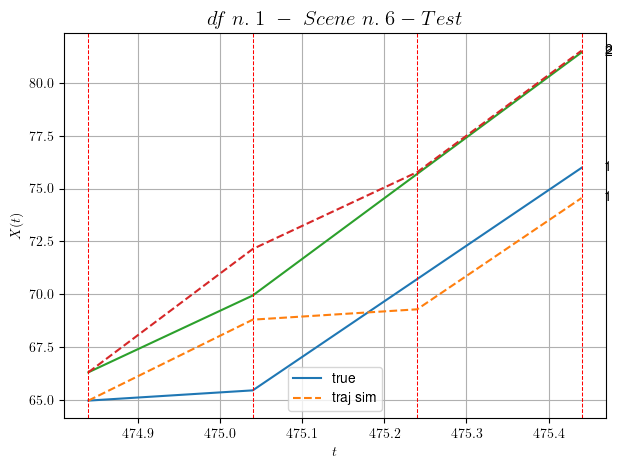

        For scene 6/36:
        * MSE = 2.5126380989738877
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/36


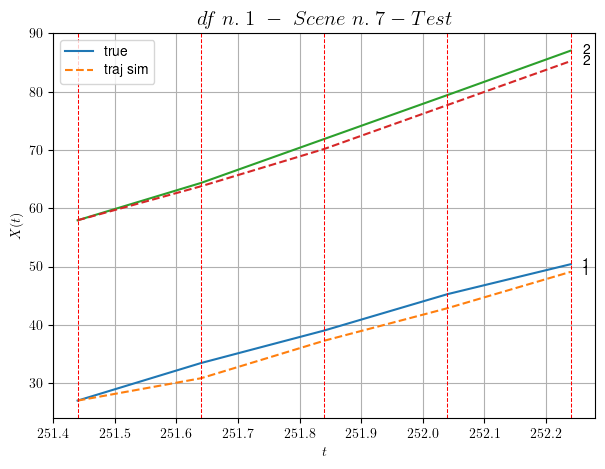

        For scene 7/36:
        * MSE = 2.6765110199886326
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/36


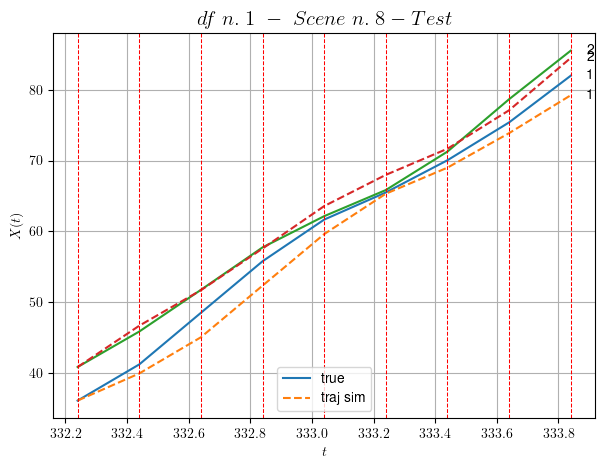

        For scene 8/36:
        * MSE = 2.8649116685894374
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/36


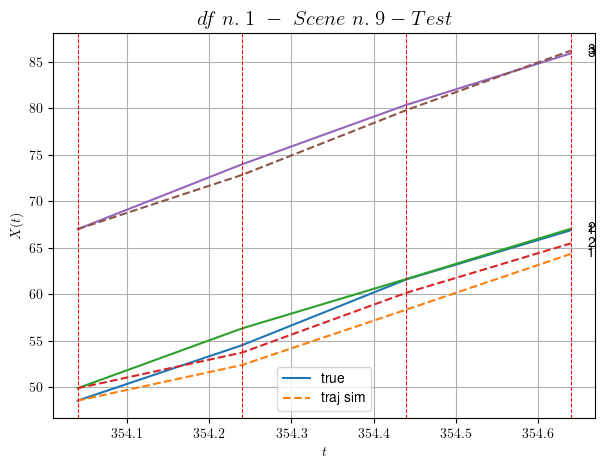

        For scene 9/36:
        * MSE = 2.886391033618745
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/36


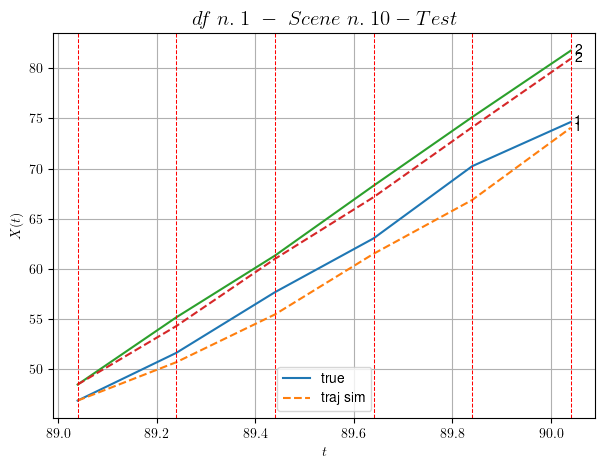

        For scene 10/36:
        * MSE = 1.9742847699126682
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/36


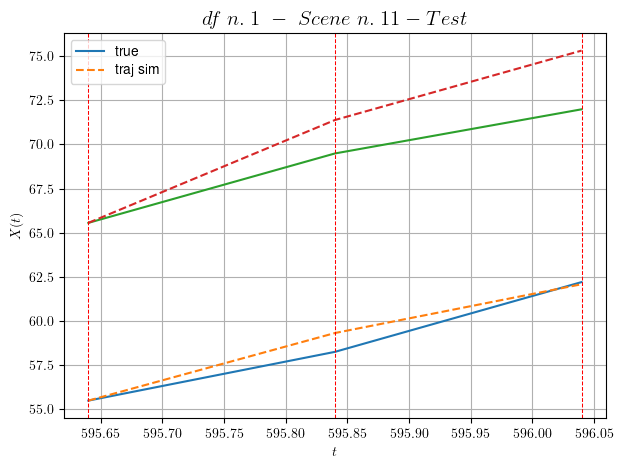

        For scene 11/36:
        * MSE = 2.6365008468399385
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/36


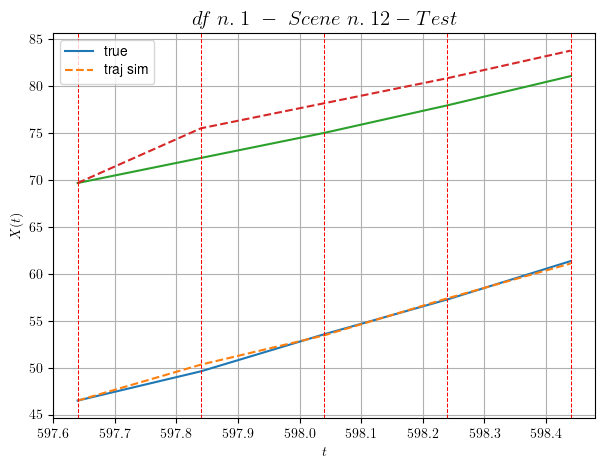

        For scene 12/36:
        * MSE = 3.6299553288589035
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/36


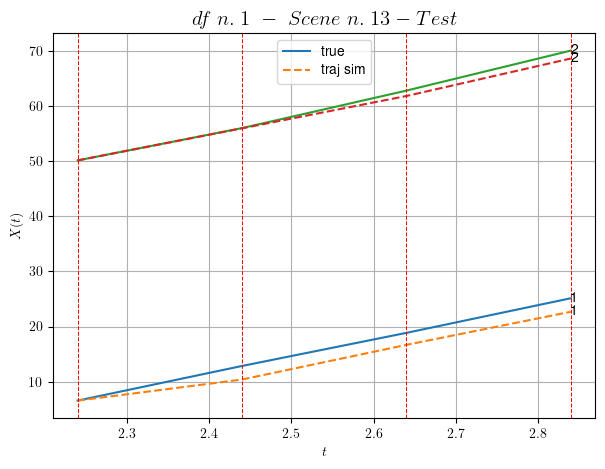

        For scene 13/36:
        * MSE = 2.484499840918766
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/36


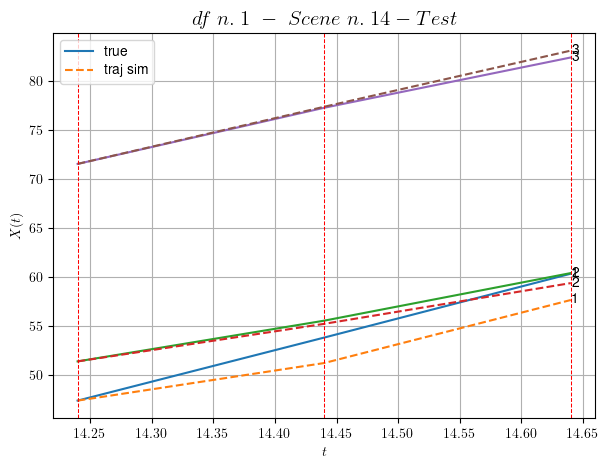

        For scene 14/36:
        * MSE = 1.732970356490789
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/36


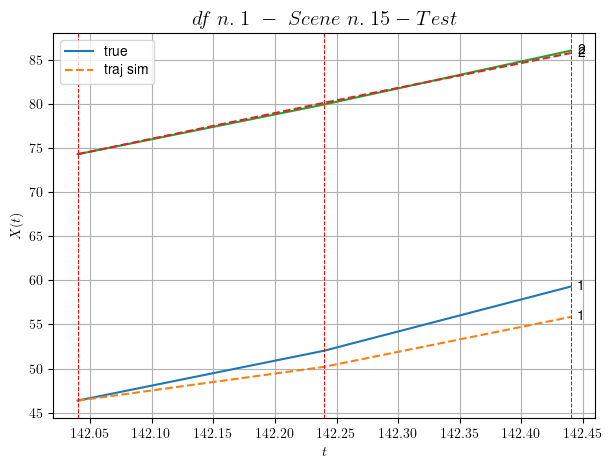

        For scene 15/36:
        * MSE = 2.5476597329543393
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/36


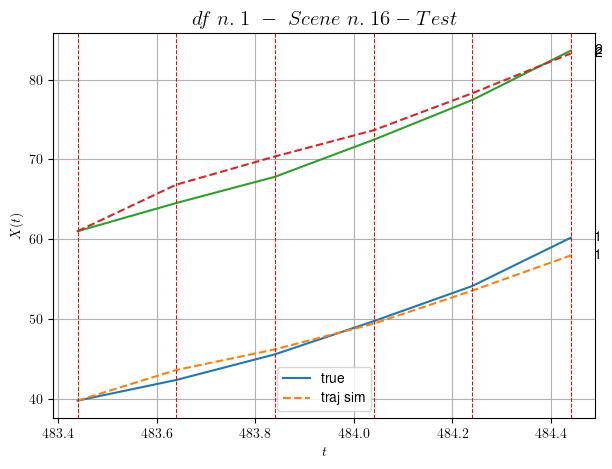

        For scene 16/36:
        * MSE = 1.7805018417473533
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/36


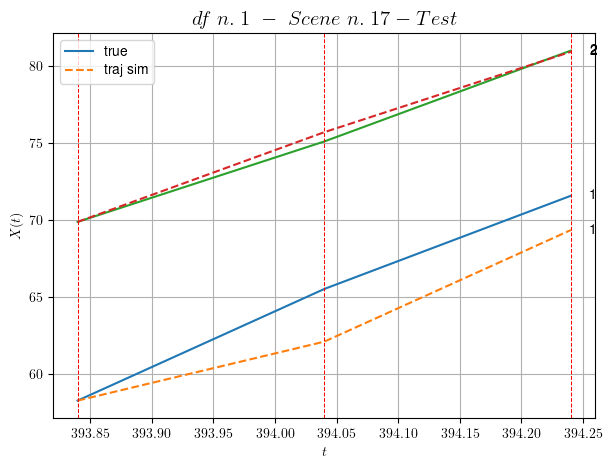

        For scene 17/36:
        * MSE = 2.8431682081991667
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/36


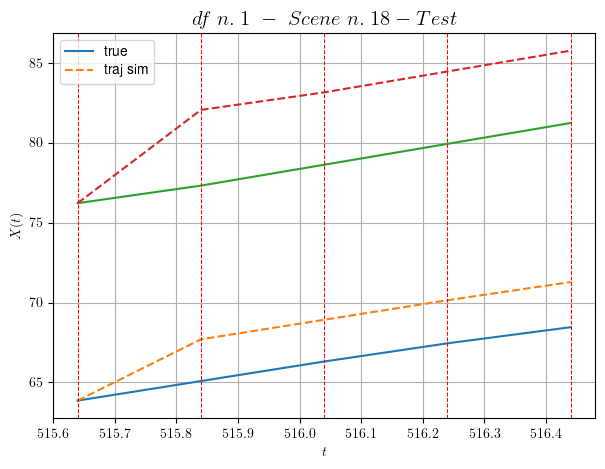

        For scene 18/36:
        * MSE = 11.265196972282368
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/36


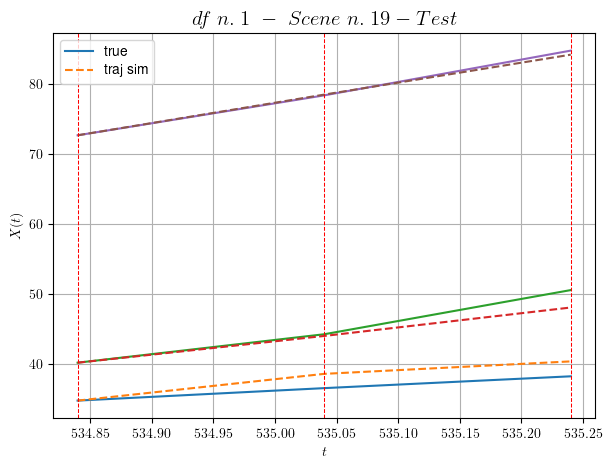

        For scene 19/36:
        * MSE = 1.7098421530928223
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/36


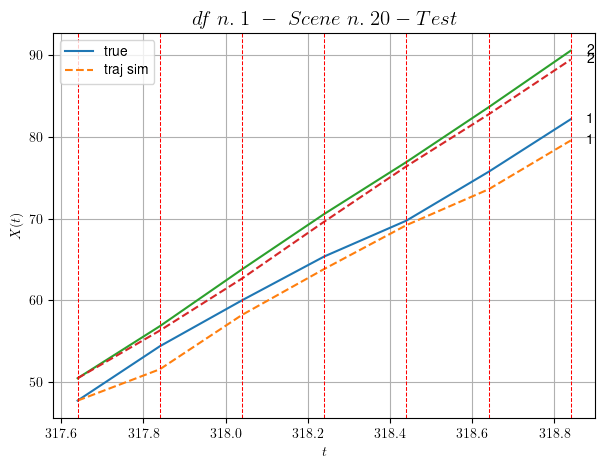

        For scene 20/36:
        * MSE = 2.124829586695768
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/36


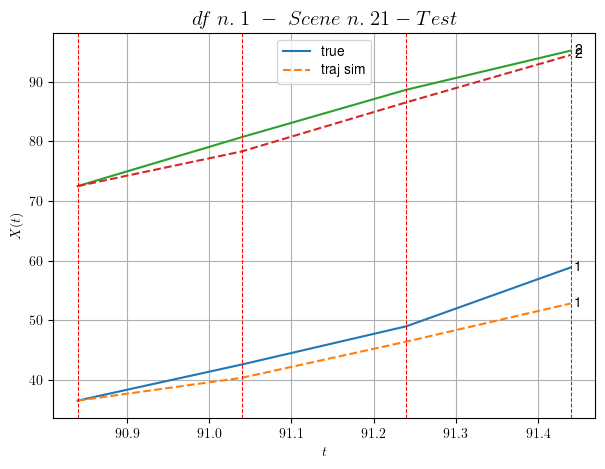

        For scene 21/36:
        * MSE = 7.351976453170462
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/36


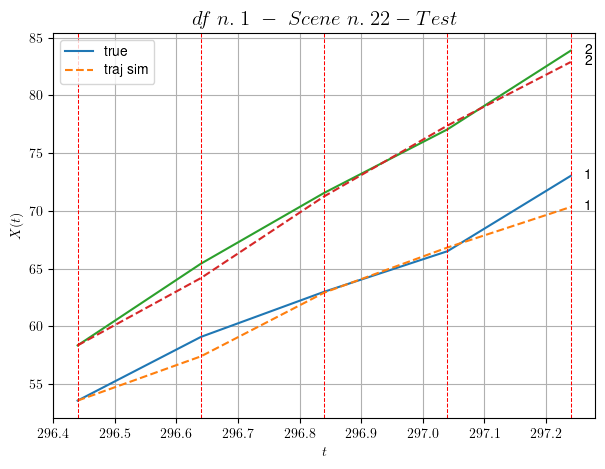

        For scene 22/36:
        * MSE = 1.2923146575060334
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/36


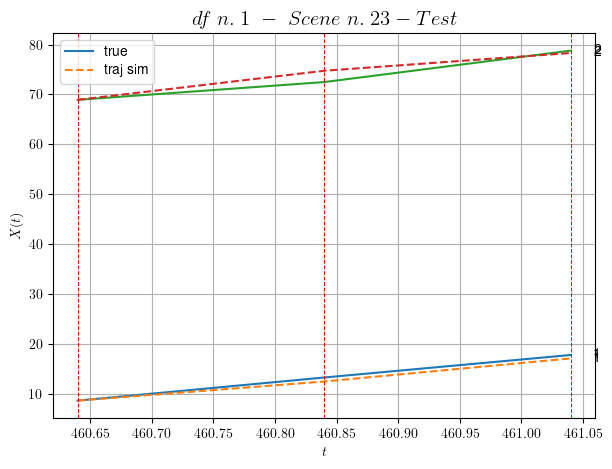

        For scene 23/36:
        * MSE = 1.078592717286449
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/36


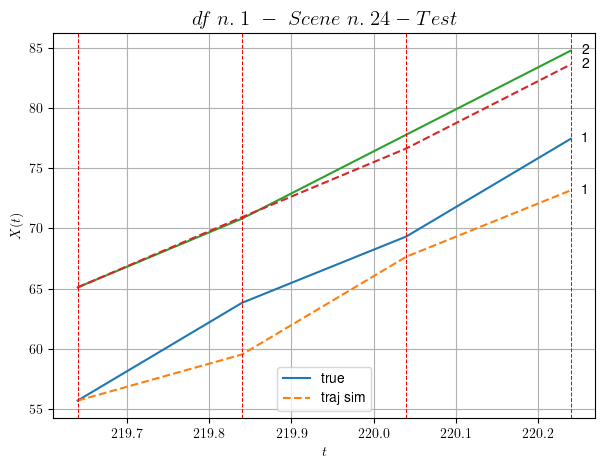

        For scene 24/36:
        * MSE = 5.270811454991047
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/36


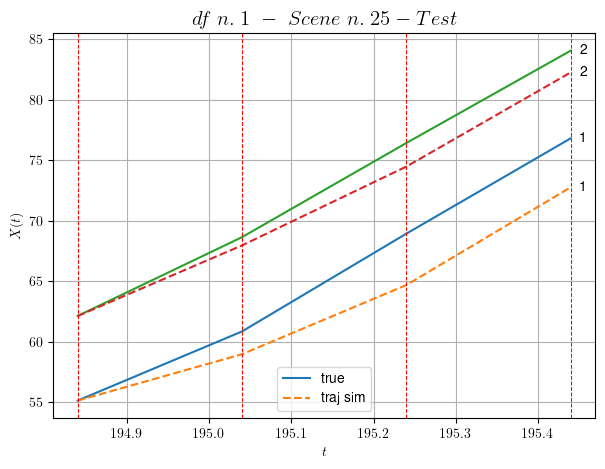

        For scene 25/36:
        * MSE = 5.672096048933918
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/36


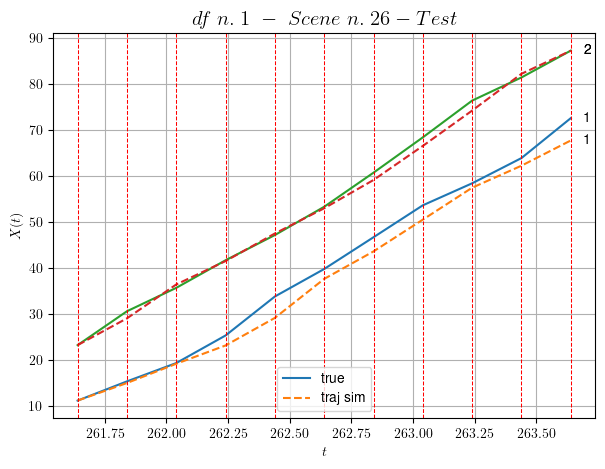

        For scene 26/36:
        * MSE = 4.193329904138226
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/36


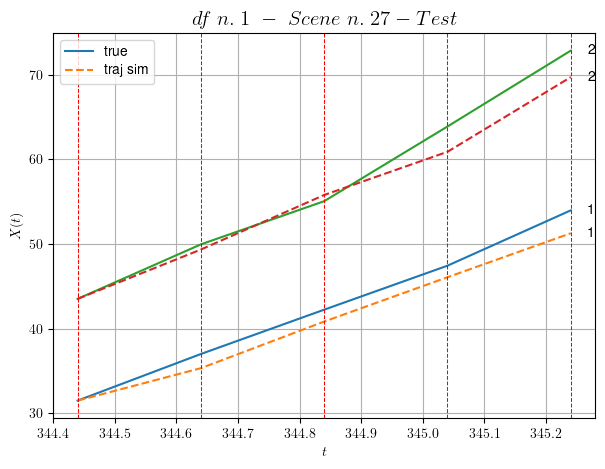

        For scene 27/36:
        * MSE = 3.359446603565414
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/36


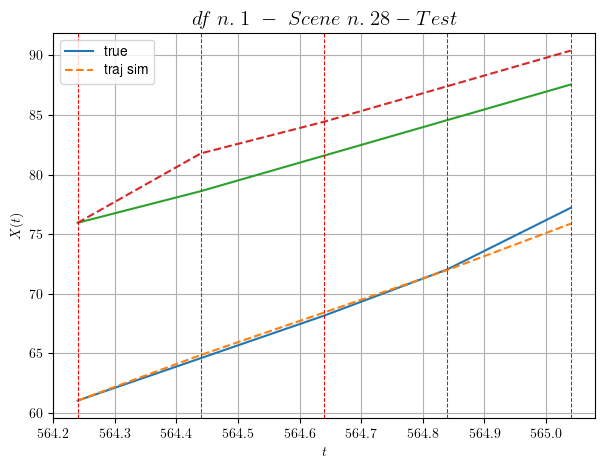

        For scene 28/36:
        * MSE = 3.628380211807952
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/36


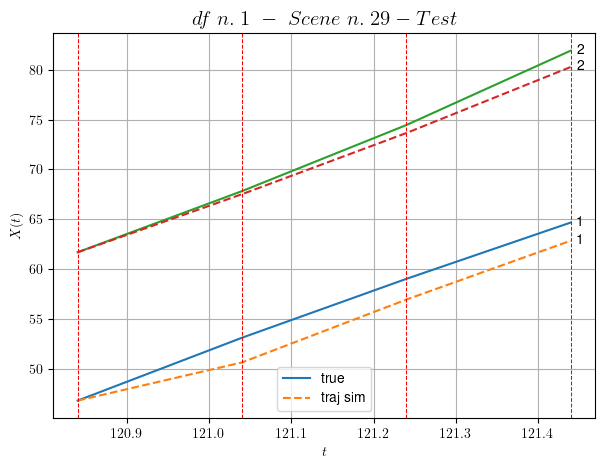

        For scene 29/36:
        * MSE = 2.151499501502654
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/36


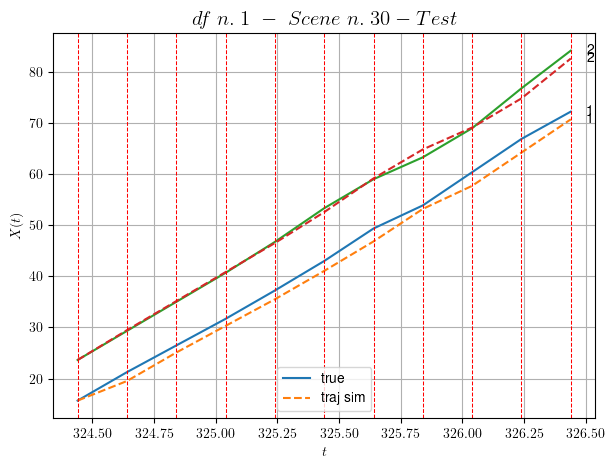

        For scene 30/36:
        * MSE = 2.110198857877584
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/36


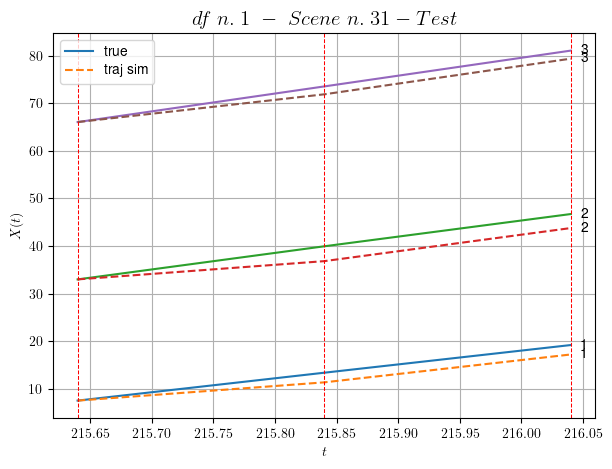

        For scene 31/36:
        * MSE = 3.553683417283565
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/36


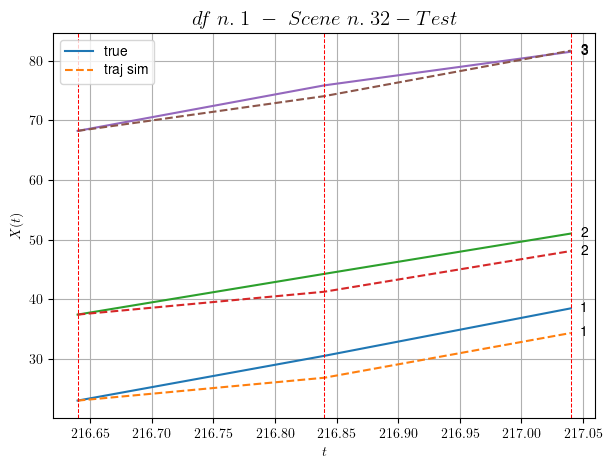

        For scene 32/36:
        * MSE = 5.715100847726756
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/36


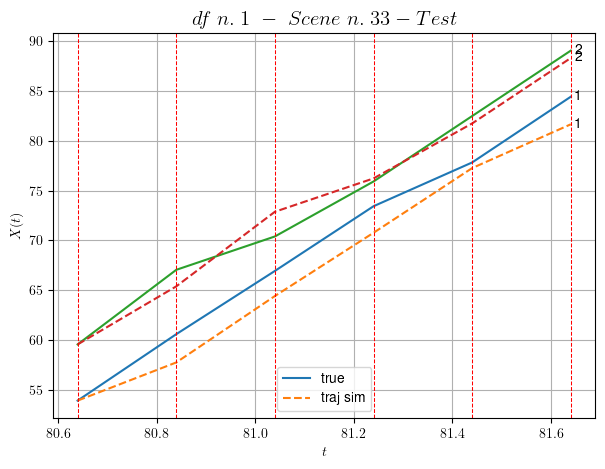

        For scene 33/36:
        * MSE = 3.2993298610606696
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/36


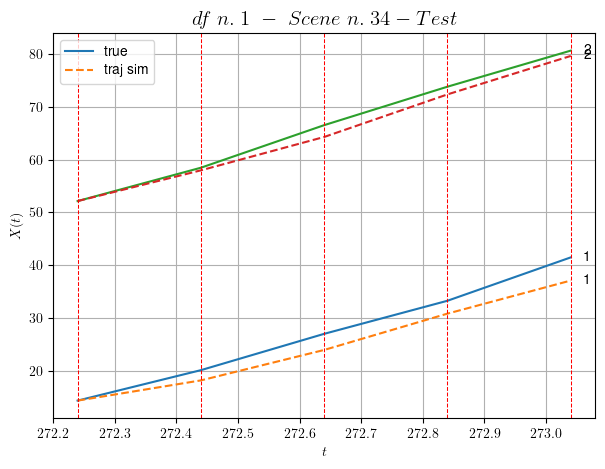

        For scene 34/36:
        * MSE = 4.6756981150718815
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/36


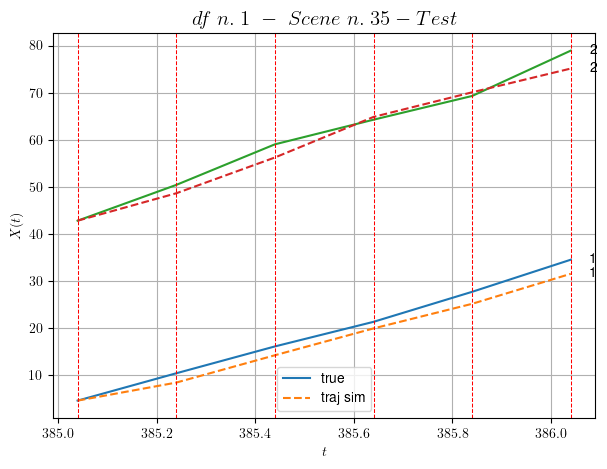

        For scene 35/36:
        * MSE = 4.283333441234007
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/36


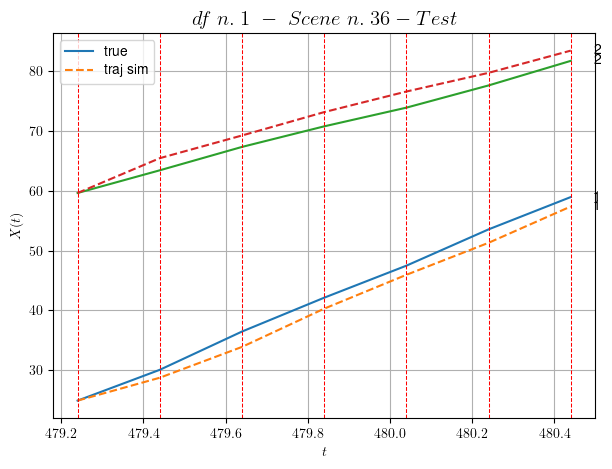

        For scene 36/36:
        * MSE = 3.5572263955203454
----------------------------------------------------------------------------------------------------


MSE test: 3.270025653029105

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.0836643629917333
          * MSE test: 3.270025653029105
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 2/10 dfs.
In DataFrame n.2 we have 69 scenes.
    To train the model we use 46 scenes, the remaining 23 to test the model.

Training step. (46 scenes)
DataFrame n.2. Scene n.1/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [292.96,293.56]


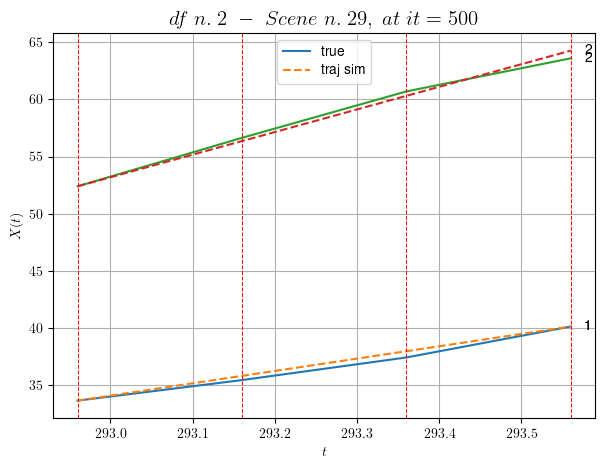

----------------------------------------------------------------------------------------------------
        For scene 1/46:
        * After LR finder: LR_NN=0.0005 with mse=7.933009597323874 at it=24
        * v0 = 19.771247175293336
        * MSE = 0.13925274002075733
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [84.96,85.96]


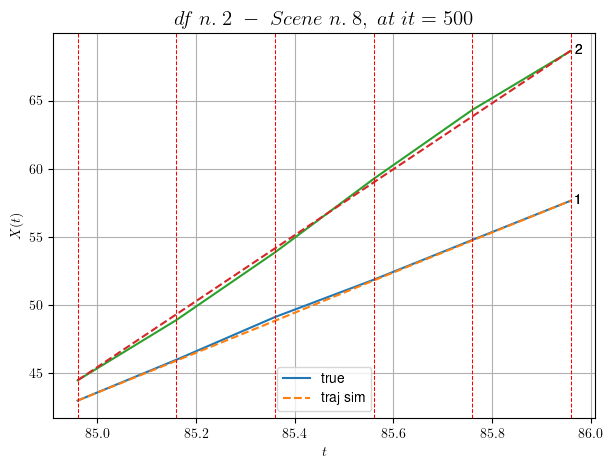

----------------------------------------------------------------------------------------------------
        For scene 2/46:
        * After LR finder: LR_NN=0.005 with mse=5.9772271234732575 at it=24
        * v0 = 24.168678500842805
        * MSE = 0.05069617545732005
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [487.56,487.96]


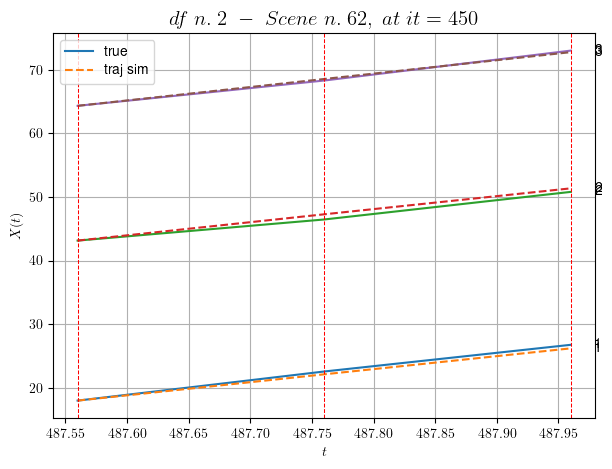

----------------------------------------------------------------------------------------------------
        For scene 3/46:
        * After LR finder: LR_NN=0.005 with mse=1.8388752950857603 at it=24
        * v0 = 21.111902026180488
        * MSE = 0.17726426119926728
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [440.16,441.36]


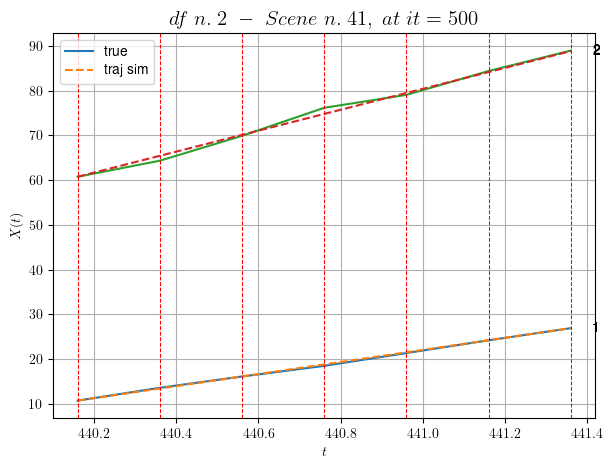

----------------------------------------------------------------------------------------------------
        For scene 4/46:
        * After LR finder: LR_NN=0.0001 with mse=57.34192950257692 at it=24
        * v0 = 23.380815312671988
        * MSE = 0.2521730164643068
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [588.96,589.36]


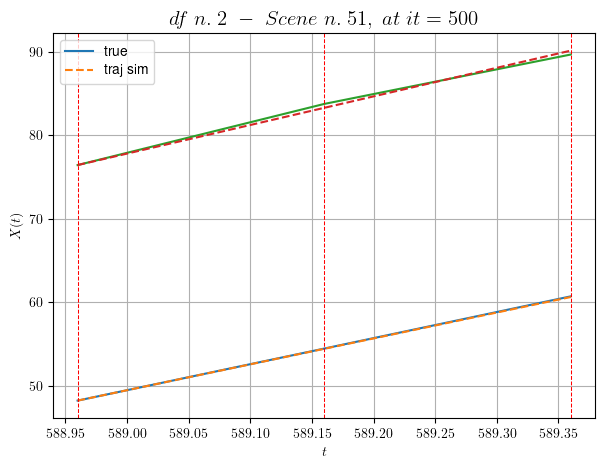

----------------------------------------------------------------------------------------------------
        For scene 5/46:
        * After LR finder: LR_NN=5e-05 with mse=0.5833300571040556 at it=24
        * v0 = 34.22110969003096
        * MSE = 0.07376324331484262
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [530.96,531.36]


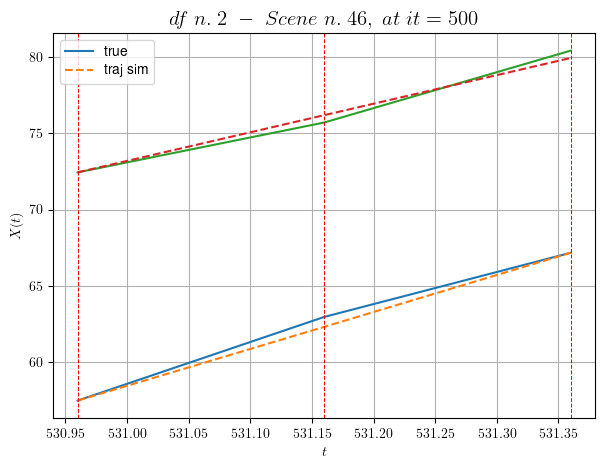

----------------------------------------------------------------------------------------------------
        For scene 6/46:
        * After LR finder: LR_NN=0.0005 with mse=3.990126096477377 at it=24
        * v0 = 18.78540832306742
        * MSE = 0.14103772100029618
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [220.36,221.16]


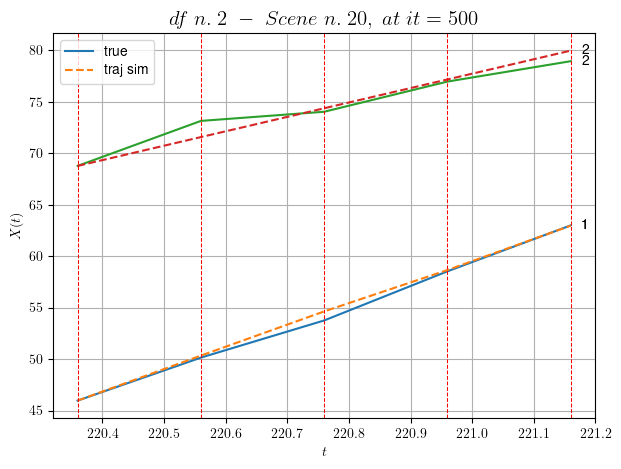

----------------------------------------------------------------------------------------------------
        For scene 7/46:
        * After LR finder: LR_NN=0.01 with mse=33.64544538113763 at it=24
        * v0 = 13.996427133410325
        * MSE = 0.4489078642584602
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [199.76,200.16]


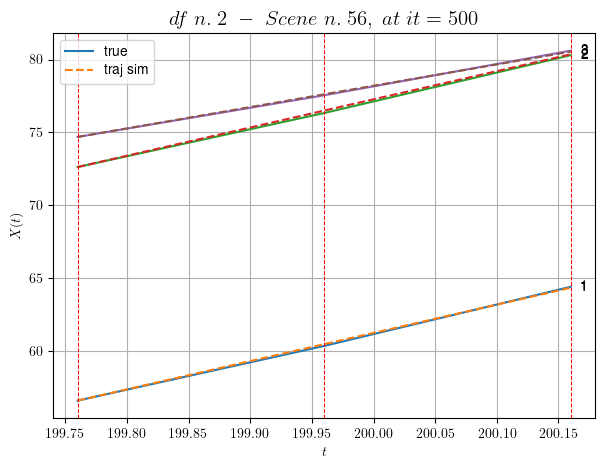

----------------------------------------------------------------------------------------------------
        For scene 8/46:
        * After LR finder: LR_NN=0.0005 with mse=10.891503232284633 at it=24
        * v0 = 14.651669964039433
        * MSE = 0.006701945170325674
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [428.56,429.76]


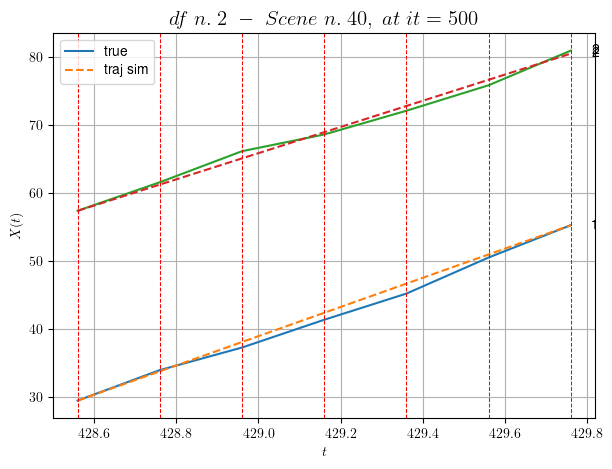

----------------------------------------------------------------------------------------------------
        For scene 9/46:
        * After LR finder: LR_NN=0.0005 with mse=84.46251631607073 at it=24
        * v0 = 19.277810356522743
        * MSE = 0.48449130877574903
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [256.56,258.16]


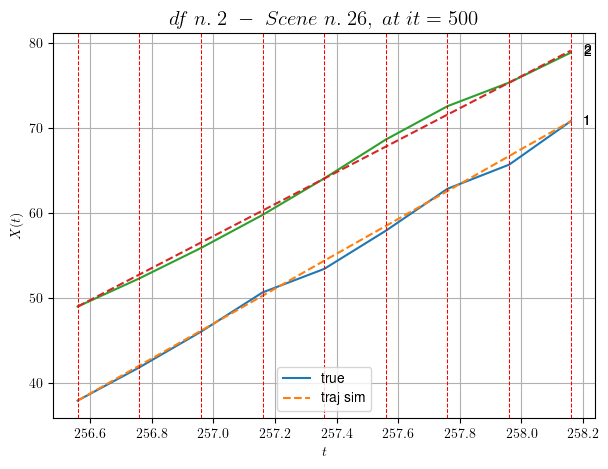

----------------------------------------------------------------------------------------------------
        For scene 10/46:
        * After LR finder: LR_NN=0.001 with mse=55.57931857921156 at it=24
        * v0 = 18.832978045462152
        * MSE = 0.28544489619119373
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [413.96,414.56]


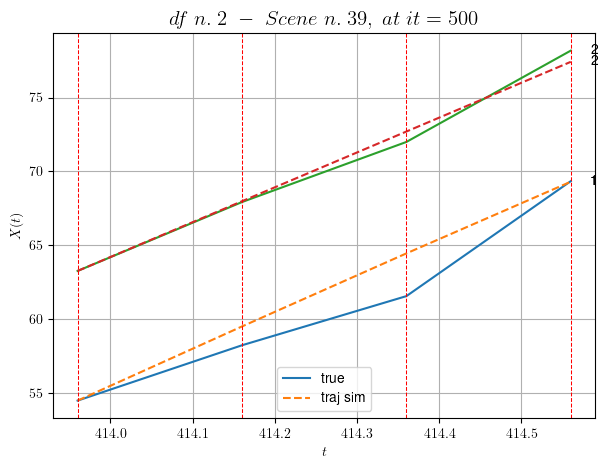

----------------------------------------------------------------------------------------------------
        For scene 11/46:
        * After LR finder: LR_NN=0.001 with mse=3.6501793100782693 at it=24
        * v0 = 23.615524542917576
        * MSE = 1.3732992255568015
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [183.96,184.56]


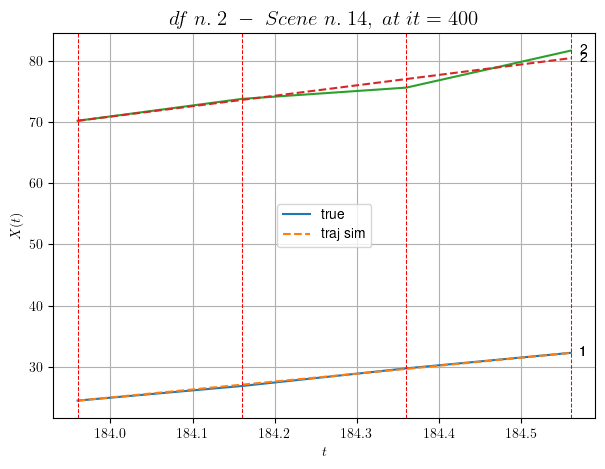

----------------------------------------------------------------------------------------------------
        For scene 12/46:
        * After LR finder: LR_NN=0.005 with mse=11.494853462817314 at it=24
        * v0 = 17.051810925368834
        * MSE = 0.4353027278088585
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [576.56,576.96]


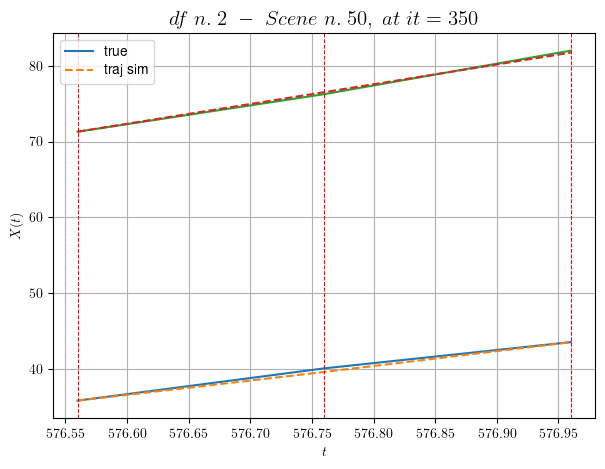

----------------------------------------------------------------------------------------------------
        For scene 13/46:
        * After LR finder: LR_NN=0.005 with mse=0.5097650865775081 at it=24
        * v0 = 26.06956916116025
        * MSE = 0.06016158400623106
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [54.56,55.36]


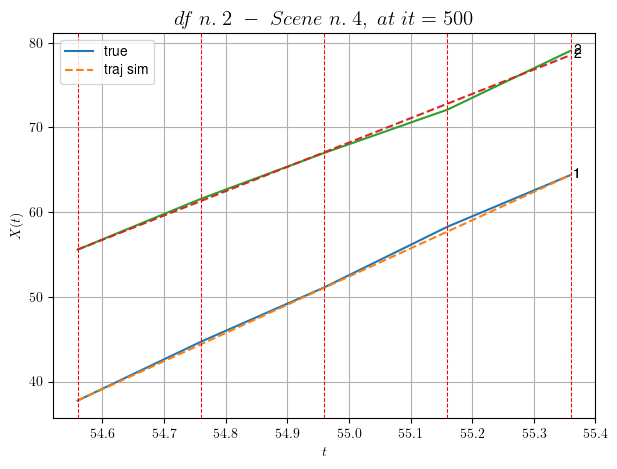

----------------------------------------------------------------------------------------------------
        For scene 14/46:
        * After LR finder: LR_NN=0.001 with mse=0.33304249611021414 at it=24
        * v0 = 28.71632130964944
        * MSE = 0.12575671086087373
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [215.36,215.96]


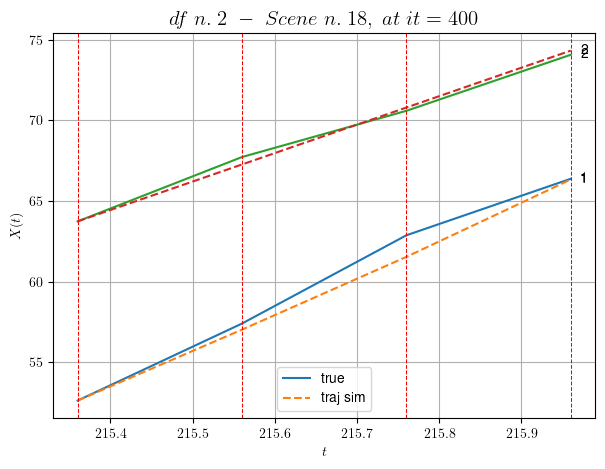

----------------------------------------------------------------------------------------------------
        For scene 15/46:
        * After LR finder: LR_NN=0.005 with mse=11.488315981761172 at it=24
        * v0 = 17.64323255273954
        * MSE = 0.2700812024843906
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [96.36,96.76]


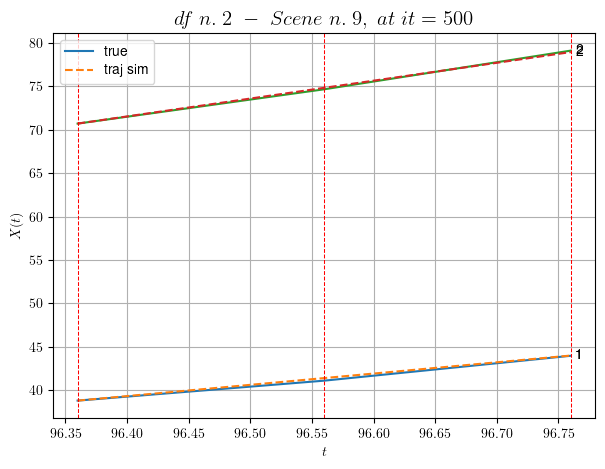

----------------------------------------------------------------------------------------------------
        For scene 16/46:
        * After LR finder: LR_NN=0.0001 with mse=2.8607832011276453 at it=24
        * v0 = 20.598848215630003
        * MSE = 0.02428039661662357
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [179.36,180.16]


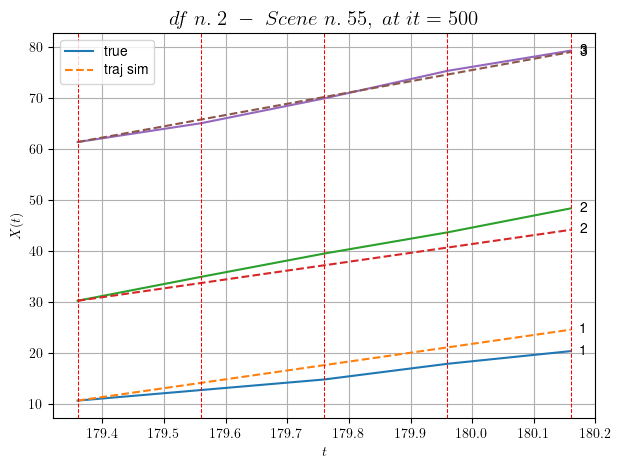

----------------------------------------------------------------------------------------------------
        For scene 17/46:
        * After LR finder: LR_NN=0.0001 with mse=6.018441809395598 at it=24
        * v0 = 22.08199952987907
        * MSE = 4.824878402720681
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [77.56,78.76]


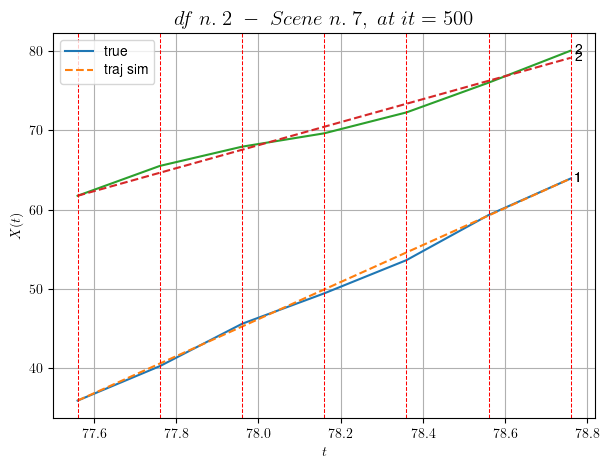

----------------------------------------------------------------------------------------------------
        For scene 18/46:
        * After LR finder: LR_NN=0.0005 with mse=64.42527140019487 at it=24
        * v0 = 14.52987610831294
        * MSE = 0.3623157668070425
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [399.56,400.56]


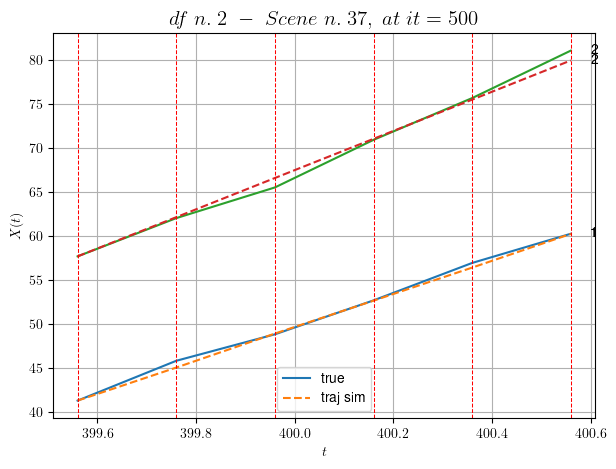

----------------------------------------------------------------------------------------------------
        For scene 19/46:
        * After LR finder: LR_NN=0.005 with mse=10.261107154074807 at it=24
        * v0 = 22.285901484028166
        * MSE = 0.2774288534457615
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [538.36,539.16]


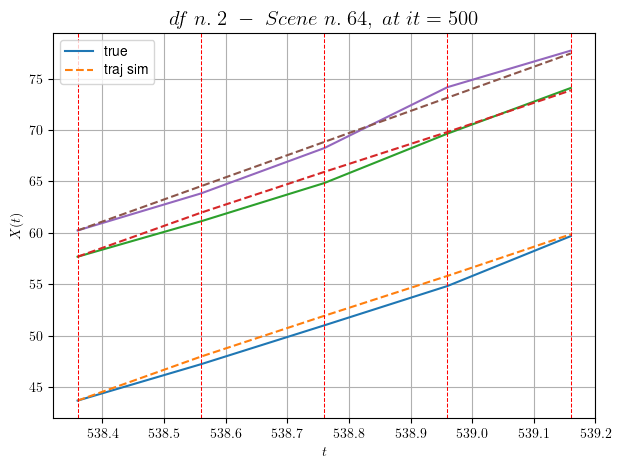

----------------------------------------------------------------------------------------------------
        For scene 20/46:
        * After LR finder: LR_NN=0.01 with mse=5.704718596529207 at it=24
        * v0 = 21.518869344523125
        * MSE = 0.4184961232381224
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [87.56,88.16]


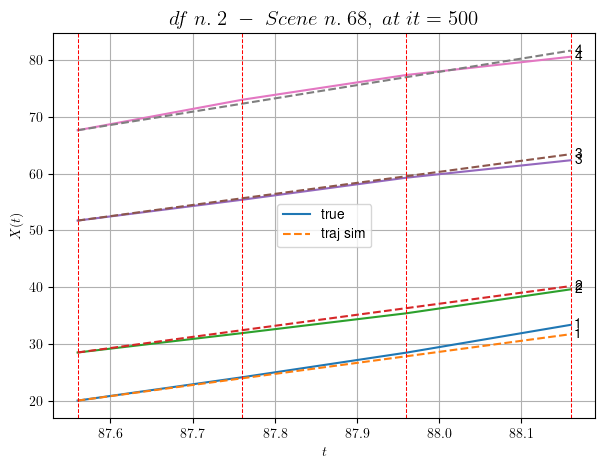

----------------------------------------------------------------------------------------------------
        For scene 21/46:
        * After LR finder: LR_NN=0.005 with mse=2.298499965406627 at it=24
        * v0 = 23.39910333176468
        * MSE = 0.47841145364270904
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [208.96,209.36]


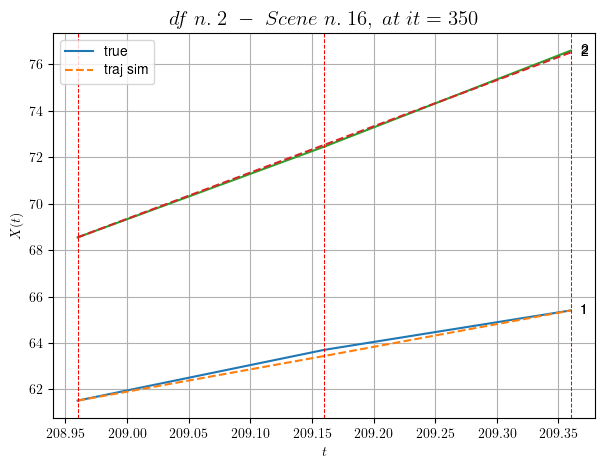

----------------------------------------------------------------------------------------------------
        For scene 22/46:
        * After LR finder: LR_NN=0.005 with mse=3.3473065271789717 at it=24
        * v0 = 19.925309783508897
        * MSE = 0.013562789788154039
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [287.36,287.96]


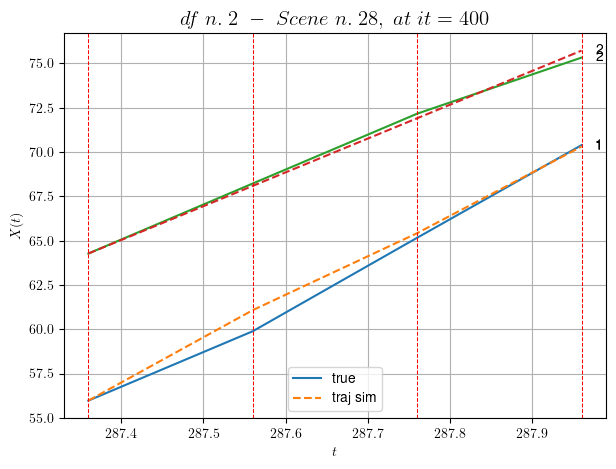

----------------------------------------------------------------------------------------------------
        For scene 23/46:
        * After LR finder: LR_NN=0.01 with mse=8.88430611857582 at it=24
        * v0 = 19.08174410837685
        * MSE = 0.21649146063702635
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.24/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [442.36,443.76]


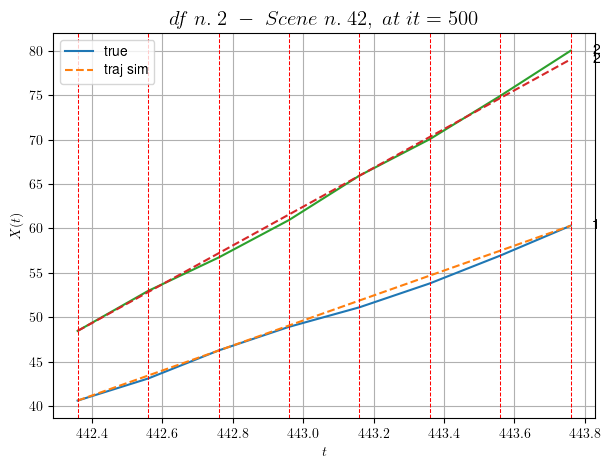

----------------------------------------------------------------------------------------------------
        For scene 24/46:
        * After LR finder: LR_NN=0.001 with mse=22.467248021378055 at it=24
        * v0 = 21.85795817065097
        * MSE = 0.21486374134670594
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.25/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [275.56,275.96]


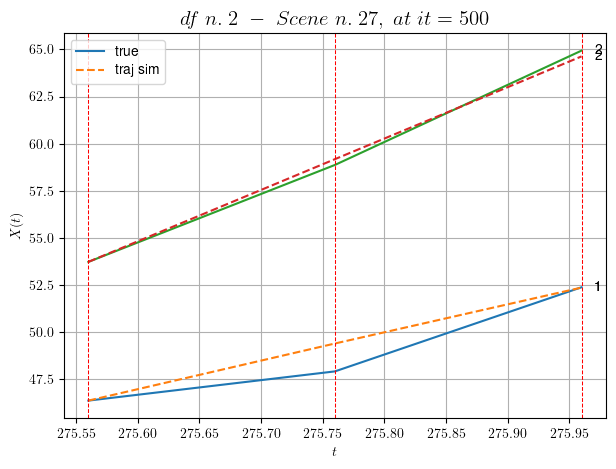

----------------------------------------------------------------------------------------------------
        For scene 25/46:
        * After LR finder: LR_NN=0.001 with mse=5.2063244540198825 at it=24
        * v0 = 27.245148829197323
        * MSE = 0.39384383228356856
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.26/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [557.96,559.16]


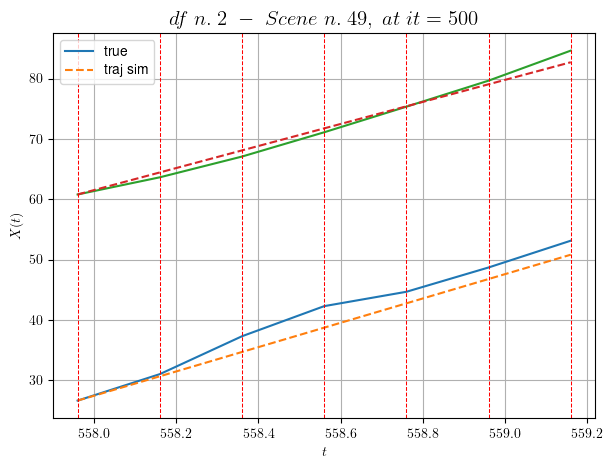

----------------------------------------------------------------------------------------------------
        For scene 26/46:
        * After LR finder: LR_NN=1e-05 with mse=33.50578374927653 at it=24
        * v0 = 18.265989604984224
        * MSE = 2.756368338084929
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.27/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [253.96,254.56]


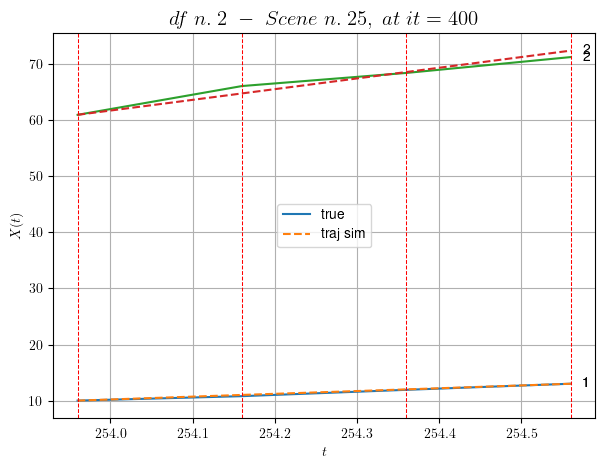

----------------------------------------------------------------------------------------------------
        For scene 27/46:
        * After LR finder: LR_NN=0.01 with mse=10.11877834586354 at it=24
        * v0 = 19.059884323267724
        * MSE = 0.39184862434023815
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.28/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [430.16,430.96]


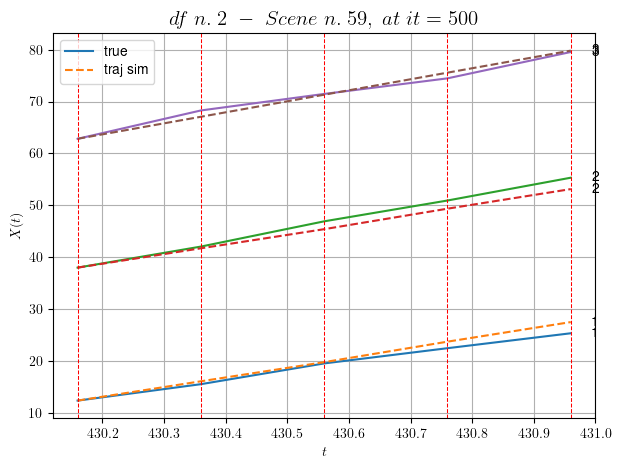

----------------------------------------------------------------------------------------------------
        For scene 28/46:
        * After LR finder: LR_NN=0.01 with mse=8.105081888832784 at it=24
        * v0 = 21.23690274072349
        * MSE = 1.270492613751366
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.29/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [531.76,532.76]


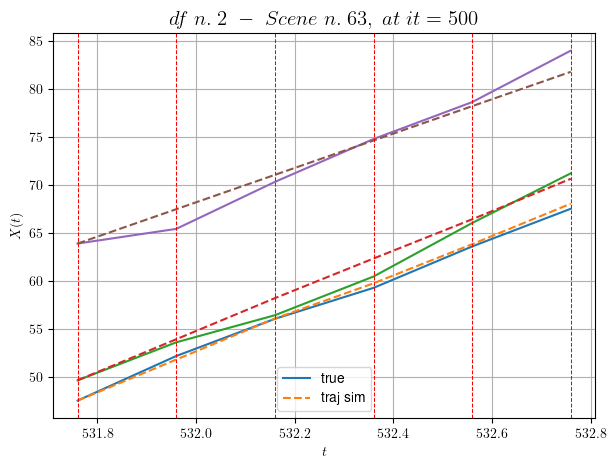

----------------------------------------------------------------------------------------------------
        For scene 29/46:
        * After LR finder: LR_NN=0.005 with mse=16.32249791209775 at it=24
        * v0 = 17.911731328080222
        * MSE = 0.9540152430266121
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.30/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [145.16,145.56]


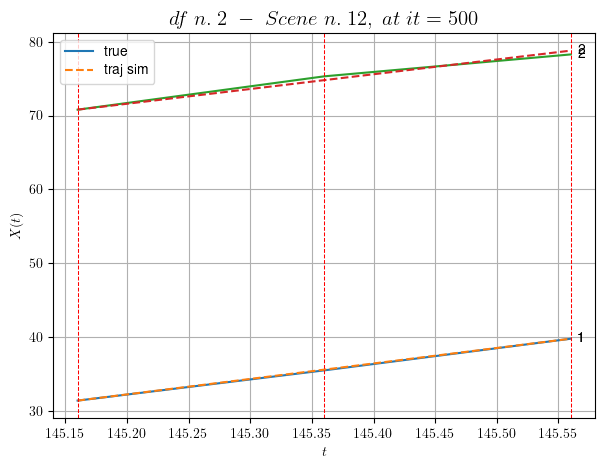

----------------------------------------------------------------------------------------------------
        For scene 30/46:
        * After LR finder: LR_NN=5e-05 with mse=3.7548088695845685 at it=24
        * v0 = 20.018762316549715
        * MSE = 0.09058484986273269
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.31/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [358.16,358.76]


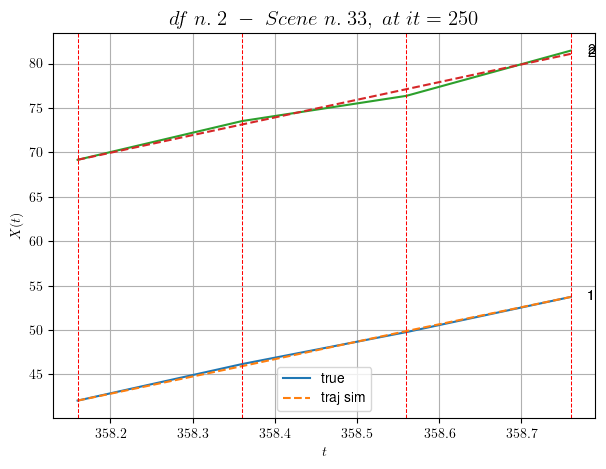

----------------------------------------------------------------------------------------------------
        For scene 31/46:
        * After LR finder: LR_NN=0.005 with mse=7.297729866906574 at it=24
        * v0 = 19.877126560274792
        * MSE = 0.11396380309637154
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.32/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [549.76,550.16]


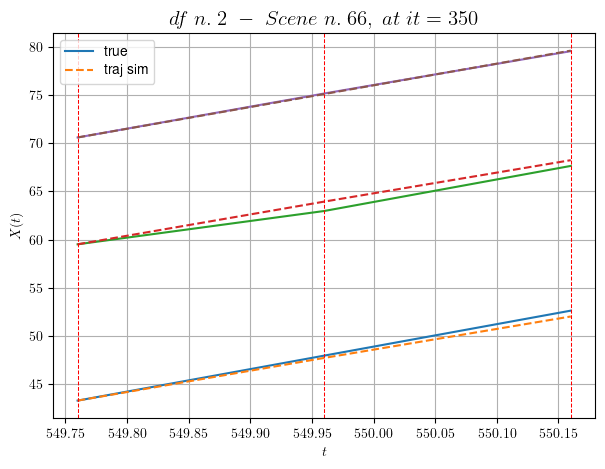

----------------------------------------------------------------------------------------------------
        For scene 32/46:
        * After LR finder: LR_NN=0.005 with mse=1.4650746784795459 at it=24
        * v0 = 22.495773750078545
        * MSE = 0.19193690469609717
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.33/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [566.76,567.16]


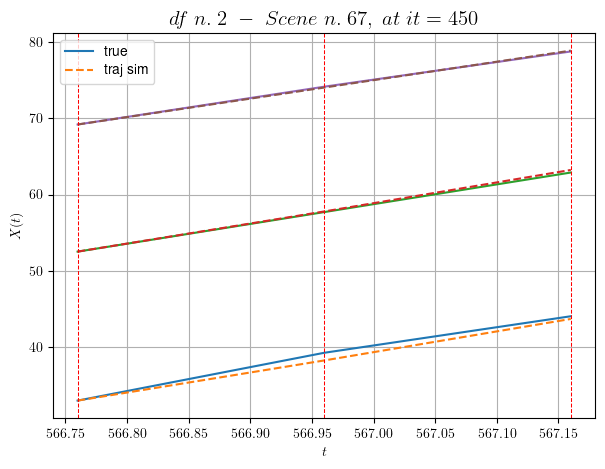

----------------------------------------------------------------------------------------------------
        For scene 33/46:
        * After LR finder: LR_NN=0.005 with mse=0.9234980544524798 at it=24
        * v0 = 24.222521547016918
        * MSE = 0.140922513081384
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.34/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [411.36,412.16]


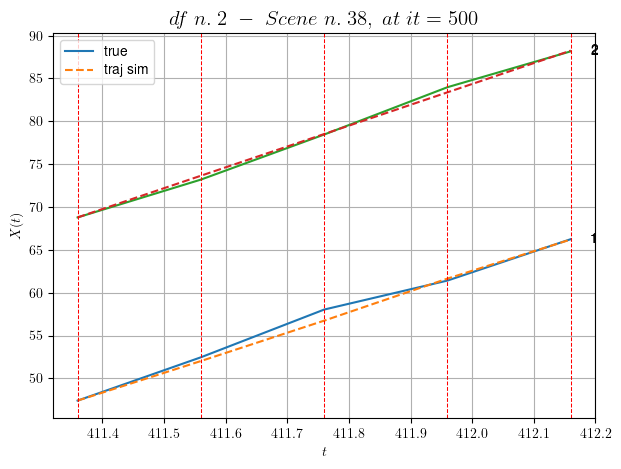

----------------------------------------------------------------------------------------------------
        For scene 34/46:
        * After LR finder: LR_NN=0.005 with mse=3.9328430233966847 at it=24
        * v0 = 24.33774318153054
        * MSE = 0.24692431055749237
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.35/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [314.96,315.36]


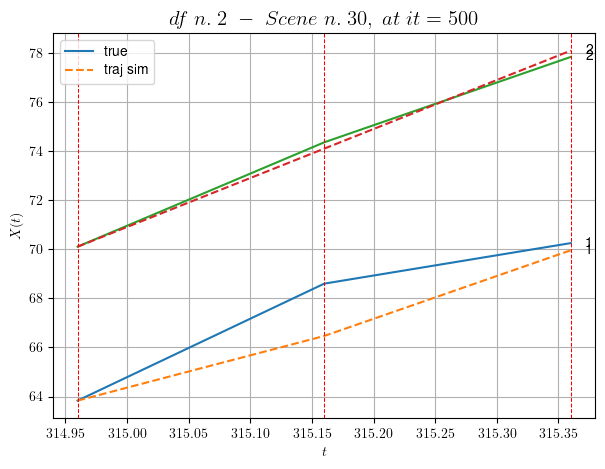

----------------------------------------------------------------------------------------------------
        For scene 35/46:
        * After LR finder: LR_NN=0.01 with mse=4.550681855526649 at it=24
        * v0 = 19.975403002156852
        * MSE = 0.7859892199806365
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.36/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [494.76,495.36]


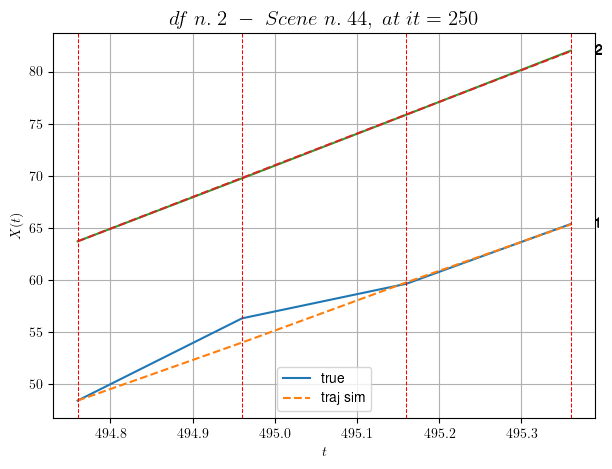

----------------------------------------------------------------------------------------------------
        For scene 36/46:
        * After LR finder: LR_NN=0.001 with mse=1.339938000582746 at it=24
        * v0 = 30.442978606612364
        * MSE = 0.6738292164114014
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.37/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [541.16,542.36]


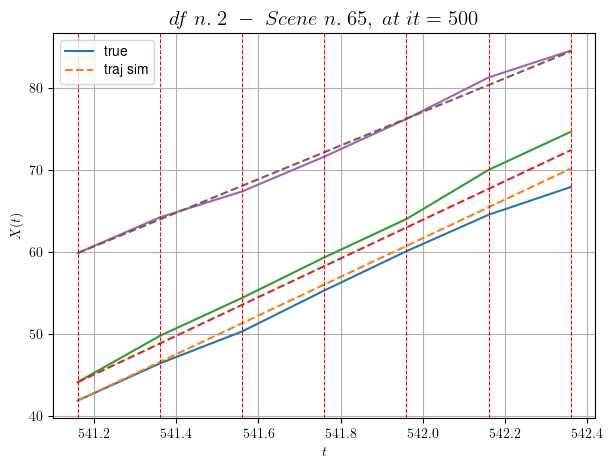

----------------------------------------------------------------------------------------------------
        For scene 37/46:
        * After LR finder: LR_NN=5e-05 with mse=53.0086152148643 at it=24
        * v0 = 20.489990975466768
        * MSE = 1.104393907397491
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.38/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [14.76,15.36]


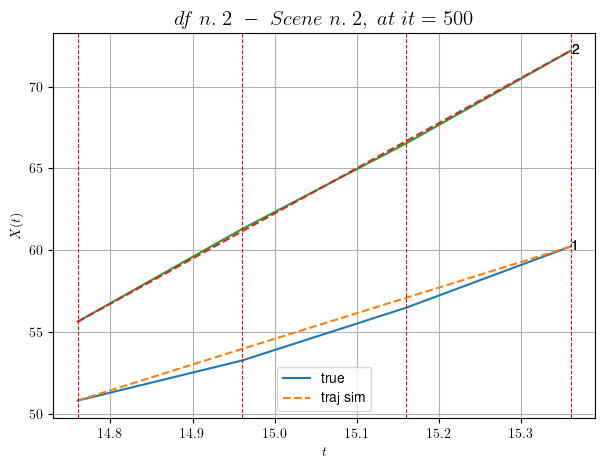

----------------------------------------------------------------------------------------------------
        For scene 38/46:
        * After LR finder: LR_NN=0.001 with mse=0.4611908445522291 at it=24
        * v0 = 27.615406088656982
        * MSE = 0.11260194791335472
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.39/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [109.36,110.16]


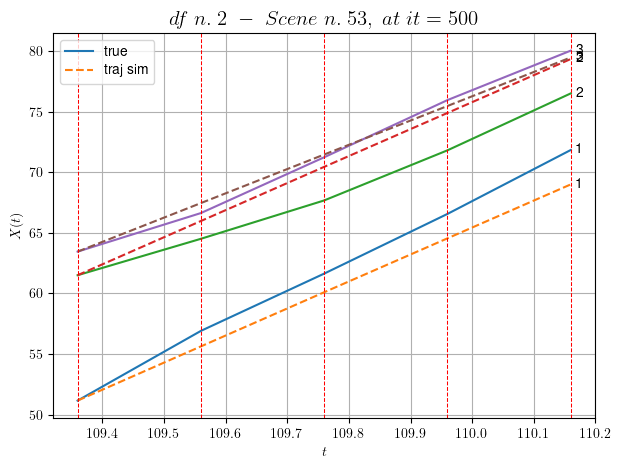

----------------------------------------------------------------------------------------------------
        For scene 39/46:
        * After LR finder: LR_NN=0.001 with mse=10.217127547945148 at it=24
        * v0 = 20.03385870433128
        * MSE = 2.978990724193054
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.40/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [233.36,235.36]


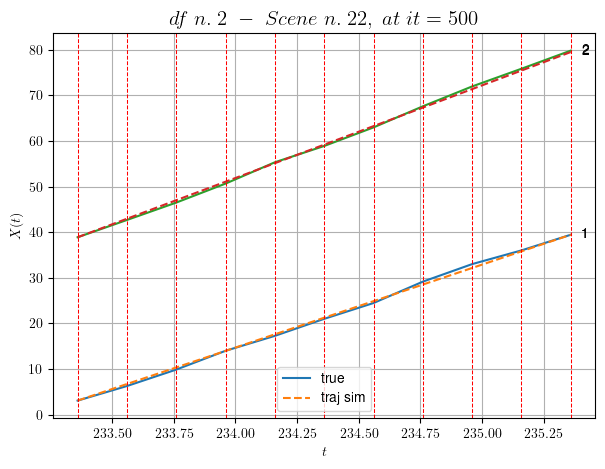

----------------------------------------------------------------------------------------------------
        For scene 40/46:
        * After LR finder: LR_NN=0.001 with mse=64.5200551868355 at it=24
        * v0 = 20.30078342708444
        * MSE = 0.1457952164117805
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.41/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [52.76,53.56]


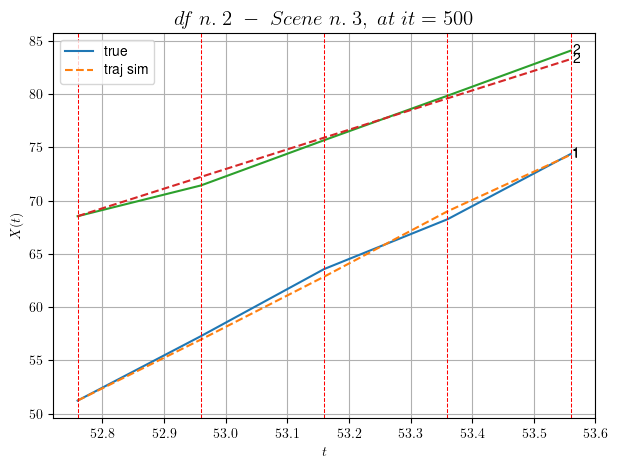

----------------------------------------------------------------------------------------------------
        For scene 41/46:
        * After LR finder: LR_NN=0.01 with mse=15.18975604583577 at it=24
        * v0 = 18.434937295304334
        * MSE = 0.2562048562337954
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.42/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [250.16,250.96]


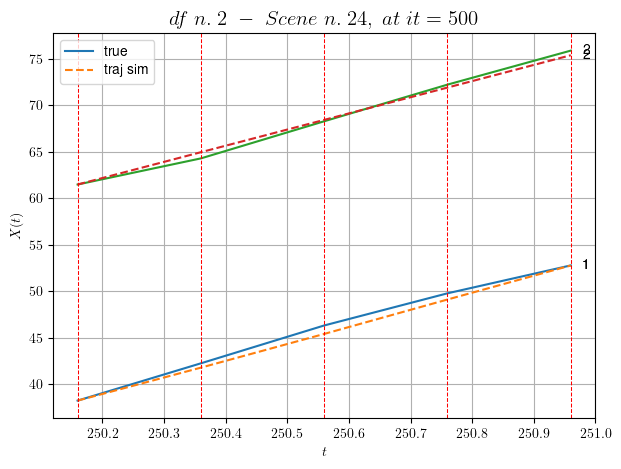

----------------------------------------------------------------------------------------------------
        For scene 42/46:
        * After LR finder: LR_NN=0.005 with mse=18.426545569054596 at it=24
        * v0 = 17.364515373913115
        * MSE = 0.2289397524355893
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.43/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [223.16,223.56]


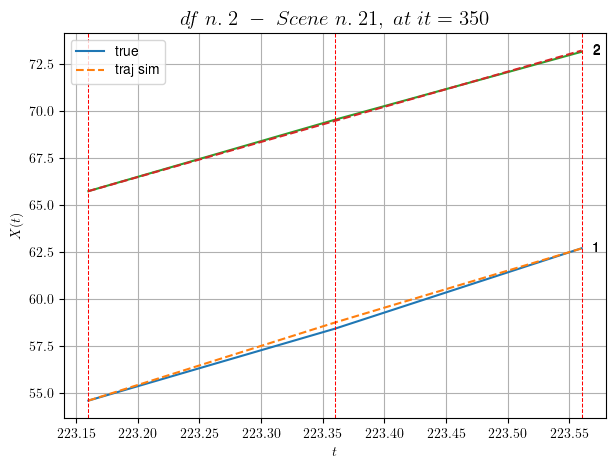

----------------------------------------------------------------------------------------------------
        For scene 43/46:
        * After LR finder: LR_NN=0.01 with mse=4.328764803242328 at it=24
        * v0 = 18.698370395222643
        * MSE = 0.019287784115088167
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.44/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [442.76,443.76]


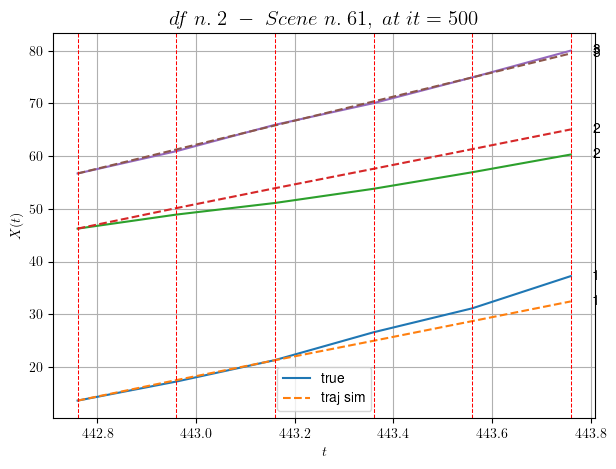

----------------------------------------------------------------------------------------------------
        For scene 44/46:
        * After LR finder: LR_NN=0.005 with mse=11.523453841538236 at it=24
        * v0 = 22.77589680250503
        * MSE = 5.4309853983841085
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.45/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [198.16,200.16]


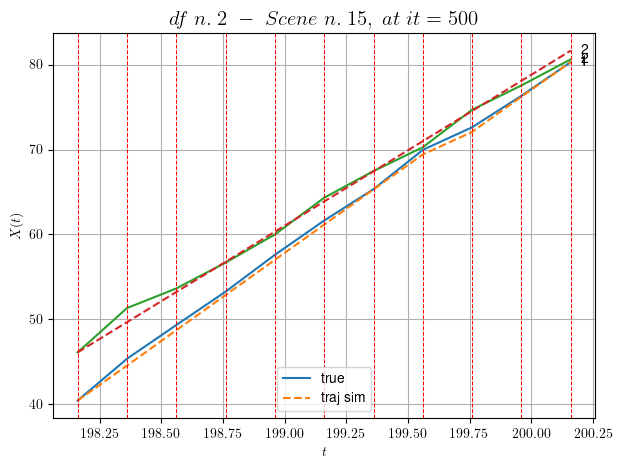

----------------------------------------------------------------------------------------------------
        For scene 45/46:
        * After LR finder: LR_NN=0.005 with mse=108.7537757642371 at it=24
        * v0 = 17.756279251513035
        * MSE = 0.33406005996960064
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.46/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.16,86.96]


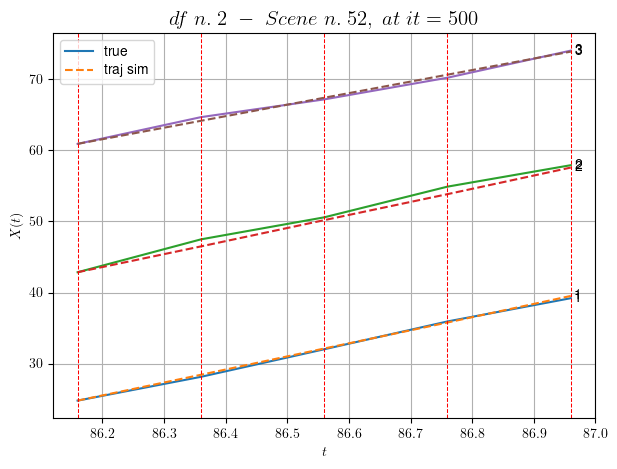

----------------------------------------------------------------------------------------------------
        For scene 46/46:
        * After LR finder: LR_NN=0.005 with mse=15.629556644026865 at it=24
        * v0 = 16.23533006014578
        * MSE = 0.20659357287172622
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.6518181804328461
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (23 scenes)
DataFrame n.2. Scene n.1/23


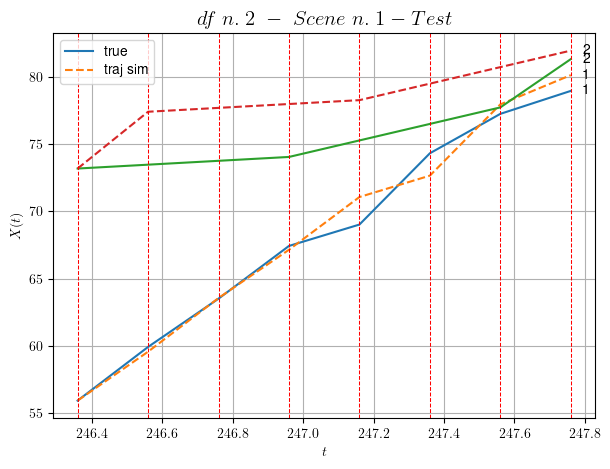

        For scene 1/23:
        * MSE = 5.1768835659785095
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/23


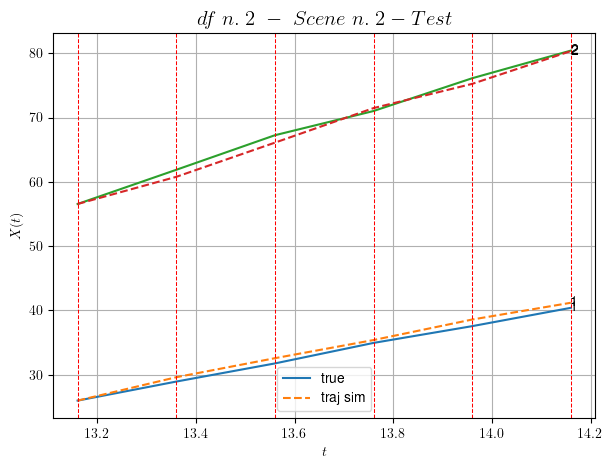

        For scene 2/23:
        * MSE = 0.54239656461057
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/23


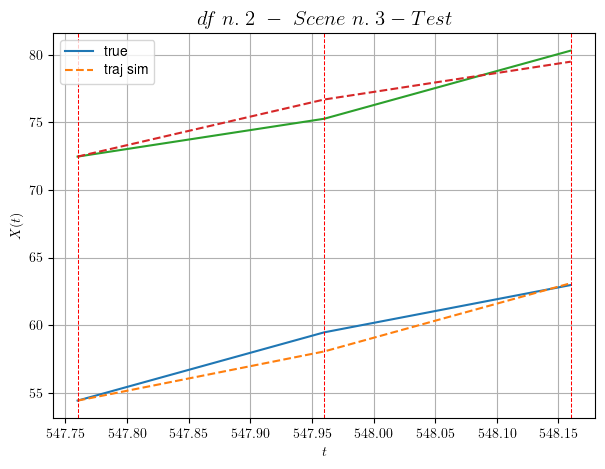

        For scene 3/23:
        * MSE = 0.7847824620334722
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/23


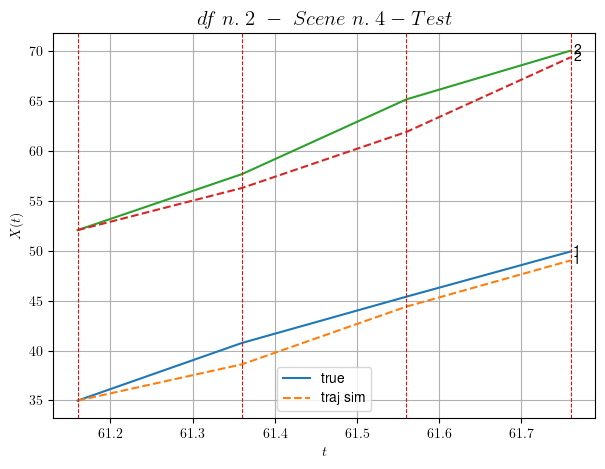

        For scene 4/23:
        * MSE = 2.4244706740036084
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/23


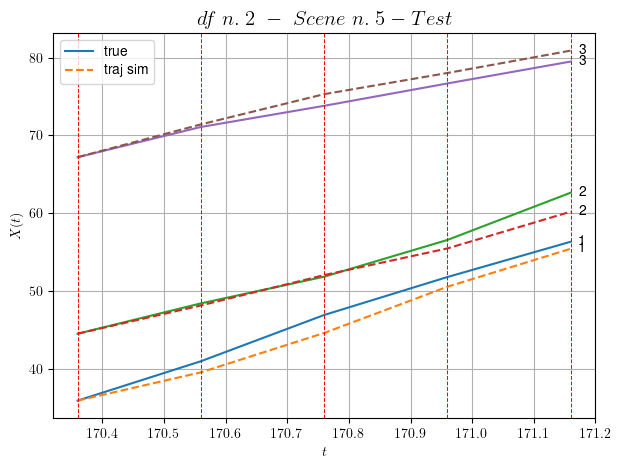

        For scene 5/23:
        * MSE = 1.546174199524338
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/23


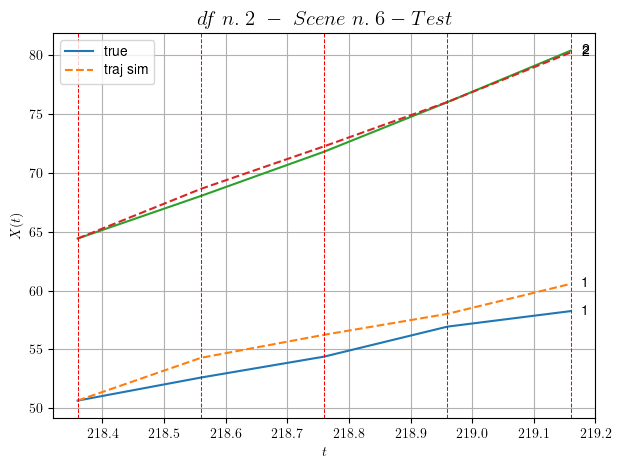

        For scene 6/23:
        * MSE = 1.3408450380248764
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/23


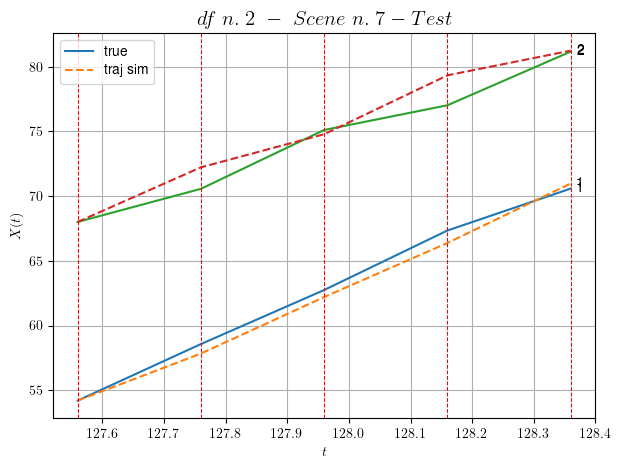

        For scene 7/23:
        * MSE = 1.0146499207549977
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/23


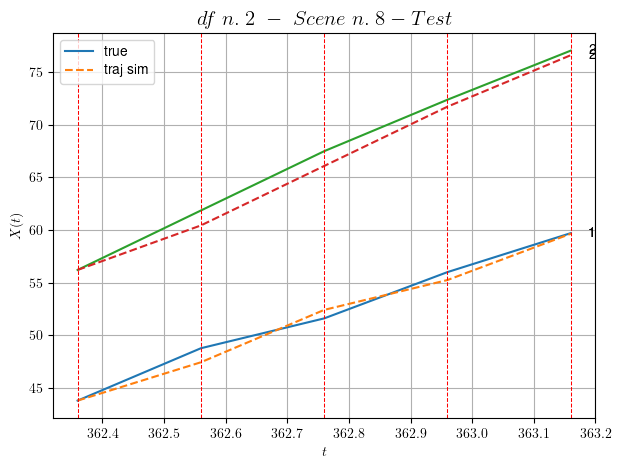

        For scene 8/23:
        * MSE = 0.7589133661994447
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/23


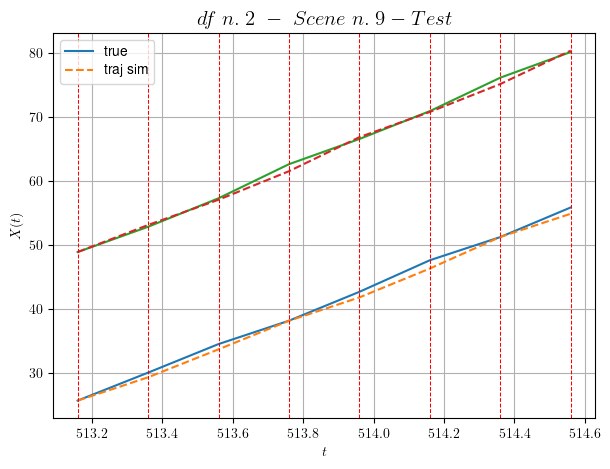

        For scene 9/23:
        * MSE = 0.4419902771573035
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/23


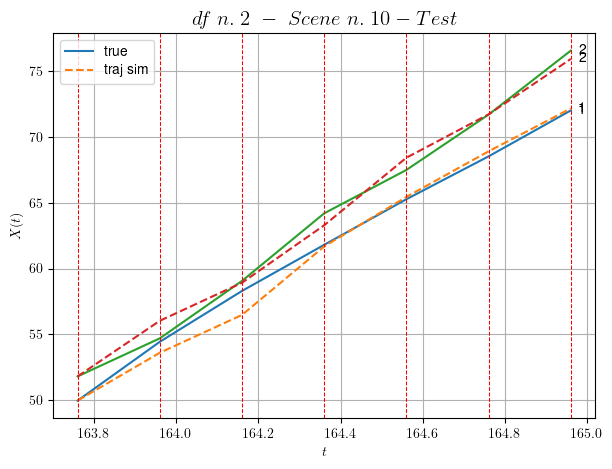

        For scene 10/23:
        * MSE = 0.5796232997705333
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/23


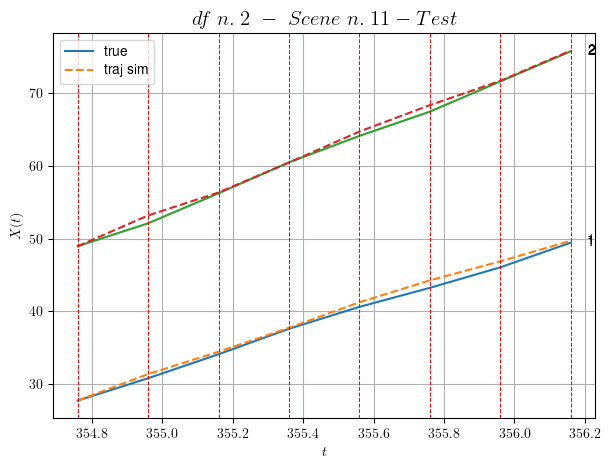

        For scene 11/23:
        * MSE = 0.31092177483556716
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/23


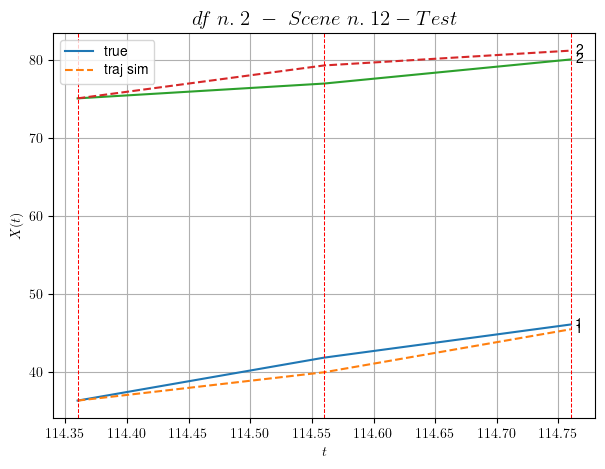

        For scene 12/23:
        * MSE = 1.761991637605627
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/23


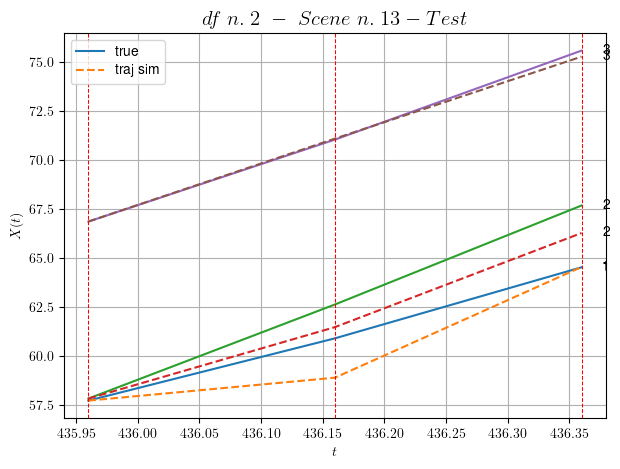

        For scene 13/23:
        * MSE = 0.8224105490108281
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/23


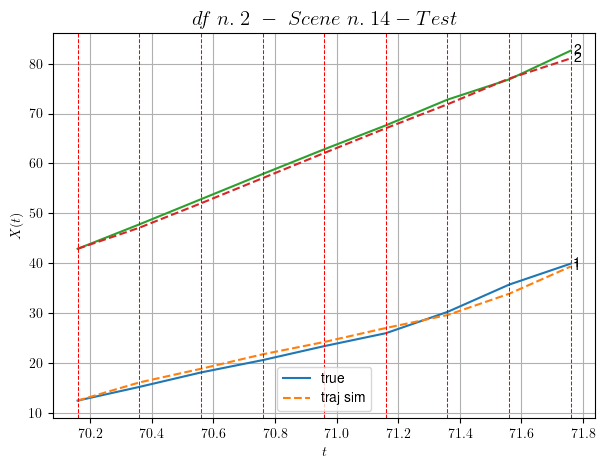

        For scene 14/23:
        * MSE = 0.8097825022395744
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/23


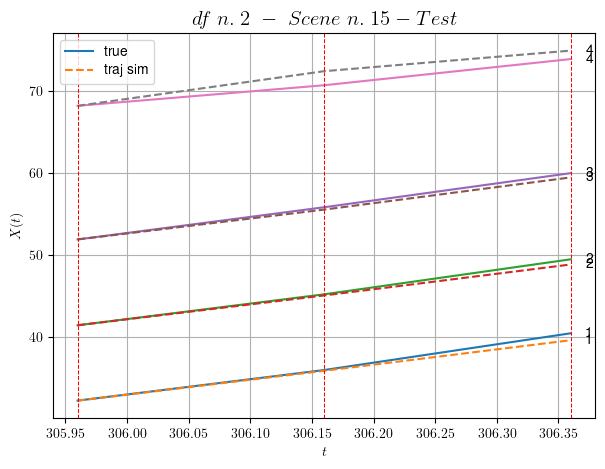

        For scene 15/23:
        * MSE = 0.4583350285472314
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/23


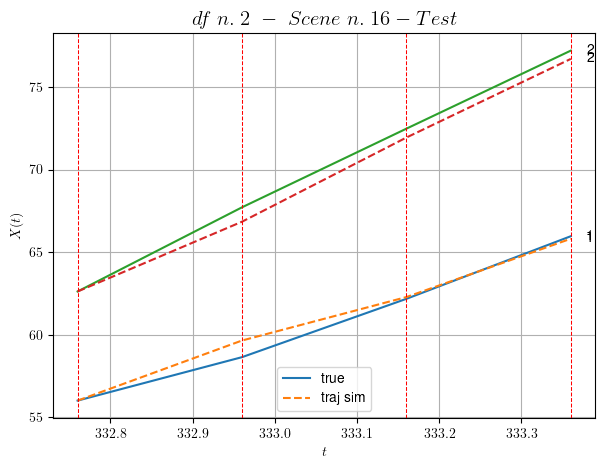

        For scene 16/23:
        * MSE = 0.2934193400443992
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/23


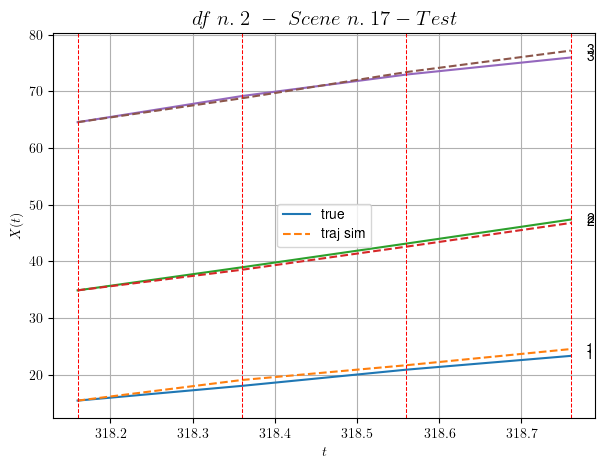

        For scene 17/23:
        * MSE = 0.4838461702367742
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/23


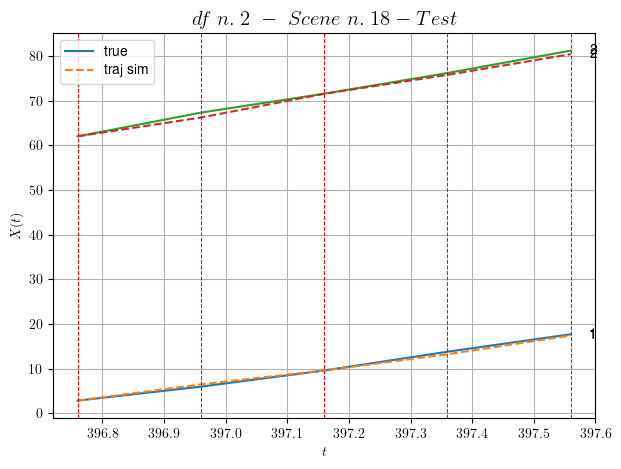

        For scene 18/23:
        * MSE = 0.26405015296803047
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/23


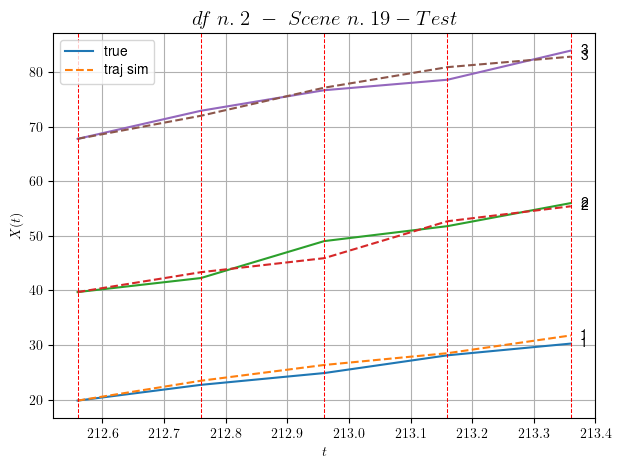

        For scene 19/23:
        * MSE = 1.6500067449588318
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/23


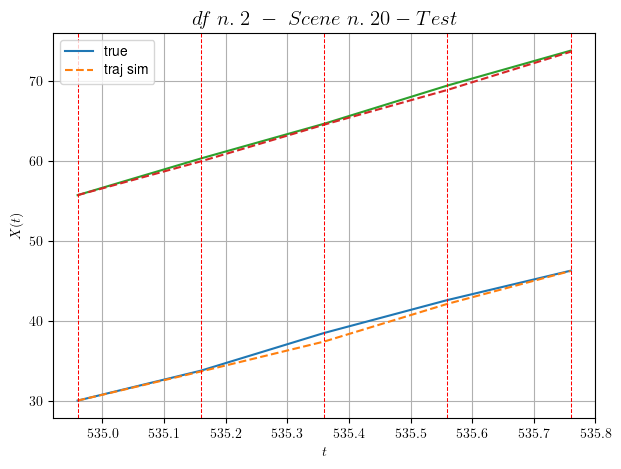

        For scene 20/23:
        * MSE = 0.18457572844483833
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/23


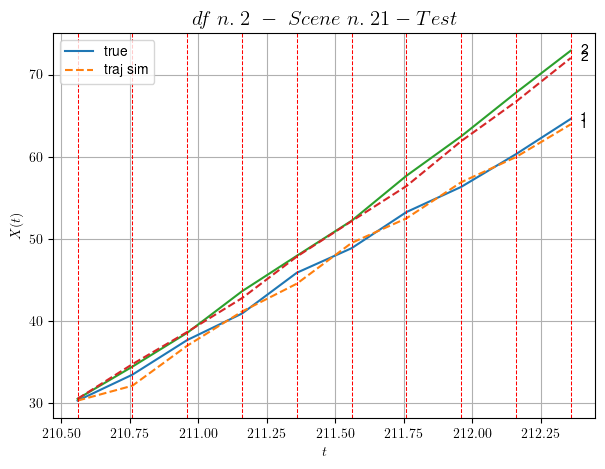

        For scene 21/23:
        * MSE = 0.5377218743820147
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/23


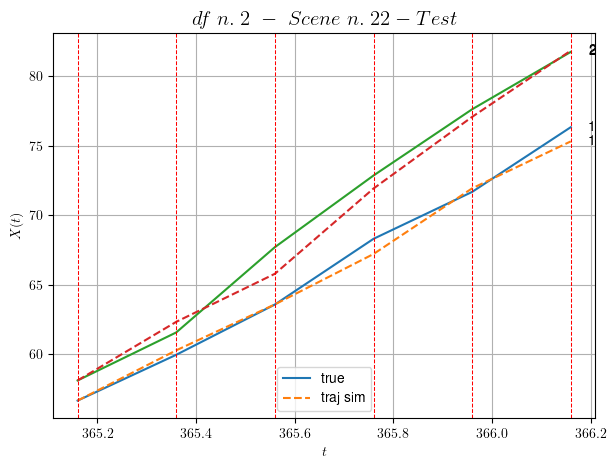

        For scene 22/23:
        * MSE = 0.654600043206854
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/23


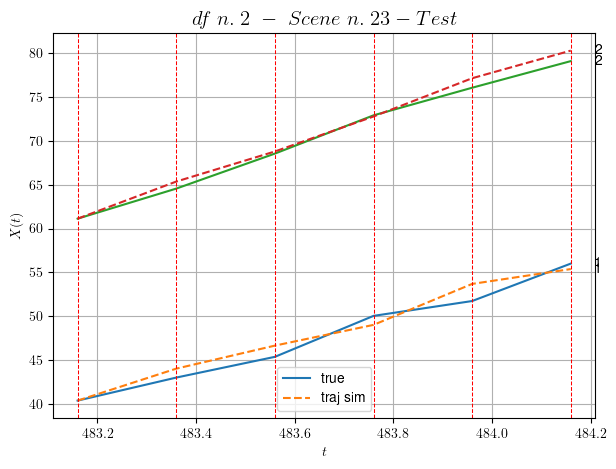

        For scene 23/23:
        * MSE = 0.9337041450508896
----------------------------------------------------------------------------------------------------


MSE test: 1.0337432634603962

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6518181804328461
          * MSE test: 1.0337432634603962
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 3/10 dfs.
In DataFrame n.3 we have 90 scenes.
    To train the model we use 60 scenes, the remaining 30 to test the model.

Training step. (60 scenes)
DataFrame n.3. Scene n.1/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [215.56,216.36]


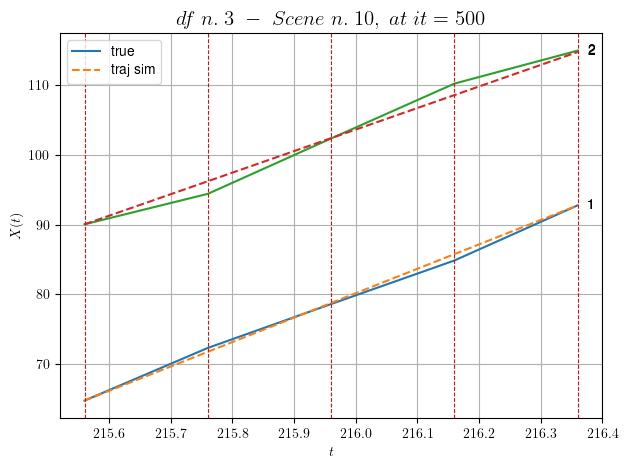

----------------------------------------------------------------------------------------------------
        For scene 1/60:
        * After LR finder: LR_NN=5e-05 with mse=0.8734447740542277 at it=24
        * v0 = 30.842897264970112
        * MSE = 0.6956082527875401
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [487.16,487.56]


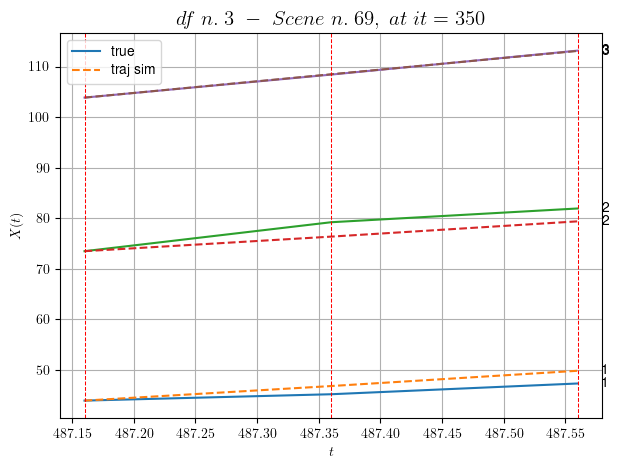

----------------------------------------------------------------------------------------------------
        For scene 2/60:
        * After LR finder: LR_NN=0.005 with mse=3.6666745785227506 at it=24
        * v0 = 23.071881683467694
        * MSE = 2.6134941216846515
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/60
----------------------------------------------------------------------------------------------------
We have 17 time intervals inside [138.16,141.56]


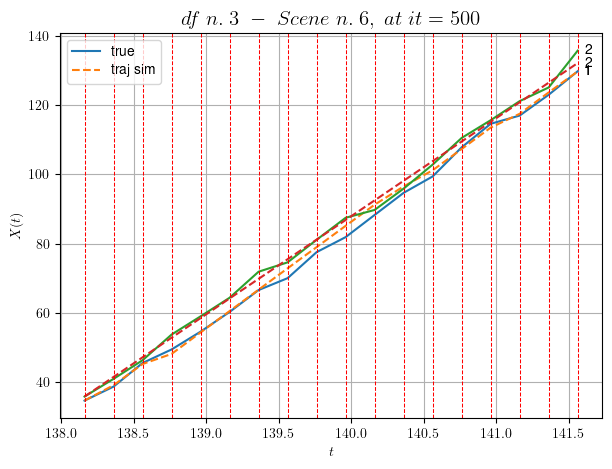

----------------------------------------------------------------------------------------------------
        For scene 3/60:
        * After LR finder: LR_NN=0.005 with mse=7.211614157991422 at it=24
        * v0 = 28.318639127967682
        * MSE = 1.7901031874626936
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [72.76,74.16]


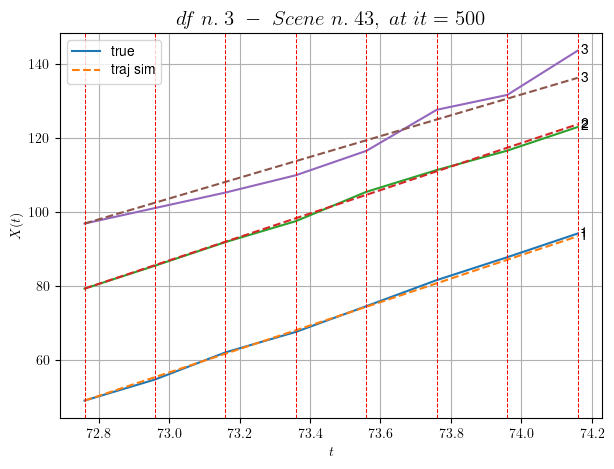

----------------------------------------------------------------------------------------------------
        For scene 4/60:
        * After LR finder: LR_NN=0.001 with mse=3.7396986030564654 at it=24
        * v0 = 28.121240263140265
        * MSE = 3.696170975559125
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [143.76,144.36]


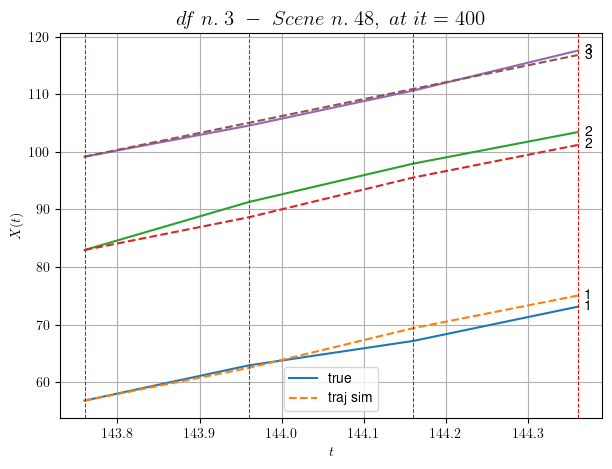

----------------------------------------------------------------------------------------------------
        For scene 5/60:
        * After LR finder: LR_NN=0.01 with mse=2.3833588627197897 at it=24
        * v0 = 29.414745218124246
        * MSE = 2.272140415591446
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [338.36,338.96]


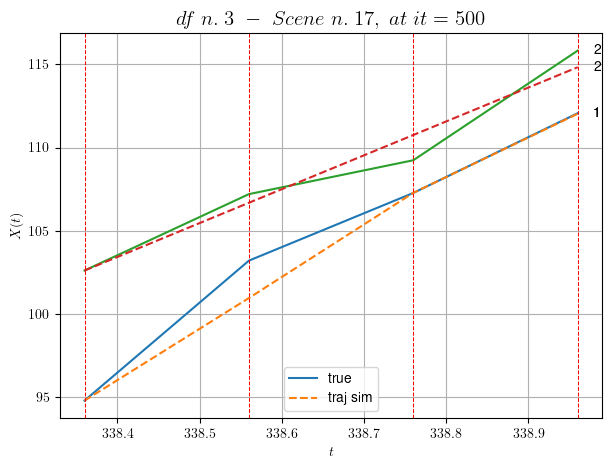

----------------------------------------------------------------------------------------------------
        For scene 6/60:
        * After LR finder: LR_NN=0.001 with mse=7.541116931740255 at it=24
        * v0 = 20.358070226672417
        * MSE = 1.074662051580829
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [130.96,131.96]


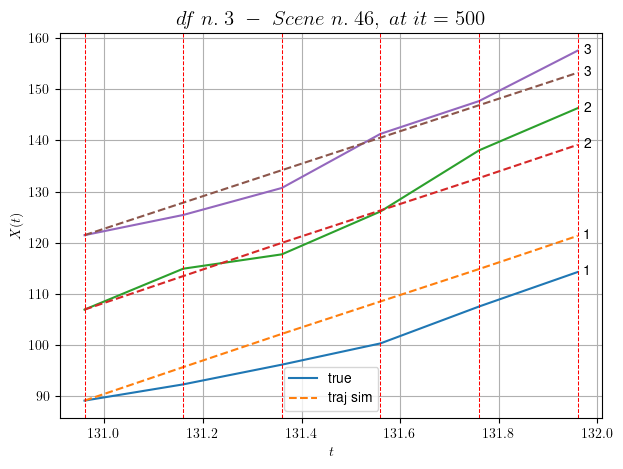

----------------------------------------------------------------------------------------------------
        For scene 7/60:
        * After LR finder: LR_NN=0.001 with mse=20.406865170285425 at it=24
        * v0 = 31.752337885123463
        * MSE = 18.90448525096163
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [590.36,591.76]


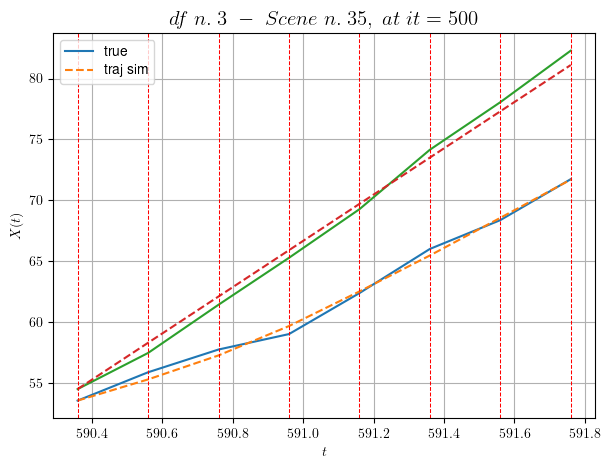

----------------------------------------------------------------------------------------------------
        For scene 8/60:
        * After LR finder: LR_NN=0.001 with mse=47.36790140116489 at it=24
        * v0 = 19.035476639426847
        * MSE = 0.34230435049645247
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [183.16,183.76]


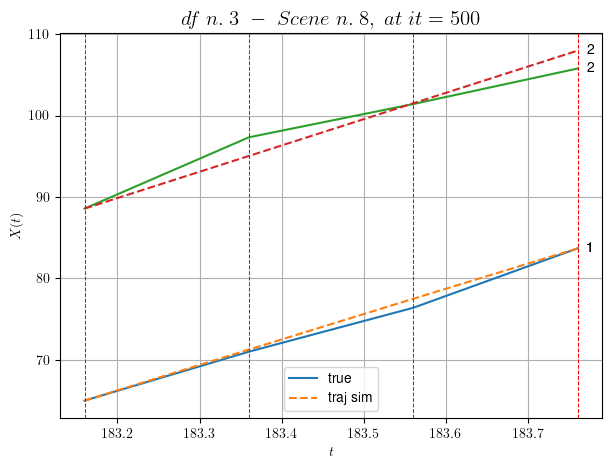

----------------------------------------------------------------------------------------------------
        For scene 9/60:
        * After LR finder: LR_NN=0.001 with mse=1.320467269365004 at it=24
        * v0 = 32.31398331046871
        * MSE = 1.1914197884693012
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [33.76,34.36]


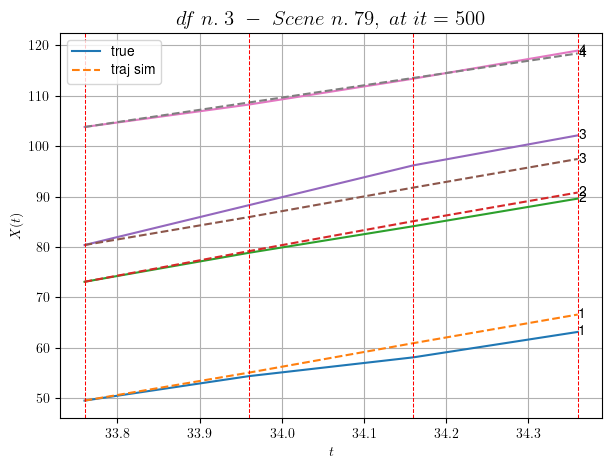

----------------------------------------------------------------------------------------------------
        For scene 10/60:
        * After LR finder: LR_NN=0.01 with mse=5.230998004555402 at it=24
        * v0 = 24.315647482967435
        * MSE = 4.236713595373539
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [486.56,487.56]


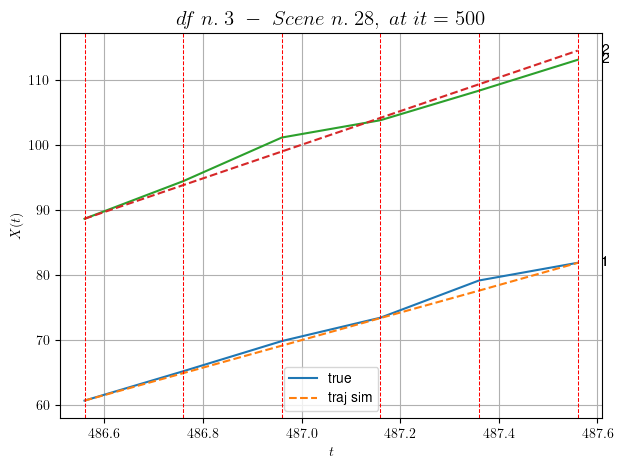

----------------------------------------------------------------------------------------------------
        For scene 11/60:
        * After LR finder: LR_NN=0.001 with mse=5.233370271422441 at it=24
        * v0 = 25.85811943170945
        * MSE = 0.9210830479487001
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [402.76,403.56]


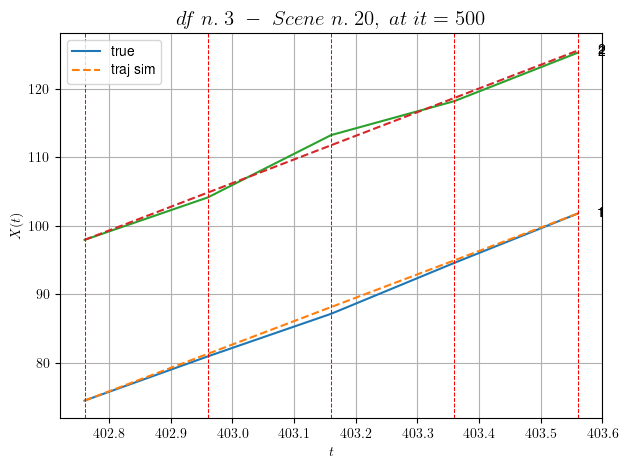

----------------------------------------------------------------------------------------------------
        For scene 12/60:
        * After LR finder: LR_NN=0.0001 with mse=2.803648721168698 at it=24
        * v0 = 34.51967072229631
        * MSE = 0.3859529425394177
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [248.16,248.56]


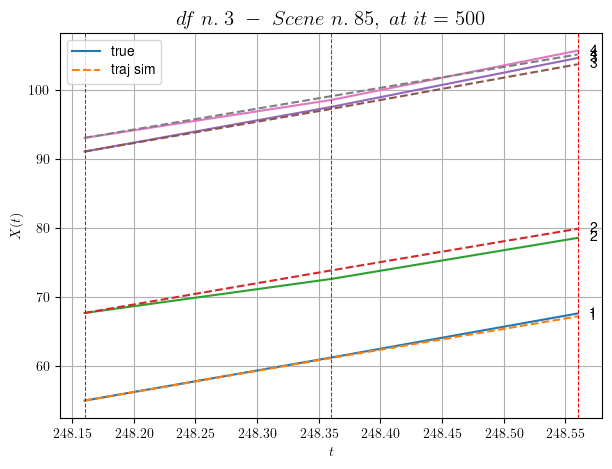

----------------------------------------------------------------------------------------------------
        For scene 13/60:
        * After LR finder: LR_NN=0.005 with mse=0.5303031227585466 at it=24
        * v0 = 30.24897060982766
        * MSE = 0.4134749950764247
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/60
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [464.56,466.56]


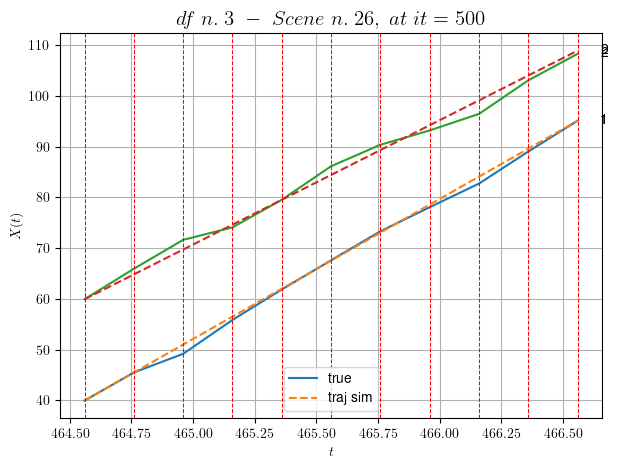

----------------------------------------------------------------------------------------------------
        For scene 14/60:
        * After LR finder: LR_NN=0.001 with mse=24.84688394652074 at it=24
        * v0 = 24.49860270488126
        * MSE = 1.1307390959768118
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [247.36,248.56]


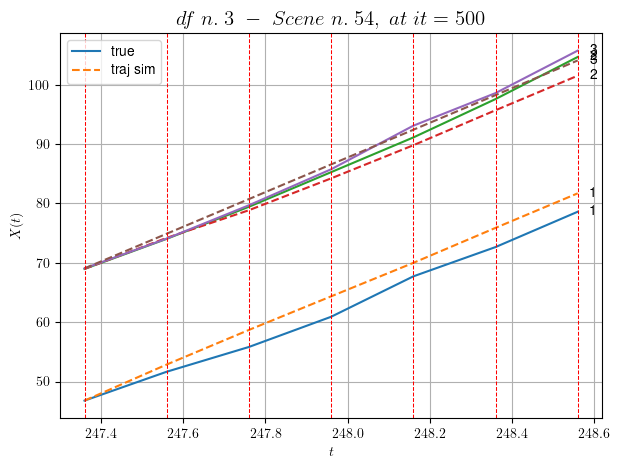

----------------------------------------------------------------------------------------------------
        For scene 15/60:
        * After LR finder: LR_NN=0.01 with mse=1.612437827340762 at it=24
        * v0 = 29.199545092787723
        * MSE = 2.5879249797653148
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/60
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [292.56,294.56]


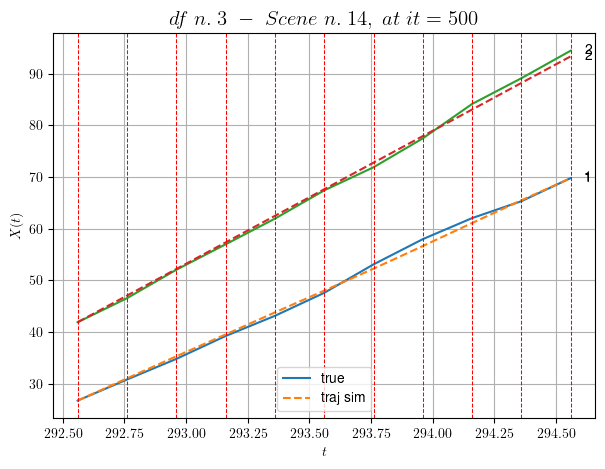

----------------------------------------------------------------------------------------------------
        For scene 16/60:
        * After LR finder: LR_NN=0.01 with mse=11.971326177525567 at it=24
        * v0 = 25.740986248381873
        * MSE = 0.3985691455407141
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [438.16,438.76]


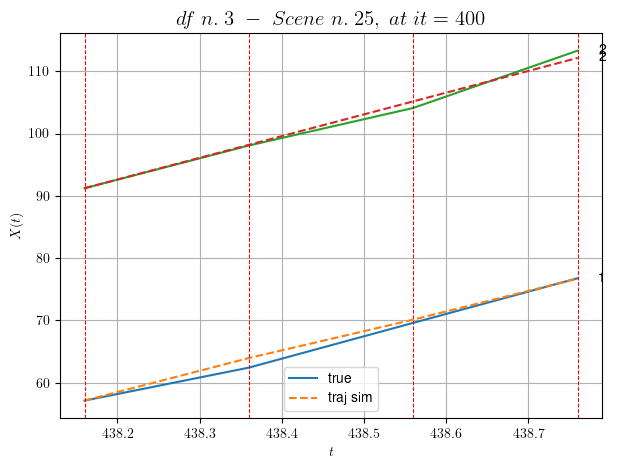

----------------------------------------------------------------------------------------------------
        For scene 17/60:
        * After LR finder: LR_NN=0.005 with mse=2.6703891207471773 at it=24
        * v0 = 34.86837808705316
        * MSE = 0.6440074378574632
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [79.56,80.36]


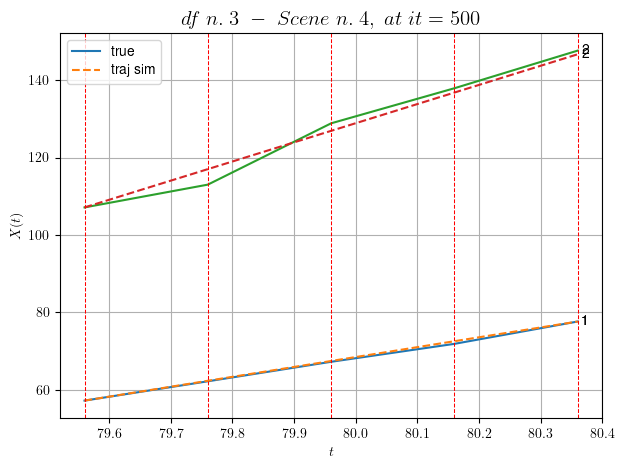

----------------------------------------------------------------------------------------------------
        For scene 18/60:
        * After LR finder: LR_NN=0.001 with mse=52.952270597432694 at it=24
        * v0 = 49.42636153730838
        * MSE = 2.2425640332447716
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [377.56,378.36]


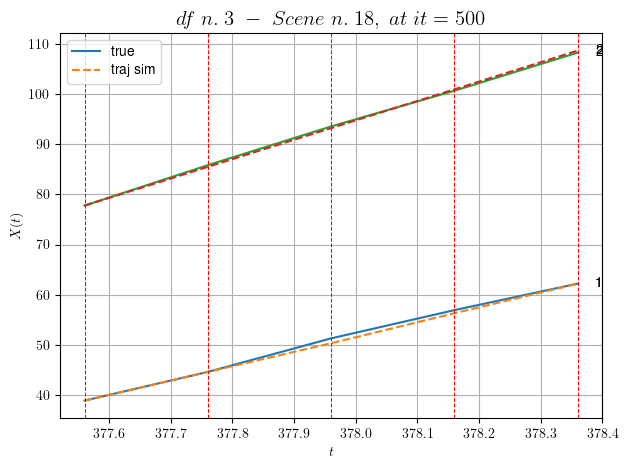

----------------------------------------------------------------------------------------------------
        For scene 19/60:
        * After LR finder: LR_NN=0.005 with mse=8.631920812961031 at it=24
        * v0 = 38.59992828377785
        * MSE = 0.17732489866261059
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [42.96,43.76]


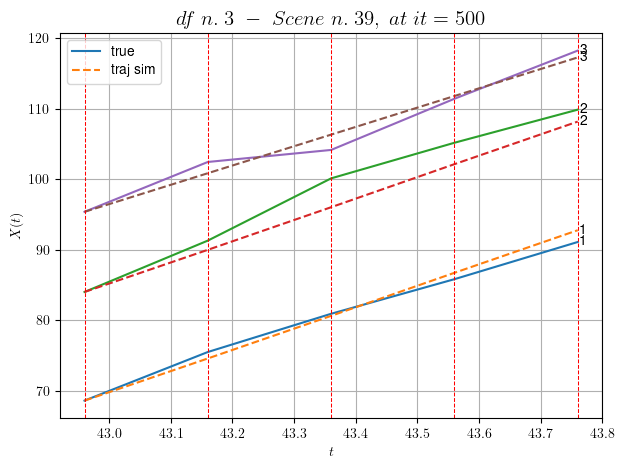

----------------------------------------------------------------------------------------------------
        For scene 20/60:
        * After LR finder: LR_NN=0.001 with mse=3.573935384894377 at it=24
        * v0 = 27.35067344092259
        * MSE = 2.883034600199691
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/60
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [199.96,201.56]


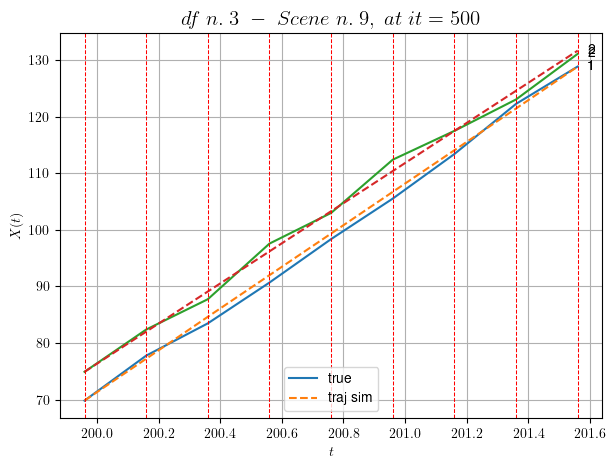

----------------------------------------------------------------------------------------------------
        For scene 21/60:
        * After LR finder: LR_NN=0.001 with mse=14.063115939968727 at it=24
        * v0 = 35.482633927758314
        * MSE = 0.971528888041177
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [393.36,393.76]


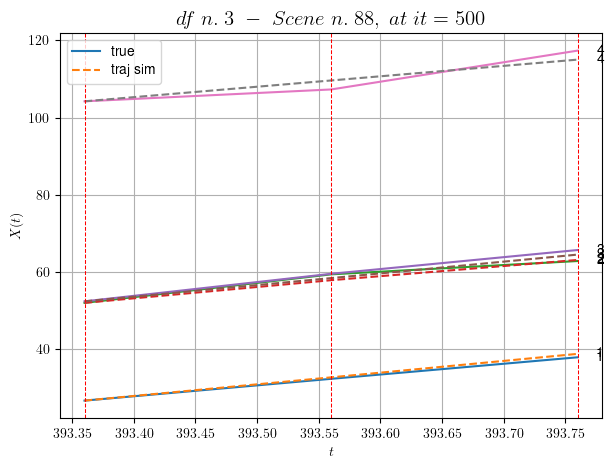

----------------------------------------------------------------------------------------------------
        For scene 22/60:
        * After LR finder: LR_NN=0.001 with mse=35.194018150912726 at it=24
        * v0 = 27.00629353640551
        * MSE = 1.2884852819550707
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [154.56,155.36]


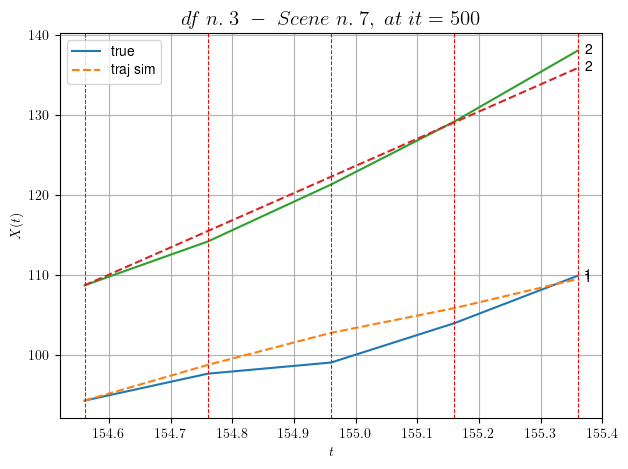

----------------------------------------------------------------------------------------------------
        For scene 23/60:
        * After LR finder: LR_NN=0.01 with mse=5.7837926937304625 at it=24
        * v0 = 33.88242010375711
        * MSE = 2.5144469280679598
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [448.36,448.76]


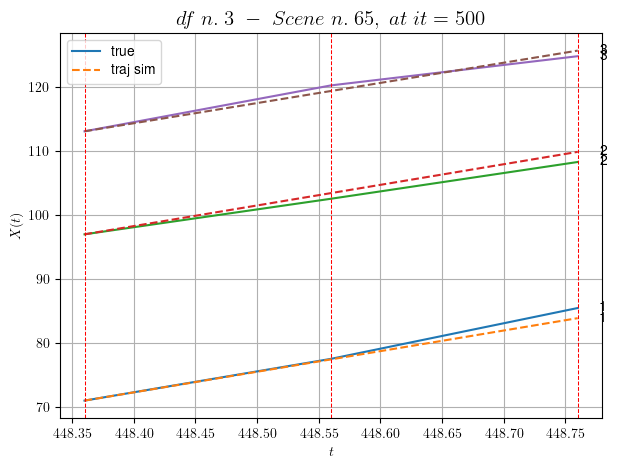

----------------------------------------------------------------------------------------------------
        For scene 24/60:
        * After LR finder: LR_NN=0.0001 with mse=0.5734137809440556 at it=24
        * v0 = 31.58504818637793
        * MSE = 0.8089818875012732
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [17.56,17.96]


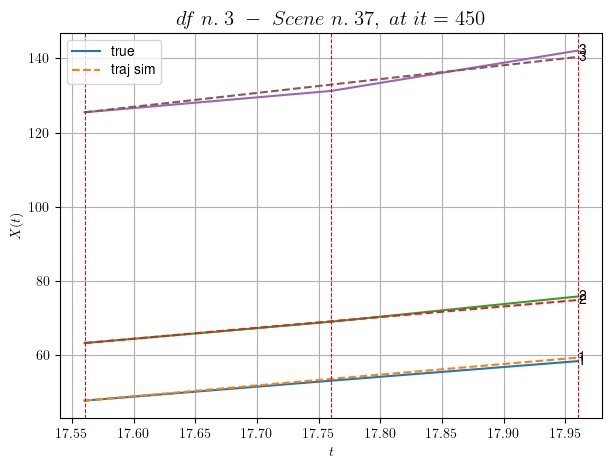

----------------------------------------------------------------------------------------------------
        For scene 25/60:
        * After LR finder: LR_NN=0.005 with mse=2.6362760920325607 at it=24
        * v0 = 37.34160747309791
        * MSE = 0.877178424183696
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [83.36,84.56]


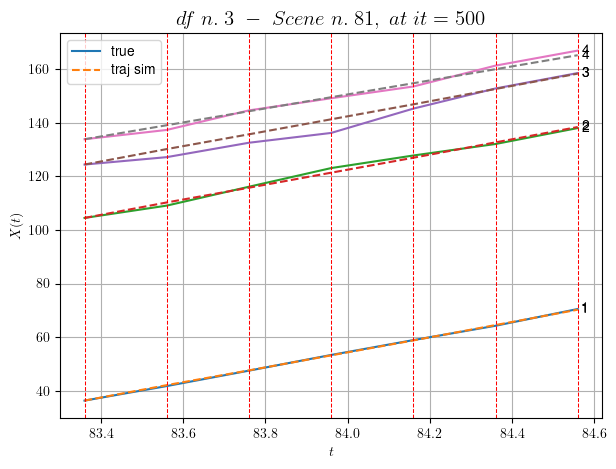

----------------------------------------------------------------------------------------------------
        For scene 26/60:
        * After LR finder: LR_NN=0.005 with mse=3.5725927728795845 at it=24
        * v0 = 26.107724197314273
        * MSE = 2.134098164249558
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [95.36,95.76]


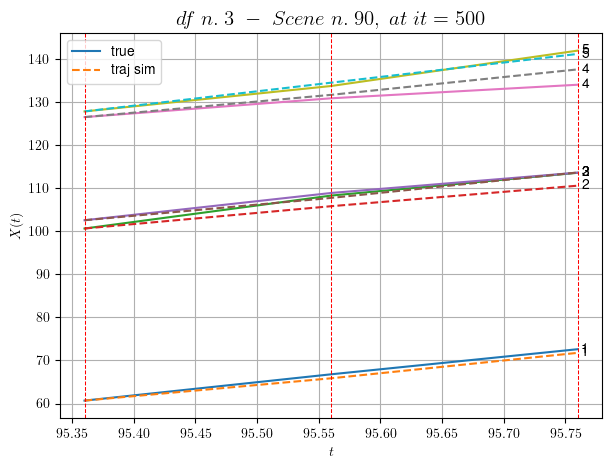

----------------------------------------------------------------------------------------------------
        For scene 27/60:
        * After LR finder: LR_NN=0.01 with mse=2.414174243403441 at it=24
        * v0 = 33.35137428698106
        * MSE = 2.1208740353569544
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [269.56,270.96]


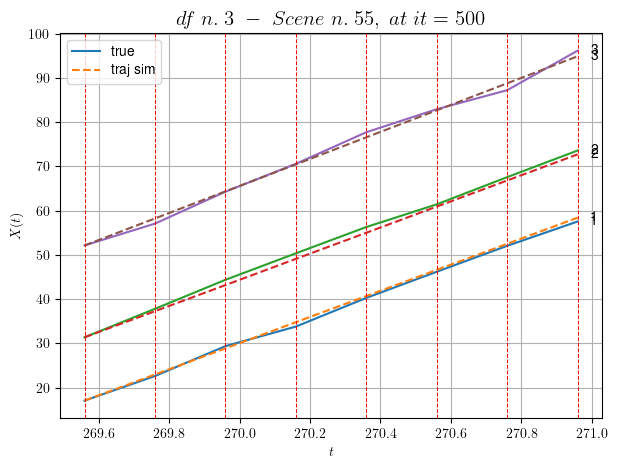

----------------------------------------------------------------------------------------------------
        For scene 28/60:
        * After LR finder: LR_NN=0.001 with mse=0.7806327301718786 at it=24
        * v0 = 30.539175669712357
        * MSE = 0.6673741927445835
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


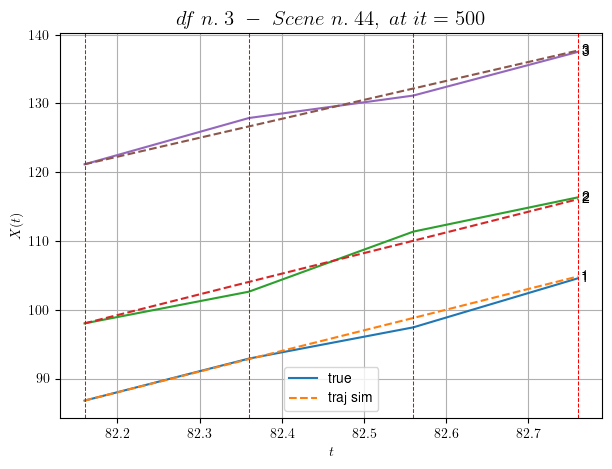

----------------------------------------------------------------------------------------------------
        For scene 29/60:
        * After LR finder: LR_NN=0.001 with mse=1.0892034280602454 at it=24
        * v0 = 27.550237413707062
        * MSE = 0.6966902818054601
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [207.96,208.76]


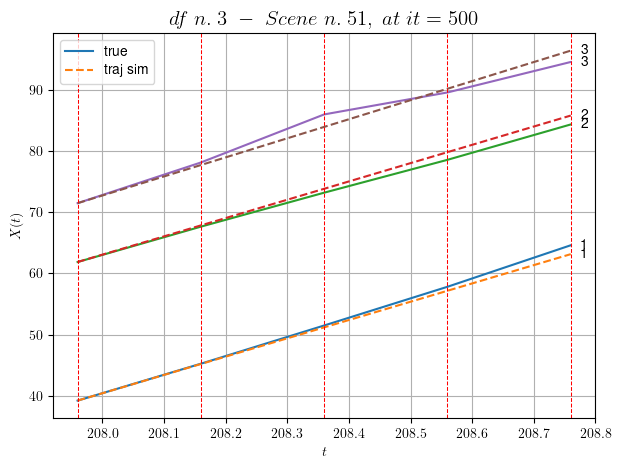

----------------------------------------------------------------------------------------------------
        For scene 30/60:
        * After LR finder: LR_NN=5e-05 with mse=10.522876994684355 at it=24
        * v0 = 31.124909645190968
        * MSE = 0.9610991884312861
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.31/60
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [139.16,141.56]


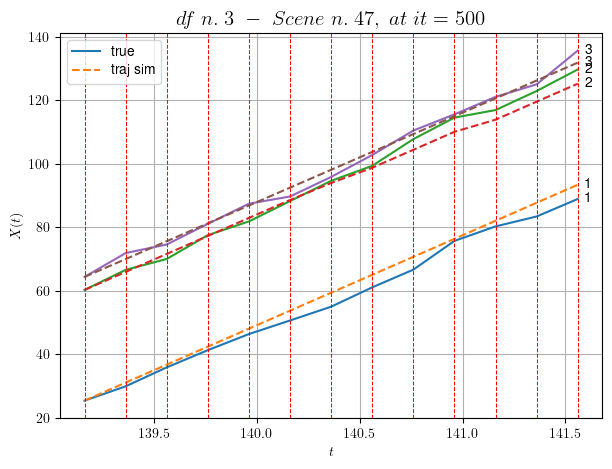

----------------------------------------------------------------------------------------------------
        For scene 31/60:
        * After LR finder: LR_NN=0.001 with mse=5.88805840635284 at it=24
        * v0 = 28.14463056725917
        * MSE = 3.8362956368349717
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.32/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [390.36,390.76]


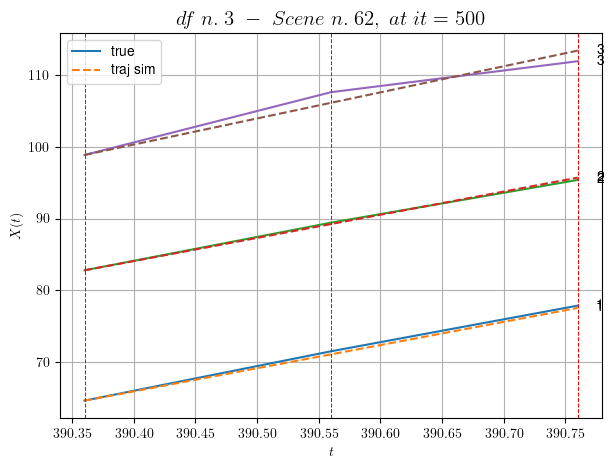

----------------------------------------------------------------------------------------------------
        For scene 32/60:
        * After LR finder: LR_NN=0.0005 with mse=2.733659647666713 at it=24
        * v0 = 36.35426043628911
        * MSE = 0.48565425780269594
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.33/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [521.76,522.76]


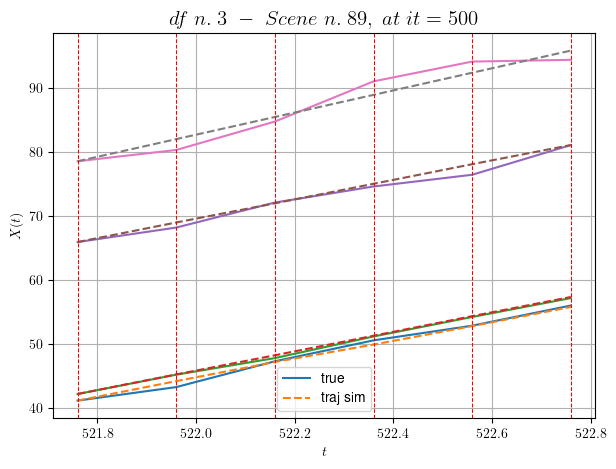

----------------------------------------------------------------------------------------------------
        For scene 33/60:
        * After LR finder: LR_NN=0.005 with mse=15.007728780012792 at it=24
        * v0 = 17.247787667047138
        * MSE = 0.7484477958920759
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.34/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [331.56,332.56]


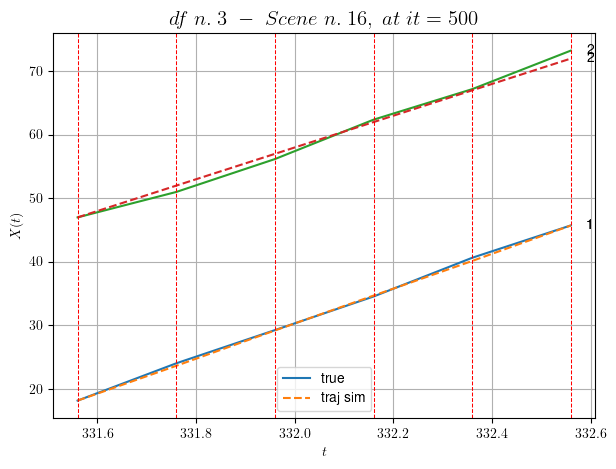

----------------------------------------------------------------------------------------------------
        For scene 34/60:
        * After LR finder: LR_NN=0.005 with mse=4.007835559940678 at it=24
        * v0 = 25.002166879949137
        * MSE = 0.29740902559287913
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.35/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [530.36,530.96]


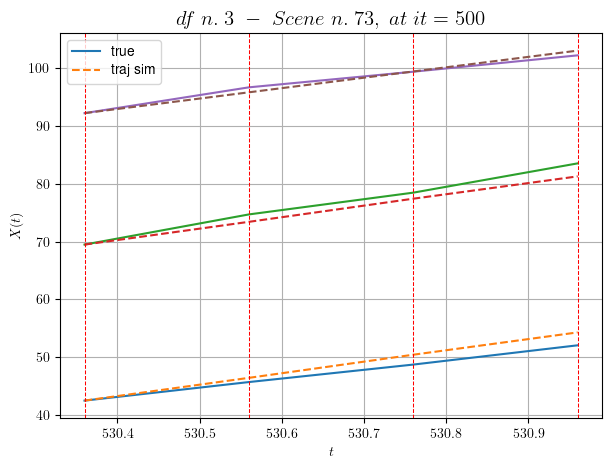

----------------------------------------------------------------------------------------------------
        For scene 35/60:
        * After LR finder: LR_NN=0.005 with mse=8.80796569481146 at it=24
        * v0 = 18.054855152787685
        * MSE = 1.4736163578098933
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.36/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [67.16,67.76]


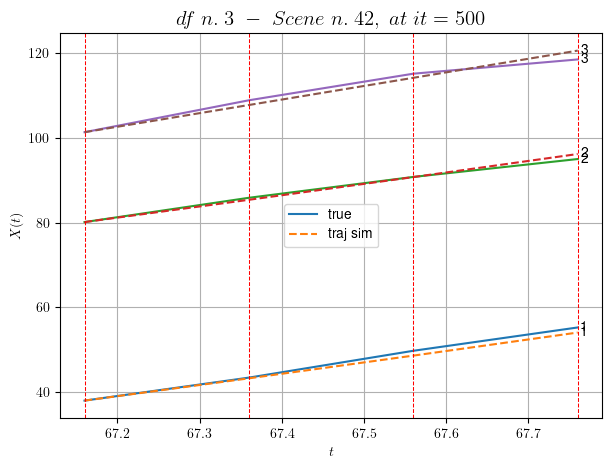

----------------------------------------------------------------------------------------------------
        For scene 36/60:
        * After LR finder: LR_NN=0.005 with mse=0.9263850516156896 at it=24
        * v0 = 32.13932154245631
        * MSE = 0.8801037239184937
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.37/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [335.76,336.16]


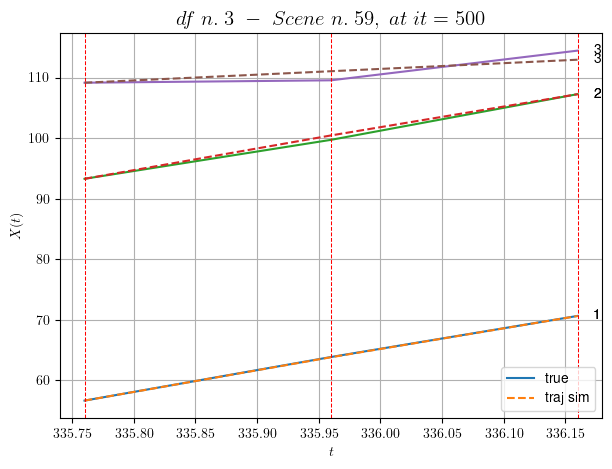

----------------------------------------------------------------------------------------------------
        For scene 37/60:
        * After LR finder: LR_NN=0.01 with mse=8.57552921989304 at it=24
        * v0 = 9.495680524398844
        * MSE = 0.5499206575735608
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.38/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [149.36,149.96]


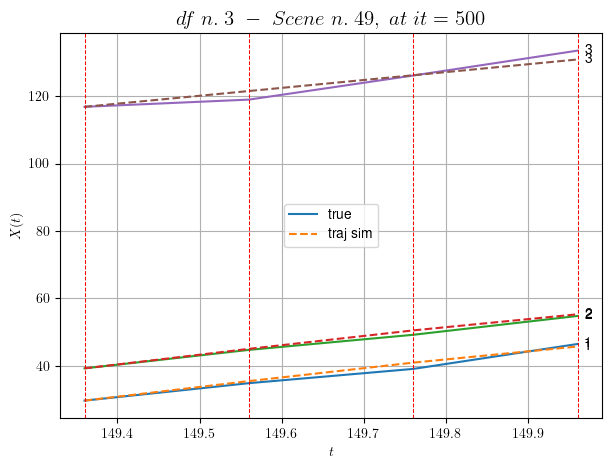

----------------------------------------------------------------------------------------------------
        For scene 38/60:
        * After LR finder: LR_NN=0.01 with mse=2.8427198542110315 at it=24
        * v0 = 23.443555328521928
        * MSE = 1.6533118254033343
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.39/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [34.96,35.36]


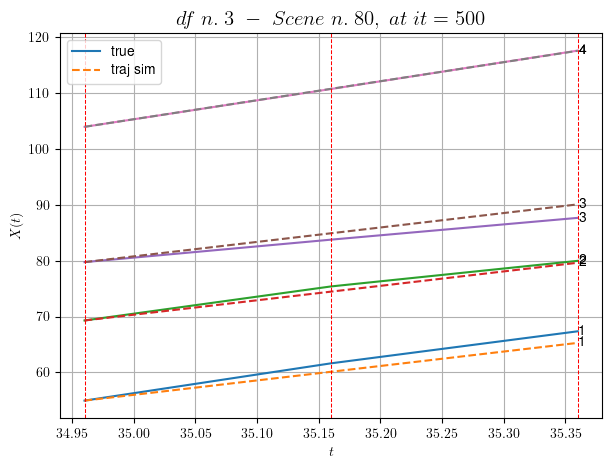

----------------------------------------------------------------------------------------------------
        For scene 39/60:
        * After LR finder: LR_NN=0.0001 with mse=10.025430857274 at it=24
        * v0 = 34.044524530898634
        * MSE = 1.2202249889343295
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.40/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [325.76,326.96]


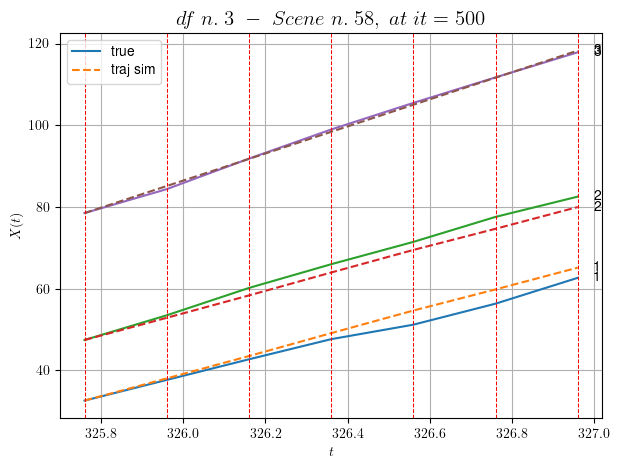

----------------------------------------------------------------------------------------------------
        For scene 40/60:
        * After LR finder: LR_NN=0.01 with mse=4.709740032296907 at it=24
        * v0 = 33.13555230710755
        * MSE = 2.9205210772822343
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.41/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [573.76,574.56]


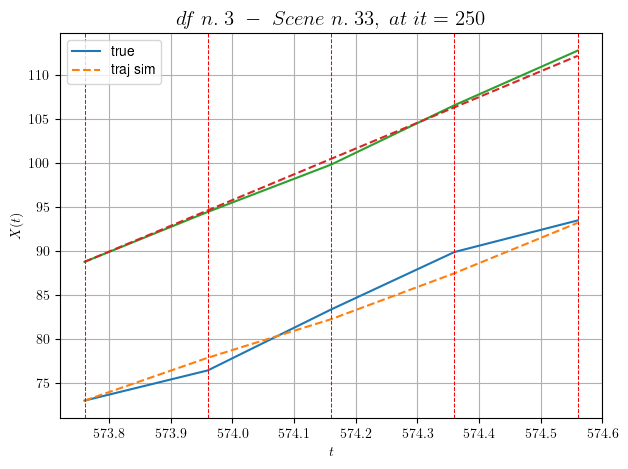

----------------------------------------------------------------------------------------------------
        For scene 41/60:
        * After LR finder: LR_NN=0.005 with mse=1.3179449544692152 at it=24
        * v0 = 29.329401723486296
        * MSE = 0.8539275451615593
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.42/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.56,321.16]


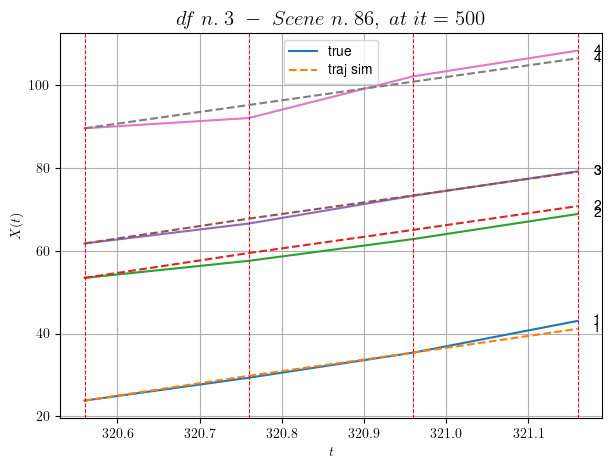

----------------------------------------------------------------------------------------------------
        For scene 42/60:
        * After LR finder: LR_NN=0.005 with mse=1.973450392702248 at it=24
        * v0 = 28.13014094913917
        * MSE = 1.8872315767618693
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.43/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [371.16,371.76]


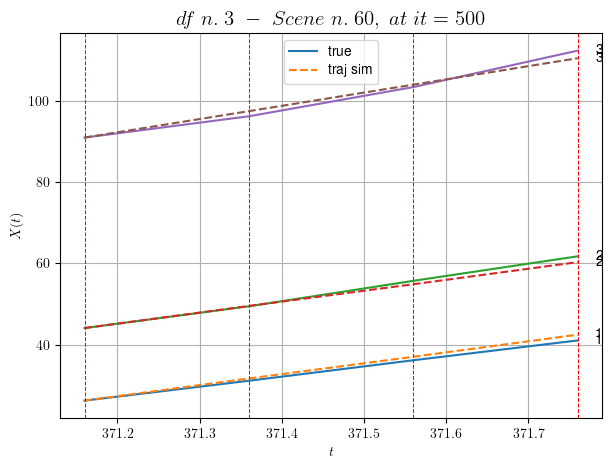

----------------------------------------------------------------------------------------------------
        For scene 43/60:
        * After LR finder: LR_NN=0.005 with mse=1.5070776190801276 at it=24
        * v0 = 32.53950759922844
        * MSE = 0.9391022362265661
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.44/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [439.36,439.96]


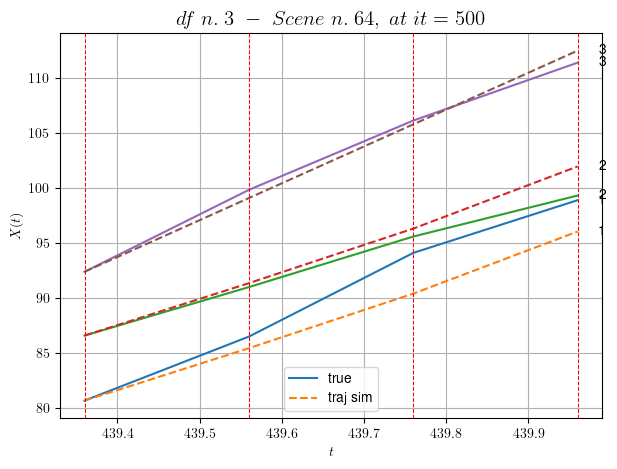

----------------------------------------------------------------------------------------------------
        For scene 44/60:
        * After LR finder: LR_NN=0.01 with mse=3.957656219483787 at it=24
        * v0 = 33.53637857272987
        * MSE = 2.7072130055099883
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.45/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [31.36,31.96]


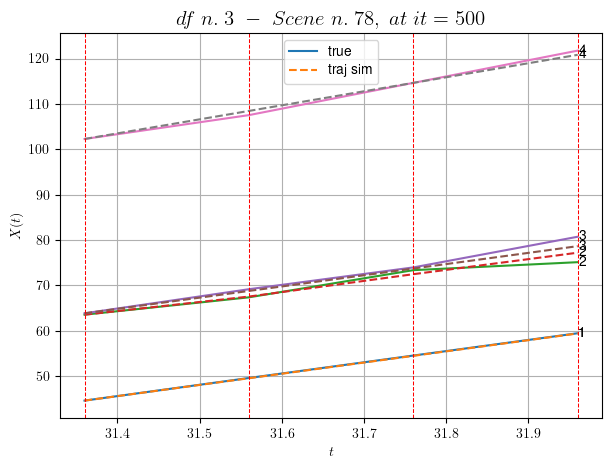

----------------------------------------------------------------------------------------------------
        For scene 45/60:
        * After LR finder: LR_NN=0.0001 with mse=19.070018713409347 at it=24
        * v0 = 30.917174059156075
        * MSE = 0.620551046633514
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.46/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [23.96,24.76]


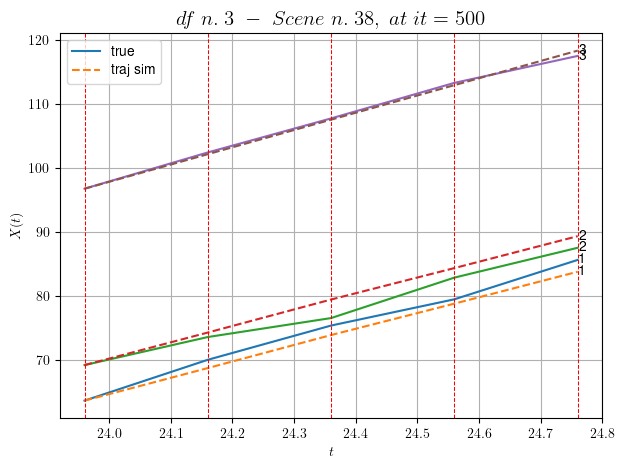

----------------------------------------------------------------------------------------------------
        For scene 46/60:
        * After LR finder: LR_NN=0.005 with mse=2.4398537717365323 at it=24
        * v0 = 27.016664353697227
        * MSE = 1.5412864171207066
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.47/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [544.16,545.16]


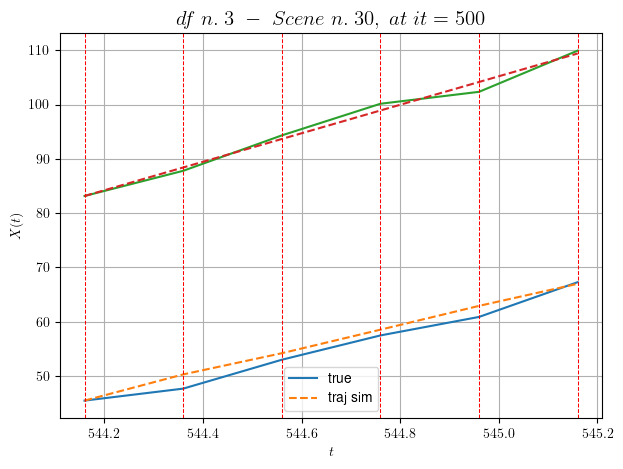

----------------------------------------------------------------------------------------------------
        For scene 47/60:
        * After LR finder: LR_NN=0.01 with mse=4.599127462212881 at it=24
        * v0 = 26.24502129327486
        * MSE = 1.5825592415100647
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.48/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [12.76,13.96]


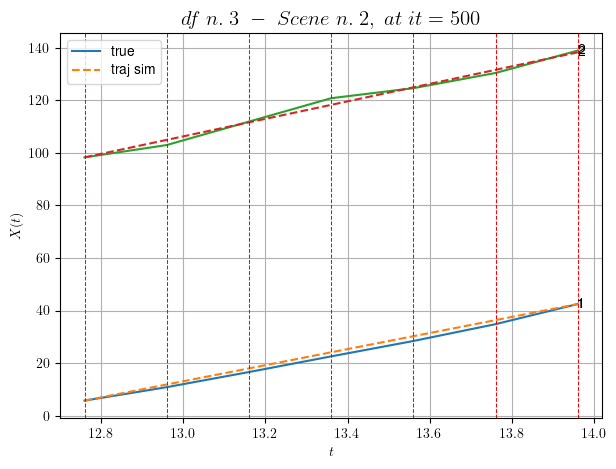

----------------------------------------------------------------------------------------------------
        For scene 48/60:
        * After LR finder: LR_NN=0.0001 with mse=4.836497173125552 at it=24
        * v0 = 33.32970746415816
        * MSE = 1.475391076206181
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.49/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [222.96,223.76]


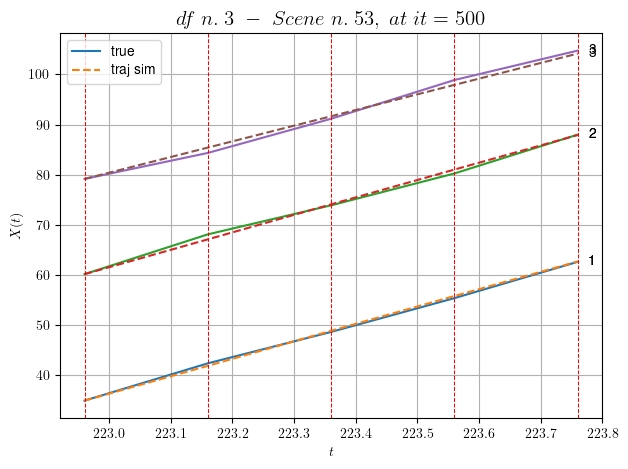

----------------------------------------------------------------------------------------------------
        For scene 49/60:
        * After LR finder: LR_NN=0.001 with mse=0.5591935740495584 at it=24
        * v0 = 31.279750687419316
        * MSE = 0.31977522948920295
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.50/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [427.36,427.76]


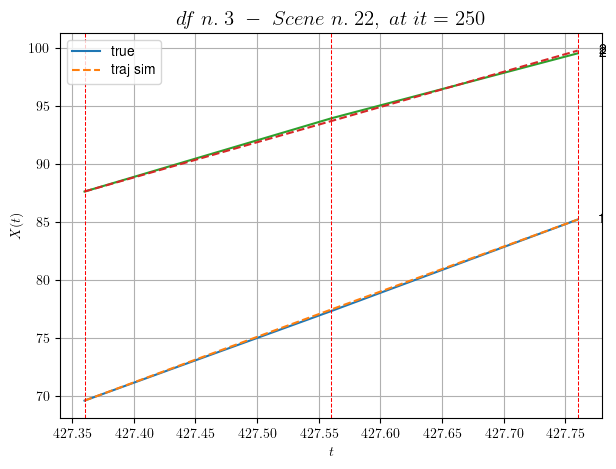

----------------------------------------------------------------------------------------------------
        For scene 50/60:
        * After LR finder: LR_NN=0.005 with mse=0.02050774420580045 at it=24
        * v0 = 30.361524570414414
        * MSE = 0.01901635924935453
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.51/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [40.76,41.16]


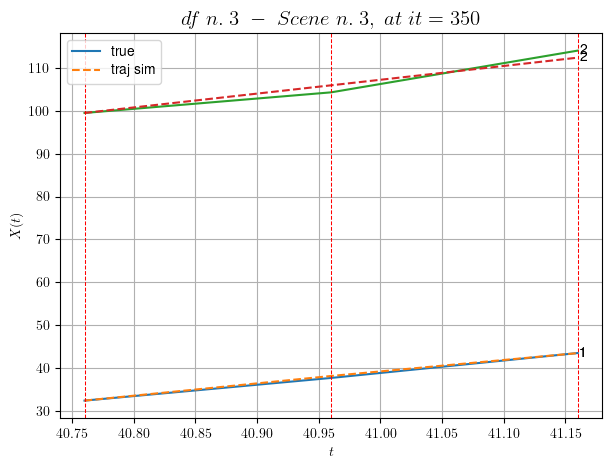

----------------------------------------------------------------------------------------------------
        For scene 51/60:
        * After LR finder: LR_NN=0.01 with mse=1.352045431754236 at it=24
        * v0 = 32.20688347720786
        * MSE = 0.9314115318997978
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.52/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [436.16,437.56]


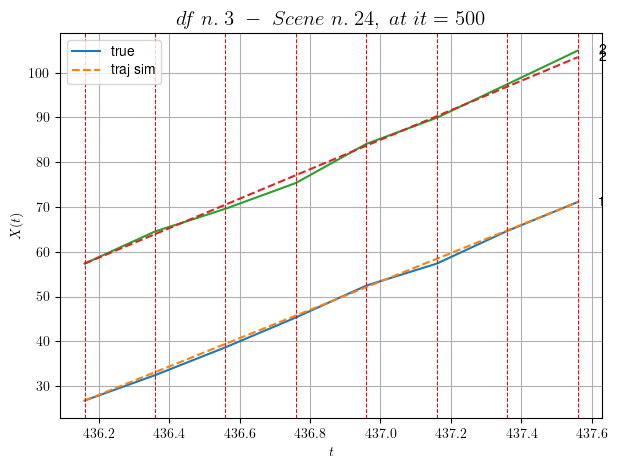

----------------------------------------------------------------------------------------------------
        For scene 52/60:
        * After LR finder: LR_NN=0.0005 with mse=4.071115918100364 at it=24
        * v0 = 32.923939302762875
        * MSE = 0.5921428825297009
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.53/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [170.36,170.76]


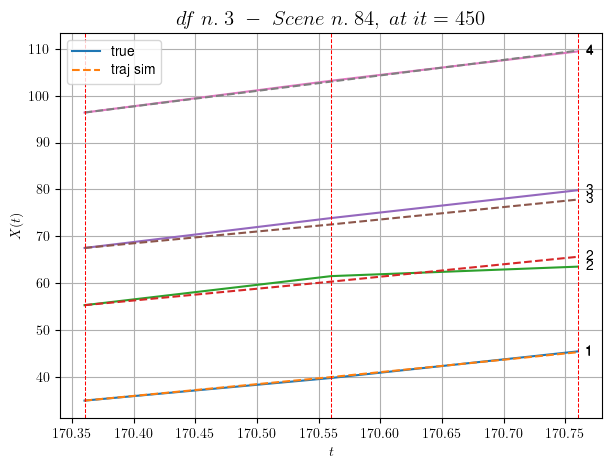

----------------------------------------------------------------------------------------------------
        For scene 53/60:
        * After LR finder: LR_NN=0.005 with mse=1.1428872262909635 at it=24
        * v0 = 32.99651505707648
        * MSE = 0.9742859489557062
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.54/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [579.56,580.56]


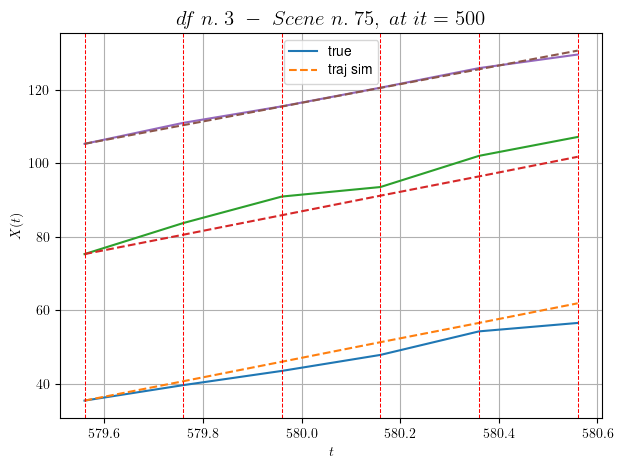

----------------------------------------------------------------------------------------------------
        For scene 54/60:
        * After LR finder: LR_NN=0.001 with mse=11.757897282978627 at it=24
        * v0 = 25.358404463471302
        * MSE = 8.690601533550064
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.55/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [142.16,142.76]


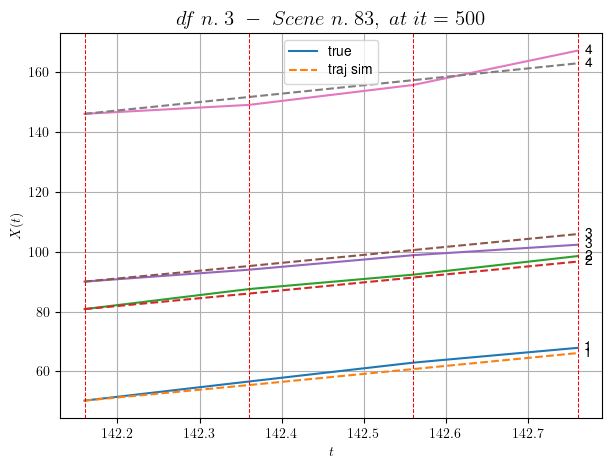

----------------------------------------------------------------------------------------------------
        For scene 55/60:
        * After LR finder: LR_NN=0.005 with mse=3.5902447515902507 at it=24
        * v0 = 28.12123774853662
        * MSE = 3.538350476252907
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.56/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [417.16,418.16]


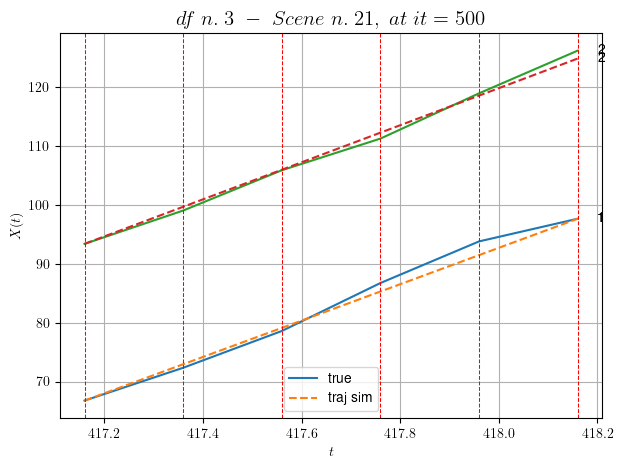

----------------------------------------------------------------------------------------------------
        For scene 56/60:
        * After LR finder: LR_NN=5e-05 with mse=1.7359884393343008 at it=24
        * v0 = 31.447990123715478
        * MSE = 0.9587051361665171
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.57/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.36,388.16]


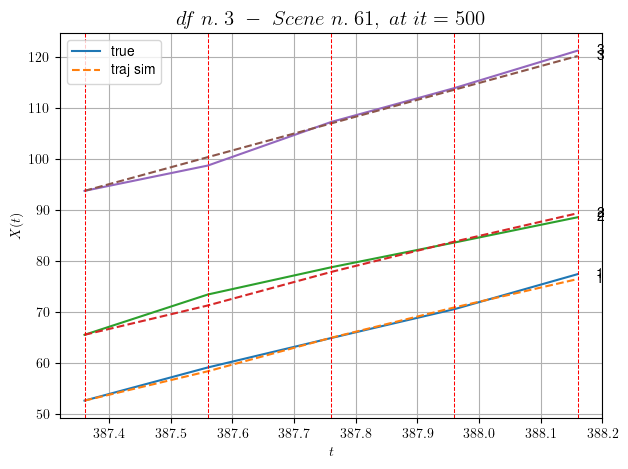

----------------------------------------------------------------------------------------------------
        For scene 57/60:
        * After LR finder: LR_NN=0.01 with mse=1.832876293428792 at it=24
        * v0 = 33.031898088254735
        * MSE = 0.7538865128243
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.58/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [527.36,528.16]


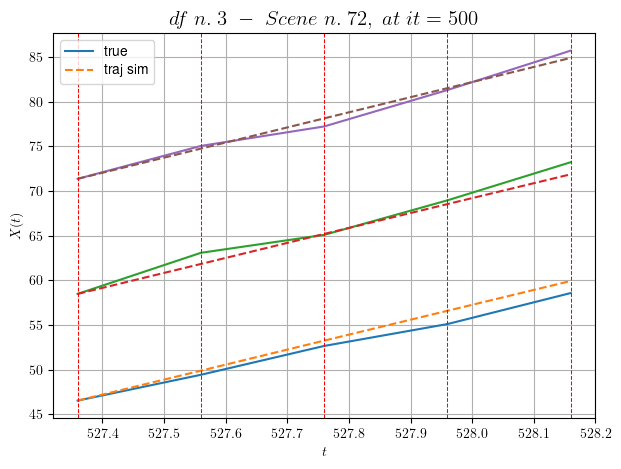

----------------------------------------------------------------------------------------------------
        For scene 58/60:
        * After LR finder: LR_NN=0.001 with mse=15.176361399108266 at it=24
        * v0 = 16.920906022774762
        * MSE = 0.6515661385406855
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.59/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [299.76,300.56]


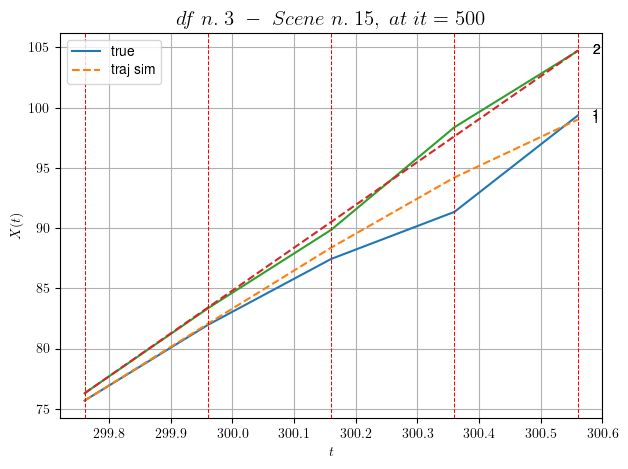

----------------------------------------------------------------------------------------------------
        For scene 59/60:
        * After LR finder: LR_NN=0.01 with mse=5.5289010521649935 at it=24
        * v0 = 35.55620181997074
        * MSE = 0.5066852472041348
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.60/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [218.16,219.16]


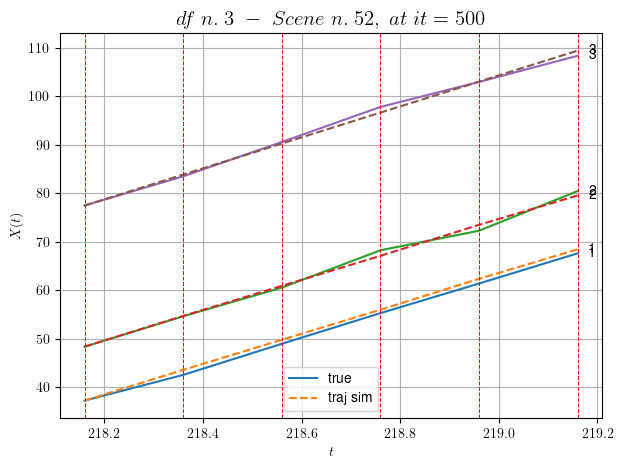

----------------------------------------------------------------------------------------------------
        For scene 60/60:
        * After LR finder: LR_NN=0.005 with mse=1.0889355164854888 at it=24
        * v0 = 31.94692558326437
        * MSE = 0.5595009370572975
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.7635204977501786
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (30 scenes)
DataFrame n.3. Scene n.1/30


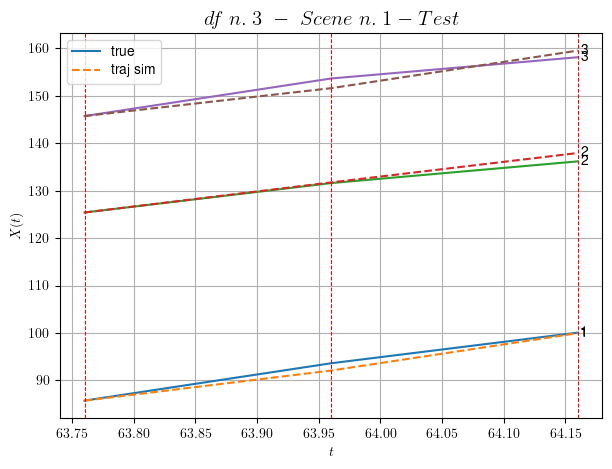

        For scene 1/30:
        * MSE = 1.2884970272755385
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/30


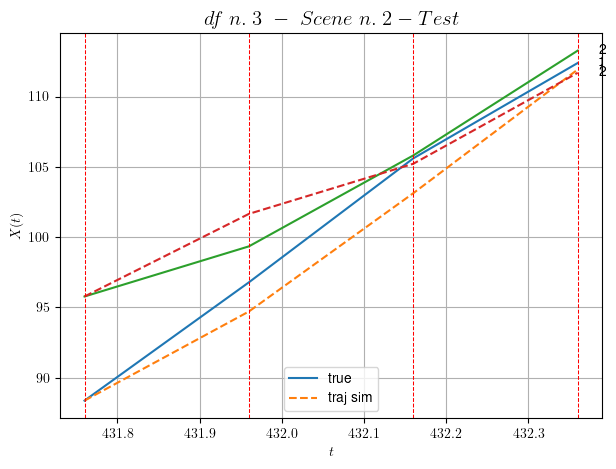

        For scene 2/30:
        * MSE = 2.3533883752510736
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/30


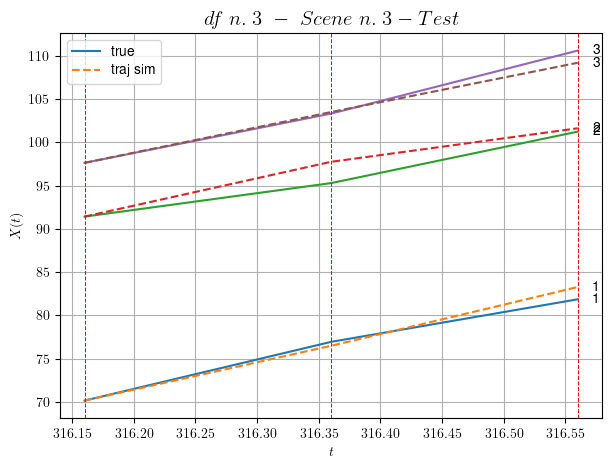

        For scene 3/30:
        * MSE = 1.159853168753673
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/30


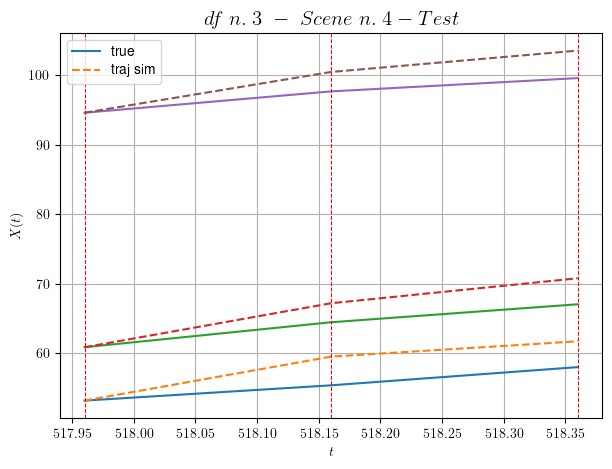

        For scene 4/30:
        * MSE = 8.441246358850844
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/30


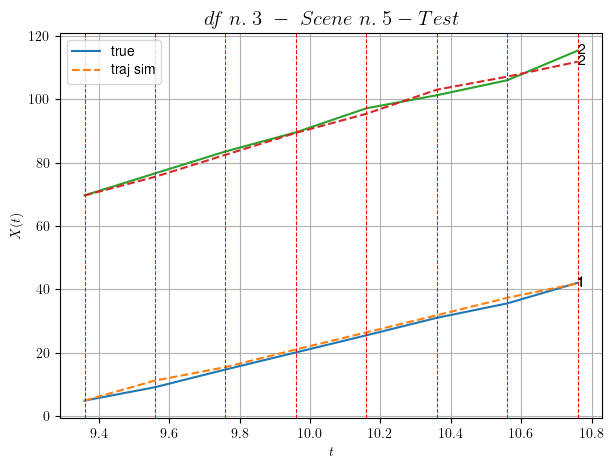

        For scene 5/30:
        * MSE = 2.028706247013067
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/30


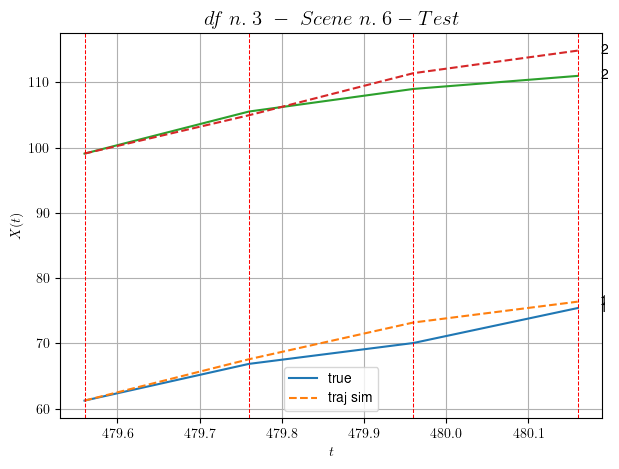

        For scene 6/30:
        * MSE = 4.058988341311064
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/30


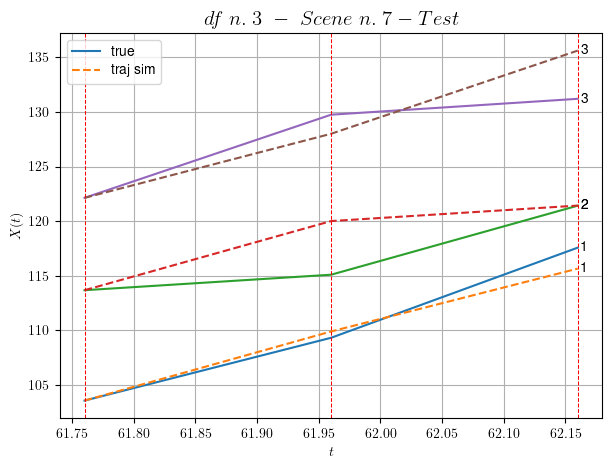

        For scene 7/30:
        * MSE = 5.641881091975577
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/30


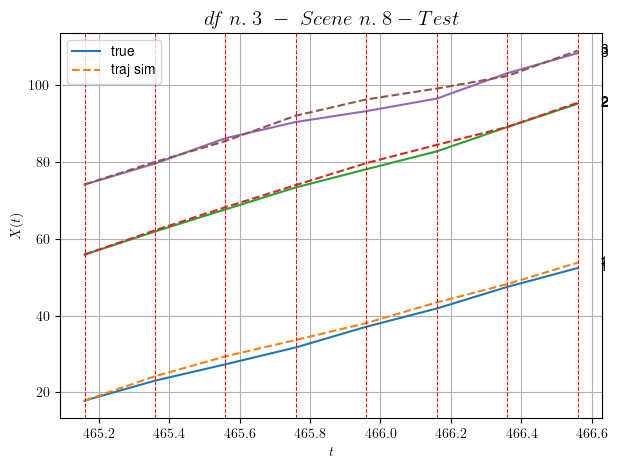

        For scene 8/30:
        * MSE = 1.753403475417971
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/30


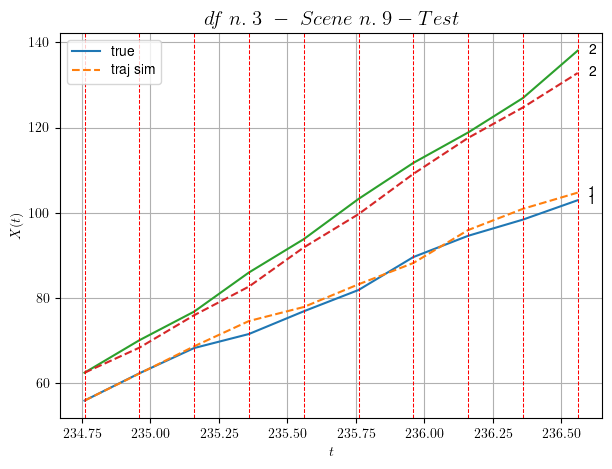

        For scene 9/30:
        * MSE = 4.886004464912159
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/30


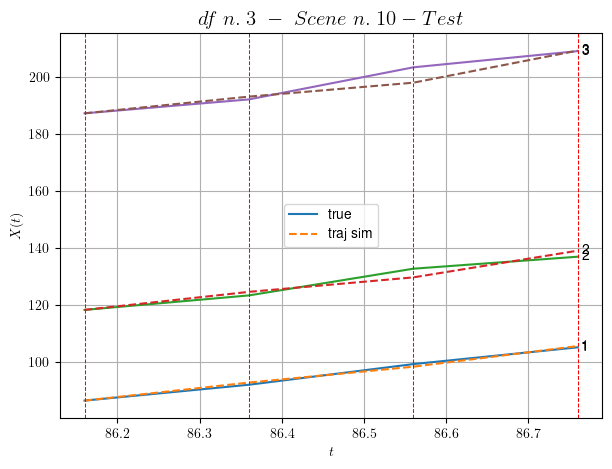

        For scene 10/30:
        * MSE = 3.923751101903271
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/30


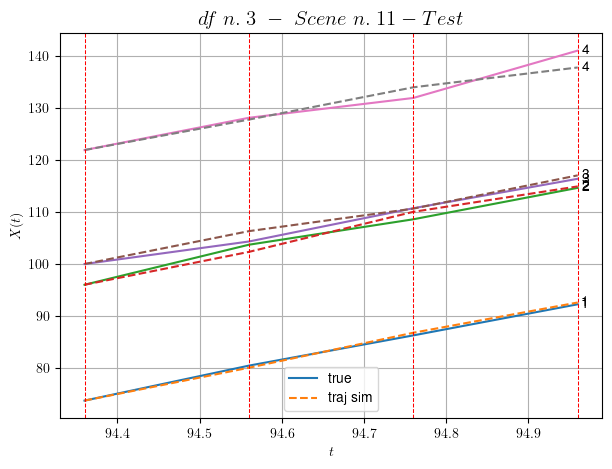

        For scene 11/30:
        * MSE = 1.4940634927027912
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/30


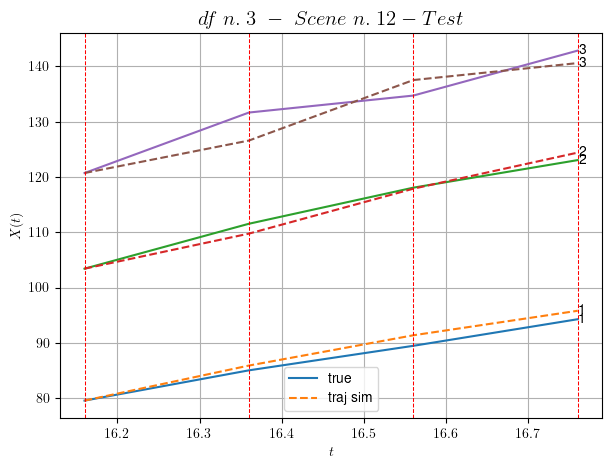

        For scene 12/30:
        * MSE = 4.1946423357724445
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/30


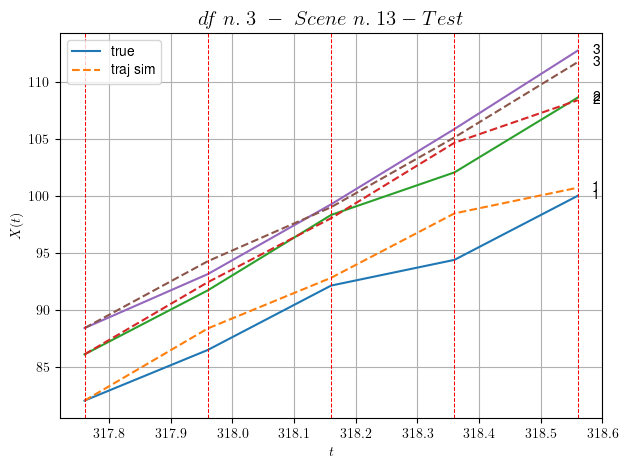

        For scene 13/30:
        * MSE = 2.1014082153378184
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/30


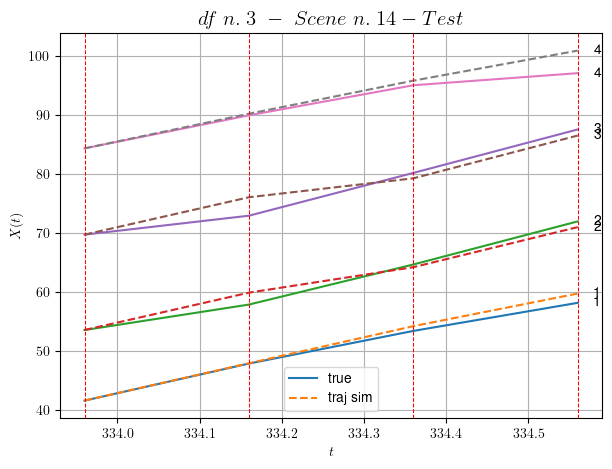

        For scene 14/30:
        * MSE = 2.207153533475018
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/30


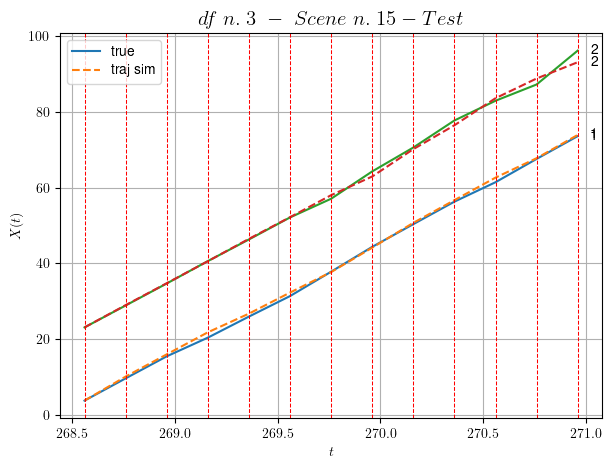

        For scene 15/30:
        * MSE = 0.8727764174269086
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/30


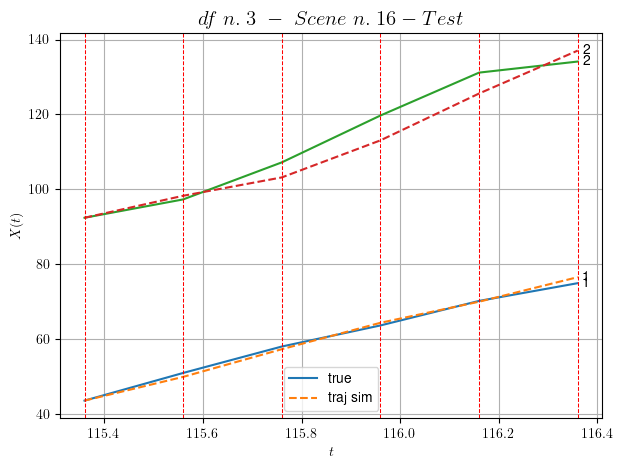

        For scene 16/30:
        * MSE = 8.78295076782399
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/30


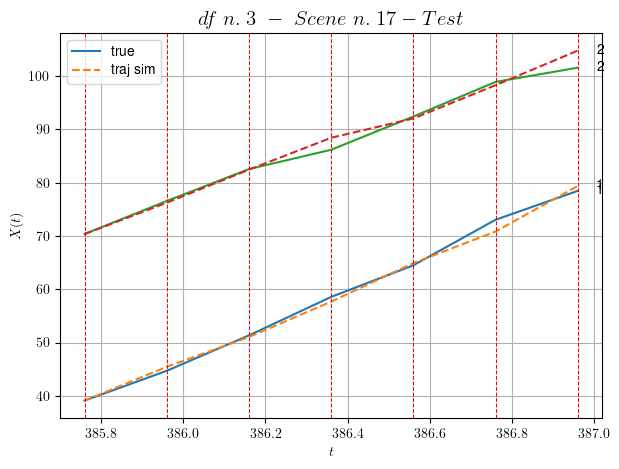

        For scene 17/30:
        * MSE = 1.662686303242333
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/30


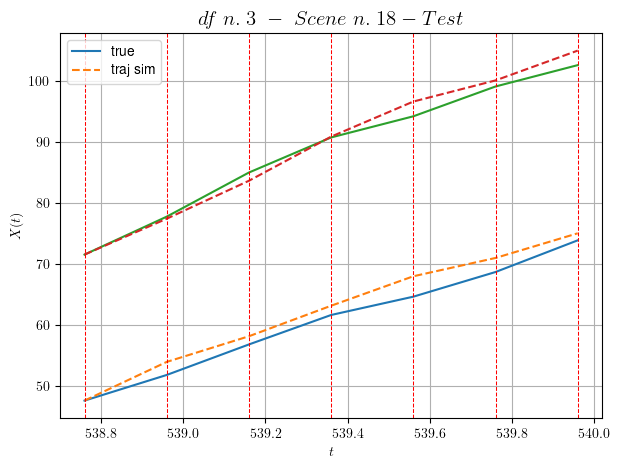

        For scene 18/30:
        * MSE = 2.9173704115227244
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/30


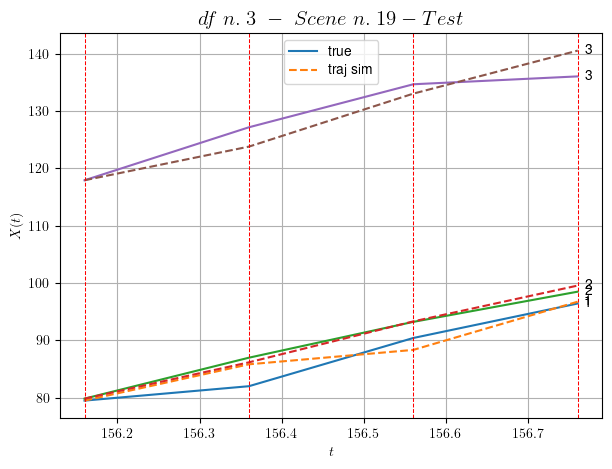

        For scene 19/30:
        * MSE = 4.5912841721319895
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/30


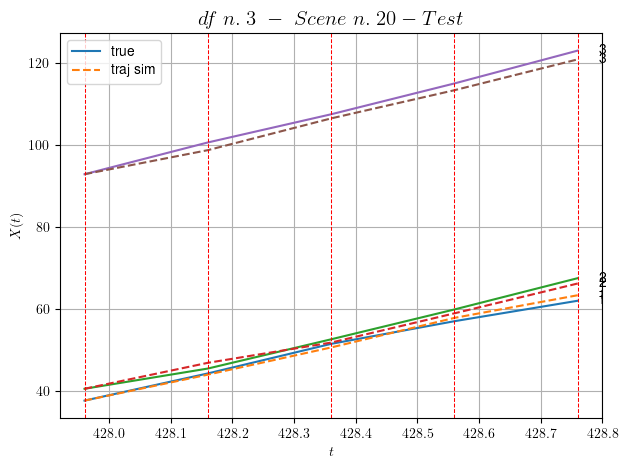

        For scene 20/30:
        * MSE = 1.3553521829083433
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/30


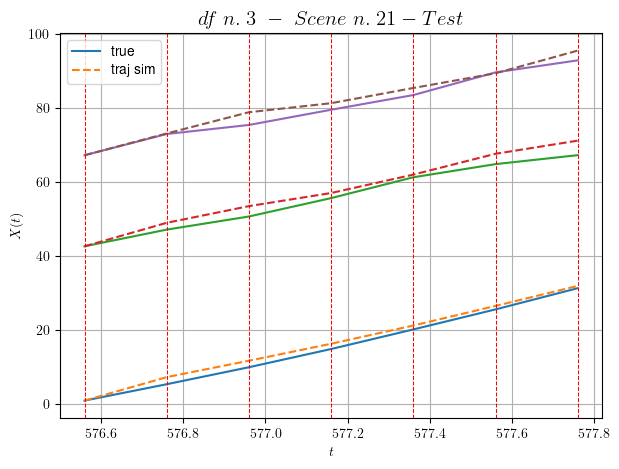

        For scene 21/30:
        * MSE = 3.494381279609121
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/30


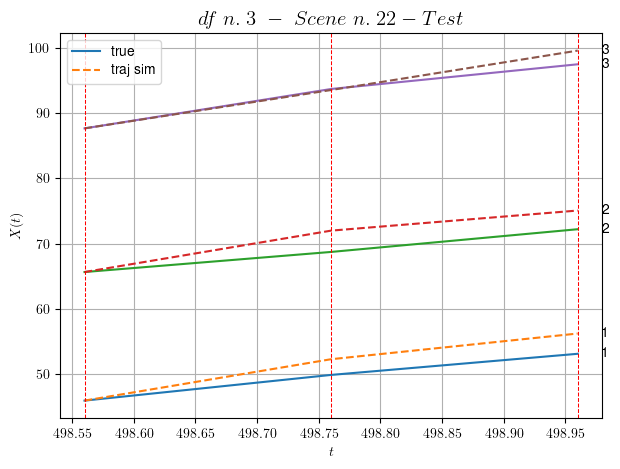

        For scene 22/30:
        * MSE = 4.291844072736118
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/30


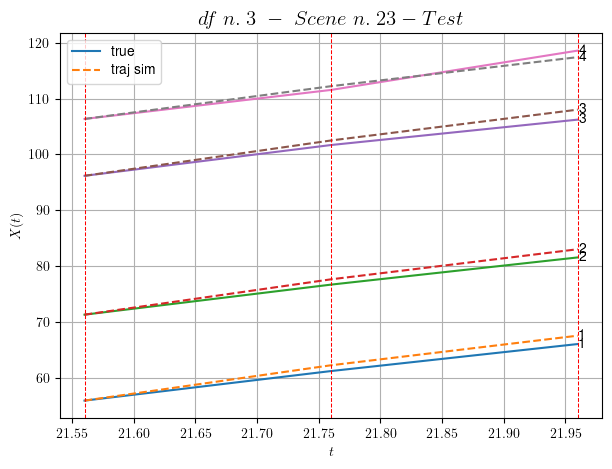

        For scene 23/30:
        * MSE = 1.0053981594536214
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/30


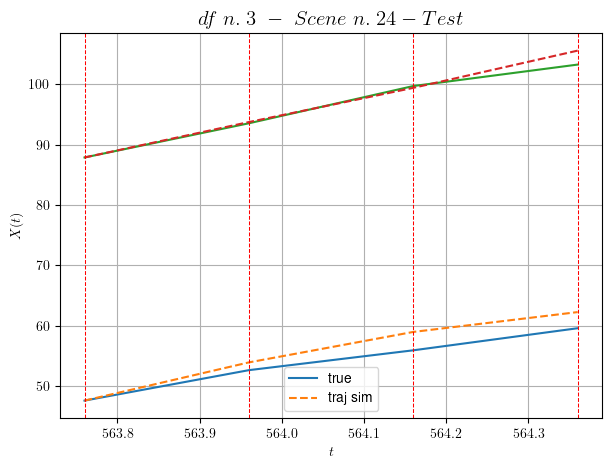

        For scene 24/30:
        * MSE = 2.9487931034846078
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/30


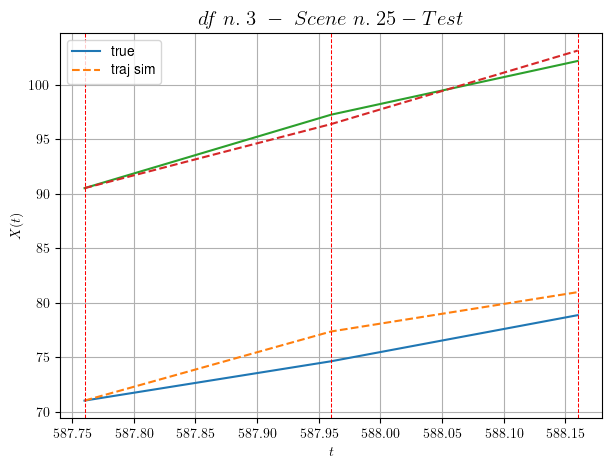

        For scene 25/30:
        * MSE = 2.259060435591763
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/30


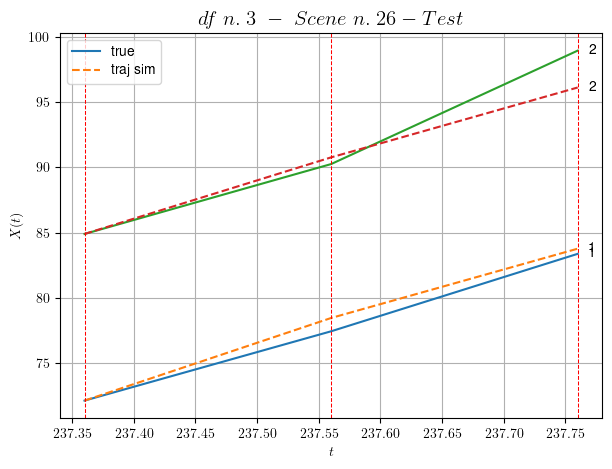

        For scene 26/30:
        * MSE = 1.576251358217473
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/30


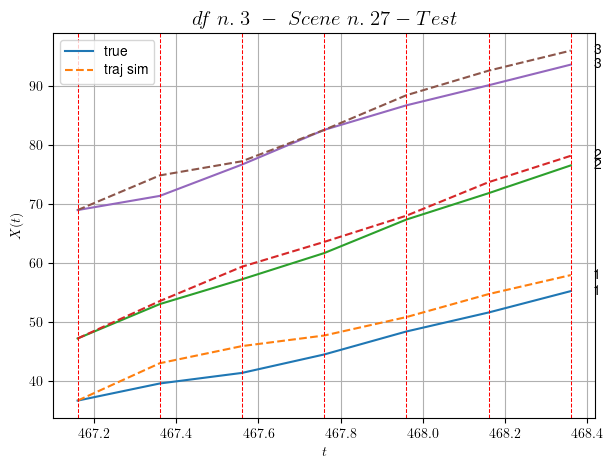

        For scene 27/30:
        * MSE = 5.133662495421135
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/30


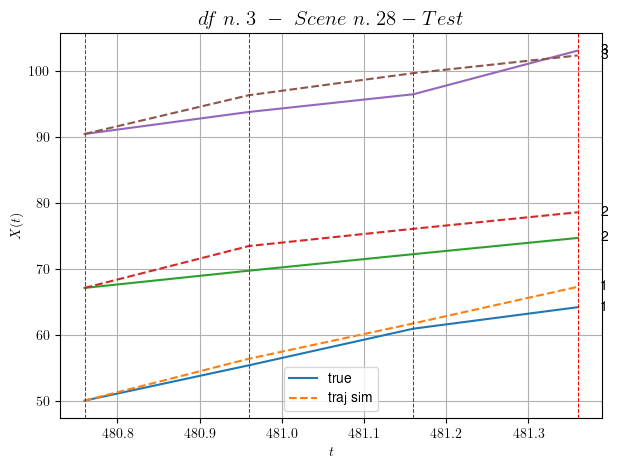

        For scene 28/30:
        * MSE = 6.002970018924125
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/30


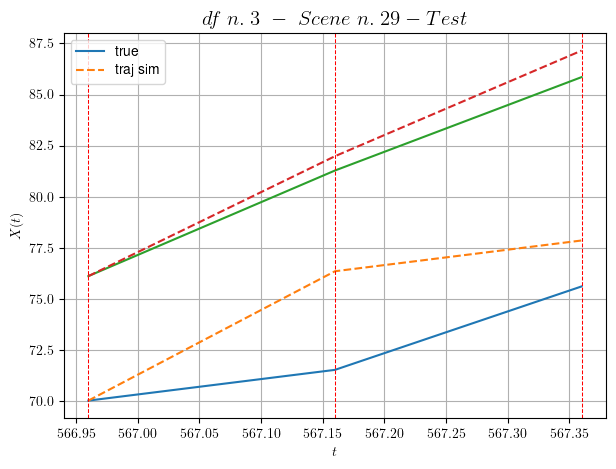

        For scene 29/30:
        * MSE = 5.0963270644662275
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/30


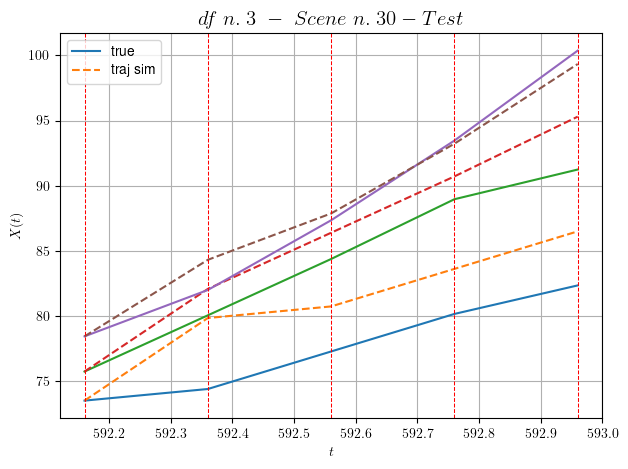

        For scene 30/30:
        * MSE = 7.013122069073817
----------------------------------------------------------------------------------------------------


MSE test: 3.48457391806622

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.7635204977501786
          * MSE test: 3.48457391806622
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 4/10 dfs.
In DataFrame n.4 we have 69 scenes.
    To train the model we use 46 scenes, the remaining 23 to test the model.

Training step. (46 scenes)
DataFrame n.4. Scene n.1/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [399.24,399.84]


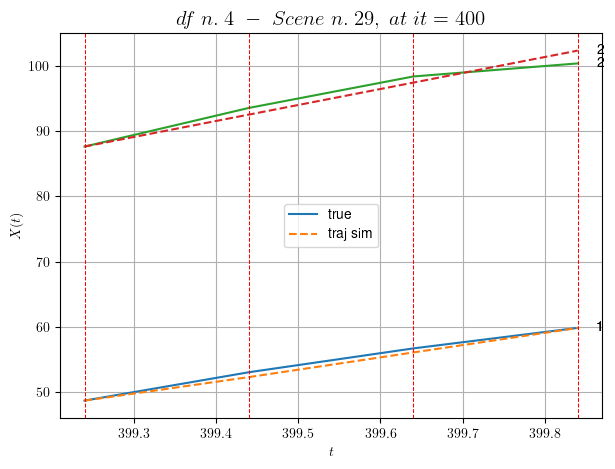

----------------------------------------------------------------------------------------------------
        For scene 1/46:
        * After LR finder: LR_NN=0.005 with mse=3.7857921387249385 at it=24
        * v0 = 24.512386482352305
        * MSE = 0.8384579619126371
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [128.24,129.24]


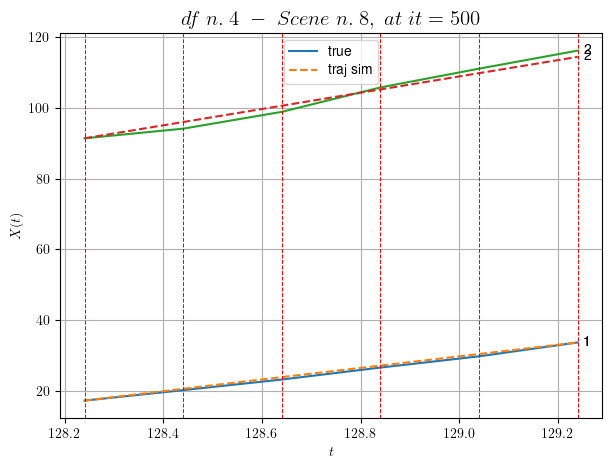

----------------------------------------------------------------------------------------------------
        For scene 2/46:
        * After LR finder: LR_NN=0.005 with mse=7.673434672324427 at it=24
        * v0 = 23.005181028725566
        * MSE = 0.9388324182705224
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [556.24,556.64]


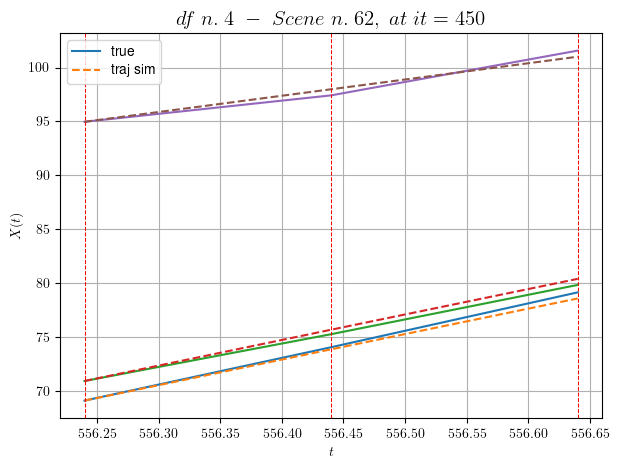

----------------------------------------------------------------------------------------------------
        For scene 3/46:
        * After LR finder: LR_NN=0.005 with mse=4.6898495935160005 at it=24
        * v0 = 15.086095420364746
        * MSE = 0.15882056044601733
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [19.84,20.24]


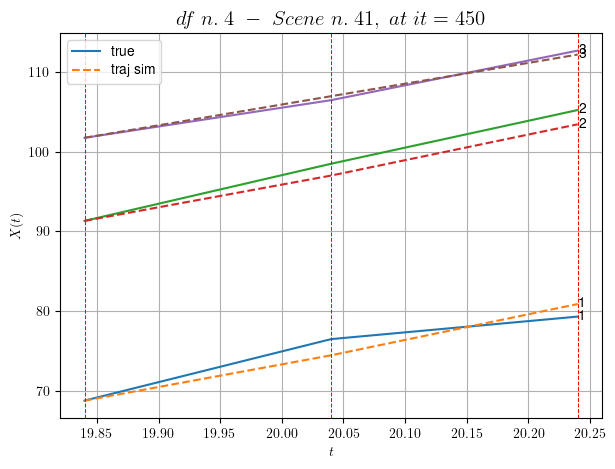

----------------------------------------------------------------------------------------------------
        For scene 4/46:
        * After LR finder: LR_NN=0.005 with mse=1.835947700993198 at it=24
        * v0 = 26.058967459028576
        * MSE = 1.3665792688425242
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [230.84,232.24]


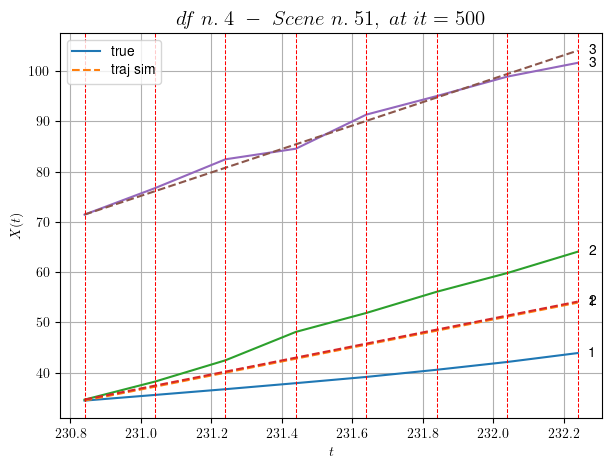

----------------------------------------------------------------------------------------------------
        For scene 5/46:
        * After LR finder: LR_NN=5e-05 with mse=21.23232861145168 at it=24
        * v0 = 23.322723002586503
        * MSE = 26.228674326695884
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [182.24,183.64]


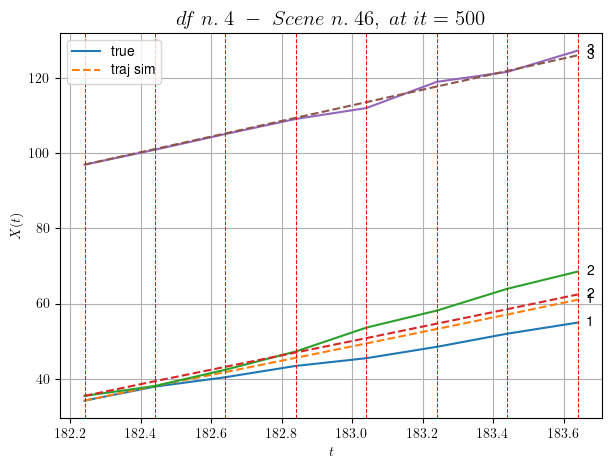

----------------------------------------------------------------------------------------------------
        For scene 6/46:
        * After LR finder: LR_NN=0.005 with mse=27.026775258724616 at it=24
        * v0 = 20.773199567272407
        * MSE = 8.40872340613355
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/46
----------------------------------------------------------------------------------------------------
We have 11 time intervals inside [266.84,269.04]


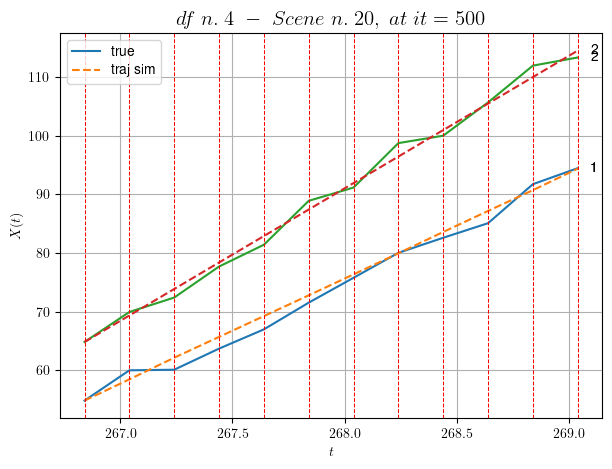

----------------------------------------------------------------------------------------------------
        For scene 7/46:
        * After LR finder: LR_NN=0.005 with mse=46.91314941341213 at it=24
        * v0 = 22.599995584638805
        * MSE = 1.7625011666090238
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [440.44,440.84]


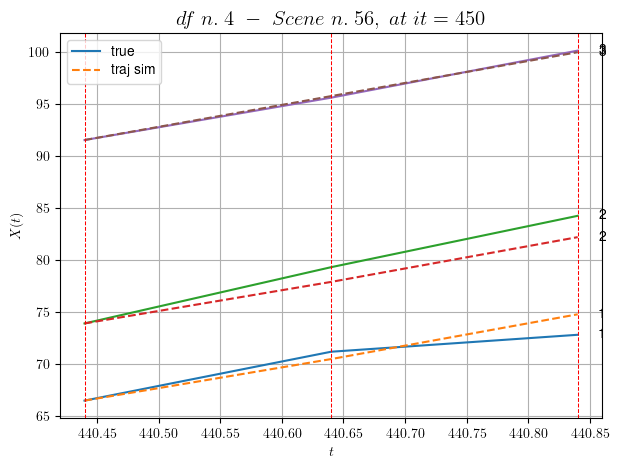

----------------------------------------------------------------------------------------------------
        For scene 8/46:
        * After LR finder: LR_NN=0.005 with mse=2.923401832392193 at it=24
        * v0 = 21.12699627273943
        * MSE = 1.1761512201272017
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [7.04,7.44]


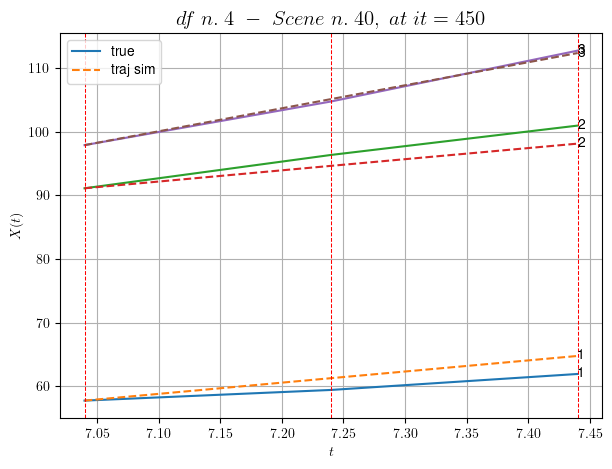

----------------------------------------------------------------------------------------------------
        For scene 9/46:
        * After LR finder: LR_NN=0.01 with mse=3.4664797109283794 at it=24
        * v0 = 36.154229124863036
        * MSE = 2.517463504314476
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [374.24,375.04]


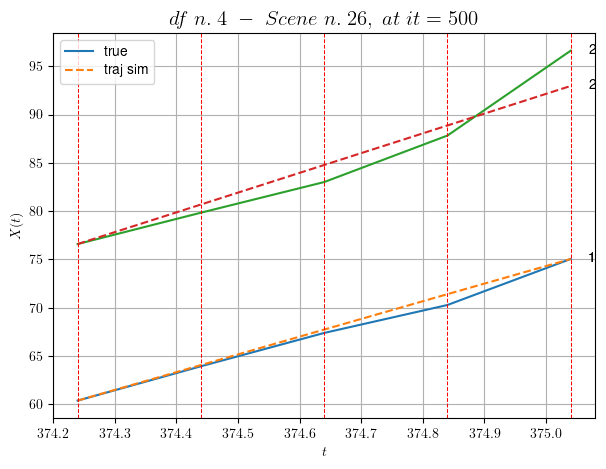

----------------------------------------------------------------------------------------------------
        For scene 10/46:
        * After LR finder: LR_NN=0.001 with mse=10.111662885194313 at it=24
        * v0 = 20.475722036934727
        * MSE = 1.809800075044152
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [584.84,585.44]


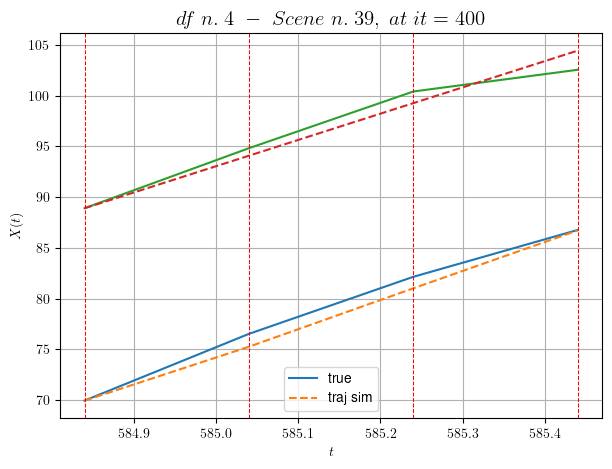

----------------------------------------------------------------------------------------------------
        For scene 11/46:
        * After LR finder: LR_NN=0.005 with mse=2.8491113228718974 at it=24
        * v0 = 25.889440534985226
        * MSE = 1.036604406821363
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [176.24,177.24]


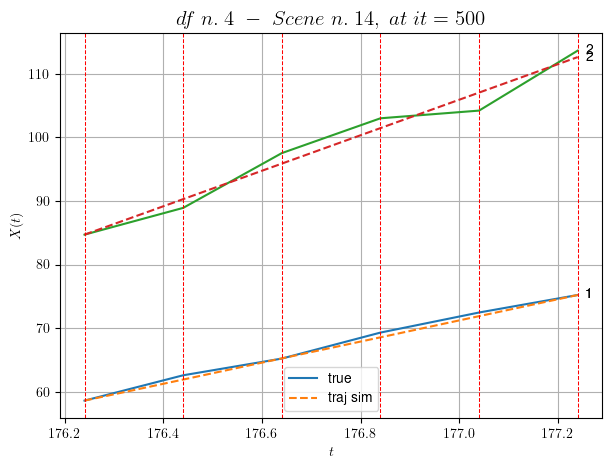

----------------------------------------------------------------------------------------------------
        For scene 12/46:
        * After LR finder: LR_NN=0.001 with mse=2.332594391169327 at it=24
        * v0 = 27.94819777081733
        * MSE = 1.4522700168904643
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/46
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [224.84,227.24]


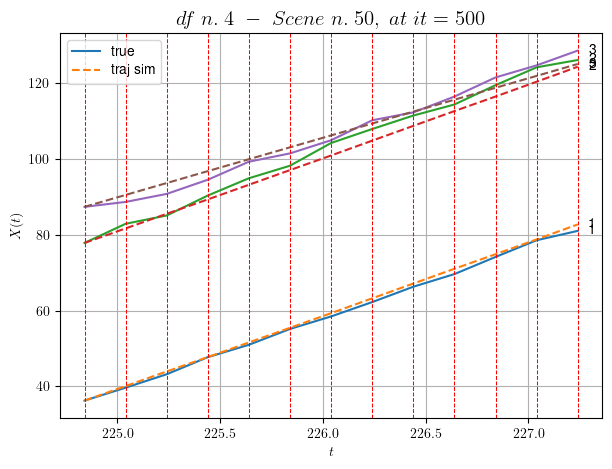

----------------------------------------------------------------------------------------------------
        For scene 13/46:
        * After LR finder: LR_NN=0.01 with mse=130.10742951543895 at it=24
        * v0 = 15.713677130054839
        * MSE = 3.1816176444510695
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [67.64,68.04]


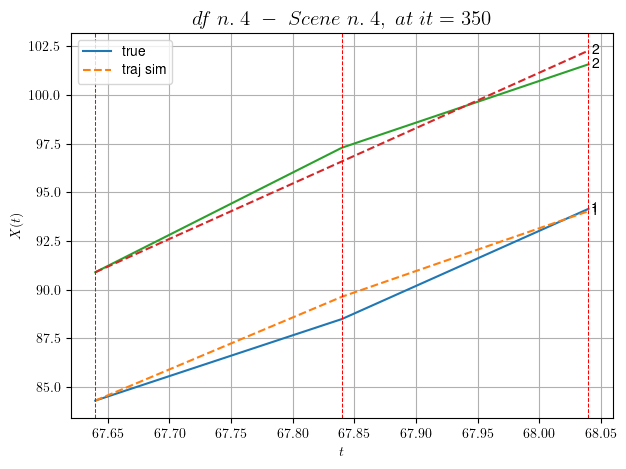

----------------------------------------------------------------------------------------------------
        For scene 14/46:
        * After LR finder: LR_NN=0.01 with mse=0.6044034998488654 at it=24
        * v0 = 28.464980033502886
        * MSE = 0.38593210751513607
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [205.84,206.84]


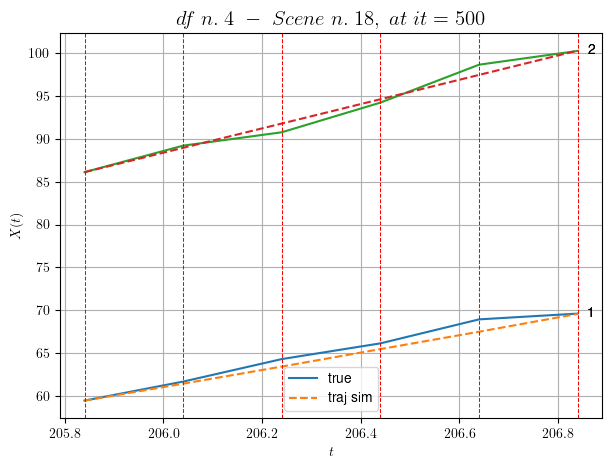

----------------------------------------------------------------------------------------------------
        For scene 15/46:
        * After LR finder: LR_NN=0.005 with mse=45.47424606250709 at it=24
        * v0 = 14.204943221368437
        * MSE = 0.4967006847133423
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/46
----------------------------------------------------------------------------------------------------
We have 15 time intervals inside [129.84,132.84]


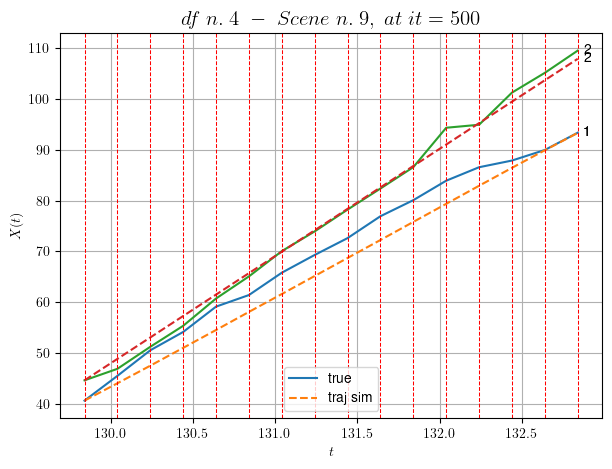

----------------------------------------------------------------------------------------------------
        For scene 16/46:
        * After LR finder: LR_NN=0.01 with mse=118.6484188265009 at it=24
        * v0 = 21.068534244852284
        * MSE = 3.765516904768239
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [422.64,423.64]


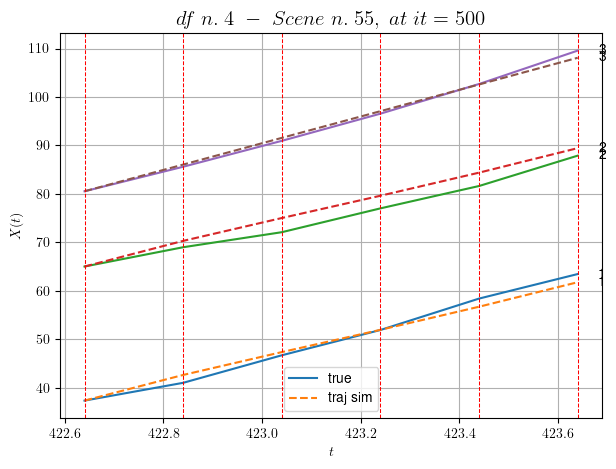

----------------------------------------------------------------------------------------------------
        For scene 17/46:
        * After LR finder: LR_NN=0.01 with mse=2.40361599503743 at it=24
        * v0 = 27.545089607777708
        * MSE = 1.8949569919060938
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [122.84,123.84]


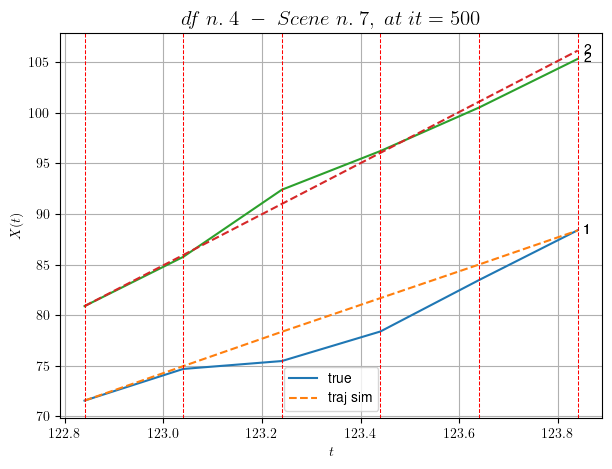

----------------------------------------------------------------------------------------------------
        For scene 18/46:
        * After LR finder: LR_NN=0.001 with mse=6.532934995099897 at it=24
        * v0 = 25.259320008419433
        * MSE = 2.0432615749014036
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [500.04,501.04]


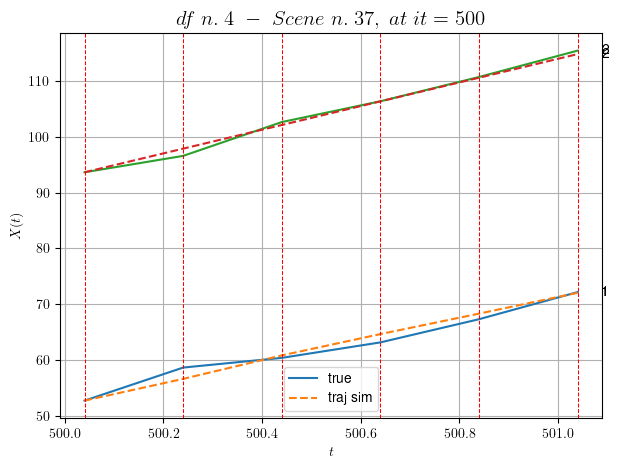

----------------------------------------------------------------------------------------------------
        For scene 19/46:
        * After LR finder: LR_NN=0.005 with mse=14.245341996993465 at it=24
        * v0 = 21.189572495102677
        * MSE = 0.8113007688489519
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [313.84,314.44]


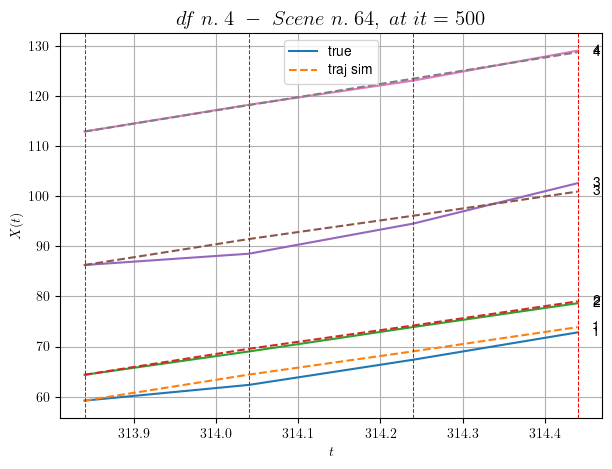

----------------------------------------------------------------------------------------------------
        For scene 20/46:
        * After LR finder: LR_NN=0.005 with mse=2.0110791435377235 at it=24
        * v0 = 26.41552952480359
        * MSE = 1.3931624736648525
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [541.84,542.84]


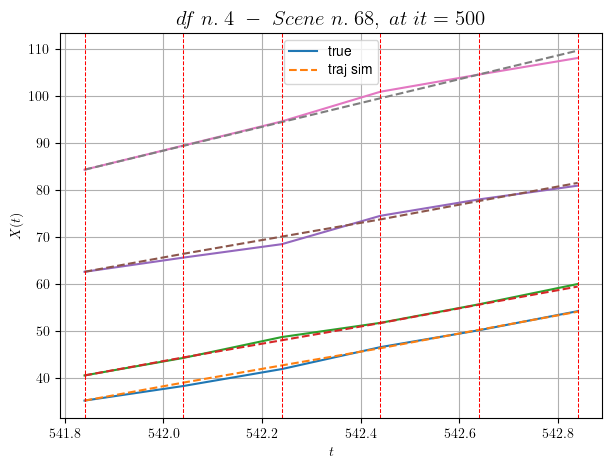

----------------------------------------------------------------------------------------------------
        For scene 21/46:
        * After LR finder: LR_NN=0.01 with mse=2.7447137966518316 at it=24
        * v0 = 25.311591600962252
        * MSE = 0.4450762941456483
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/46
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [195.44,197.24]


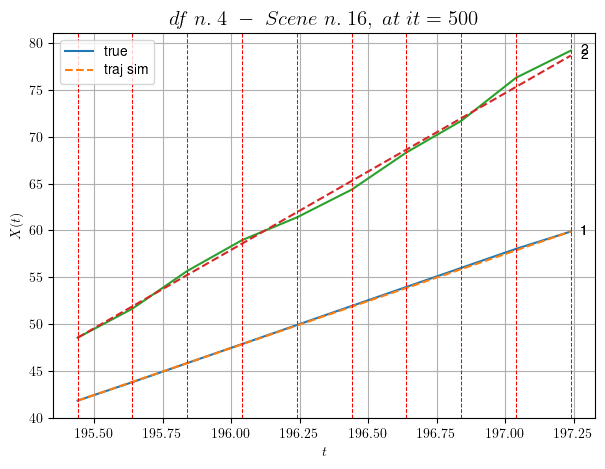

----------------------------------------------------------------------------------------------------
        For scene 22/46:
        * After LR finder: LR_NN=0.005 with mse=99.42559612722503 at it=24
        * v0 = 16.73844314065949
        * MSE = 0.14992628918540177
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.64,388.44]


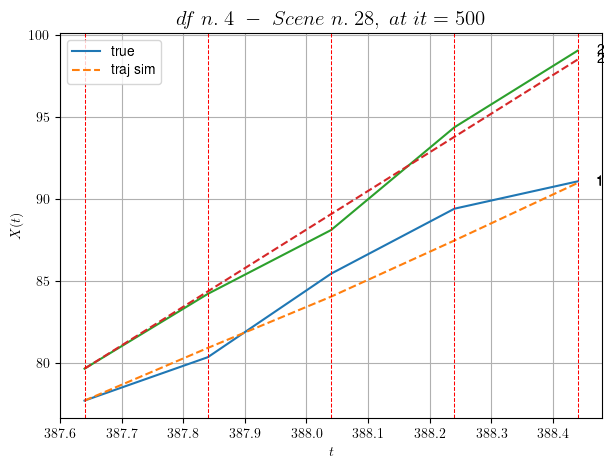

----------------------------------------------------------------------------------------------------
        For scene 23/46:
        * After LR finder: LR_NN=0.005 with mse=5.5381554247839055 at it=24
        * v0 = 23.572406443207264
        * MSE = 0.7648786144559432
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.24/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


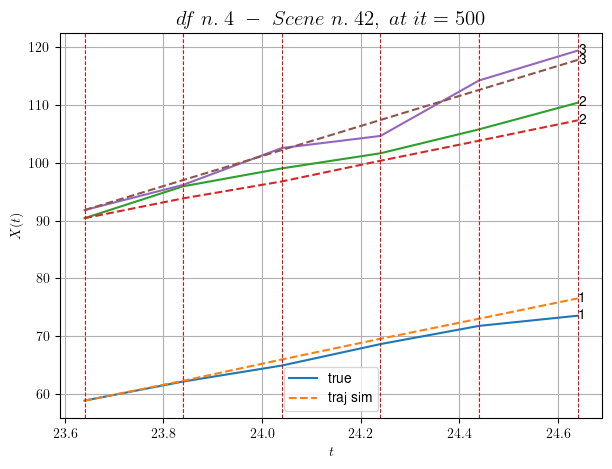

----------------------------------------------------------------------------------------------------
        For scene 24/46:
        * After LR finder: LR_NN=0.01 with mse=4.5027630213386916 at it=24
        * v0 = 25.97457555941859
        * MSE = 2.3331222874637443
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.25/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [378.64,379.24]


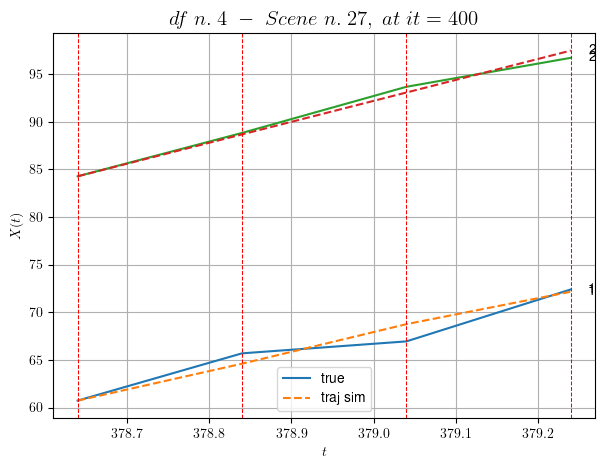

----------------------------------------------------------------------------------------------------
        For scene 25/46:
        * After LR finder: LR_NN=0.005 with mse=5.620313392677713 at it=24
        * v0 = 21.98668245906676
        * MSE = 0.6632039064524904
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.26/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [222.84,223.44]


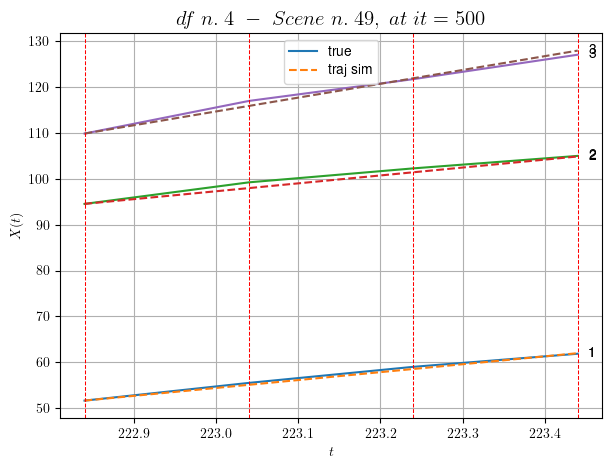

----------------------------------------------------------------------------------------------------
        For scene 26/46:
        * After LR finder: LR_NN=0.0001 with mse=6.072480246309894 at it=24
        * v0 = 30.107928662730195
        * MSE = 0.3378268394234118
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.27/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [321.84,323.84]


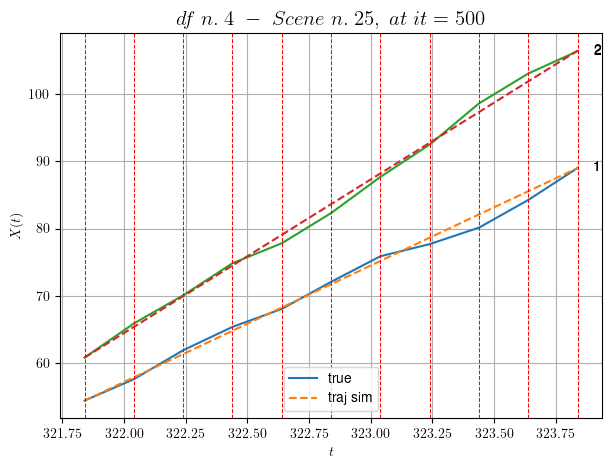

----------------------------------------------------------------------------------------------------
        For scene 27/46:
        * After LR finder: LR_NN=0.0005 with mse=36.154227475156084 at it=24
        * v0 = 22.81009773351758
        * MSE = 0.6761478574630649
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.28/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [520.04,521.64]


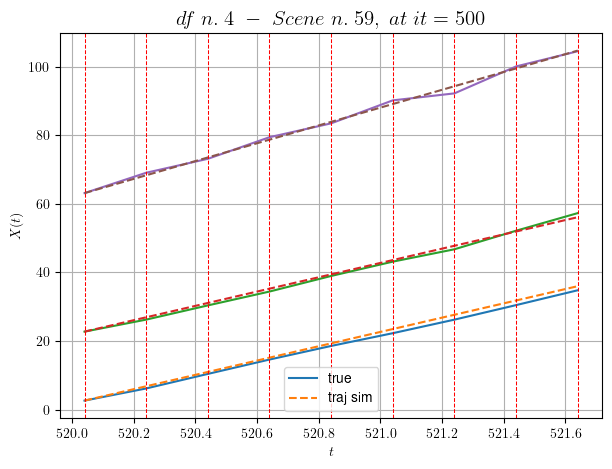

----------------------------------------------------------------------------------------------------
        For scene 28/46:
        * After LR finder: LR_NN=0.001 with mse=5.9501902511561395 at it=24
        * v0 = 25.962807327177398
        * MSE = 0.7459064461806412
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.29/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [575.04,575.84]


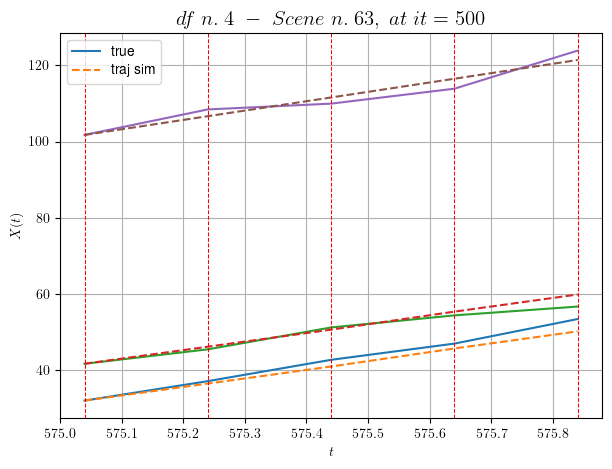

----------------------------------------------------------------------------------------------------
        For scene 29/46:
        * After LR finder: LR_NN=0.005 with mse=5.448519852697871 at it=24
        * v0 = 24.545621507401584
        * MSE = 3.058316536539333
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.30/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [153.04,153.44]


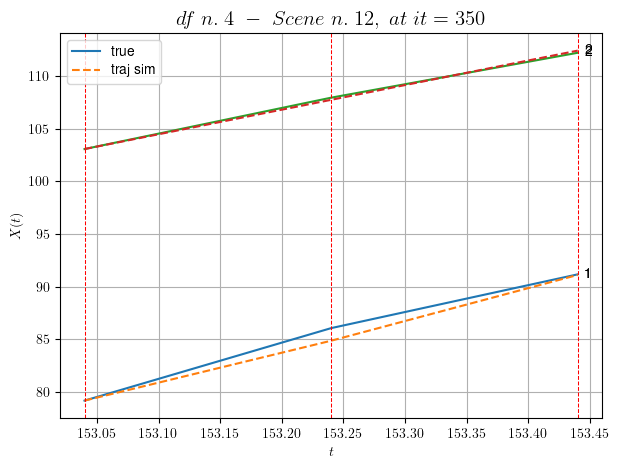

----------------------------------------------------------------------------------------------------
        For scene 30/46:
        * After LR finder: LR_NN=0.005 with mse=1.8461012058128257 at it=24
        * v0 = 23.38510915966024
        * MSE = 0.25325589707352947
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.31/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [419.84,421.84]


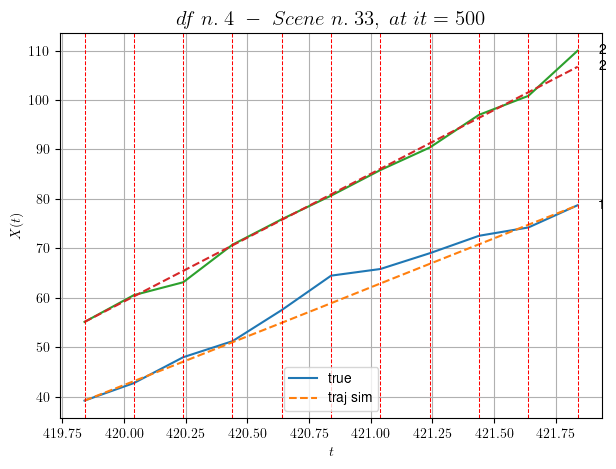

----------------------------------------------------------------------------------------------------
        For scene 31/46:
        * After LR finder: LR_NN=0.001 with mse=14.474455896059554 at it=24
        * v0 = 25.806420226564
        * MSE = 3.2917000905166036
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.32/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [462.64,463.04]


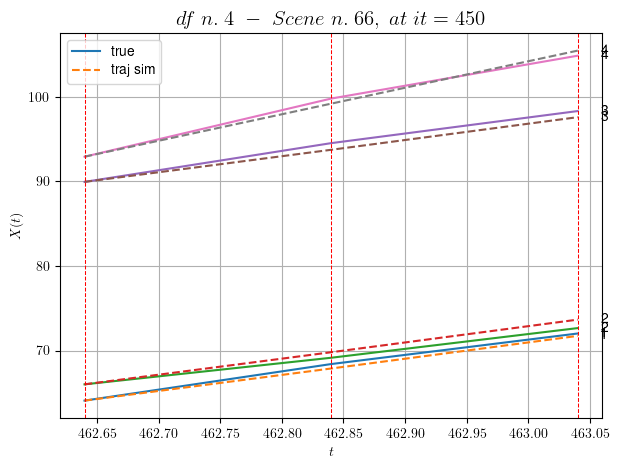

----------------------------------------------------------------------------------------------------
        For scene 32/46:
        * After LR finder: LR_NN=0.005 with mse=0.3164015663184069 at it=24
        * v0 = 31.352435977059542
        * MSE = 0.29956948935598626
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.33/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [495.24,495.84]


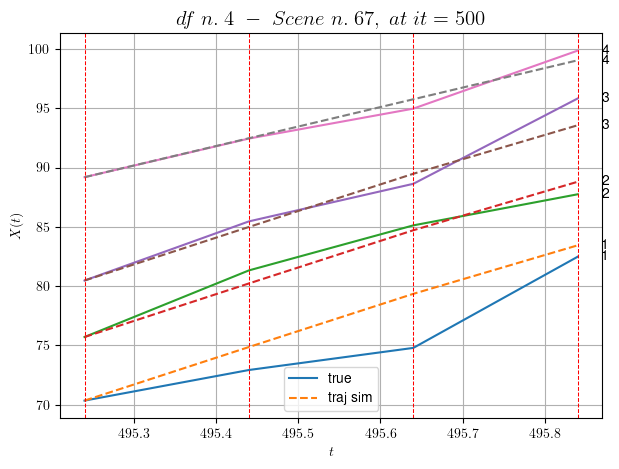

----------------------------------------------------------------------------------------------------
        For scene 33/46:
        * After LR finder: LR_NN=0.005 with mse=8.481878077170112 at it=24
        * v0 = 16.43780548223551
        * MSE = 2.1899741469444334
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.34/46
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [566.84,569.24]


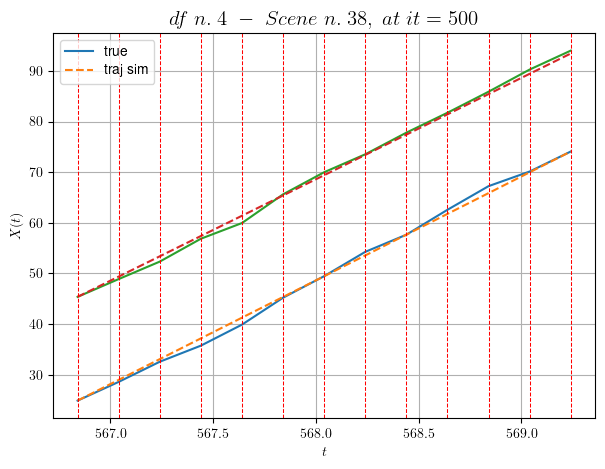

----------------------------------------------------------------------------------------------------
        For scene 34/46:
        * After LR finder: LR_NN=0.001 with mse=96.54246399311043 at it=24
        * v0 = 20.028487582197588
        * MSE = 0.4866567390362261
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.35/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [406.24,406.64]


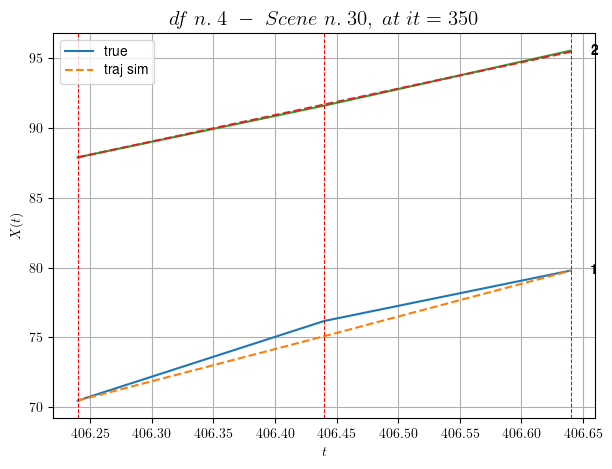

----------------------------------------------------------------------------------------------------
        For scene 35/46:
        * After LR finder: LR_NN=0.001 with mse=11.024841597328468 at it=24
        * v0 = 18.92651972748161
        * MSE = 0.2002812771312861
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.36/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [89.04,89.84]


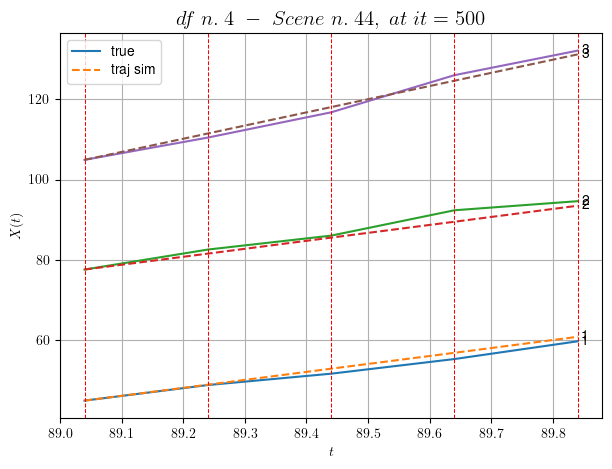

----------------------------------------------------------------------------------------------------
        For scene 36/46:
        * After LR finder: LR_NN=0.001 with mse=2.4107280793125745 at it=24
        * v0 = 32.775431632602626
        * MSE = 1.4234478279145202
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.37/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [460.84,461.24]


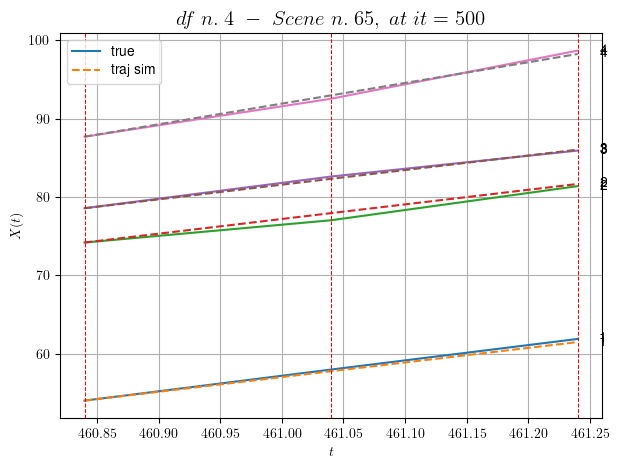

----------------------------------------------------------------------------------------------------
        For scene 37/46:
        * After LR finder: LR_NN=0.005 with mse=0.28891592099449126 at it=24
        * v0 = 26.404314529226422
        * MSE = 0.12857149838676601
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.38/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [59.84,60.44]


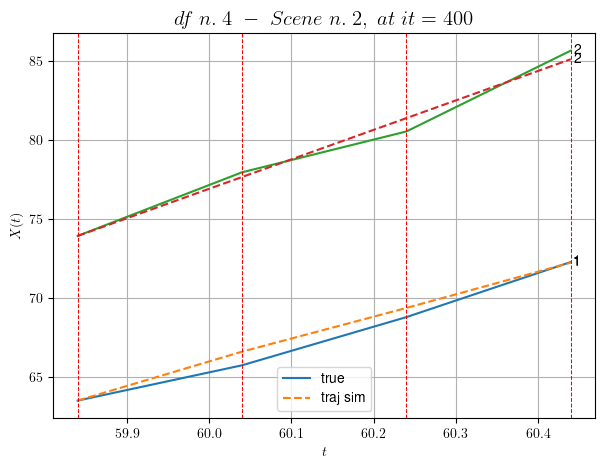

----------------------------------------------------------------------------------------------------
        For scene 38/46:
        * After LR finder: LR_NN=0.01 with mse=9.15349228427416 at it=24
        * v0 = 18.62551828792452
        * MSE = 0.27111018641366325
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.39/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [302.44,302.84]


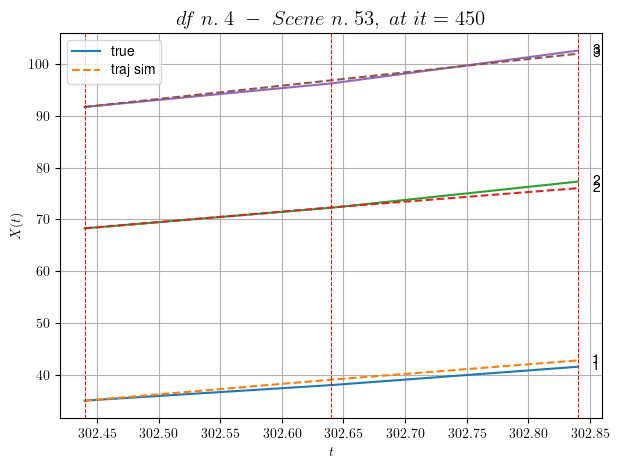

----------------------------------------------------------------------------------------------------
        For scene 39/46:
        * After LR finder: LR_NN=0.01 with mse=0.8586358194977853 at it=24
        * v0 = 25.744539084393605
        * MSE = 0.5445992938931433
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.40/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [288.04,289.04]


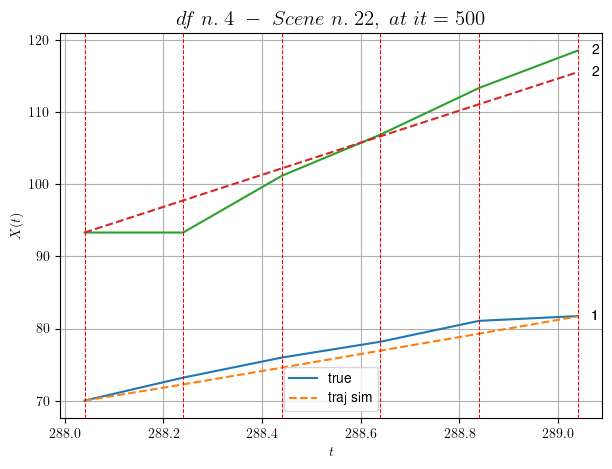

----------------------------------------------------------------------------------------------------
        For scene 40/46:
        * After LR finder: LR_NN=0.005 with mse=10.045623601785143 at it=24
        * v0 = 22.24789971530882
        * MSE = 3.2181941436720933
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.41/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [65.04,65.64]


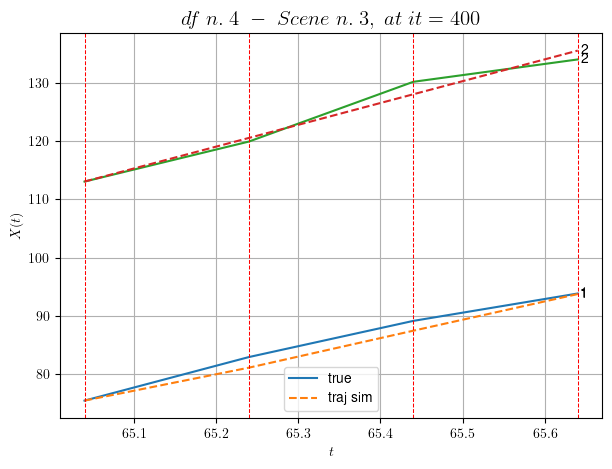

----------------------------------------------------------------------------------------------------
        For scene 41/46:
        * After LR finder: LR_NN=0.005 with mse=5.404781649825768 at it=24
        * v0 = 37.419037411945034
        * MSE = 1.6676205408418747
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.42/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.44,321.04]


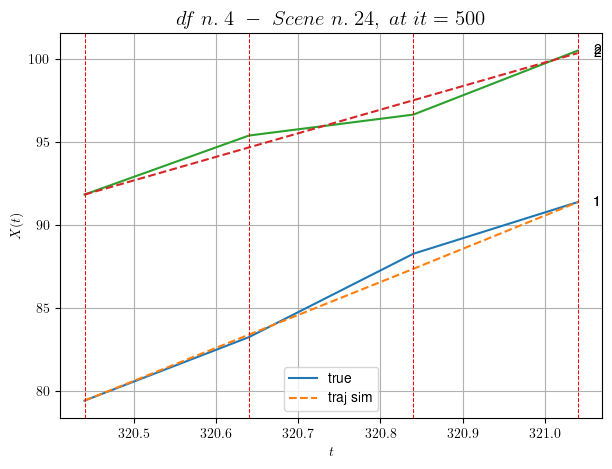

----------------------------------------------------------------------------------------------------
        For scene 42/46:
        * After LR finder: LR_NN=0.001 with mse=18.350017617355228 at it=24
        * v0 = 14.162426648993808
        * MSE = 0.26398608329319817
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.43/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [285.84,287.44]


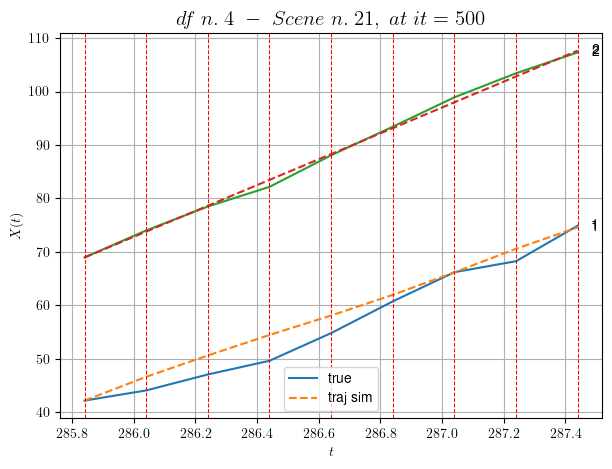

----------------------------------------------------------------------------------------------------
        For scene 43/46:
        * After LR finder: LR_NN=0.01 with mse=16.947972229487327 at it=24
        * v0 = 24.20183084742433
        * MSE = 2.16966727886369
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.44/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.64,555.04]


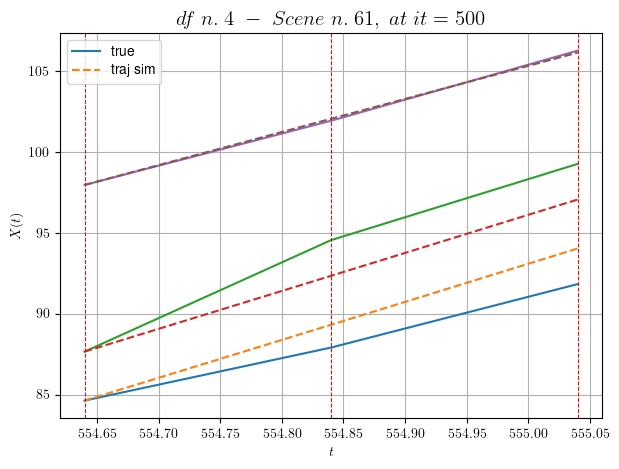

----------------------------------------------------------------------------------------------------
        For scene 44/46:
        * After LR finder: LR_NN=0.001 with mse=26.907425133522704 at it=24
        * v0 = 20.440727818765048
        * MSE = 1.8373132004907413
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.45/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [182.04,183.64]


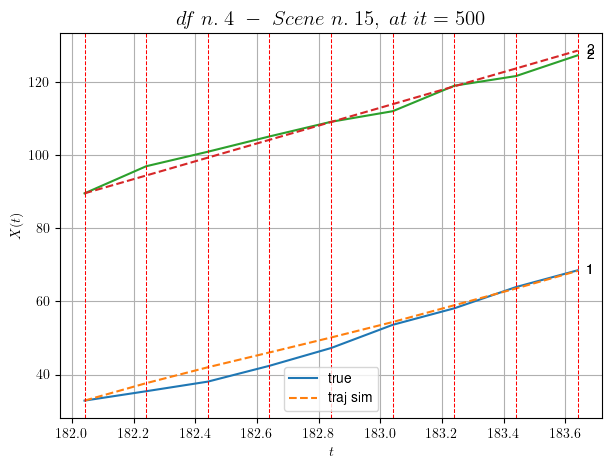

----------------------------------------------------------------------------------------------------
        For scene 45/46:
        * After LR finder: LR_NN=0.01 with mse=19.55159197907643 at it=24
        * v0 = 24.384953428579735
        * MSE = 2.282861223015007
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.46/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [233.84,235.24]


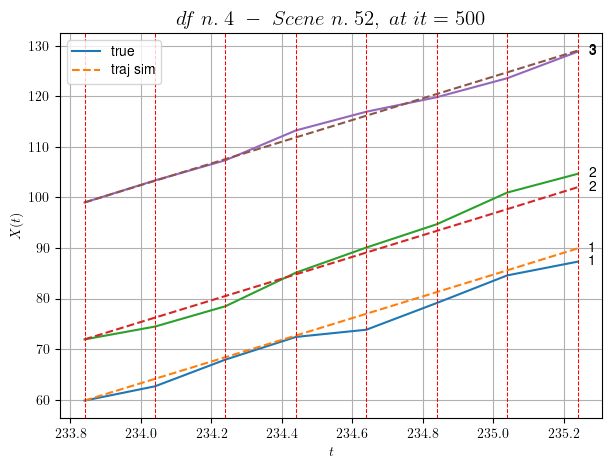

----------------------------------------------------------------------------------------------------
        For scene 46/46:
        * After LR finder: LR_NN=0.001 with mse=20.04855291004215 at it=24
        * v0 = 21.46280647198815
        * MSE = 2.3812879883220663
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 2.0380832491163354
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (23 scenes)
DataFrame n.4. Scene n.1/23


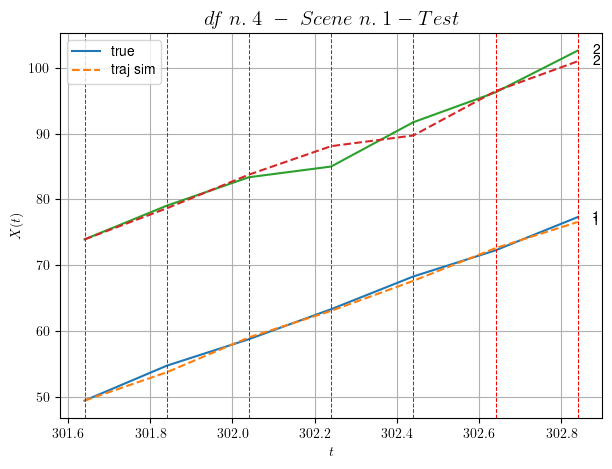

        For scene 1/23:
        * MSE = 1.3506777770239502
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/23


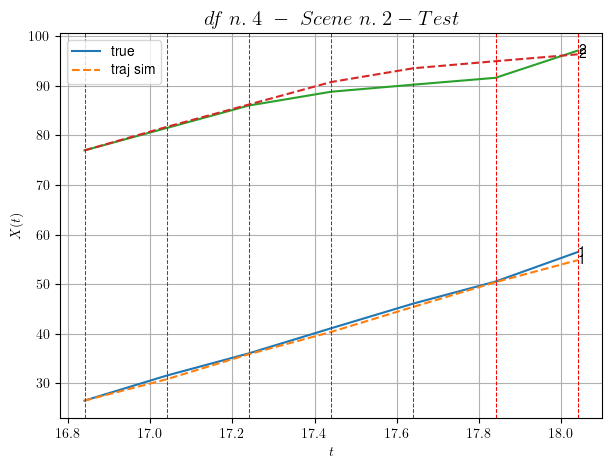

        For scene 2/23:
        * MSE = 2.20186968177834
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/23


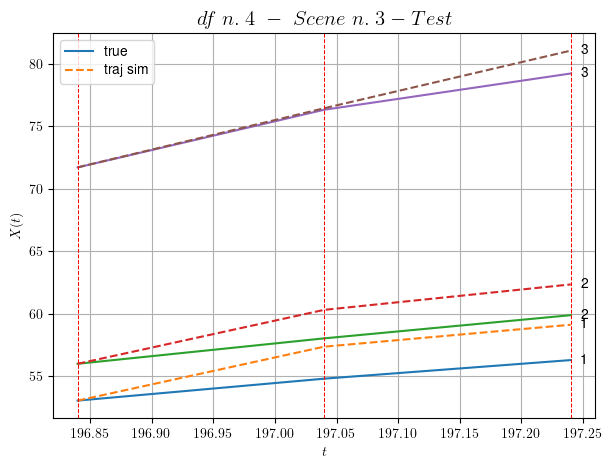

        For scene 3/23:
        * MSE = 3.2361203107539236
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/23


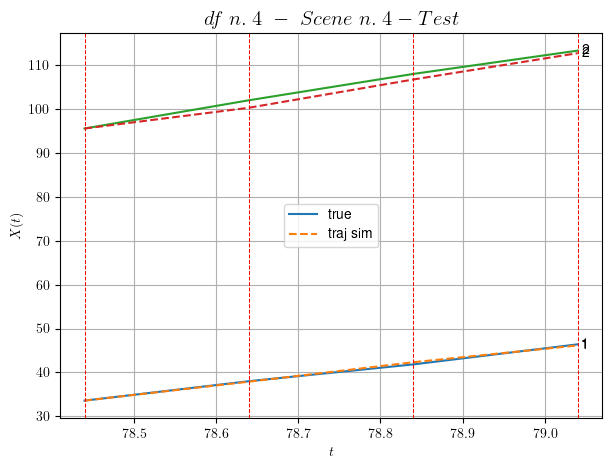

        For scene 4/23:
        * MSE = 0.6432879026857284
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/23


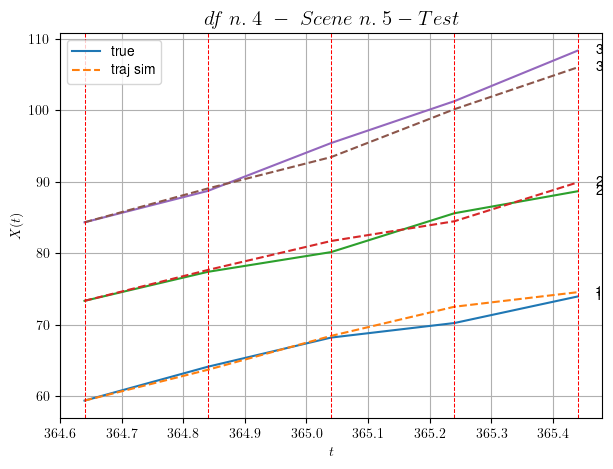

        For scene 5/23:
        * MSE = 1.4501513052291604
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/23


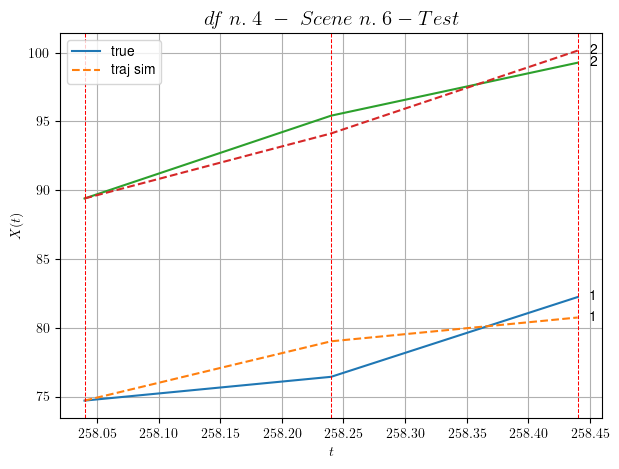

        For scene 6/23:
        * MSE = 1.8870447109926993
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/23


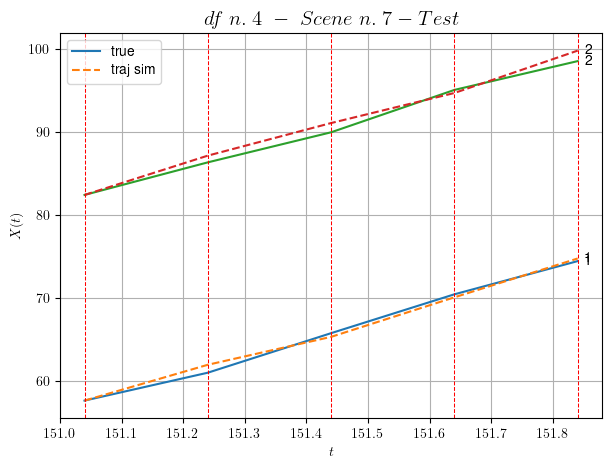

        For scene 7/23:
        * MSE = 0.4958274134807177
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/23


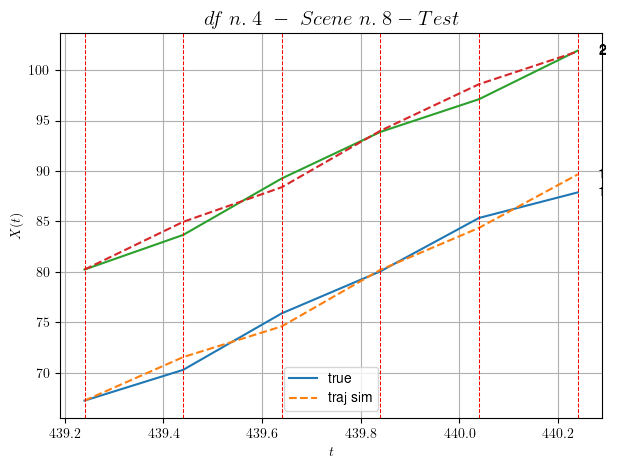

        For scene 8/23:
        * MSE = 1.0084032955748448
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/23


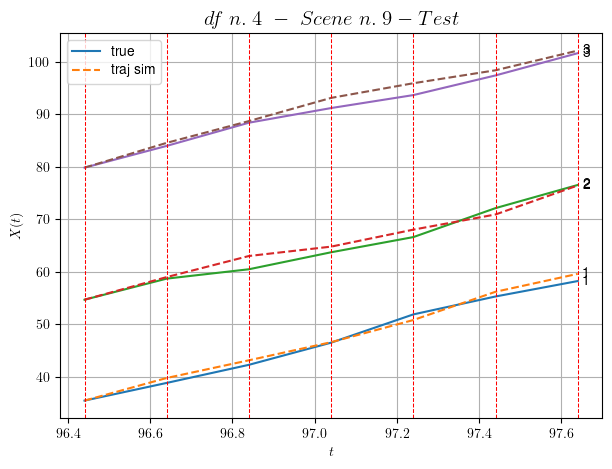

        For scene 9/23:
        * MSE = 1.289243449657398
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/23


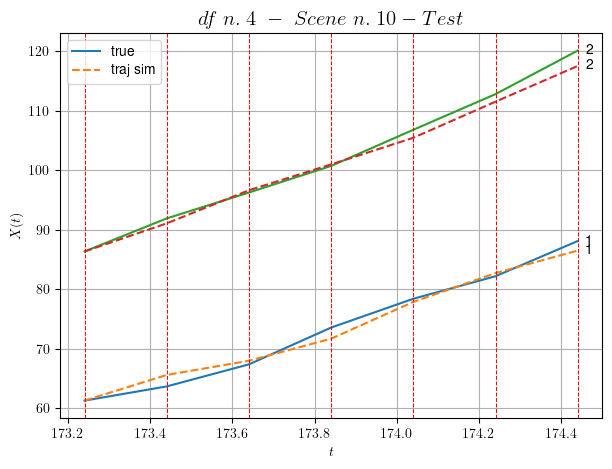

        For scene 10/23:
        * MSE = 1.5499135102958423
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/23


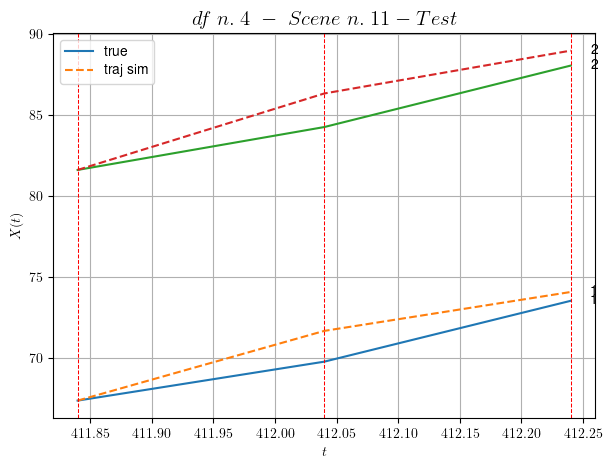

        For scene 11/23:
        * MSE = 1.514504421232813
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/23


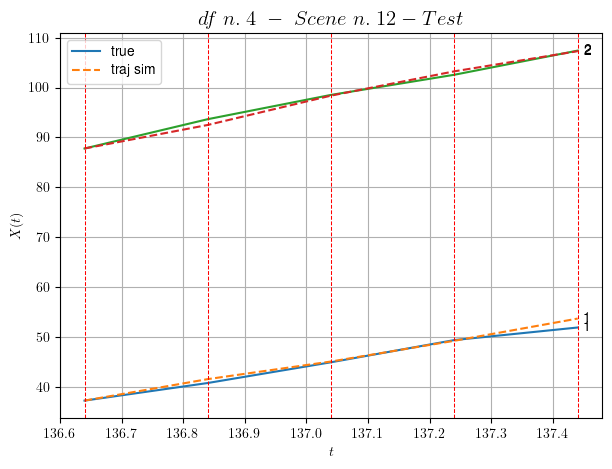

        For scene 12/23:
        * MSE = 0.5700811915552757
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/23


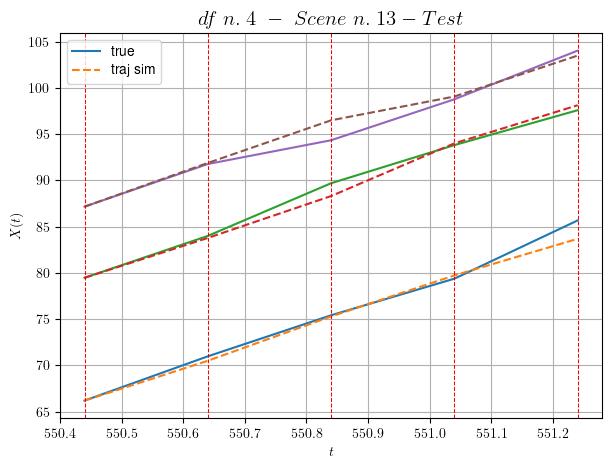

        For scene 13/23:
        * MSE = 0.7768474866576228
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/23


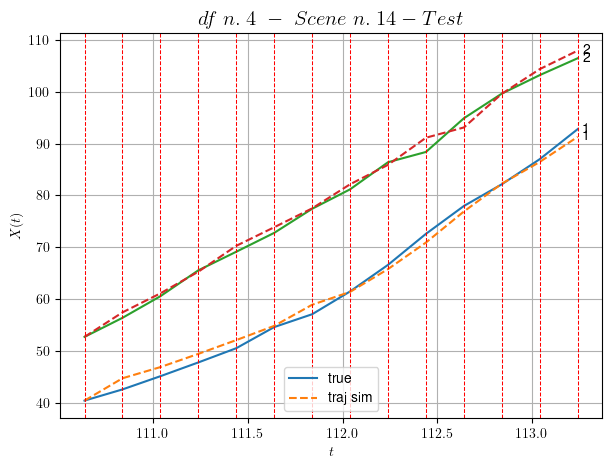

        For scene 14/23:
        * MSE = 1.5305479499034893
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/23


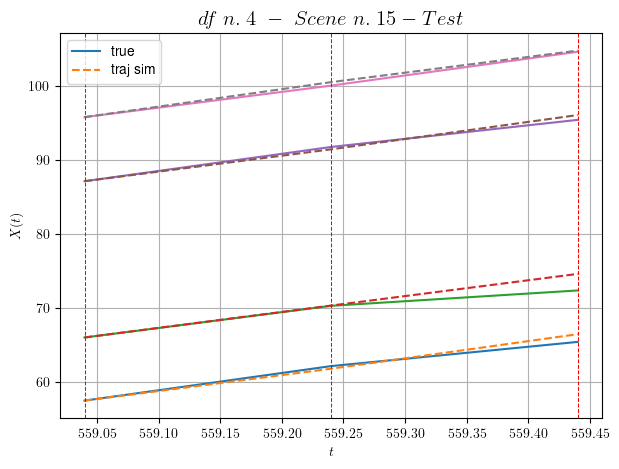

        For scene 15/23:
        * MSE = 0.5818092153874009
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/23


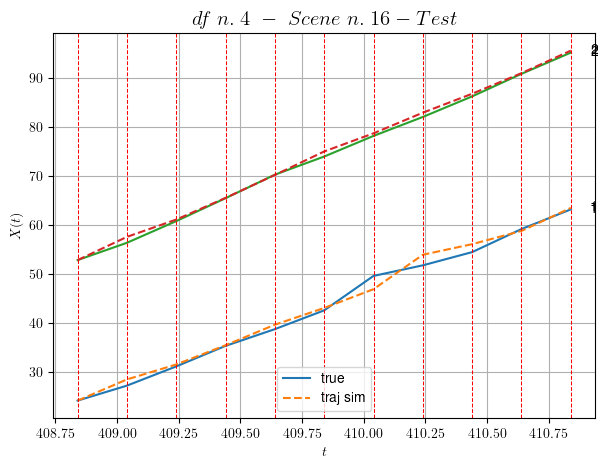

        For scene 16/23:
        * MSE = 0.99077271834325
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/23


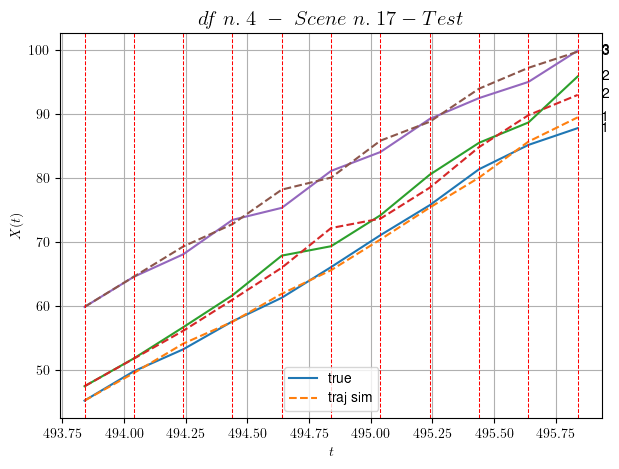

        For scene 17/23:
        * MSE = 1.676801577278902
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/23


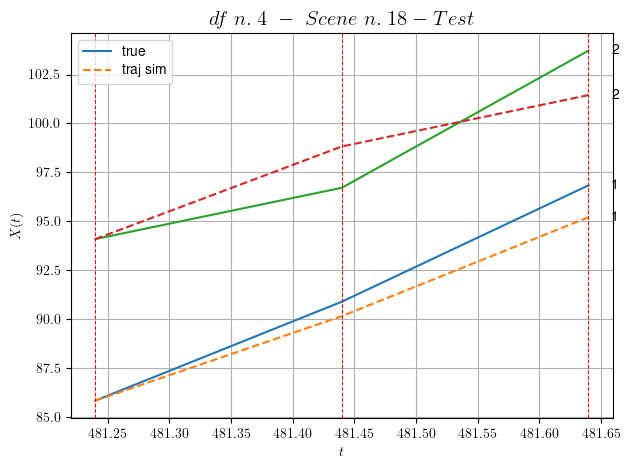

        For scene 18/23:
        * MSE = 2.1339212666651917
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/23


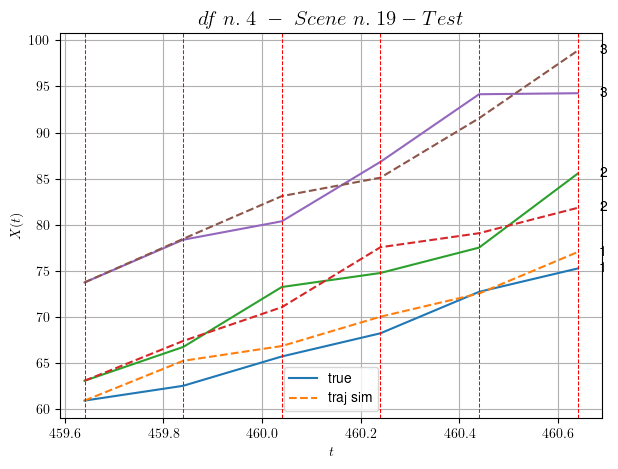

        For scene 19/23:
        * MSE = 4.597047375354195
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/23


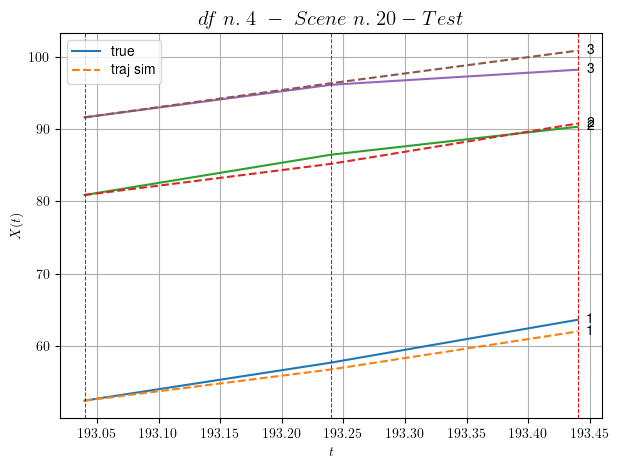

        For scene 20/23:
        * MSE = 1.3715649257441684
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/23


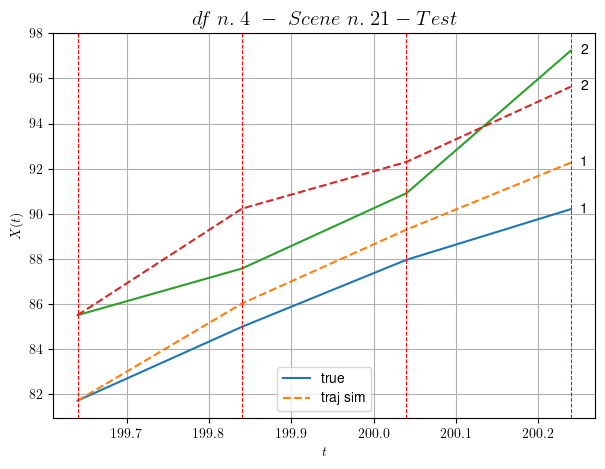

        For scene 21/23:
        * MSE = 2.335754551709969
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/23


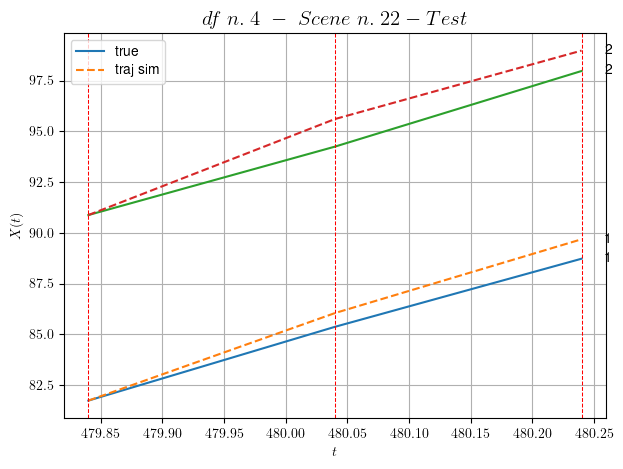

        For scene 22/23:
        * MSE = 0.7047301514427156
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/23


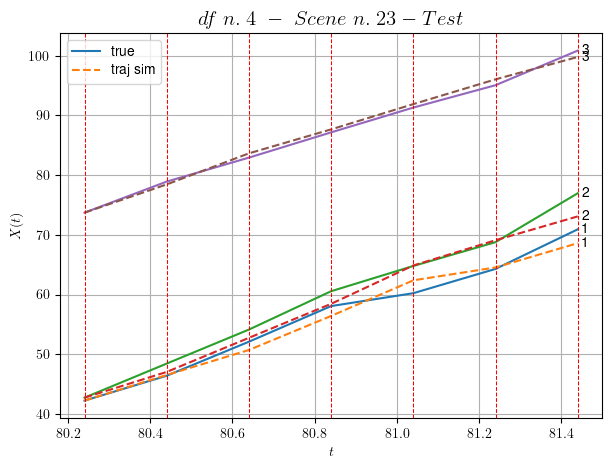

        For scene 23/23:
        * MSE = 1.9826206711979781
----------------------------------------------------------------------------------------------------


MSE test: 1.5599801243454596

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 2.0380832491163354
          * MSE test: 1.5599801243454596
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 5/10 dfs.
In DataFrame n.5 we have 66 scenes.
    To train the model we use 44 scenes, the remaining 22 to test the model.

Training step. (44 scenes)
DataFrame n.5. Scene n.1/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [64.32,65.32]


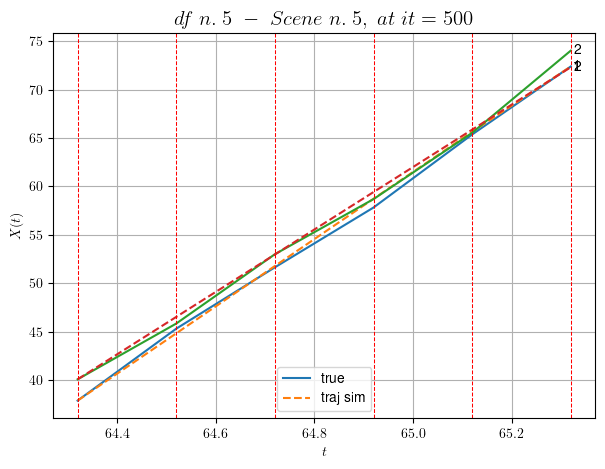

----------------------------------------------------------------------------------------------------
        For scene 1/44:
        * After LR finder: LR_NN=0.0005 with mse=1.7503678669191438 at it=24
        * v0 = 32.23387857341362
        * MSE = 0.43281750052125667
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [502.72,503.72]


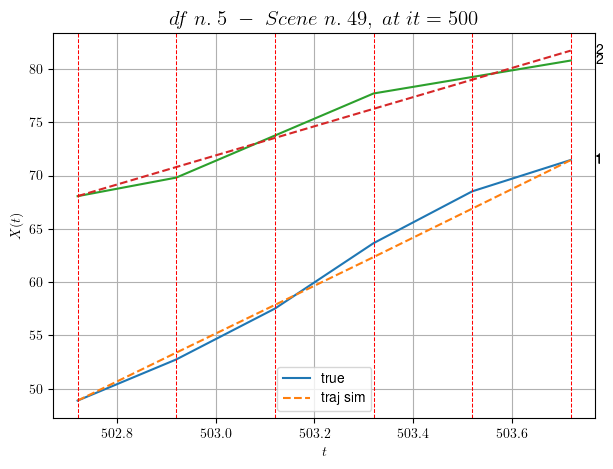

----------------------------------------------------------------------------------------------------
        For scene 2/44:
        * After LR finder: LR_NN=0.001 with mse=50.09202609724484 at it=24
        * v0 = 13.651414022050272
        * MSE = 0.7347639518463348
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [395.32,395.72]


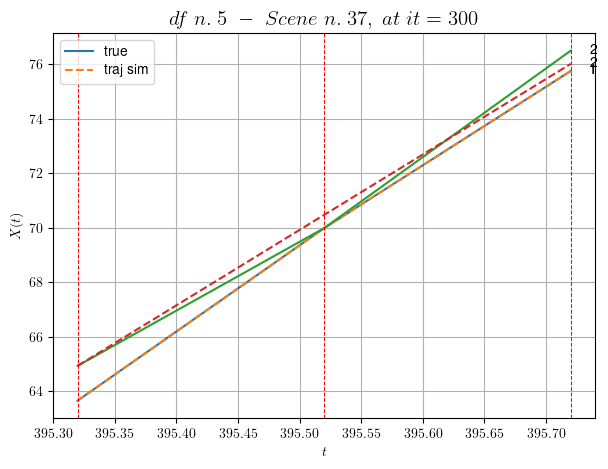

----------------------------------------------------------------------------------------------------
        For scene 3/44:
        * After LR finder: LR_NN=0.005 with mse=0.23855137362109477 at it=24
        * v0 = 27.699213779679276
        * MSE = 0.07069011795587479
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [225.72,226.12]


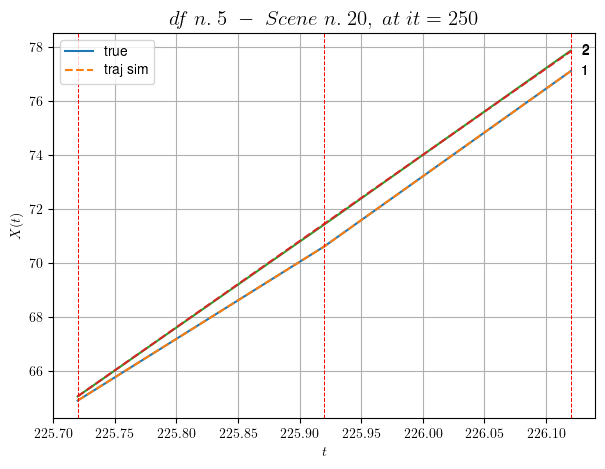

----------------------------------------------------------------------------------------------------
        For scene 4/44:
        * After LR finder: LR_NN=0.005 with mse=0.14613961150665328 at it=24
        * v0 = 32.02147602886366
        * MSE = 0.00021986920949298611
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [177.32,178.52]


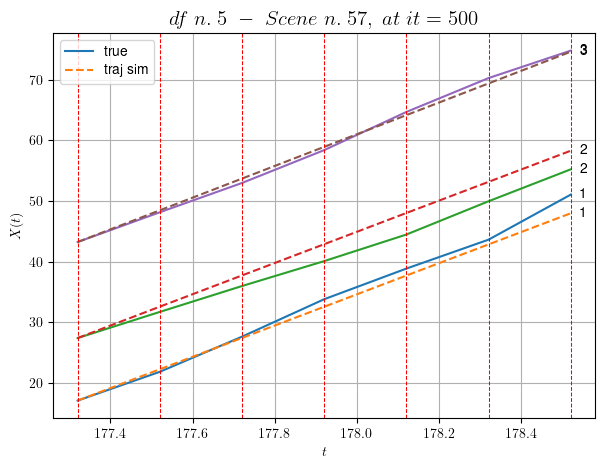

----------------------------------------------------------------------------------------------------
        For scene 5/44:
        * After LR finder: LR_NN=0.001 with mse=38.04776800616255 at it=24
        * v0 = 26.180378384786394
        * MSE = 2.814483606050389
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [319.52,319.92]


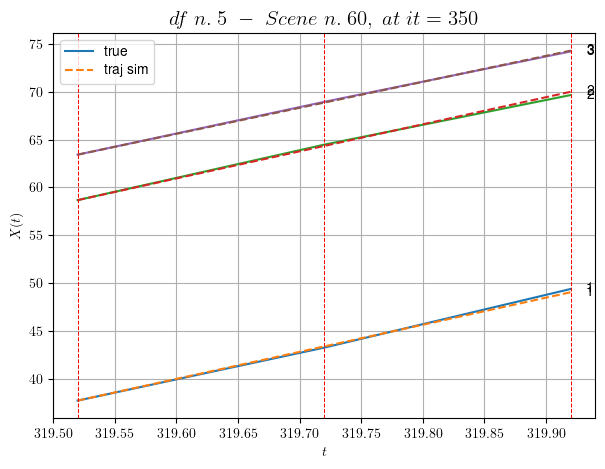

----------------------------------------------------------------------------------------------------
        For scene 6/44:
        * After LR finder: LR_NN=0.005 with mse=0.21336780338912054 at it=24
        * v0 = 27.222480010439305
        * MSE = 0.03173812010203334
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [316.92,317.32]


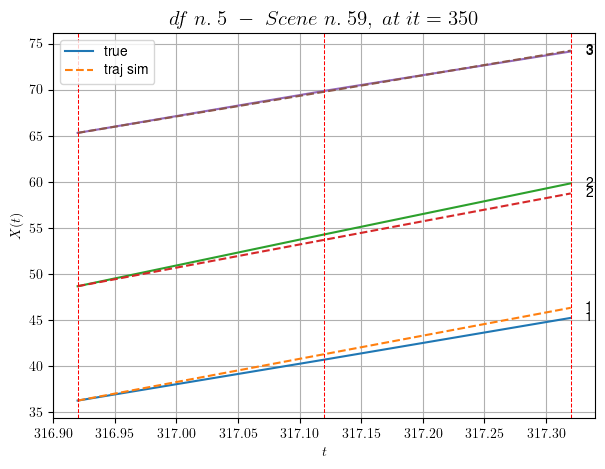

----------------------------------------------------------------------------------------------------
        For scene 7/44:
        * After LR finder: LR_NN=0.0005 with mse=1.3443783558755713 at it=24
        * v0 = 22.3421011962981
        * MSE = 0.34609859727898257
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [533.12,533.52]


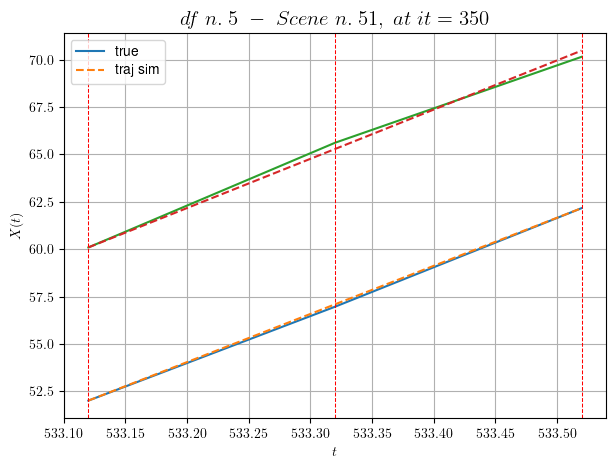

----------------------------------------------------------------------------------------------------
        For scene 8/44:
        * After LR finder: LR_NN=0.0005 with mse=0.6733720945654826 at it=24
        * v0 = 25.94872036057731
        * MSE = 0.03867994197855703
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [332.72,334.12]


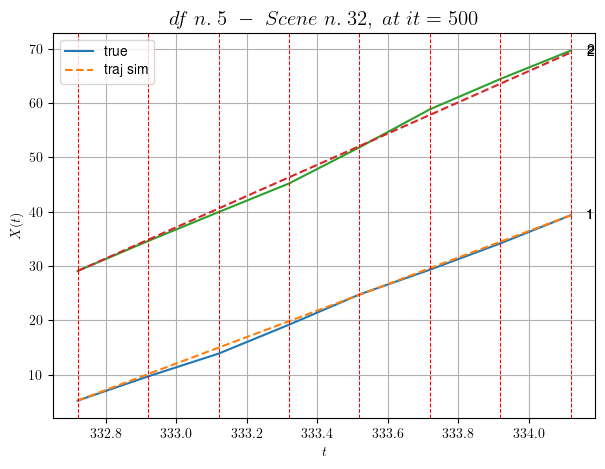

----------------------------------------------------------------------------------------------------
        For scene 9/44:
        * After LR finder: LR_NN=0.001 with mse=0.7138820498756694 at it=24
        * v0 = 28.714685816755896
        * MSE = 0.33806745506247493
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [457.32,458.32]


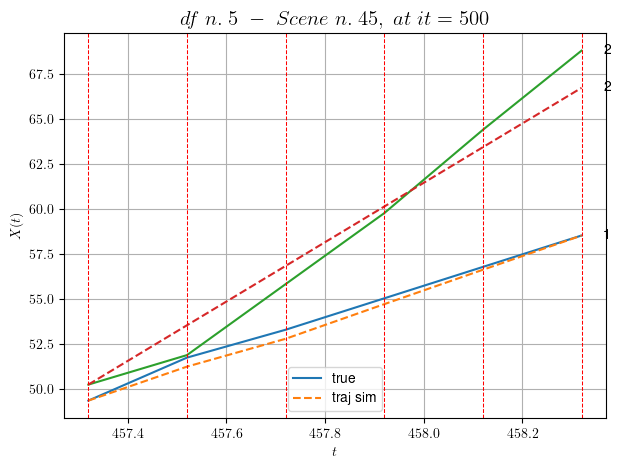

----------------------------------------------------------------------------------------------------
        For scene 10/44:
        * After LR finder: LR_NN=0.005 with mse=30.001625998125625 at it=24
        * v0 = 16.493097805853914
        * MSE = 0.683550991292032
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [578.92,579.52]


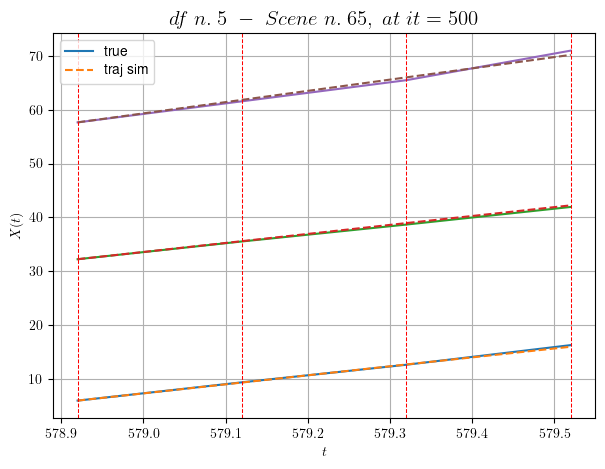

----------------------------------------------------------------------------------------------------
        For scene 11/44:
        * After LR finder: LR_NN=0.01 with mse=3.6357893380902078 at it=24
        * v0 = 20.916611347755605
        * MSE = 0.09783235063552927
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [167.32,167.72]


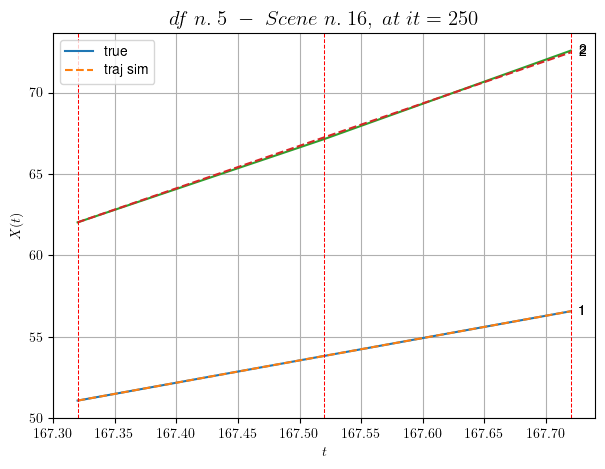

----------------------------------------------------------------------------------------------------
        For scene 12/44:
        * After LR finder: LR_NN=0.005 with mse=0.48115757424264166 at it=24
        * v0 = 26.107264726505786
        * MSE = 0.0034370013659636126
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [293.52,294.32]


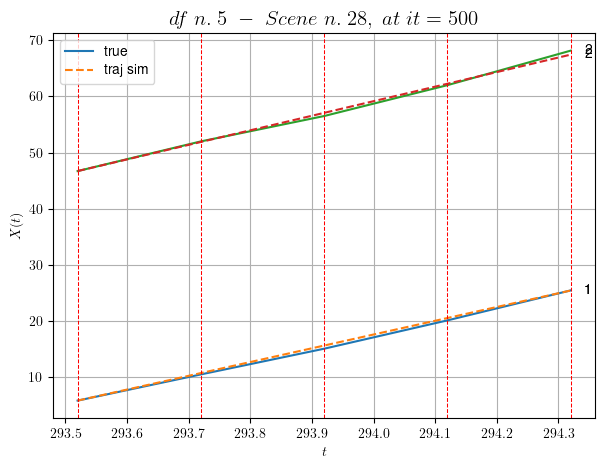

----------------------------------------------------------------------------------------------------
        For scene 13/44:
        * After LR finder: LR_NN=5e-05 with mse=1.9630325675850988 at it=24
        * v0 = 25.9305274823744
        * MSE = 0.12308510215125615
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [282.52,282.92]


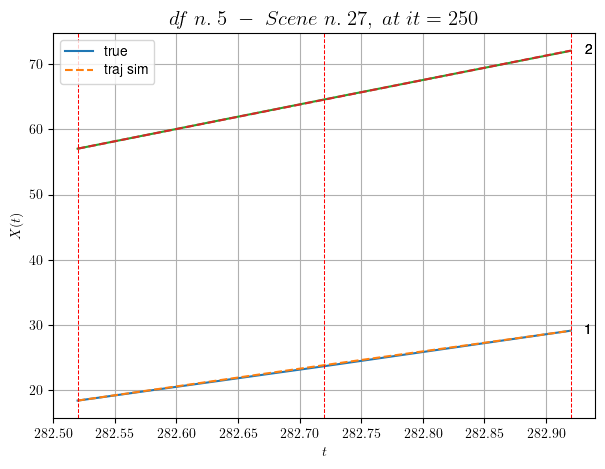

----------------------------------------------------------------------------------------------------
        For scene 14/44:
        * After LR finder: LR_NN=0.01 with mse=1.8875370909358555 at it=24
        * v0 = 37.54118524558378
        * MSE = 0.004478555931639977
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [274.12,275.52]


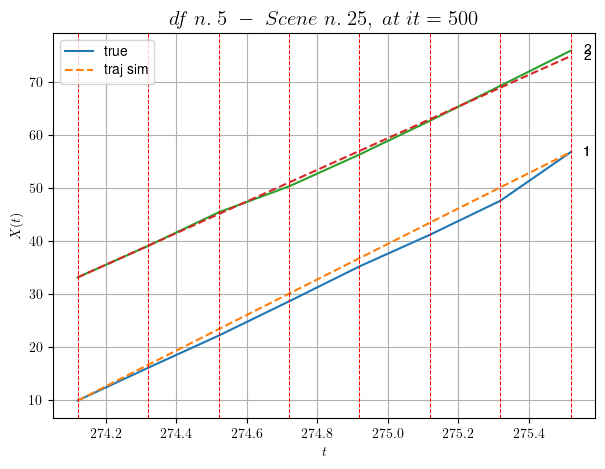

----------------------------------------------------------------------------------------------------
        For scene 15/44:
        * After LR finder: LR_NN=0.001 with mse=1.4733319750714788 at it=24
        * v0 = 29.831436253446103
        * MSE = 0.7238398625385167
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [496.72,497.12]


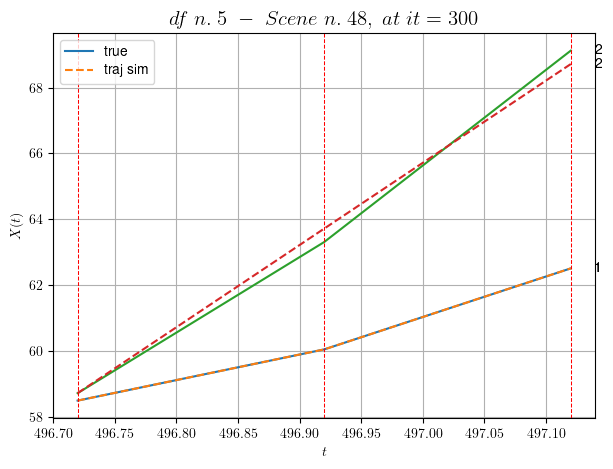

----------------------------------------------------------------------------------------------------
        For scene 16/44:
        * After LR finder: LR_NN=0.01 with mse=0.7883829603653736 at it=24
        * v0 = 25.01096735428259
        * MSE = 0.049975545503128764
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [125.12,126.12]


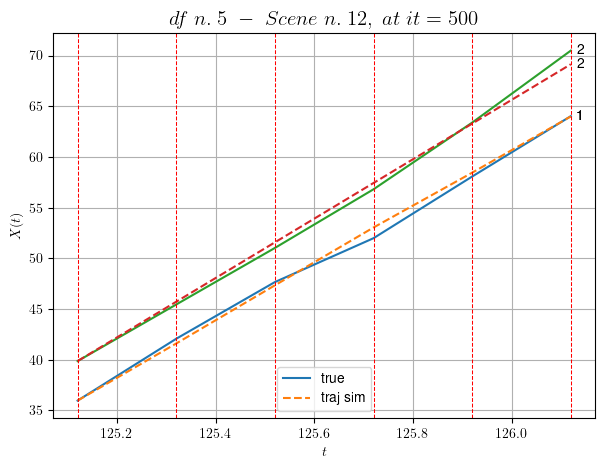

----------------------------------------------------------------------------------------------------
        For scene 17/44:
        * After LR finder: LR_NN=0.005 with mse=0.38342420003365263 at it=24
        * v0 = 29.269210394723714
        * MSE = 0.343686255442626
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/44
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [337.72,339.52]


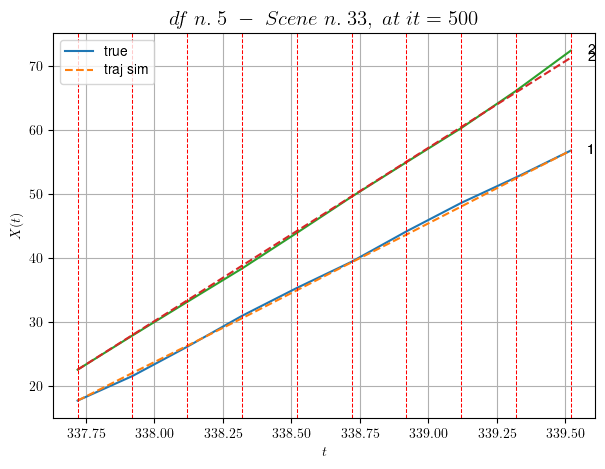

----------------------------------------------------------------------------------------------------
        For scene 18/44:
        * After LR finder: LR_NN=0.01 with mse=4.803073124203404 at it=24
        * v0 = 27.020038219087652
        * MSE = 0.13969449432151826
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [338.52,339.52]


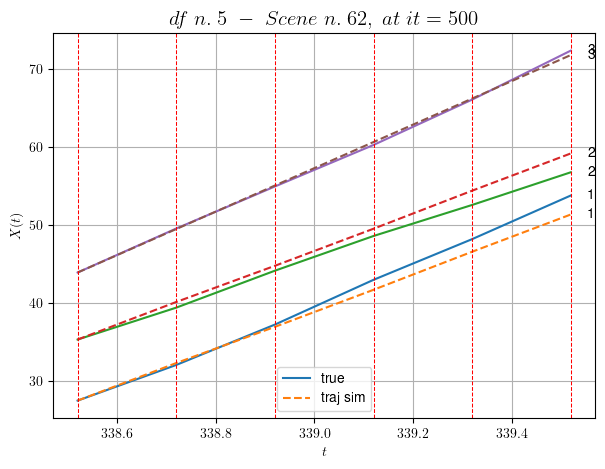

----------------------------------------------------------------------------------------------------
        For scene 19/44:
        * After LR finder: LR_NN=0.01 with mse=1.7499623765596752 at it=24
        * v0 = 27.853928426097372
        * MSE = 1.2077683132974966
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [490.92,491.32]


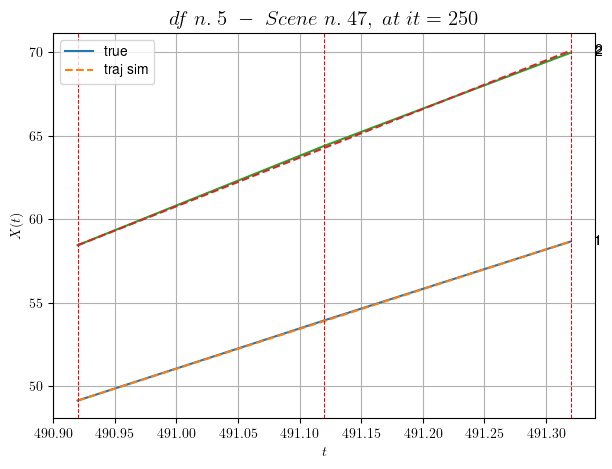

----------------------------------------------------------------------------------------------------
        For scene 20/44:
        * After LR finder: LR_NN=0.001 with mse=0.49732420384244724 at it=24
        * v0 = 29.11559727009669
        * MSE = 0.0052911351337646025
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [396.92,397.32]


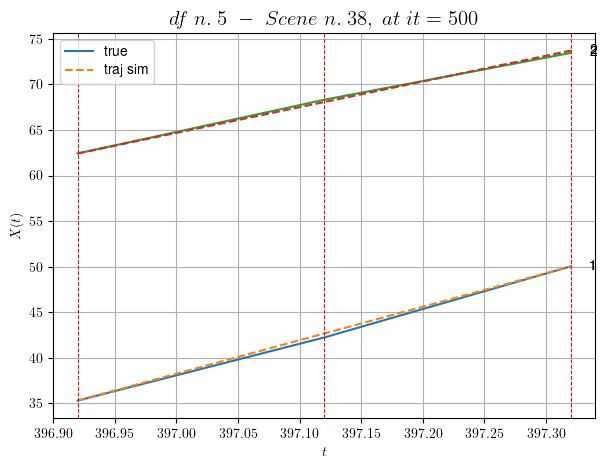

----------------------------------------------------------------------------------------------------
        For scene 21/44:
        * After LR finder: LR_NN=5e-05 with mse=0.2288563421366504 at it=24
        * v0 = 28.239105392623415
        * MSE = 0.04688661125034313
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [326.52,327.92]


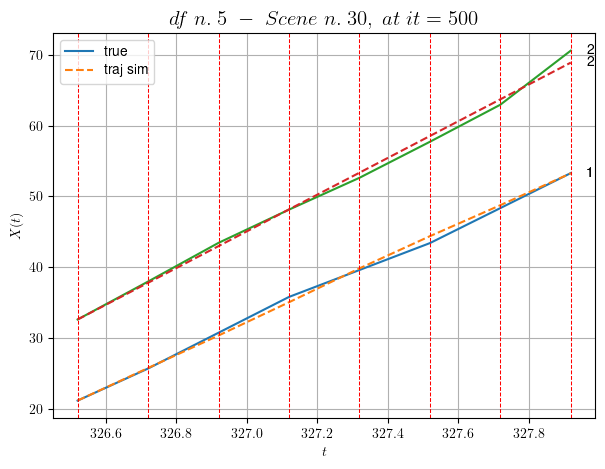

----------------------------------------------------------------------------------------------------
        For scene 22/44:
        * After LR finder: LR_NN=0.01 with mse=6.201933585952849 at it=24
        * v0 = 25.910216862746452
        * MSE = 0.424056454151317
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.23/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [450.92,451.52]


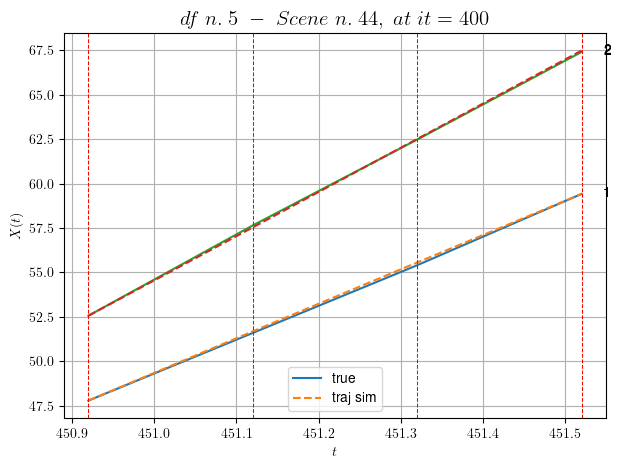

----------------------------------------------------------------------------------------------------
        For scene 23/44:
        * After LR finder: LR_NN=0.005 with mse=1.8911241894756472 at it=24
        * v0 = 24.87748266118287
        * MSE = 0.00620663405674973
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.24/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [525.52,526.12]


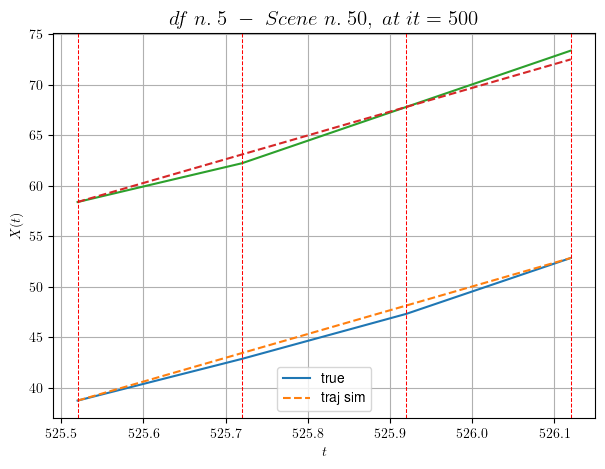

----------------------------------------------------------------------------------------------------
        For scene 24/44:
        * After LR finder: LR_NN=0.0001 with mse=2.6821034636232897 at it=24
        * v0 = 23.53935545424654
        * MSE = 0.2501705588462377
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.25/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [38.72,39.12]


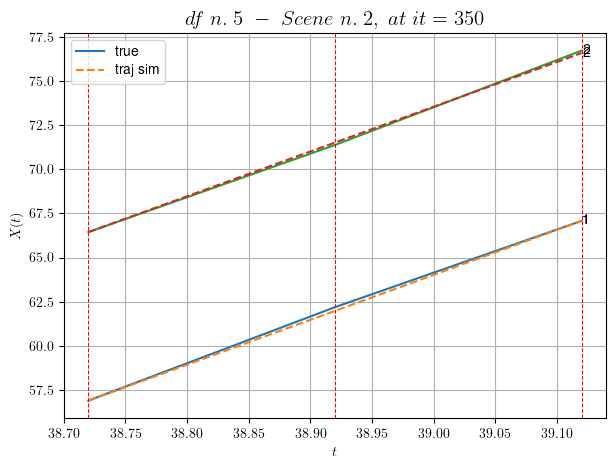

----------------------------------------------------------------------------------------------------
        For scene 25/44:
        * After LR finder: LR_NN=0.001 with mse=1.0537102839200334 at it=24
        * v0 = 25.372432045096946
        * MSE = 0.013313937527491881
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.26/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [232.32,233.52]


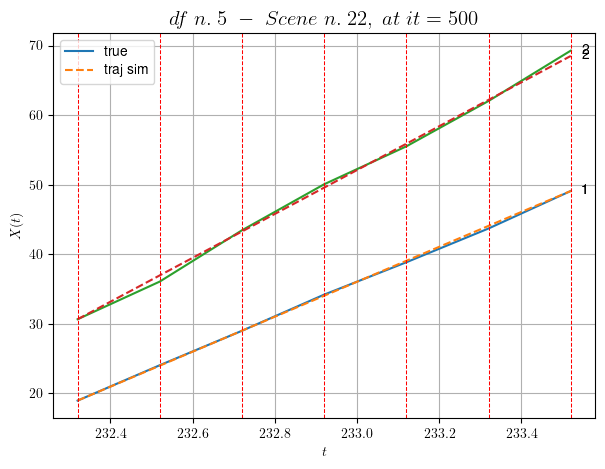

----------------------------------------------------------------------------------------------------
        For scene 26/44:
        * After LR finder: LR_NN=0.001 with mse=0.9009824782668353 at it=24
        * v0 = 31.537257787031557
        * MSE = 0.14490539727924903
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.27/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [47.12,47.52]


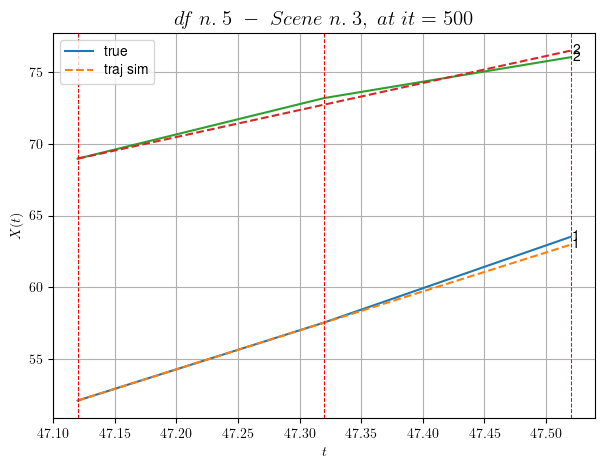

----------------------------------------------------------------------------------------------------
        For scene 27/44:
        * After LR finder: LR_NN=1e-05 with mse=18.303848870924767 at it=24
        * v0 = 18.771821269963535
        * MSE = 0.11907542846019578
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.28/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [28.12,28.72]


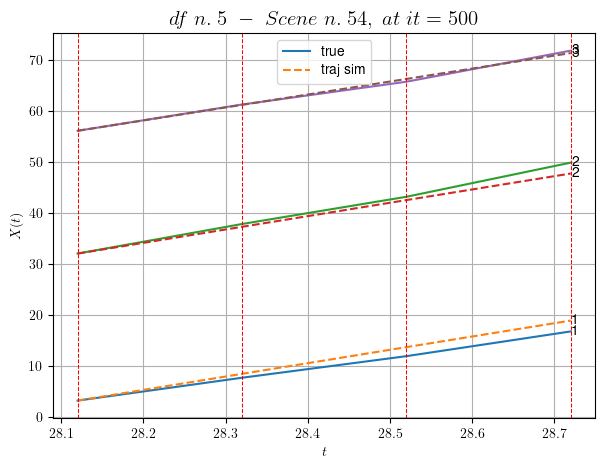

----------------------------------------------------------------------------------------------------
        For scene 28/44:
        * After LR finder: LR_NN=0.001 with mse=2.1298017151464848 at it=24
        * v0 = 25.379383792483882
        * MSE = 1.1678097928027156
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.29/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [415.32,416.32]


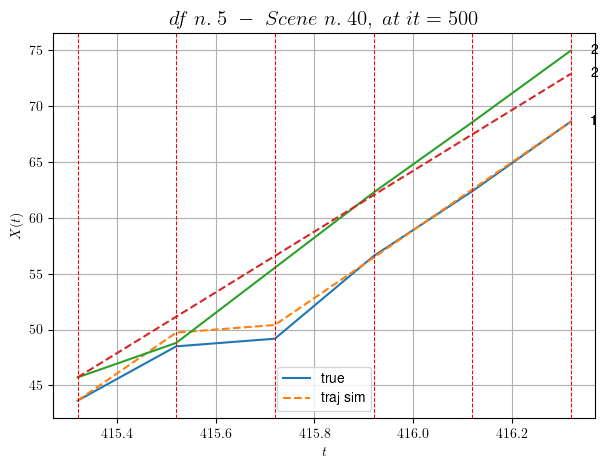

----------------------------------------------------------------------------------------------------
        For scene 29/44:
        * After LR finder: LR_NN=0.001 with mse=1.6728786875788175 at it=24
        * v0 = 27.18839531674018
        * MSE = 1.120840366305025
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.30/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [368.32,368.92]


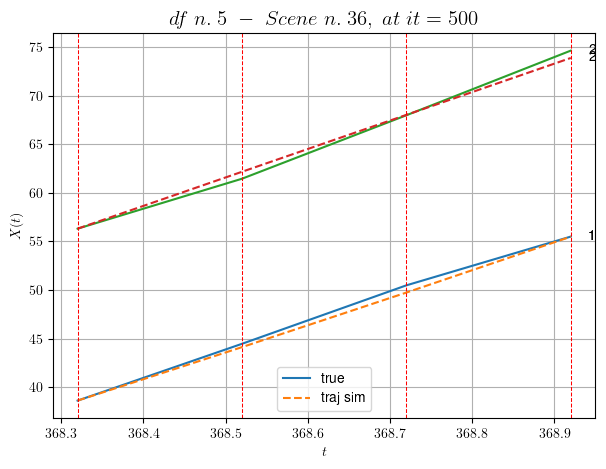

----------------------------------------------------------------------------------------------------
        For scene 30/44:
        * After LR finder: LR_NN=0.005 with mse=0.2393137480557784 at it=24
        * v0 = 29.298139298124838
        * MSE = 0.21926226454576128
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.31/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [23.72,24.52]


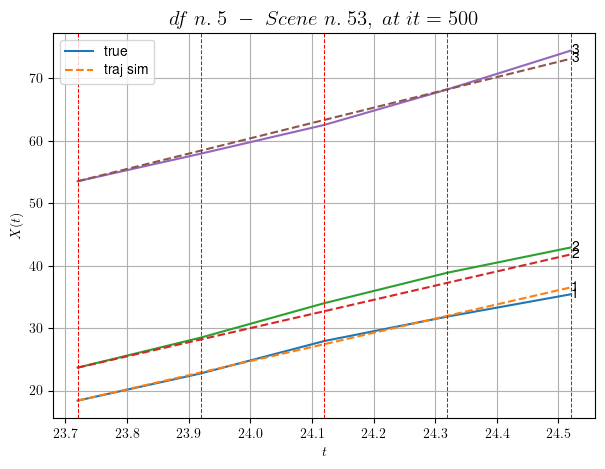

----------------------------------------------------------------------------------------------------
        For scene 31/44:
        * After LR finder: LR_NN=0.001 with mse=2.6613557229091085 at it=24
        * v0 = 24.53480373451942
        * MSE = 0.6326487533941144
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.32/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [264.92,266.12]


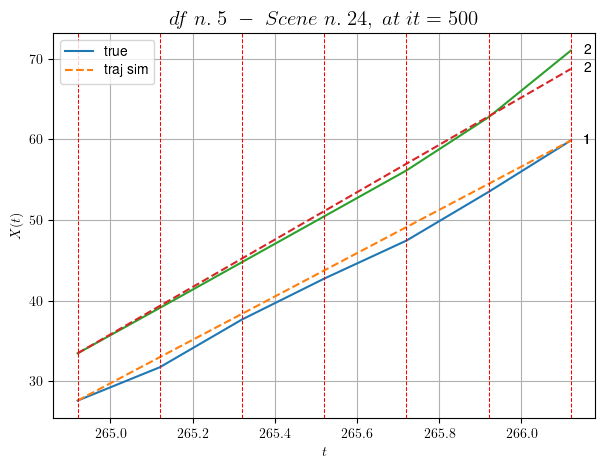

----------------------------------------------------------------------------------------------------
        For scene 32/44:
        * After LR finder: LR_NN=0.0005 with mse=0.5201527883090338 at it=24
        * v0 = 29.366788374198624
        * MSE = 0.6917963415549535
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.33/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [151.12,151.52]


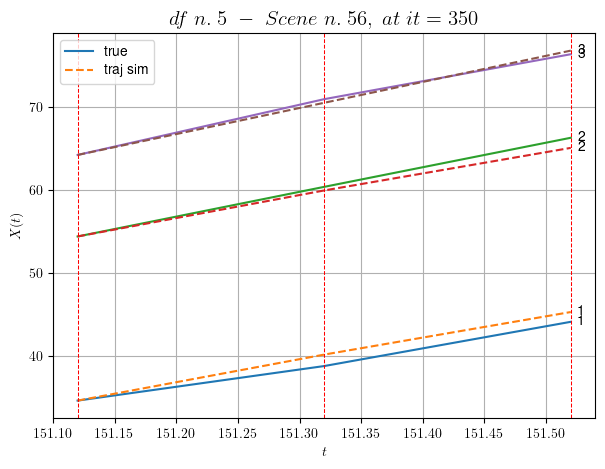

----------------------------------------------------------------------------------------------------
        For scene 33/44:
        * After LR finder: LR_NN=0.01 with mse=0.6419490671788618 at it=24
        * v0 = 31.51612778259323
        * MSE = 0.5976572441741538
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.34/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [123.92,124.52]


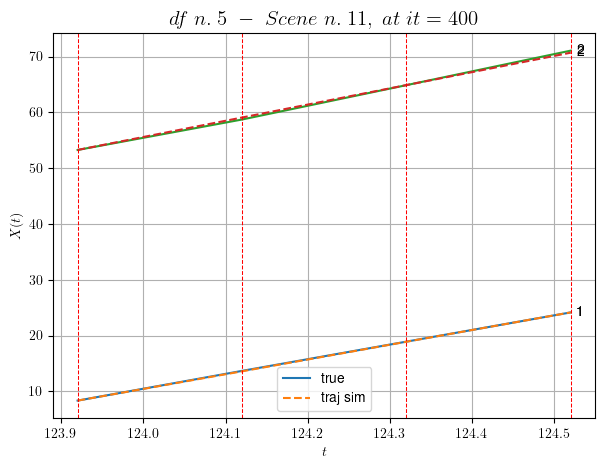

----------------------------------------------------------------------------------------------------
        For scene 34/44:
        * After LR finder: LR_NN=0.01 with mse=0.060857202234616284 at it=24
        * v0 = 29.067105023724768
        * MSE = 0.029032466863591067
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.35/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [251.72,252.72]


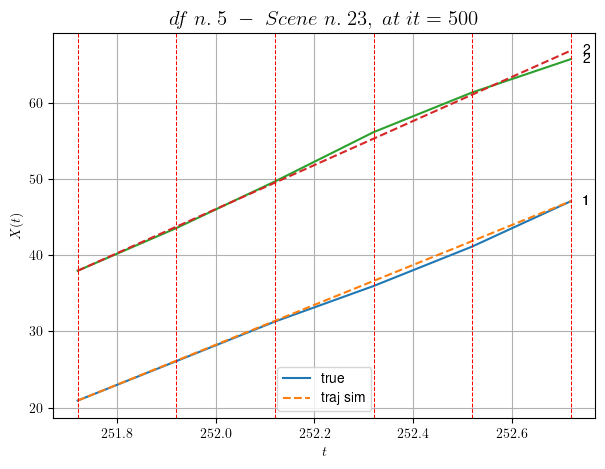

----------------------------------------------------------------------------------------------------
        For scene 35/44:
        * After LR finder: LR_NN=5e-05 with mse=0.5204634462385869 at it=24
        * v0 = 28.91133195438074
        * MSE = 0.25817675981863925
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.36/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [214.32,214.92]


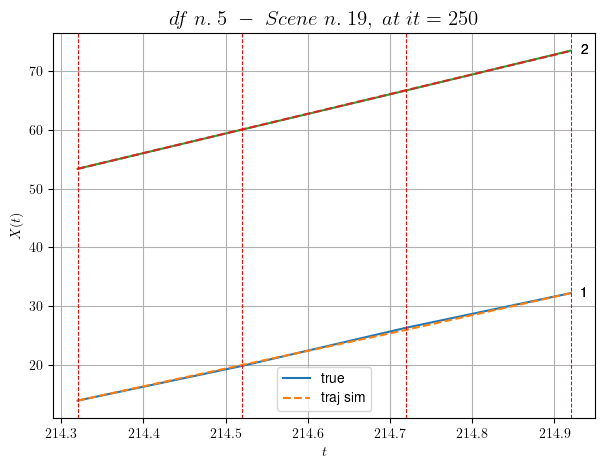

----------------------------------------------------------------------------------------------------
        For scene 36/44:
        * After LR finder: LR_NN=0.005 with mse=0.8513705180278921 at it=24
        * v0 = 33.416641711217174
        * MSE = 0.019379128629454158
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.37/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [266.92,267.32]


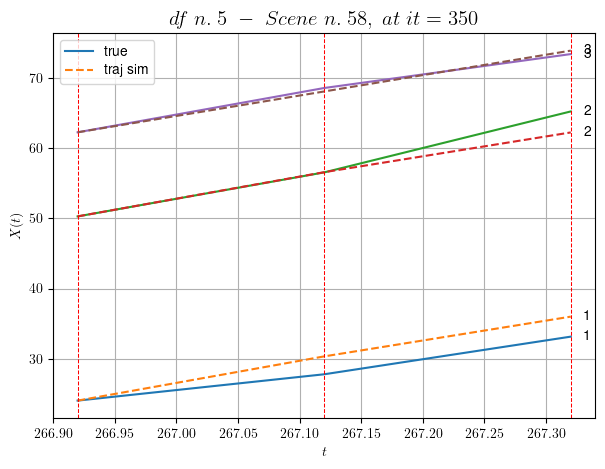

----------------------------------------------------------------------------------------------------
        For scene 37/44:
        * After LR finder: LR_NN=0.005 with mse=2.766913939132539 at it=24
        * v0 = 29.08570823249288
        * MSE = 2.6457359292384135
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.38/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [407.92,408.52]


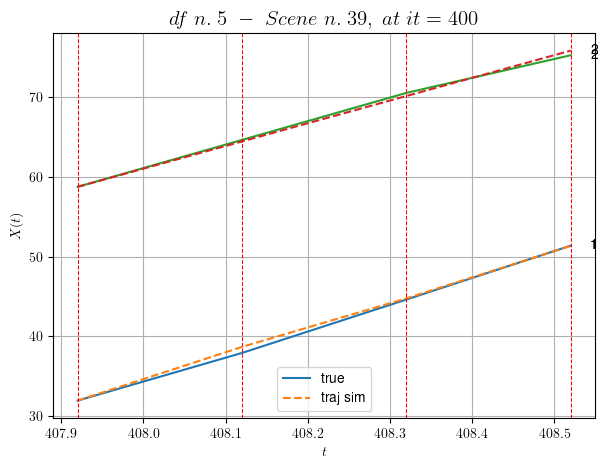

----------------------------------------------------------------------------------------------------
        For scene 38/44:
        * After LR finder: LR_NN=0.01 with mse=0.3660241354561504 at it=24
        * v0 = 28.450687364121002
        * MSE = 0.13903375318383726
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.39/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [226.72,227.92]


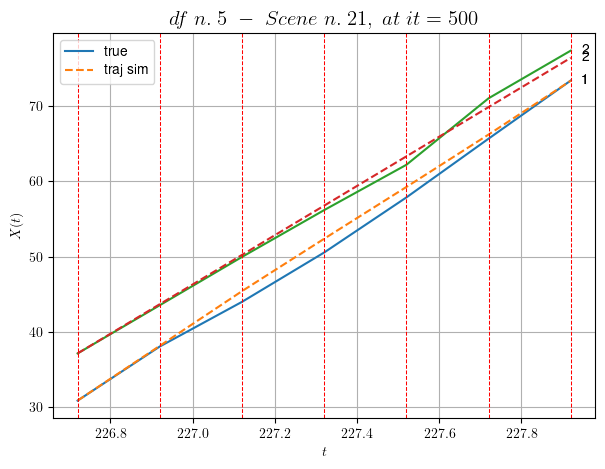

----------------------------------------------------------------------------------------------------
        For scene 39/44:
        * After LR finder: LR_NN=0.005 with mse=3.045835582712593 at it=24
        * v0 = 32.69366457961255
        * MSE = 0.8217013333274379
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.40/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [330.12,330.52]


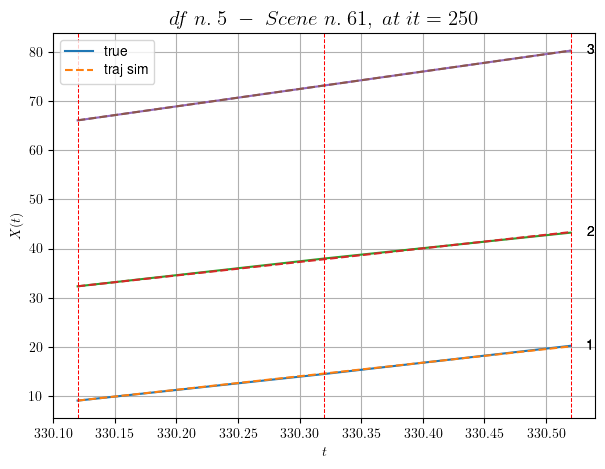

----------------------------------------------------------------------------------------------------
        For scene 40/44:
        * After LR finder: LR_NN=0.01 with mse=0.673743263858098 at it=24
        * v0 = 35.477501601633264
        * MSE = 0.006672810840794768
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.41/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [78.72,79.32]


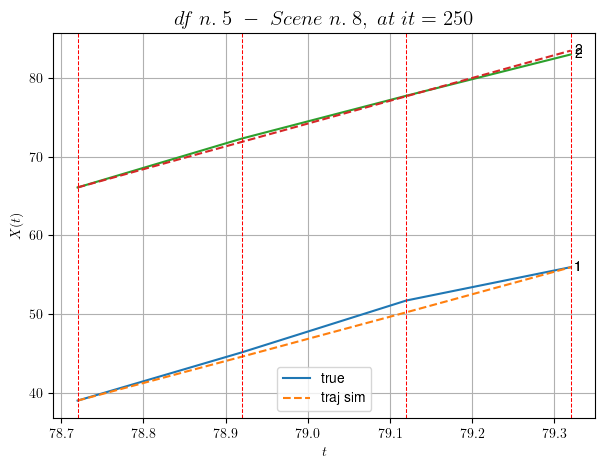

----------------------------------------------------------------------------------------------------
        For scene 41/44:
        * After LR finder: LR_NN=0.001 with mse=0.8215203876120701 at it=24
        * v0 = 28.965410232895493
        * MSE = 0.3694046870575067
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.42/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [449.12,450.12]


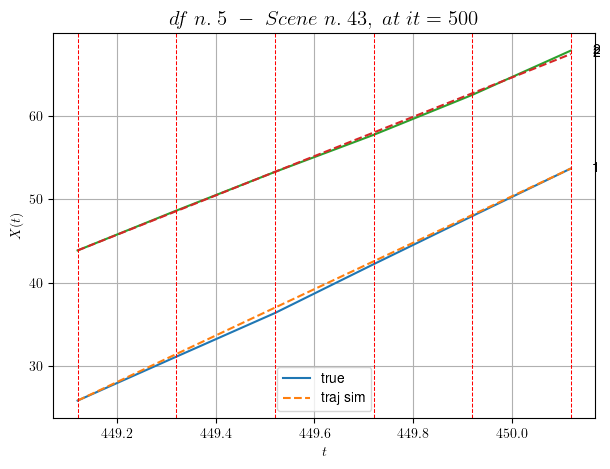

----------------------------------------------------------------------------------------------------
        For scene 42/44:
        * After LR finder: LR_NN=0.001 with mse=7.650440204976944 at it=24
        * v0 = 23.52760427572931
        * MSE = 0.07718711442850233
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.43/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [149.92,150.72]


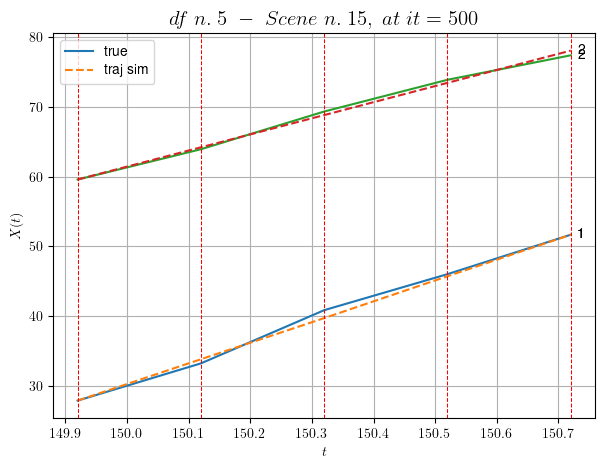

----------------------------------------------------------------------------------------------------
        For scene 43/44:
        * After LR finder: LR_NN=0.001 with mse=6.172318777785148 at it=24
        * v0 = 23.10299358436084
        * MSE = 0.26976731609875515
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.44/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [535.32,535.92]


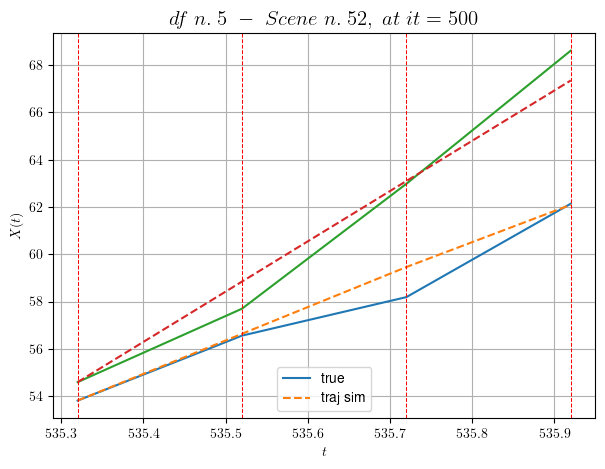

----------------------------------------------------------------------------------------------------
        For scene 44/44:
        * After LR finder: LR_NN=0.005 with mse=4.735692867649309 at it=24
        * v0 = 21.278077520483933
        * MSE = 0.542596649738577
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.4273526477543792
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (22 scenes)
DataFrame n.5. Scene n.1/22


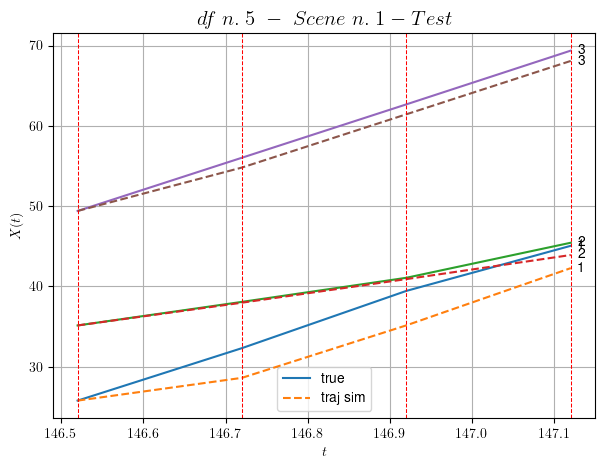

        For scene 1/22:
        * MSE = 3.9102719304566325
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/22


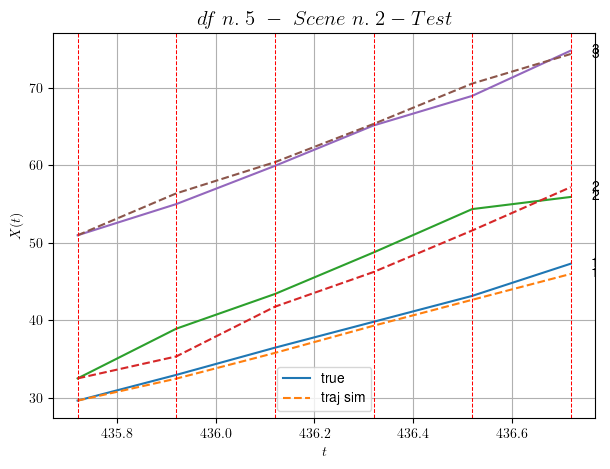

        For scene 2/22:
        * MSE = 2.166522884342245
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/22


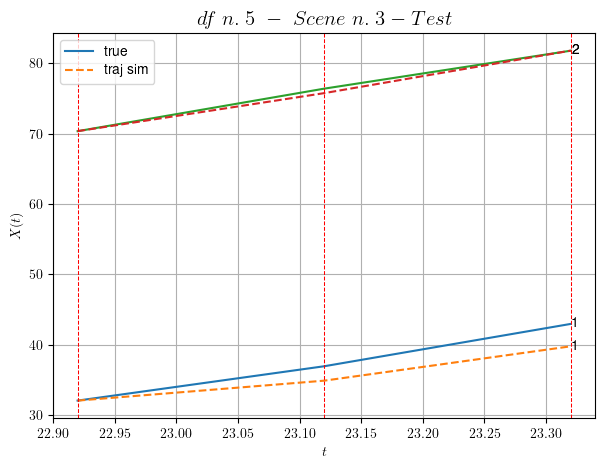

        For scene 3/22:
        * MSE = 2.4613182950103187
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/22


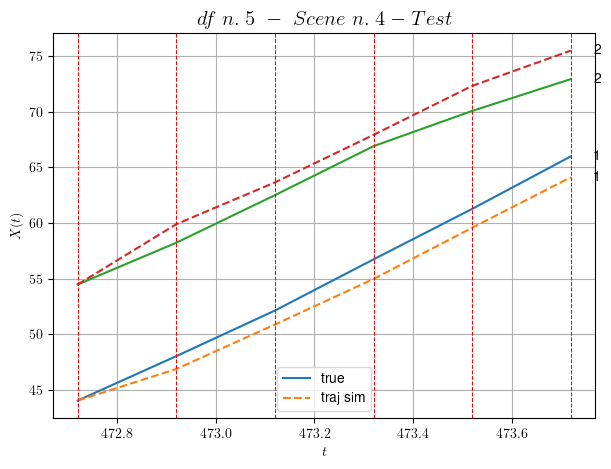

        For scene 4/22:
        * MSE = 2.421131260587427
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/22


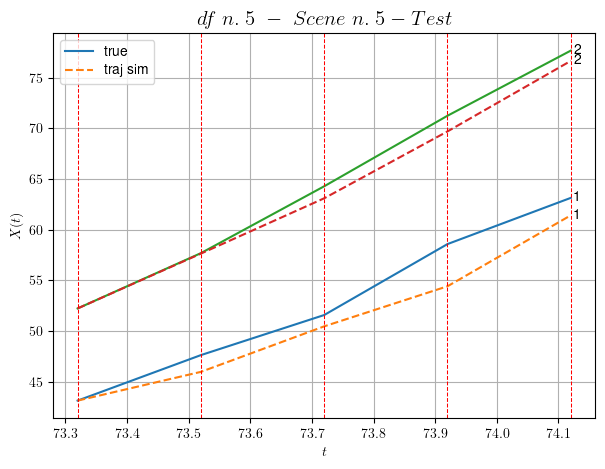

        For scene 5/22:
        * MSE = 2.9102407268179222
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/22


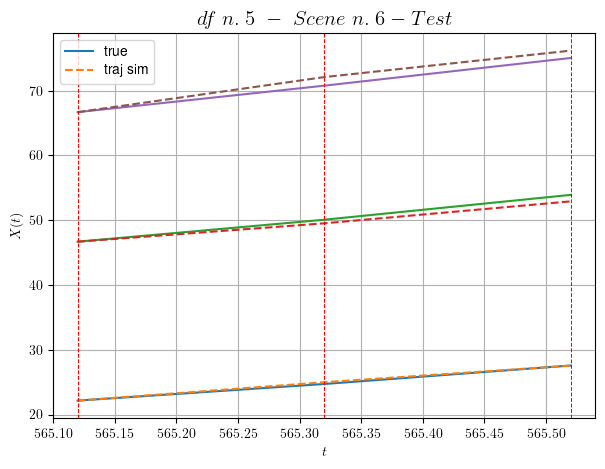

        For scene 6/22:
        * MSE = 0.49195595245574814
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/22


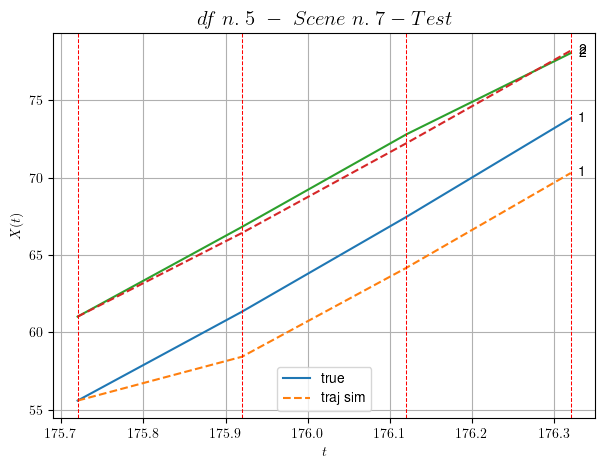

        For scene 7/22:
        * MSE = 4.047609410154909
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/22


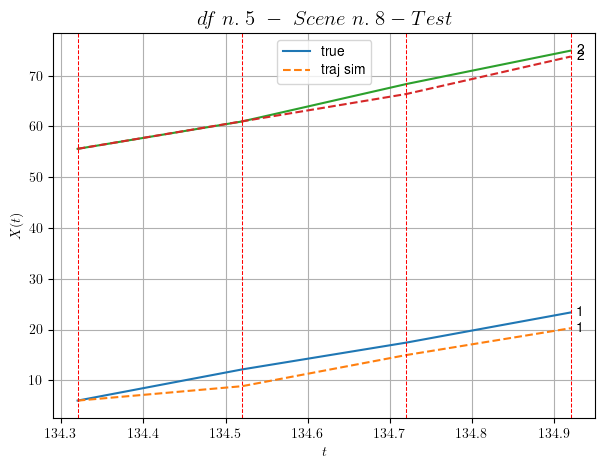

        For scene 8/22:
        * MSE = 3.964991254163156
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/22


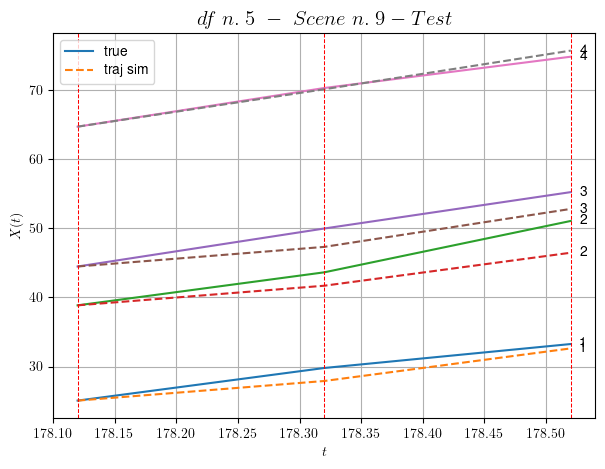

        For scene 9/22:
        * MSE = 3.5515928082033916
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/22


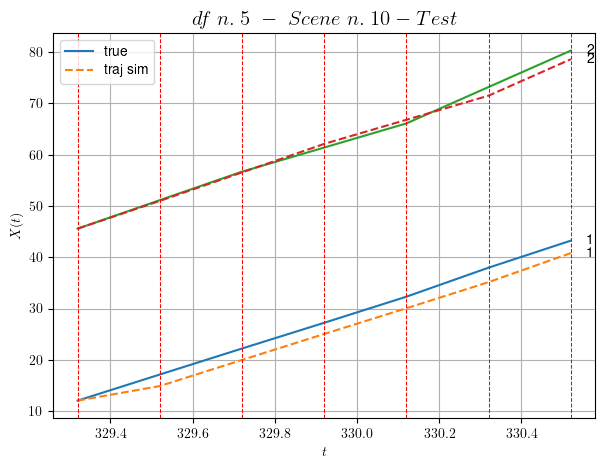

        For scene 10/22:
        * MSE = 2.8852663544056347
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/22


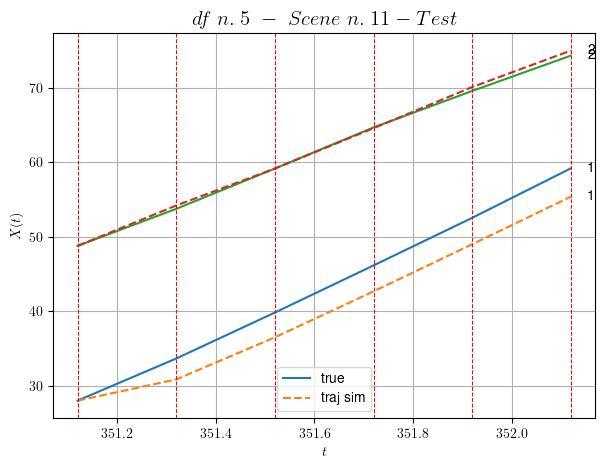

        For scene 11/22:
        * MSE = 4.911316581358812
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/22


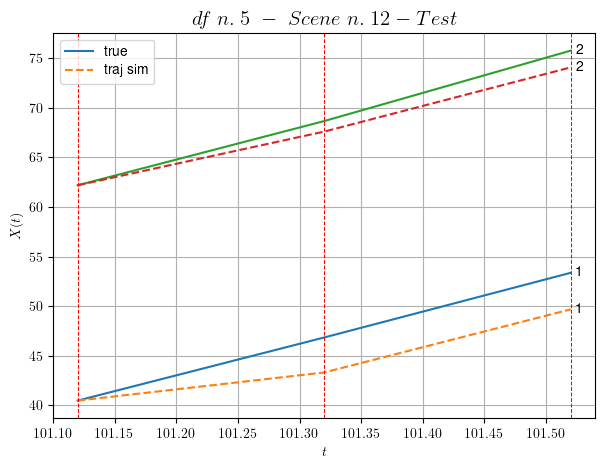

        For scene 12/22:
        * MSE = 4.9969978924335505
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/22


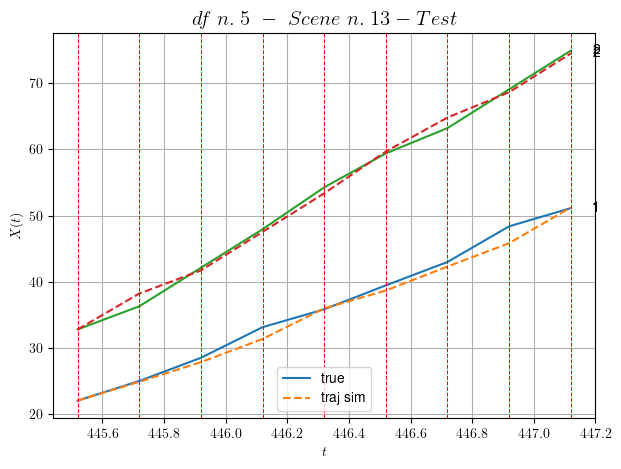

        For scene 13/22:
        * MSE = 1.0579443180815276
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/22


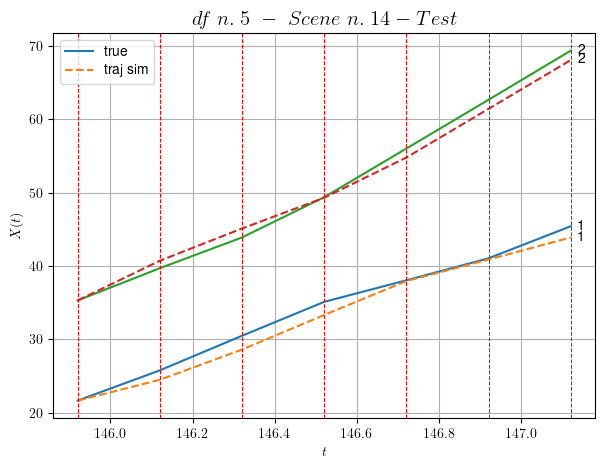

        For scene 14/22:
        * MSE = 1.2814065058216477
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/22


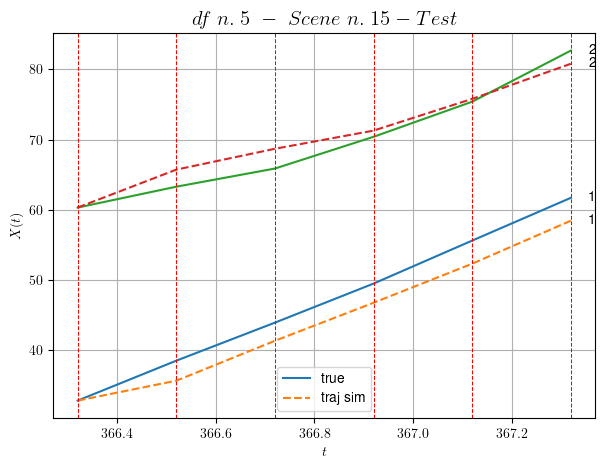

        For scene 15/22:
        * MSE = 5.1859689560399165
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/22


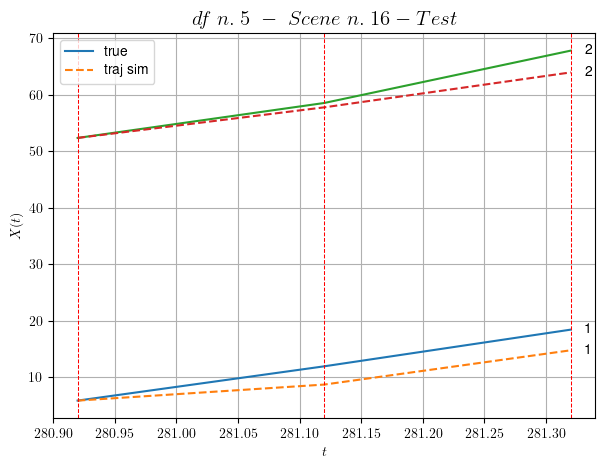

        For scene 16/22:
        * MSE = 6.535339308703344
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/22


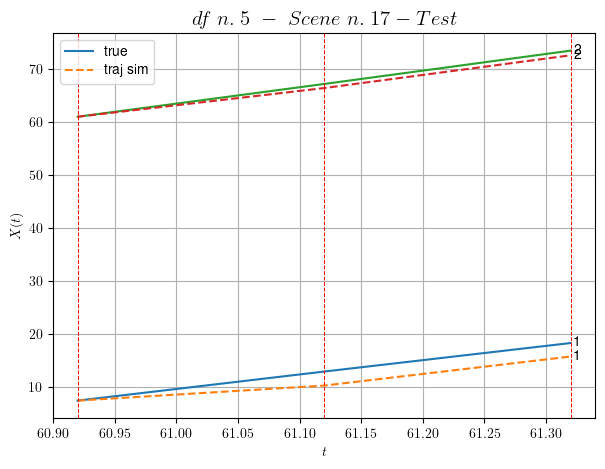

        For scene 17/22:
        * MSE = 2.475193211351358
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/22


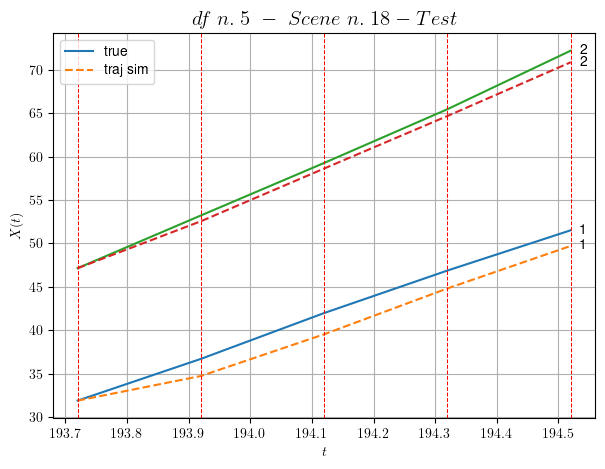

        For scene 18/22:
        * MSE = 2.065037369452705
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/22


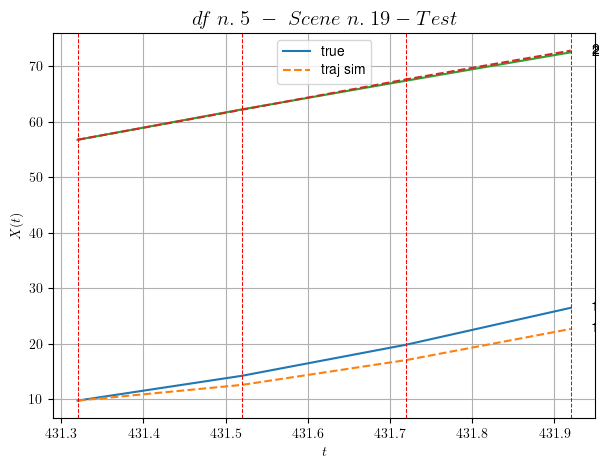

        For scene 19/22:
        * MSE = 3.127706856723103
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/22


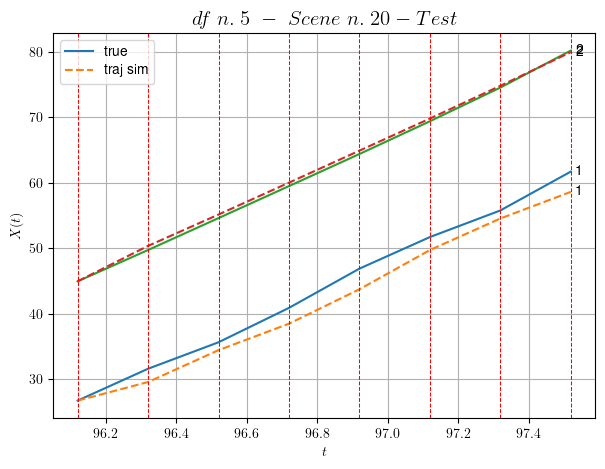

        For scene 20/22:
        * MSE = 2.3657184678403755
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/22


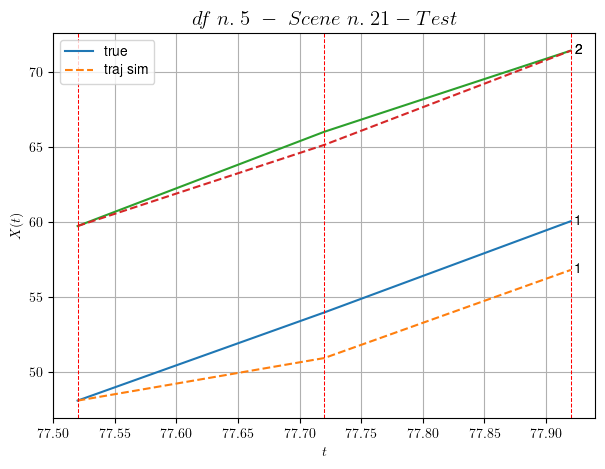

        For scene 21/22:
        * MSE = 3.430405316843521
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/22


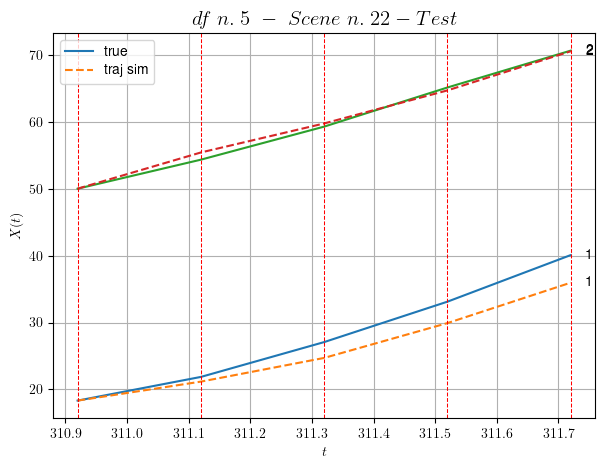

        For scene 22/22:
        * MSE = 3.493538303318374
----------------------------------------------------------------------------------------------------


MSE test: 3.169885180207528

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.4273526477543792
          * MSE test: 3.169885180207528
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 6/10 dfs.
In DataFrame n.6 we have 52 scenes.
    To train the model we use 34 scenes, the remaining 18 to test the model.

Training step. (34 scenes)
DataFrame n.6. Scene n.1/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [530.40,530.80]


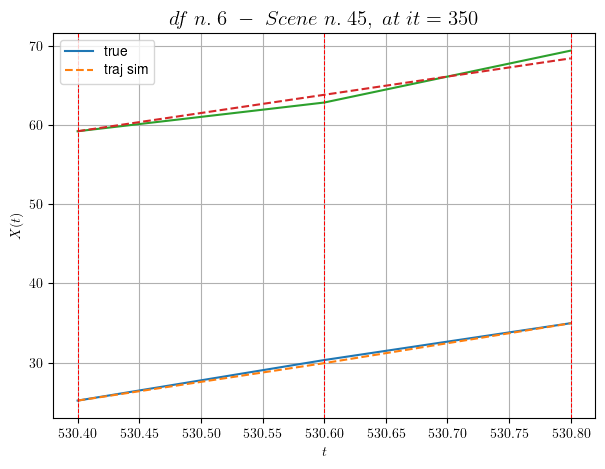

----------------------------------------------------------------------------------------------------
        For scene 1/34:
        * After LR finder: LR_NN=0.01 with mse=1.5338917011068187 at it=24
        * v0 = 22.991928149210487
        * MSE = 0.3210578974100248
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [446.80,447.80]


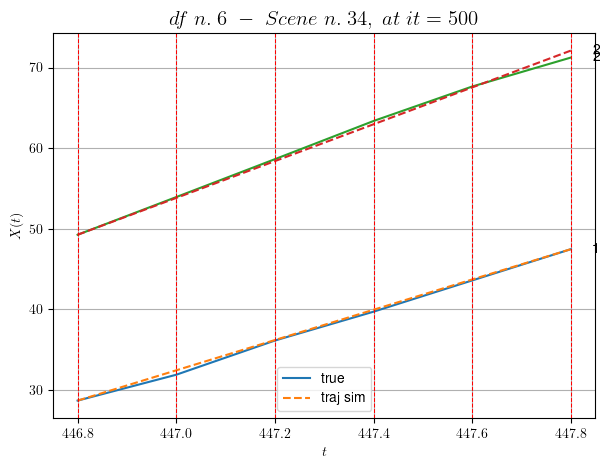

----------------------------------------------------------------------------------------------------
        For scene 2/34:
        * After LR finder: LR_NN=0.0001 with mse=9.9948800416181 at it=24
        * v0 = 22.841482925265073
        * MSE = 0.11372710615385564
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [552.20,552.80]


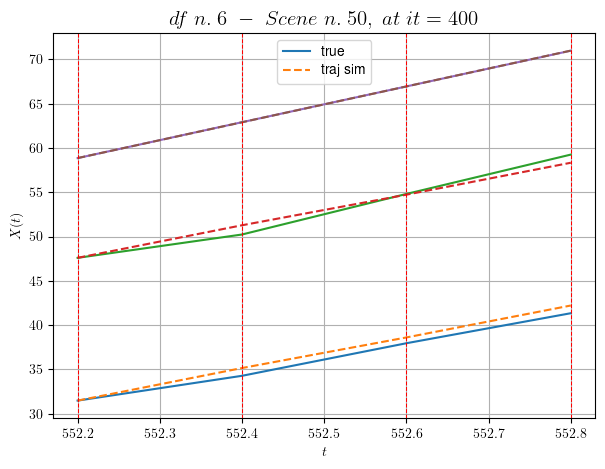

----------------------------------------------------------------------------------------------------
        For scene 3/34:
        * After LR finder: LR_NN=0.005 with mse=4.797008966782839 at it=24
        * v0 = 20.23321763701514
        * MSE = 0.32470387421483465
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [195.80,196.80]


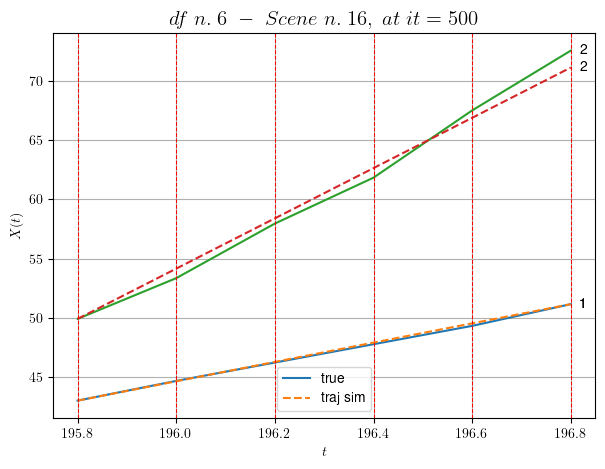

----------------------------------------------------------------------------------------------------
        For scene 4/34:
        * After LR finder: LR_NN=0.005 with mse=12.79428082911133 at it=24
        * v0 = 21.237347440799663
        * MSE = 0.2875624816923831
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [129.80,130.20]


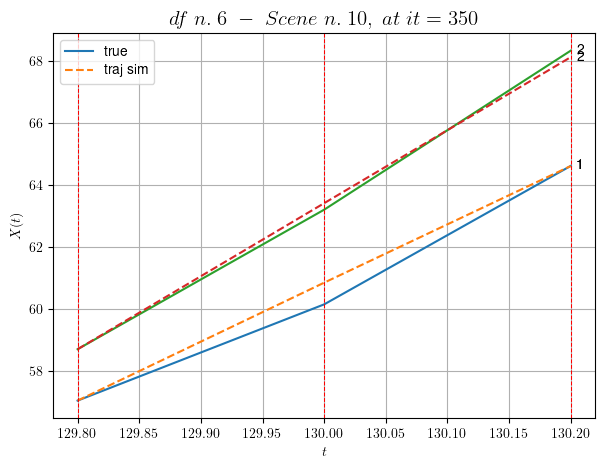

----------------------------------------------------------------------------------------------------
        For scene 5/34:
        * After LR finder: LR_NN=0.001 with mse=1.3142251175658937 at it=24
        * v0 = 23.601833038573762
        * MSE = 0.09626882159960373
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/34
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [204.40,206.20]


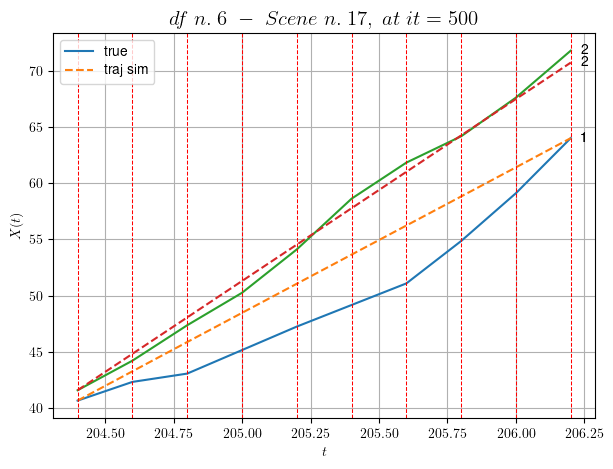

----------------------------------------------------------------------------------------------------
        For scene 6/34:
        * After LR finder: LR_NN=0.0005 with mse=106.71232699406444 at it=24
        * v0 = 16.186070594949
        * MSE = 5.310313155895892
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [396.40,397.60]


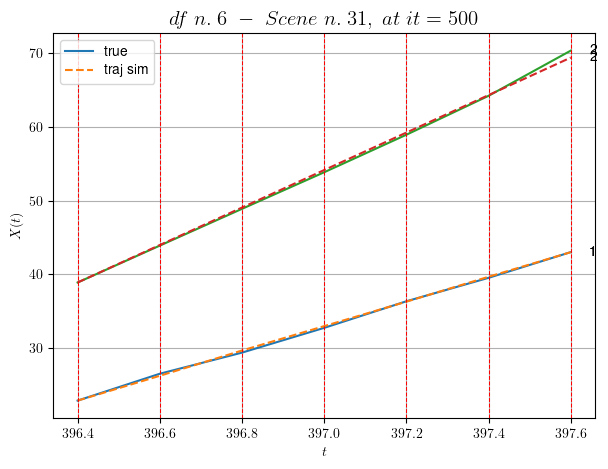

----------------------------------------------------------------------------------------------------
        For scene 7/34:
        * After LR finder: LR_NN=0.01 with mse=5.185474284018028 at it=24
        * v0 = 25.429850069096204
        * MSE = 0.09690496151143826
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [458.00,458.40]


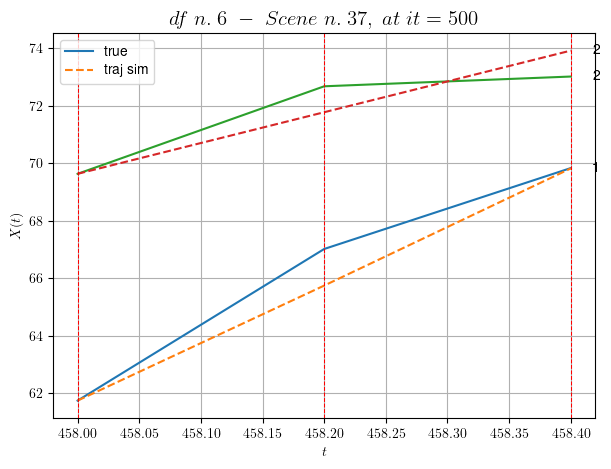

----------------------------------------------------------------------------------------------------
        For scene 8/34:
        * After LR finder: LR_NN=0.001 with mse=14.046290508483997 at it=24
        * v0 = 10.716650123126662
        * MSE = 0.5398772666532023
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [296.40,296.80]


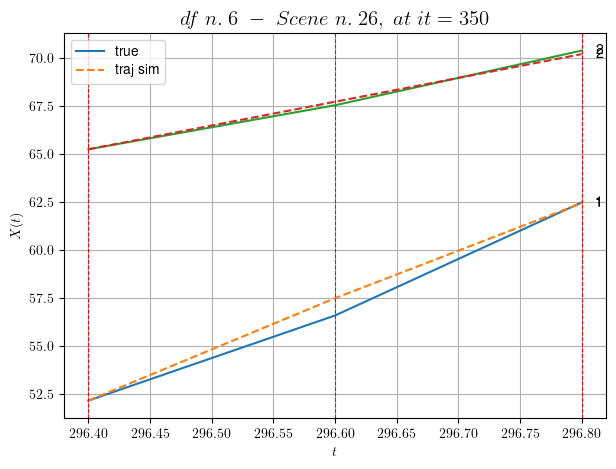

----------------------------------------------------------------------------------------------------
        For scene 9/34:
        * After LR finder: LR_NN=0.005 with mse=10.273262390978466 at it=24
        * v0 = 12.399412784282914
        * MSE = 0.1471665641649574
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [134.00,135.20]


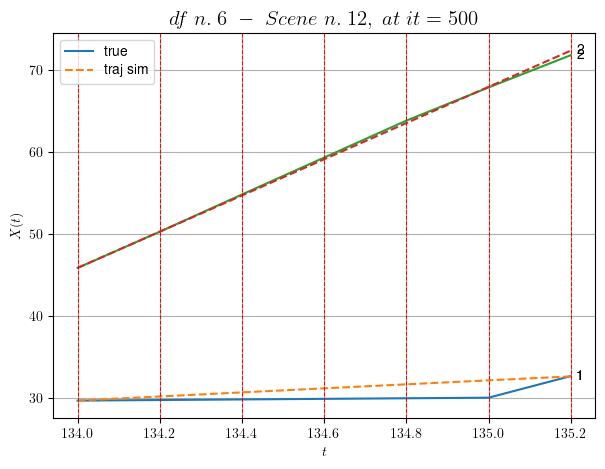

----------------------------------------------------------------------------------------------------
        For scene 10/34:
        * After LR finder: LR_NN=0.005 with mse=17.09663171031302 at it=24
        * v0 = 22.06323233551294
        * MSE = 0.7292252094491135
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [14.80,15.60]


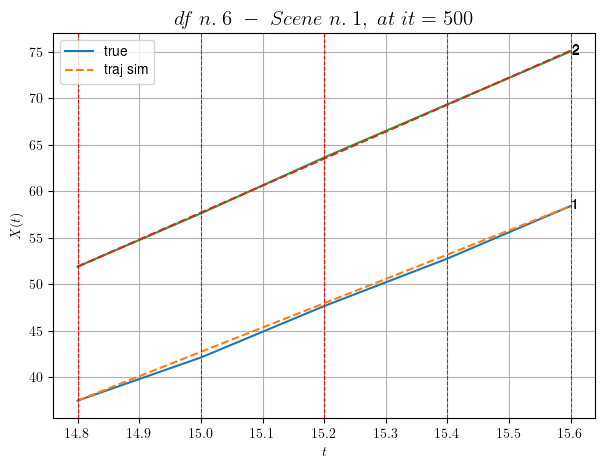

----------------------------------------------------------------------------------------------------
        For scene 11/34:
        * After LR finder: LR_NN=0.001 with mse=0.1553991106369928 at it=24
        * v0 = 29.057098132173156
        * MSE = 0.06719870680921605
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [576.00,577.60]


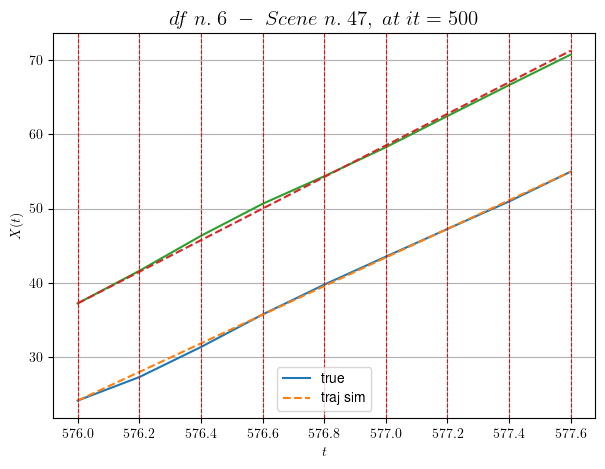

----------------------------------------------------------------------------------------------------
        For scene 12/34:
        * After LR finder: LR_NN=0.0005 with mse=35.63175514499455 at it=24
        * v0 = 21.301030620242397
        * MSE = 0.12030147565060031
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [359.20,359.60]


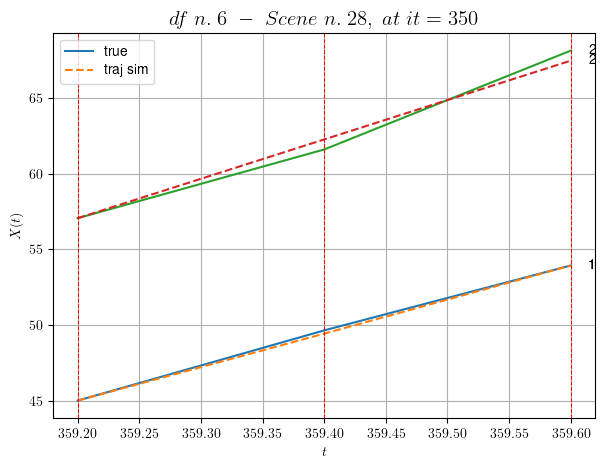

----------------------------------------------------------------------------------------------------
        For scene 13/34:
        * After LR finder: LR_NN=0.005 with mse=0.5037088735667742 at it=24
        * v0 = 26.036961880598916
        * MSE = 0.14092297857640626
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/34
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [407.80,409.20]


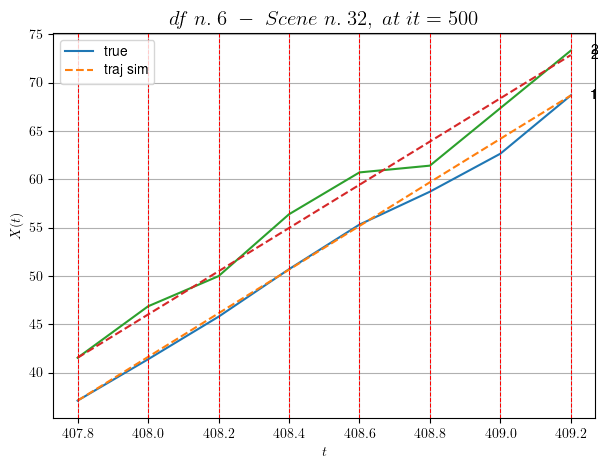

----------------------------------------------------------------------------------------------------
        For scene 14/34:
        * After LR finder: LR_NN=0.001 with mse=22.902220060755575 at it=24
        * v0 = 22.363716298521464
        * MSE = 0.9746745688628677
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [467.00,468.20]


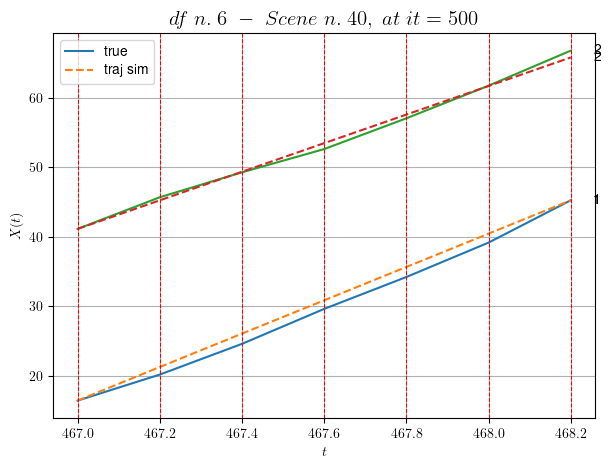

----------------------------------------------------------------------------------------------------
        For scene 15/34:
        * After LR finder: LR_NN=0.001 with mse=23.460725213906226 at it=24
        * v0 = 20.547439201769112
        * MSE = 0.768267125734027
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [374.40,376.00]


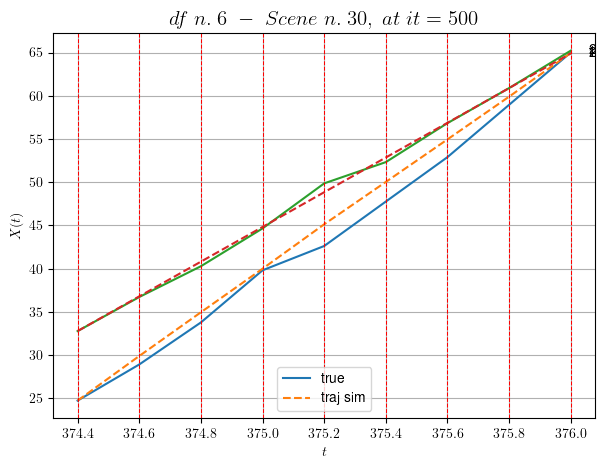

----------------------------------------------------------------------------------------------------
        For scene 16/34:
        * After LR finder: LR_NN=0.005 with mse=45.30529249870666 at it=24
        * v0 = 20.07369688597838
        * MSE = 1.1111319881366166
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [551.40,552.00]


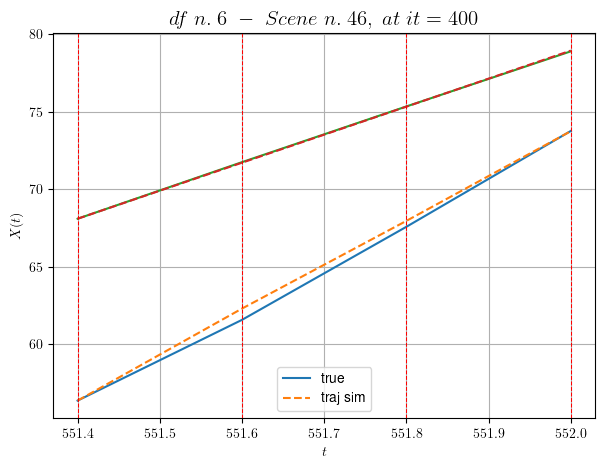

----------------------------------------------------------------------------------------------------
        For scene 17/34:
        * After LR finder: LR_NN=0.005 with mse=10.056859014472652 at it=24
        * v0 = 18.102658564771904
        * MSE = 0.08503465213343157
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/34
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [24.60,26.40]


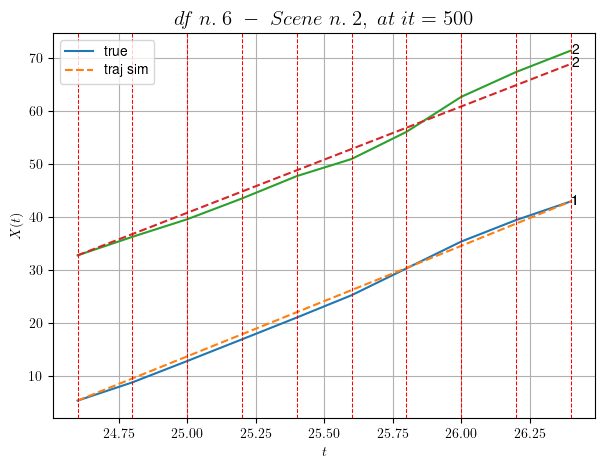

----------------------------------------------------------------------------------------------------
        For scene 18/34:
        * After LR finder: LR_NN=0.001 with mse=51.74255103431726 at it=24
        * v0 = 20.072543725791654
        * MSE = 1.3351536524632956
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.19/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [236.20,237.00]


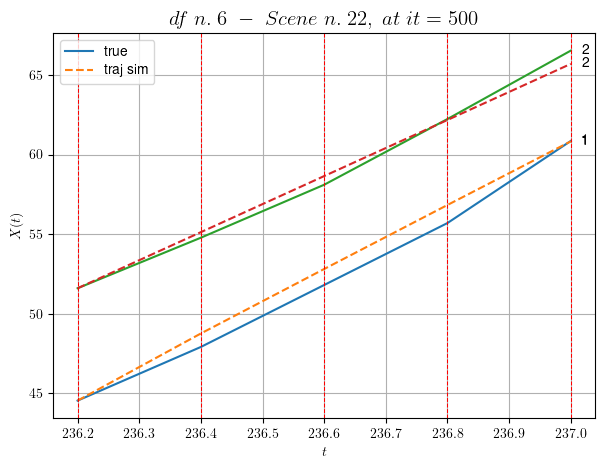

----------------------------------------------------------------------------------------------------
        For scene 19/34:
        * After LR finder: LR_NN=0.005 with mse=17.806775231324828 at it=24
        * v0 = 17.63413097458811
        * MSE = 0.4106921994463219
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.20/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [29.80,30.80]


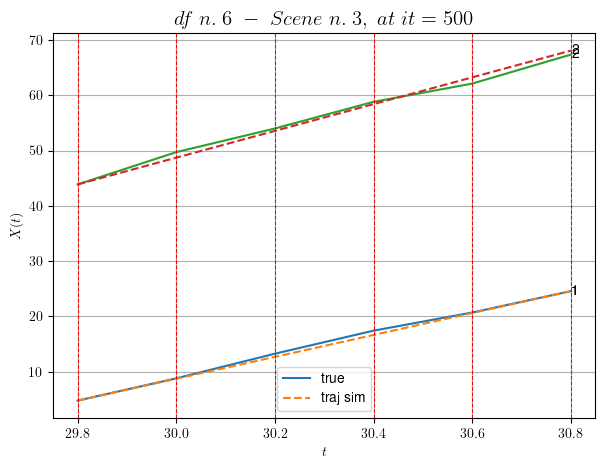

----------------------------------------------------------------------------------------------------
        For scene 20/34:
        * After LR finder: LR_NN=0.0005 with mse=7.42513707019632 at it=24
        * v0 = 24.207929046504958
        * MSE = 0.3414144323045841
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.21/34
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [477.80,479.80]


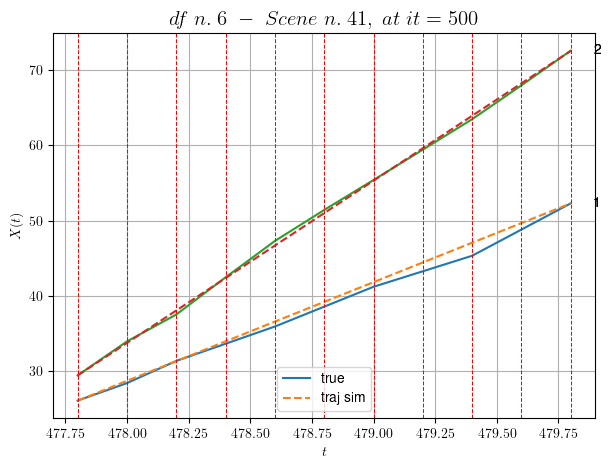

----------------------------------------------------------------------------------------------------
        For scene 21/34:
        * After LR finder: LR_NN=0.001 with mse=50.12548598837841 at it=24
        * v0 = 21.601430911083135
        * MSE = 0.35053798398746266
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.22/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [450.60,451.20]


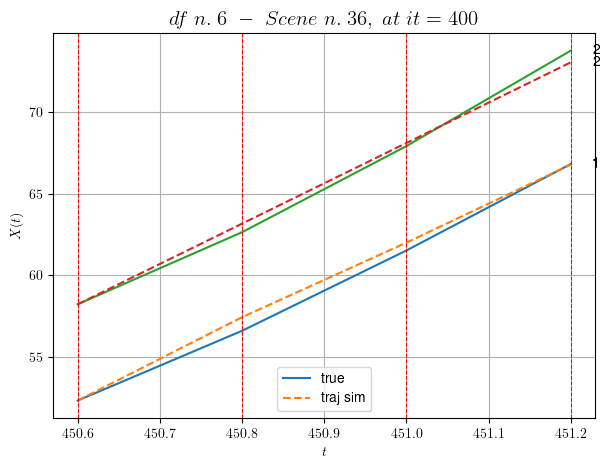

----------------------------------------------------------------------------------------------------
        For scene 22/34:
        * After LR finder: LR_NN=0.01 with mse=1.8813029157731795 at it=24
        * v0 = 24.707838133797196
        * MSE = 0.21943888257484134
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.23/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [263.80,264.20]


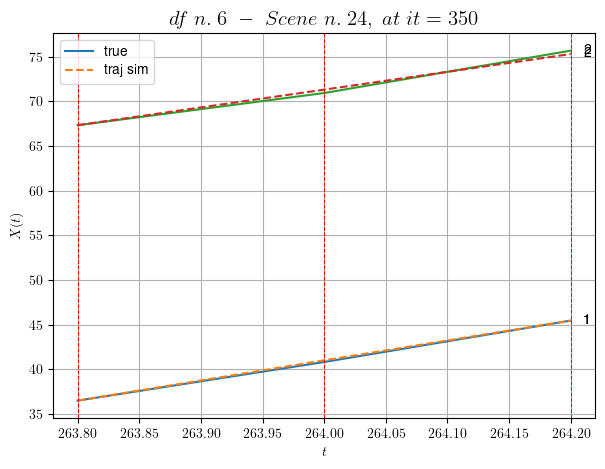

----------------------------------------------------------------------------------------------------
        For scene 23/34:
        * After LR finder: LR_NN=0.005 with mse=3.1737735343470117 at it=24
        * v0 = 19.938624229339485
        * MSE = 0.05035894587031785
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.24/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [593.40,594.60]


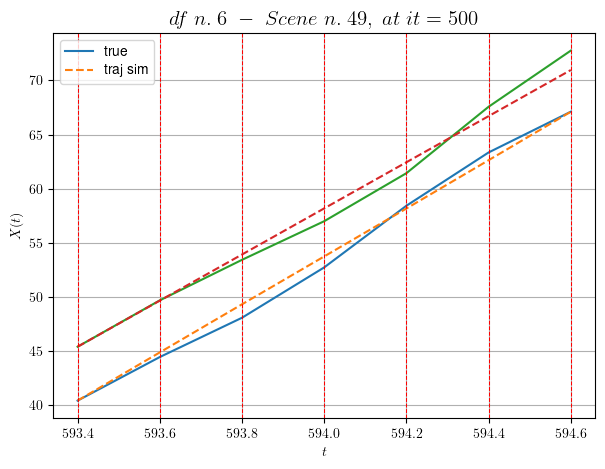

----------------------------------------------------------------------------------------------------
        For scene 24/34:
        * After LR finder: LR_NN=0.001 with mse=19.3371824369964 at it=24
        * v0 = 21.2808099083157
        * MSE = 0.6804203650338467
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.25/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [131.80,133.40]


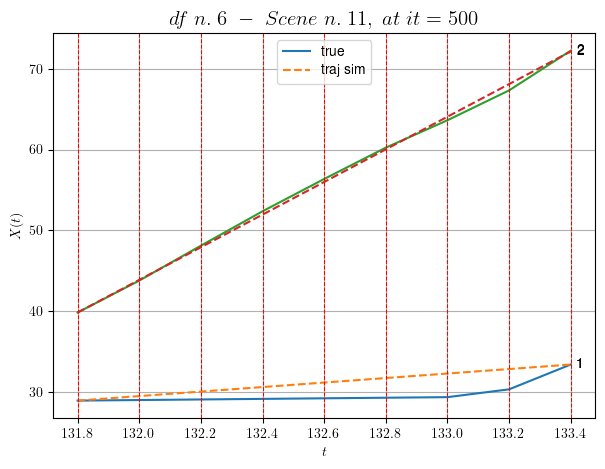

----------------------------------------------------------------------------------------------------
        For scene 25/34:
        * After LR finder: LR_NN=0.0005 with mse=44.63361459799426 at it=24
        * v0 = 20.22300032377142
        * MSE = 1.6229610629598226
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.26/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [252.60,253.20]


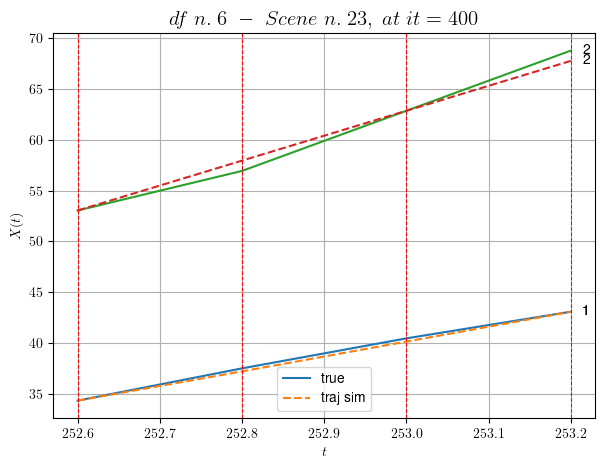

----------------------------------------------------------------------------------------------------
        For scene 26/34:
        * After LR finder: LR_NN=0.005 with mse=1.8336813918648973 at it=24
        * v0 = 24.514205455128135
        * MSE = 0.24595437308227464
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.27/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [228.80,229.40]


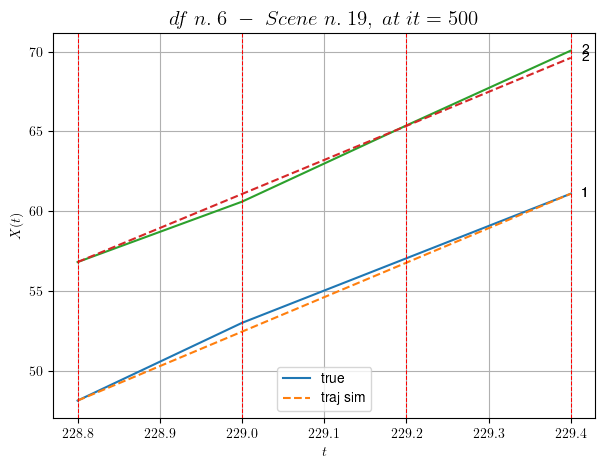

----------------------------------------------------------------------------------------------------
        For scene 27/34:
        * After LR finder: LR_NN=0.0001 with mse=4.954988718381071 at it=24
        * v0 = 21.31990483401023
        * MSE = 0.1022565574652711
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.28/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.00,554.40]


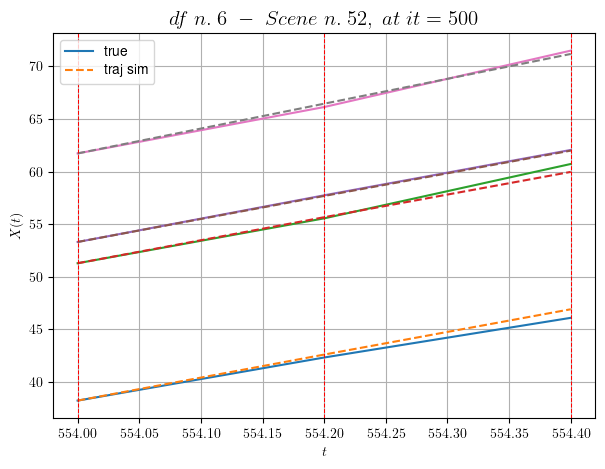

----------------------------------------------------------------------------------------------------
        For scene 28/34:
        * After LR finder: LR_NN=0.01 with mse=0.7216662398758429 at it=24
        * v0 = 23.64705062033226
        * MSE = 0.126517396798634
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.29/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [234.00,234.60]


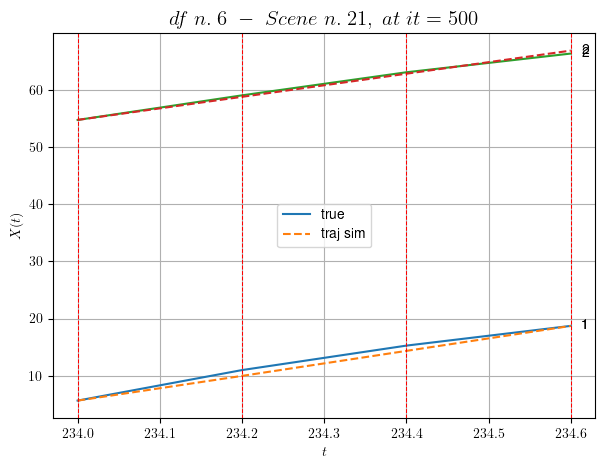

----------------------------------------------------------------------------------------------------
        For scene 29/34:
        * After LR finder: LR_NN=0.001 with mse=14.312510699404076 at it=24
        * v0 = 20.20136685727394
        * MSE = 0.2841727845850863
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.30/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.60,87.40]


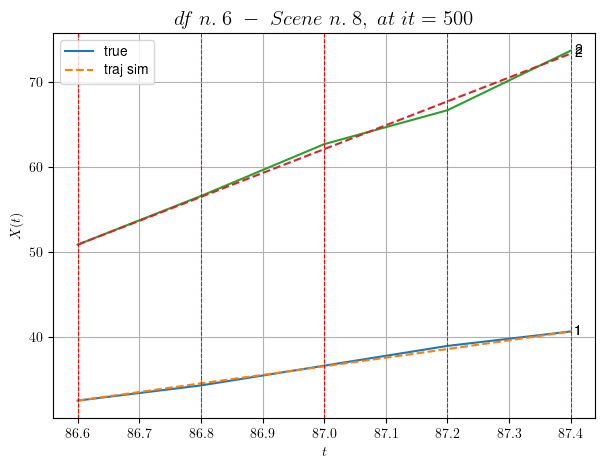

----------------------------------------------------------------------------------------------------
        For scene 30/34:
        * After LR finder: LR_NN=0.005 with mse=0.6125786758964429 at it=24
        * v0 = 28.176915163685493
        * MSE = 0.17741441982528242
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.31/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [493.80,494.40]


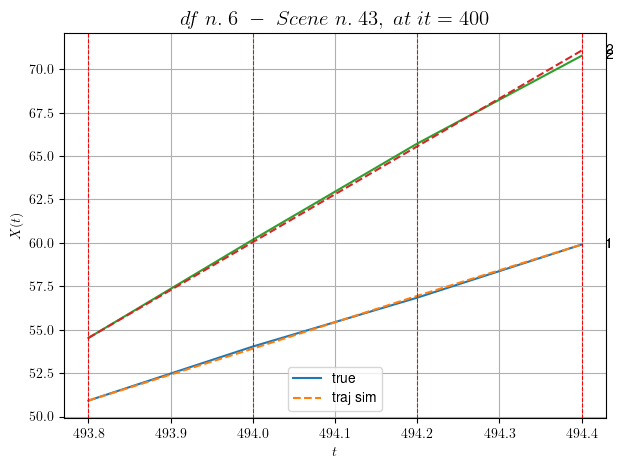

----------------------------------------------------------------------------------------------------
        For scene 31/34:
        * After LR finder: LR_NN=0.01 with mse=0.4847973025936173 at it=24
        * v0 = 27.577027547634234
        * MSE = 0.019996782349663726
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.32/34
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [162.20,163.60]


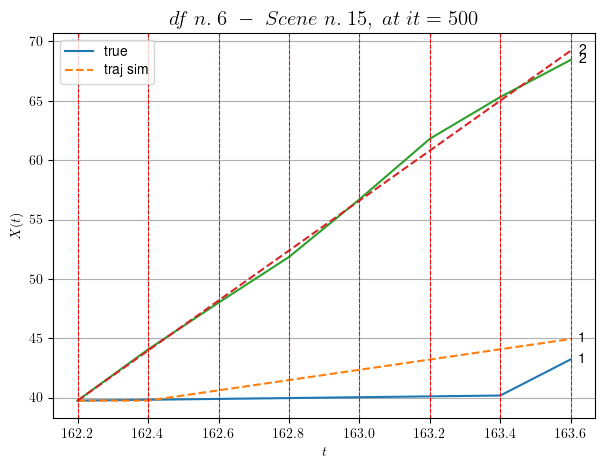

----------------------------------------------------------------------------------------------------
        For scene 32/34:
        * After LR finder: LR_NN=5e-05 with mse=28.43141974984154 at it=24
        * v0 = 21.059787487615633
        * MSE = 2.3729813150983907
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.33/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [368.20,369.20]


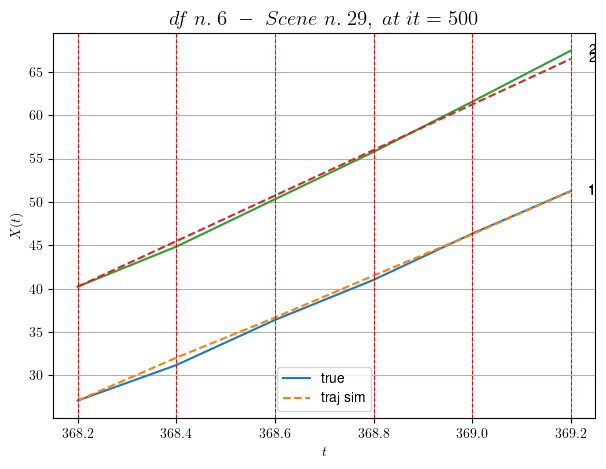

----------------------------------------------------------------------------------------------------
        For scene 33/34:
        * After LR finder: LR_NN=0.01 with mse=2.285891880953166 at it=24
        * v0 = 26.269654614172474
        * MSE = 0.19859136310000525
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.34/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [465.20,466.40]


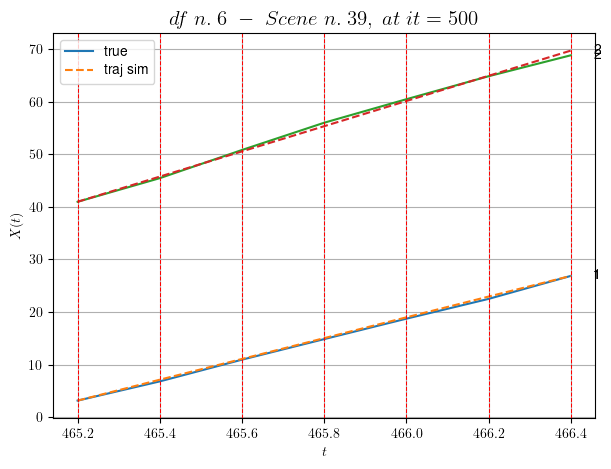

----------------------------------------------------------------------------------------------------
        For scene 34/34:
        * After LR finder: LR_NN=0.005 with mse=10.019647463828402 at it=24
        * v0 = 23.956962458800877
        * MSE = 0.1375990435754561
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.5856117763285008
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (18 scenes)
DataFrame n.6. Scene n.1/18


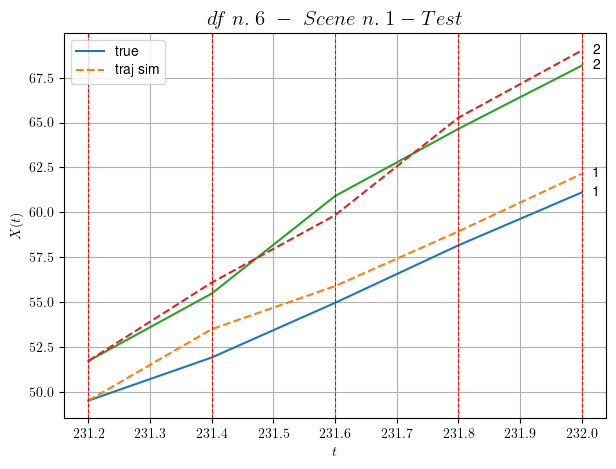

        For scene 1/18:
        * MSE = 0.7645672016262158
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/18


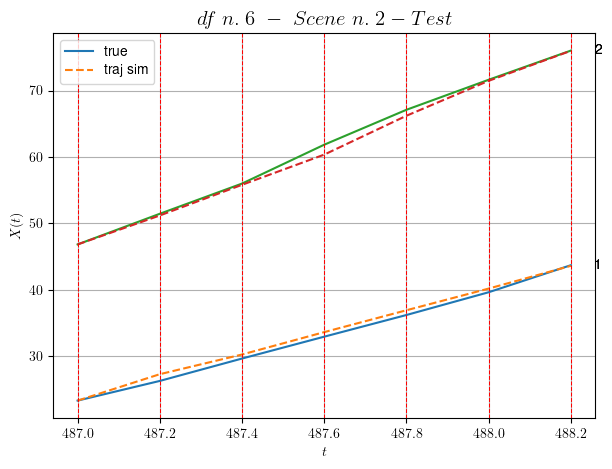

        For scene 2/18:
        * MSE = 0.4182482631703712
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/18


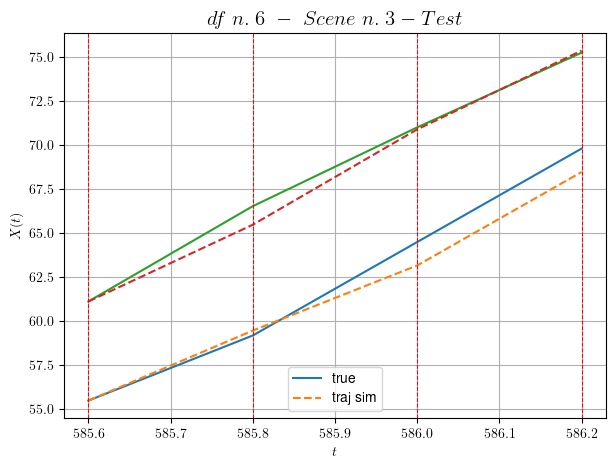

        For scene 3/18:
        * MSE = 0.5945012718549527
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/18


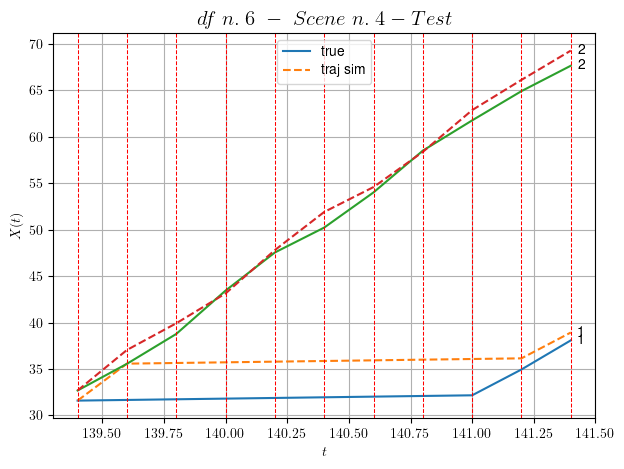

        For scene 4/18:
        * MSE = 6.2075618145382245
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/18


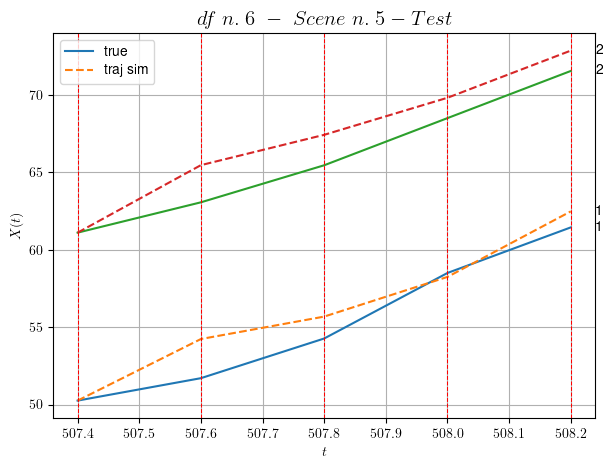

        For scene 5/18:
        * MSE = 2.2639072653539944
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/18


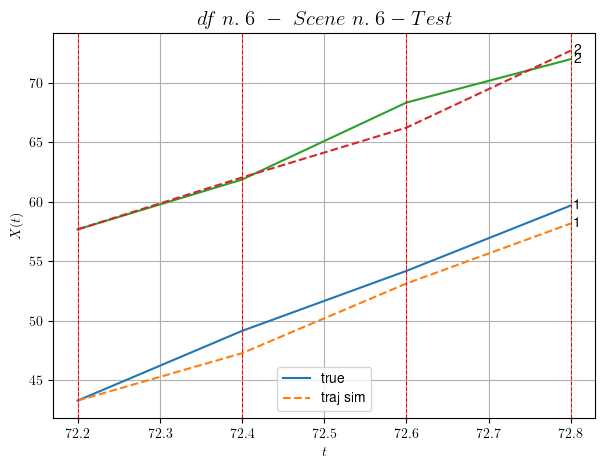

        For scene 6/18:
        * MSE = 1.4834705079122514
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/18


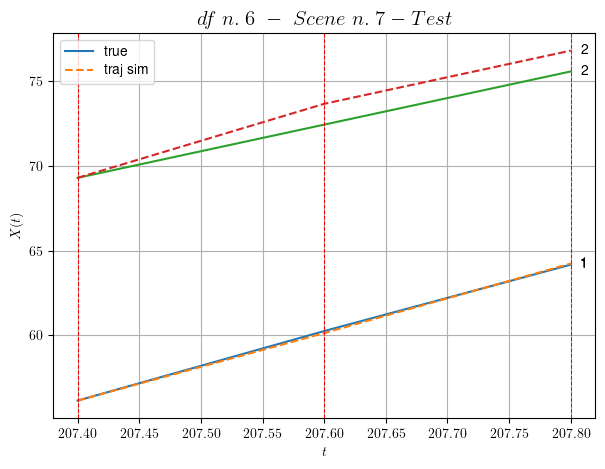

        For scene 7/18:
        * MSE = 0.5047785329502136
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/18


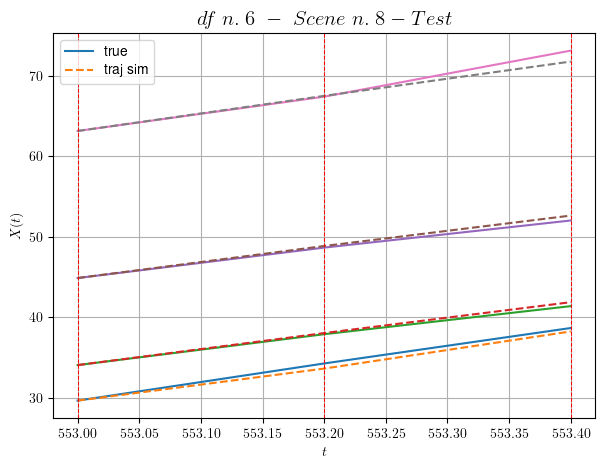

        For scene 8/18:
        * MSE = 0.25932740516041464
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/18


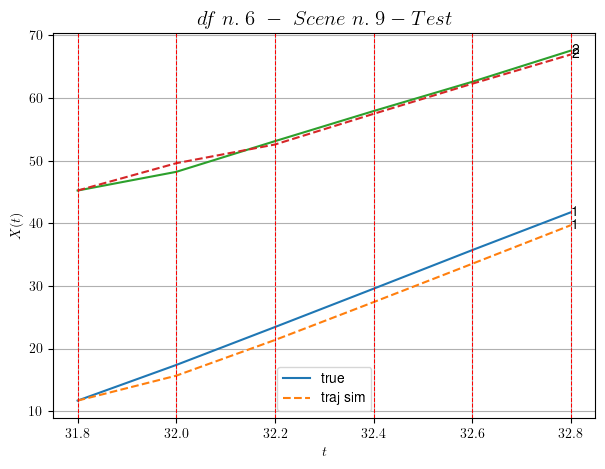

        For scene 9/18:
        * MSE = 1.9708440701116283
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/18


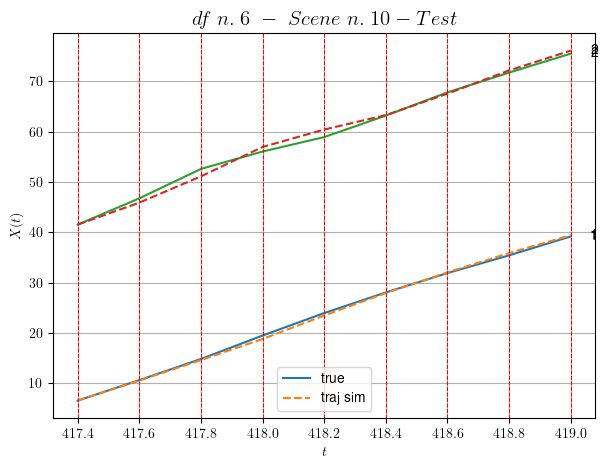

        For scene 10/18:
        * MSE = 0.42405631296073976
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/18


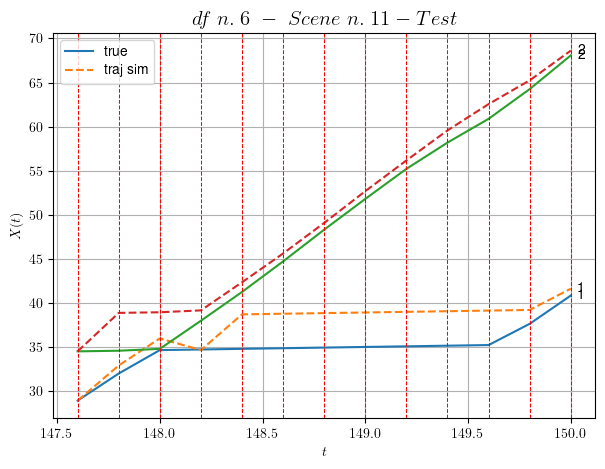

        For scene 11/18:
        * MSE = 6.147780969946471
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/18


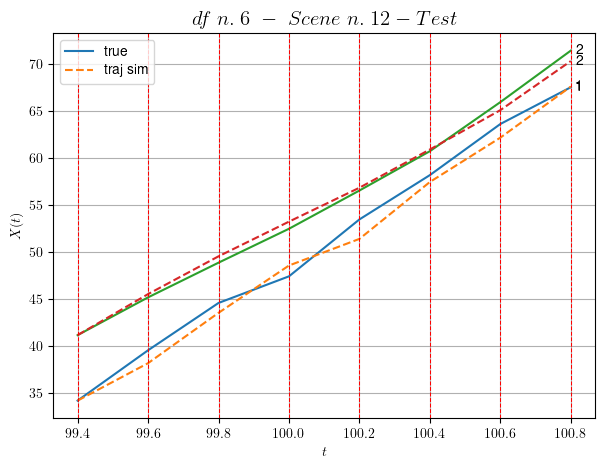

        For scene 12/18:
        * MSE = 0.9045160891682289
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/18


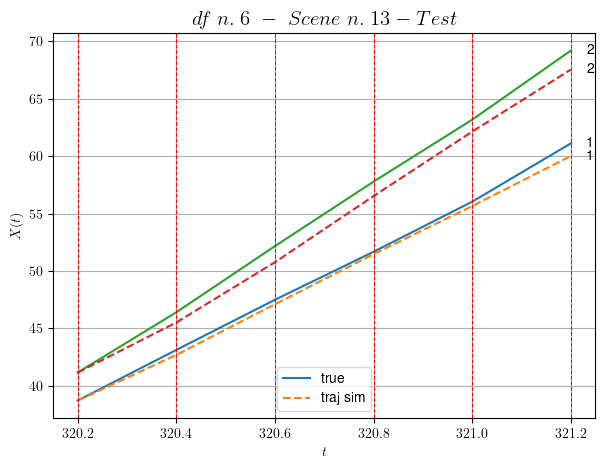

        For scene 13/18:
        * MSE = 0.8259496947025637
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/18


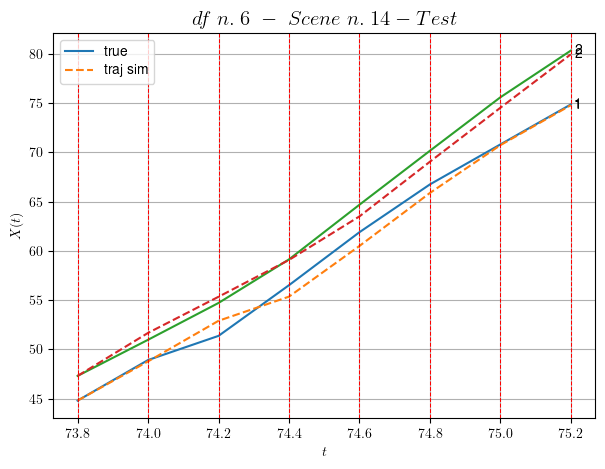

        For scene 14/18:
        * MSE = 0.7006973826741676
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/18


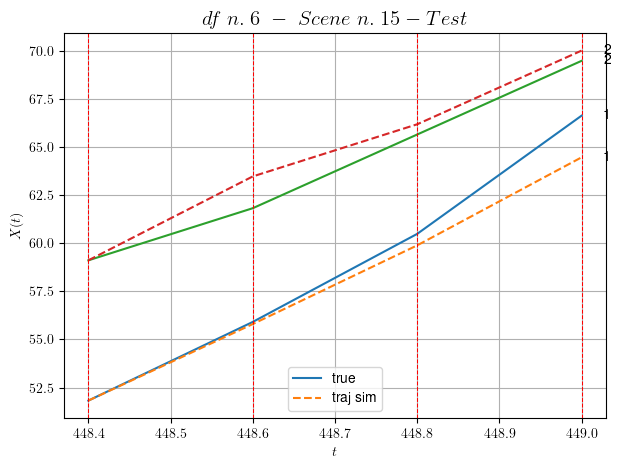

        For scene 15/18:
        * MSE = 1.0446860931698936
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/18


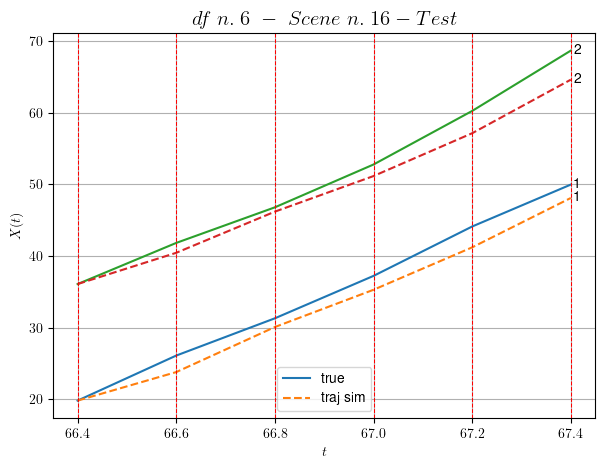

        For scene 16/18:
        * MSE = 4.454476726519471
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/18


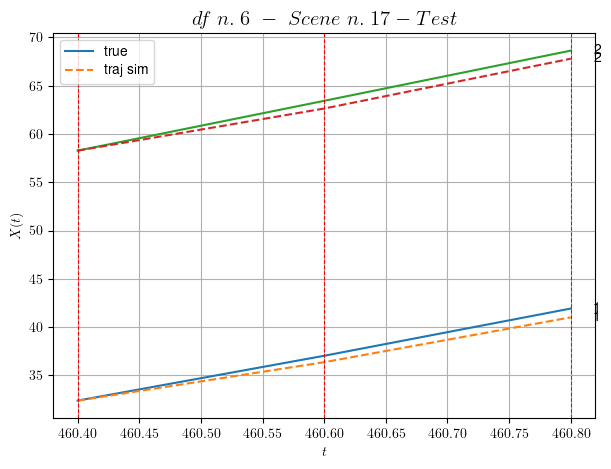

        For scene 17/18:
        * MSE = 0.43558032189712403
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/18


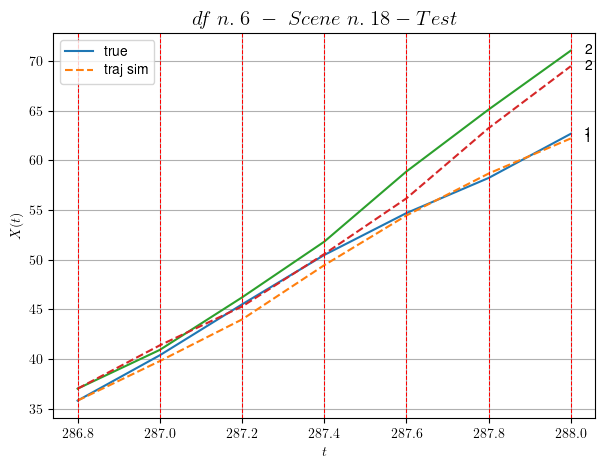

        For scene 18/18:
        * MSE = 1.4330325851062364
----------------------------------------------------------------------------------------------------


MSE test: 1.7132212504901756

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.5856117763285008
          * MSE test: 1.7132212504901756
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 7/10 dfs.
In DataFrame n.7 we have 30 scenes.
    To train the model we use 20 scenes, the remaining 10 to test the model.

Training step. (20 scenes)
DataFrame n.7. Scene n.1/20
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [60.56,61.56]


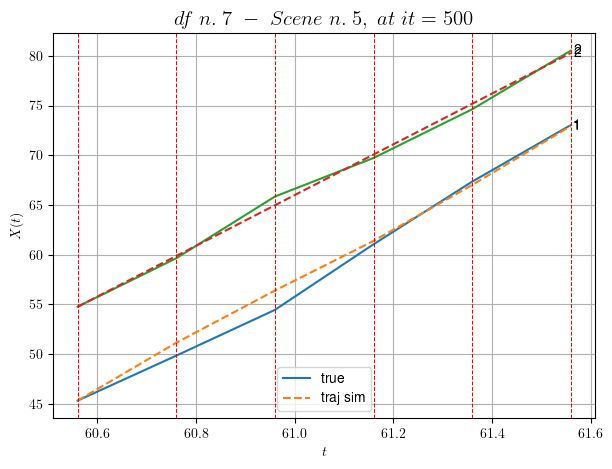

----------------------------------------------------------------------------------------------------
        For scene 1/20:
        * After LR finder: LR_NN=0.01 with mse=4.16837989635137 at it=24
        * v0 = 25.52722016644296
        * MSE = 0.44402003647099814
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [177.76,178.56]


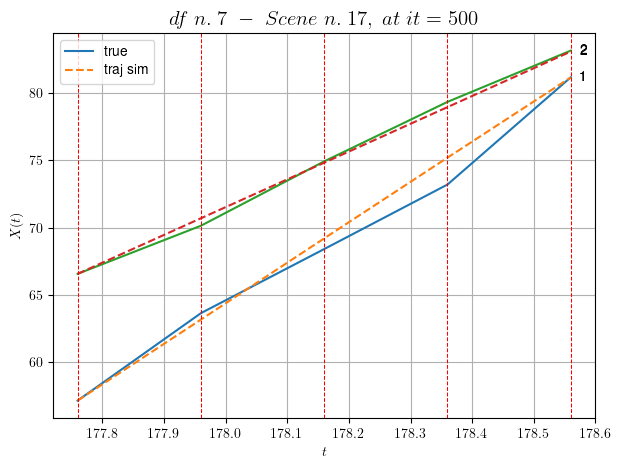

----------------------------------------------------------------------------------------------------
        For scene 2/20:
        * After LR finder: LR_NN=0.0005 with mse=108.05052041593774 at it=24
        * v0 = 20.683526203706336
        * MSE = 0.5303164891767738
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [76.36,77.16]


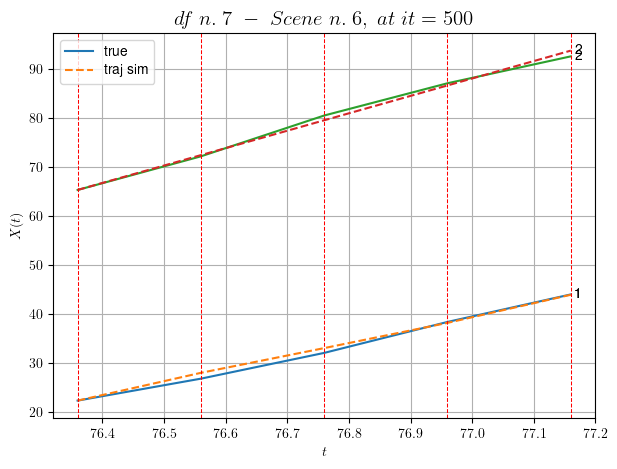

----------------------------------------------------------------------------------------------------
        For scene 3/20:
        * After LR finder: LR_NN=0.01 with mse=3.763536797686304 at it=24
        * v0 = 35.536767821833685
        * MSE = 0.44114397983629305
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [154.96,155.56]


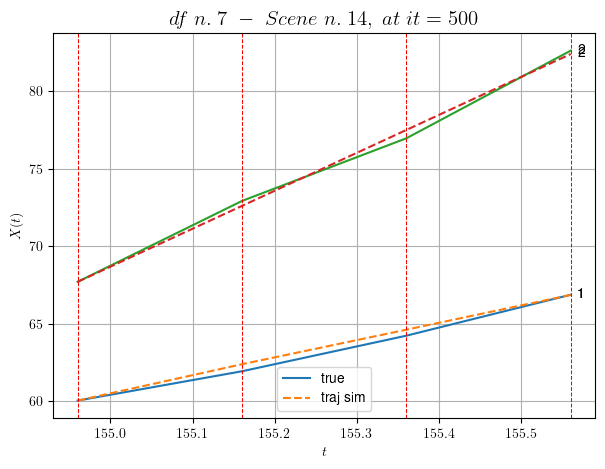

----------------------------------------------------------------------------------------------------
        For scene 4/20:
        * After LR finder: LR_NN=0.01 with mse=2.230467845161076 at it=24
        * v0 = 24.52487868148255
        * MSE = 0.09826689154505269
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [116.96,117.56]


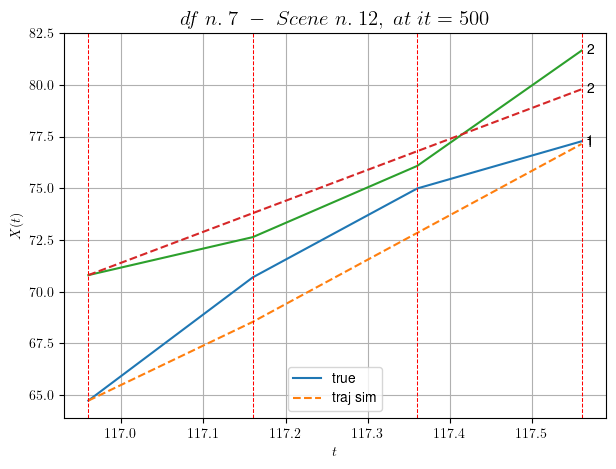

----------------------------------------------------------------------------------------------------
        For scene 5/20:
        * After LR finder: LR_NN=0.005 with mse=14.73959839388148 at it=24
        * v0 = 14.981640724782364
        * MSE = 1.8142017066685217
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [38.56,38.96]


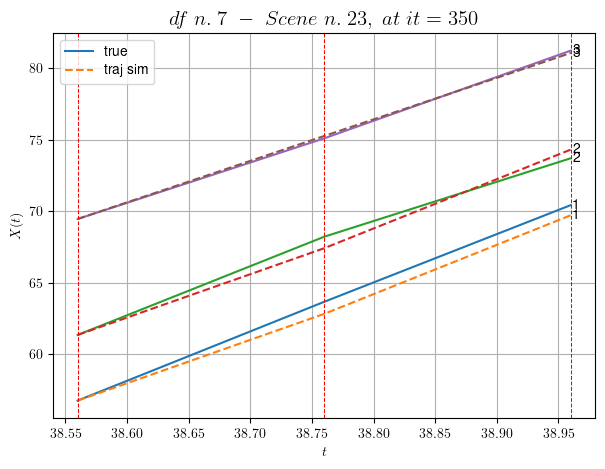

----------------------------------------------------------------------------------------------------
        For scene 6/20:
        * After LR finder: LR_NN=0.01 with mse=0.39557102929565086 at it=24
        * v0 = 28.99001788809902
        * MSE = 0.25235447618795426
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [43.16,43.76]


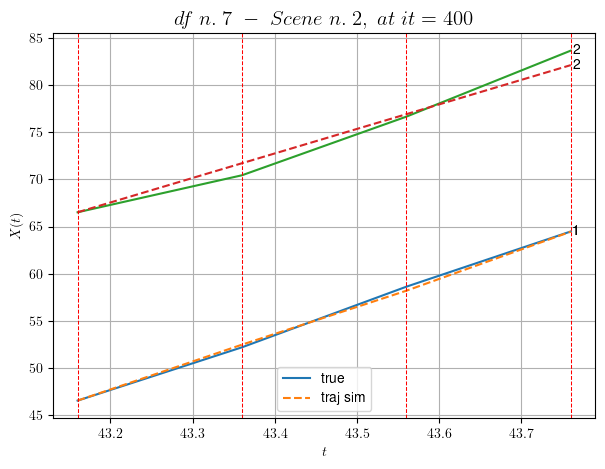

----------------------------------------------------------------------------------------------------
        For scene 7/20:
        * After LR finder: LR_NN=0.01 with mse=1.1526821597782027 at it=24
        * v0 = 25.959463575253103
        * MSE = 0.506637898670288
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [44.96,46.36]


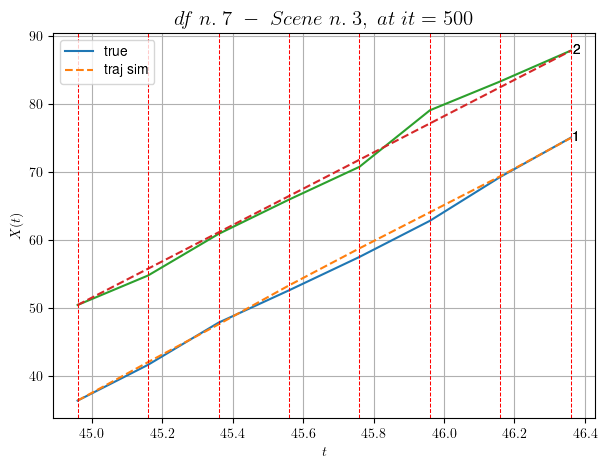

----------------------------------------------------------------------------------------------------
        For scene 8/20:
        * After LR finder: LR_NN=0.01 with mse=3.8704505809989453 at it=24
        * v0 = 26.657757035933756
        * MSE = 0.571601403709876
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [162.76,163.16]


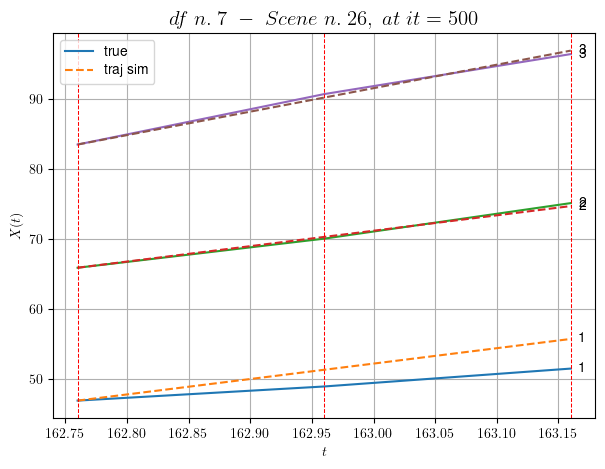

----------------------------------------------------------------------------------------------------
        For scene 9/20:
        * After LR finder: LR_NN=1e-05 with mse=13.010527547968529 at it=24
        * v0 = 33.51455461644842
        * MSE = 2.702223681949953
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/20
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [51.36,52.36]


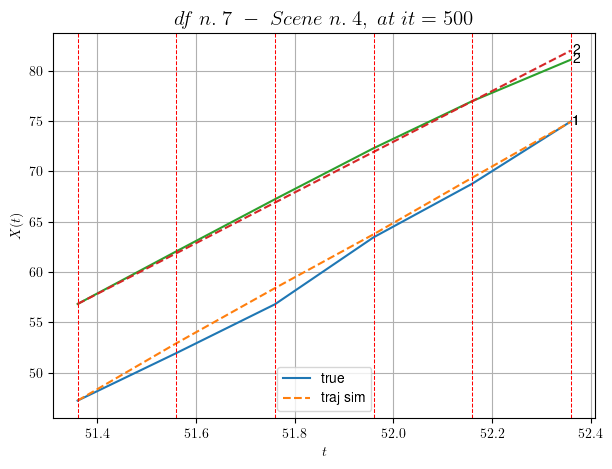

----------------------------------------------------------------------------------------------------
        For scene 10/20:
        * After LR finder: LR_NN=0.005 with mse=5.141030281510064 at it=24
        * v0 = 25.158740607132792
        * MSE = 0.41575609088781984
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.11/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [226.76,228.16]


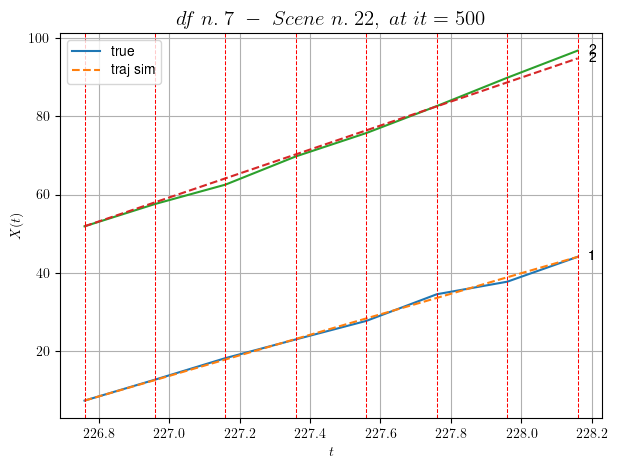

----------------------------------------------------------------------------------------------------
        For scene 11/20:
        * After LR finder: LR_NN=0.001 with mse=1.145402745960711 at it=24
        * v0 = 30.69836132453358
        * MSE = 0.7261458344810492
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.12/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [165.76,166.36]


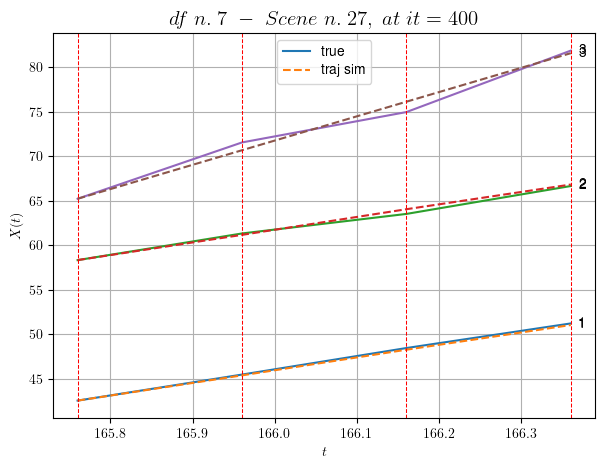

----------------------------------------------------------------------------------------------------
        For scene 12/20:
        * After LR finder: LR_NN=0.01 with mse=0.6225573356445029 at it=24
        * v0 = 27.262213356187985
        * MSE = 0.21725078514017718
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.13/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [190.56,190.96]


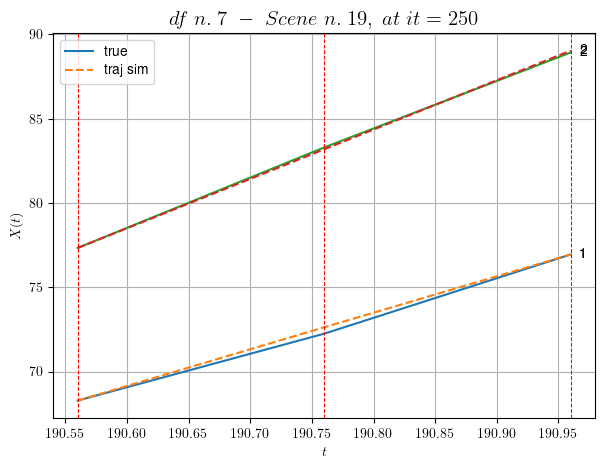

----------------------------------------------------------------------------------------------------
        For scene 13/20:
        * After LR finder: LR_NN=0.001 with mse=0.03695491394258593 at it=24
        * v0 = 29.283628125142897
        * MSE = 0.027556567612164188
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.14/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [166.56,167.36]


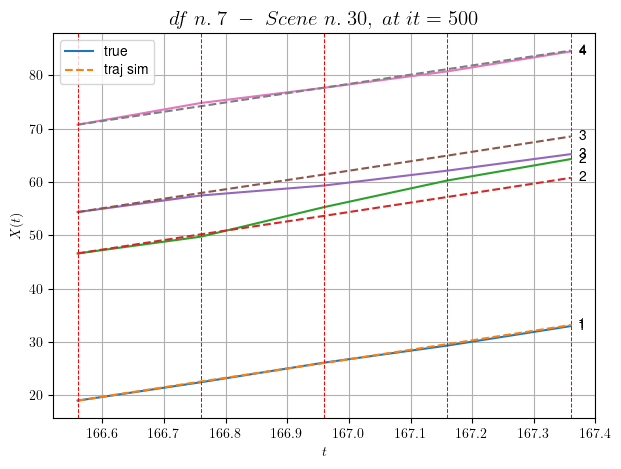

----------------------------------------------------------------------------------------------------
        For scene 14/20:
        * After LR finder: LR_NN=0.01 with mse=12.361901178375962 at it=24
        * v0 = 17.368635969066254
        * MSE = 2.444674016541138
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.15/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [219.96,221.36]


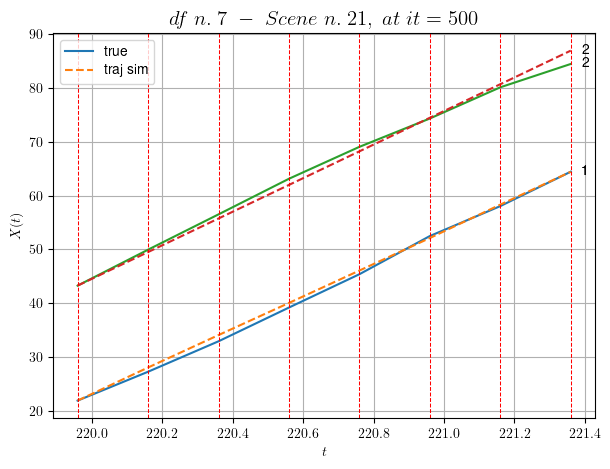

----------------------------------------------------------------------------------------------------
        For scene 15/20:
        * After LR finder: LR_NN=0.005 with mse=0.8738484801750193 at it=24
        * v0 = 31.227007582862058
        * MSE = 0.6654689358127778
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.16/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [86.96,87.56]


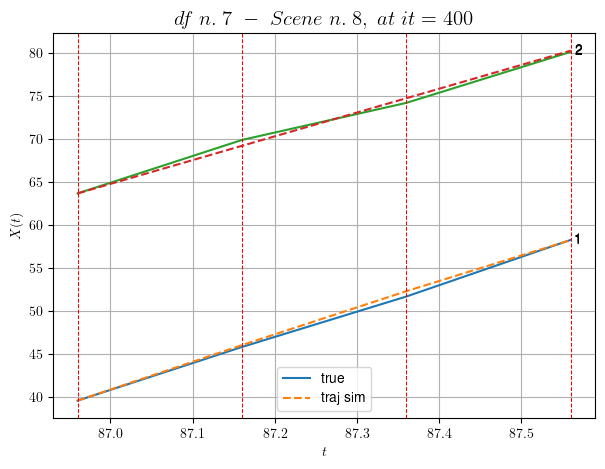

----------------------------------------------------------------------------------------------------
        For scene 16/20:
        * After LR finder: LR_NN=0.01 with mse=0.6823914260301049 at it=24
        * v0 = 27.633294790057537
        * MSE = 0.14836580831207696
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.17/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [110.96,112.36]


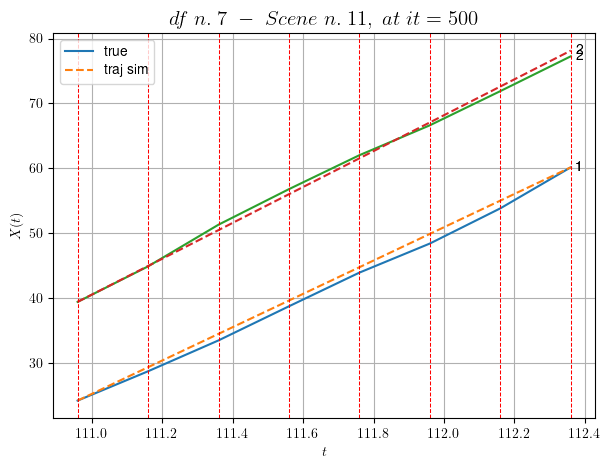

----------------------------------------------------------------------------------------------------
        For scene 17/20:
        * After LR finder: LR_NN=0.0005 with mse=2.8537901118321467 at it=24
        * v0 = 27.676256807459282
        * MSE = 0.5954701115340717
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.18/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [162.36,163.16]


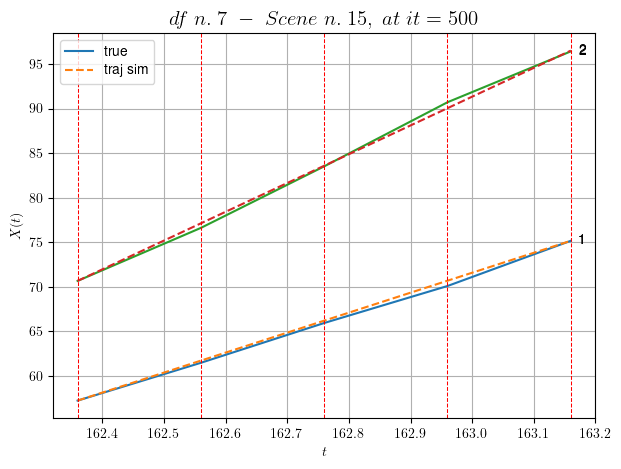

----------------------------------------------------------------------------------------------------
        For scene 18/20:
        * After LR finder: LR_NN=0.0005 with mse=38.98337390305779 at it=24
        * v0 = 32.323787690864414
        * MSE = 0.12001449505925417
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.19/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [206.96,207.56]


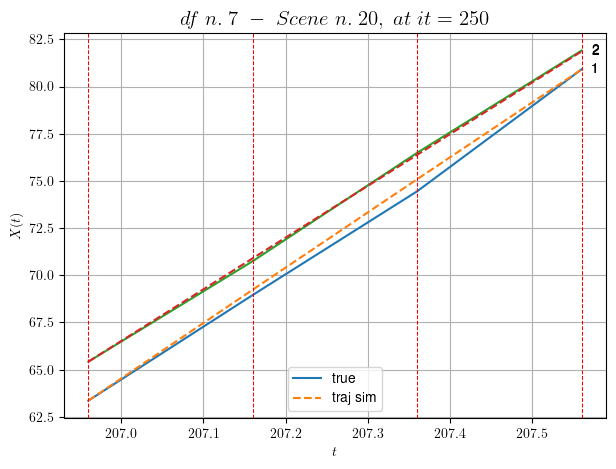

----------------------------------------------------------------------------------------------------
        For scene 19/20:
        * After LR finder: LR_NN=0.001 with mse=0.49756178377313587 at it=24
        * v0 = 27.399263722499665
        * MSE = 0.06462635209956655
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.20/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


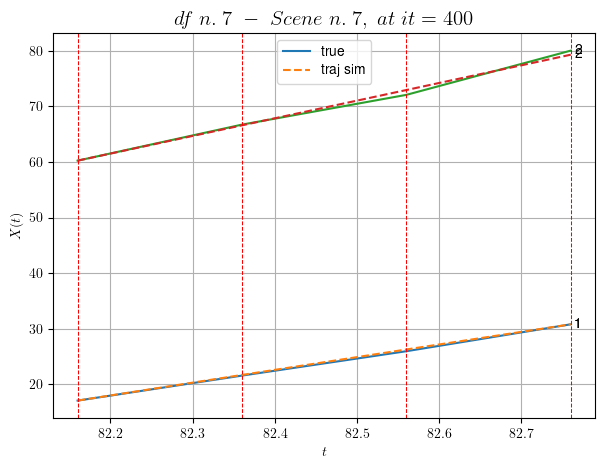

----------------------------------------------------------------------------------------------------
        For scene 20/20:
        * After LR finder: LR_NN=0.005 with mse=0.4471089756669458 at it=24
        * v0 = 31.745431021112502
        * MSE = 0.17695980989916704
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 0.6481527685797486
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (10 scenes)
DataFrame n.7. Scene n.1/10


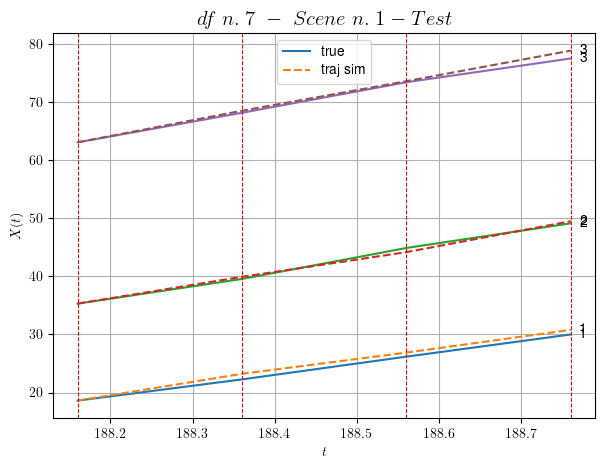

        For scene 1/10:
        * MSE = 0.40013062549082007
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/10


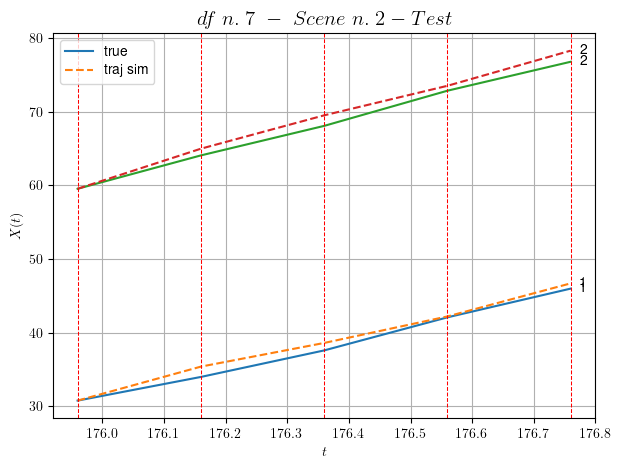

        For scene 2/10:
        * MSE = 0.9121824571609995
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/10


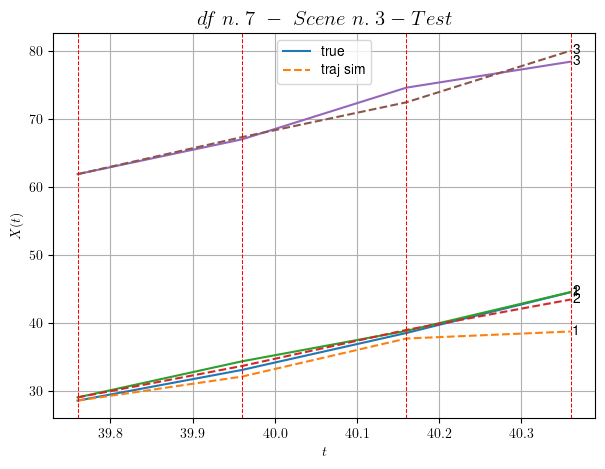

        For scene 3/10:
        * MSE = 3.6653777202503464
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/10


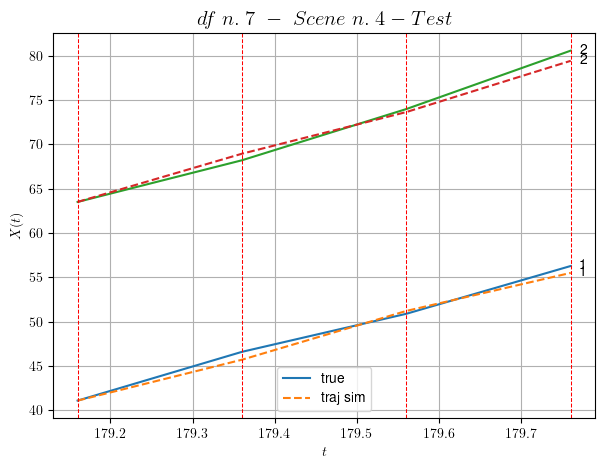

        For scene 4/10:
        * MSE = 0.43487435940221103
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/10


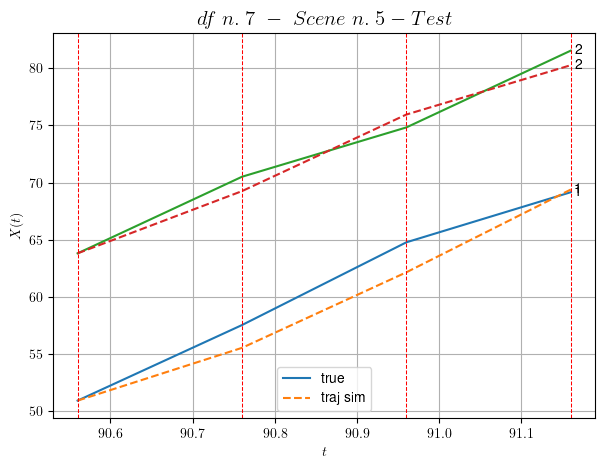

        For scene 5/10:
        * MSE = 1.9233789711813083
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/10


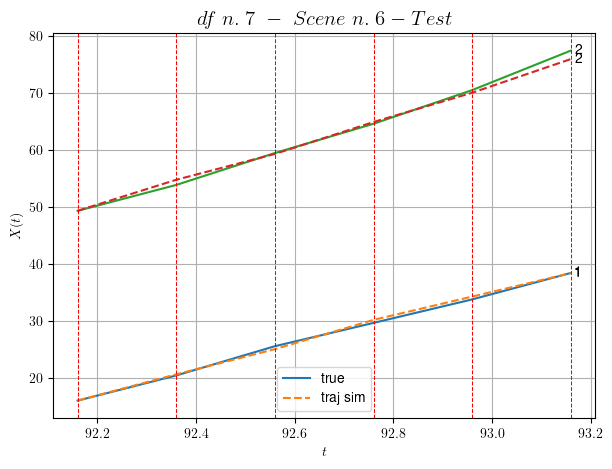

        For scene 6/10:
        * MSE = 0.34918258729432133
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/10


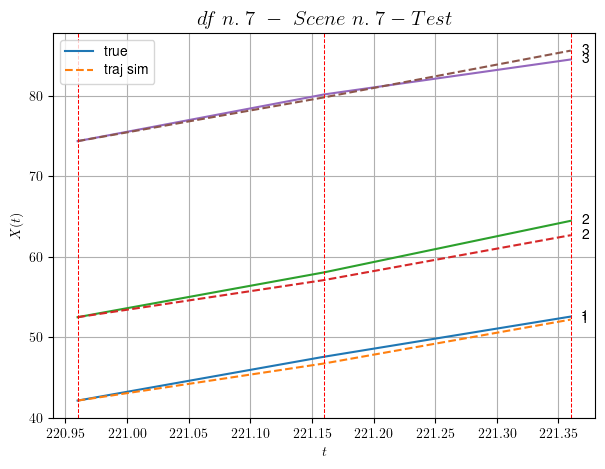

        For scene 7/10:
        * MSE = 0.6992121597230043
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/10


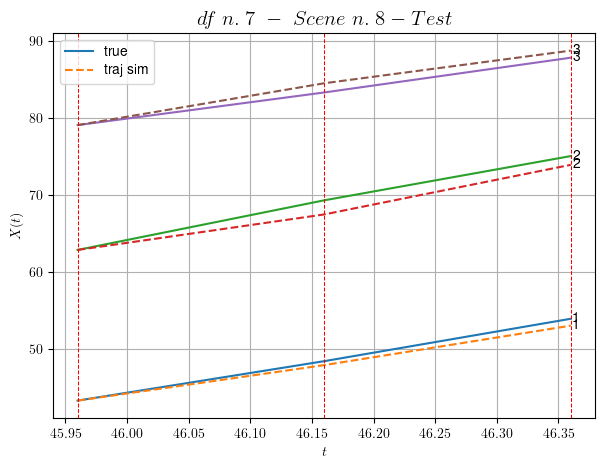

        For scene 8/10:
        * MSE = 0.8907360164488635
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/10


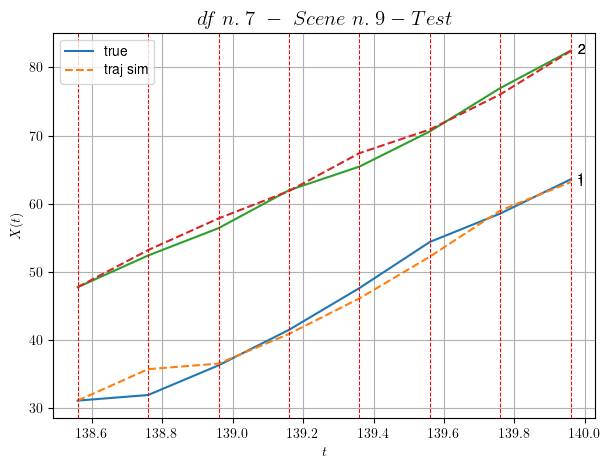

        For scene 9/10:
        * MSE = 1.8513505991636319
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/10


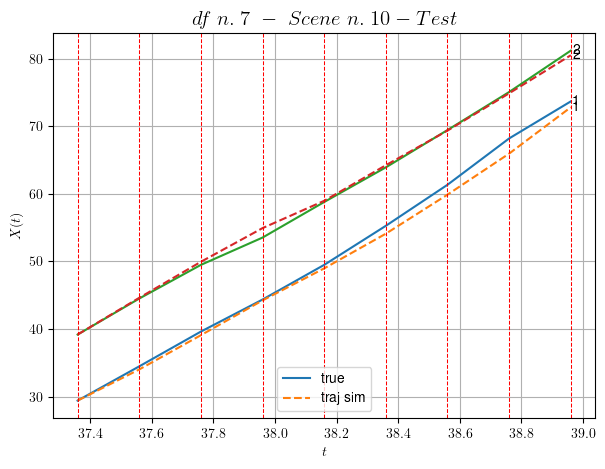

        For scene 10/10:
        * MSE = 0.7161801696234535
----------------------------------------------------------------------------------------------------


MSE test: 1.1842605665738961

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6481527685797486
          * MSE test: 1.1842605665738961
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 8/10 dfs.
In DataFrame n.8 we have 79 scenes.
    To train the model we use 52 scenes, the remaining 27 to test the model.

Training step. (52 scenes)
DataFrame n.8. Scene n.1/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [574.24,575.04]


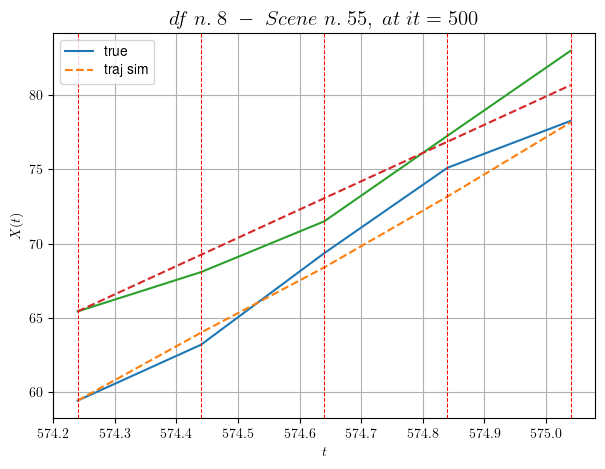

----------------------------------------------------------------------------------------------------
        For scene 1/52:
        * After LR finder: LR_NN=0.005 with mse=13.402498546274282 at it=24
        * v0 = 19.077749443553717
        * MSE = 1.4708317133762228
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [194.44,194.84]


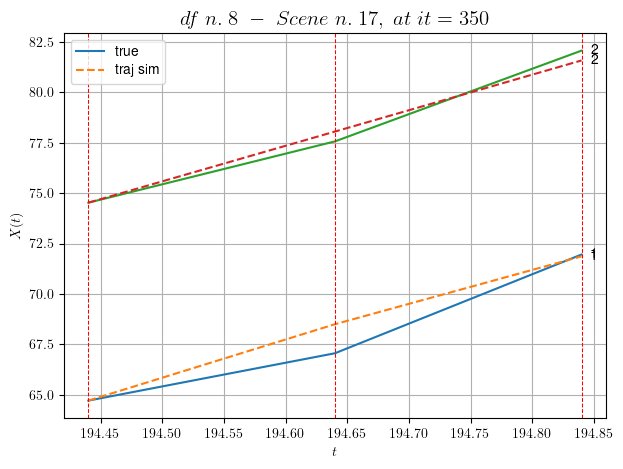

----------------------------------------------------------------------------------------------------
        For scene 2/52:
        * After LR finder: LR_NN=0.005 with mse=5.133056060771616 at it=24
        * v0 = 17.648705205693798
        * MSE = 0.4228406541475201
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [458.64,460.24]


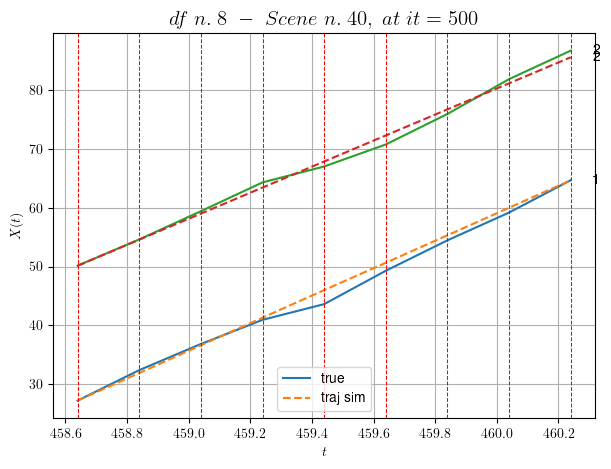

----------------------------------------------------------------------------------------------------
        For scene 3/52:
        * After LR finder: LR_NN=0.001 with mse=28.301689290324152 at it=24
        * v0 = 22.18478544849882
        * MSE = 0.8701982087724954
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [587.44,587.84]


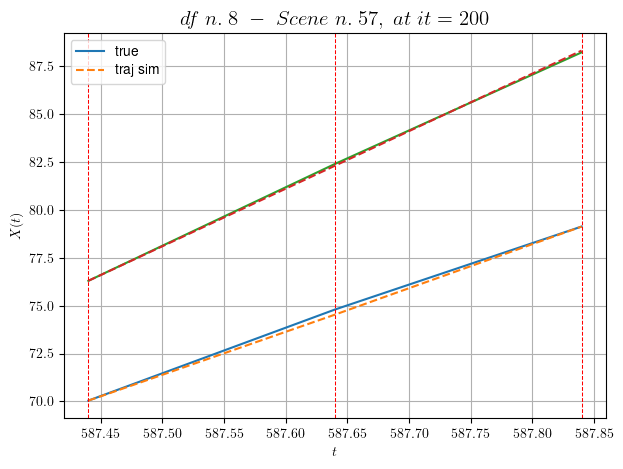

----------------------------------------------------------------------------------------------------
        For scene 4/52:
        * After LR finder: LR_NN=0.005 with mse=0.015562800960587122 at it=24
        * v0 = 30.037169893910686
        * MSE = 0.011739710828698874
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [256.44,257.24]


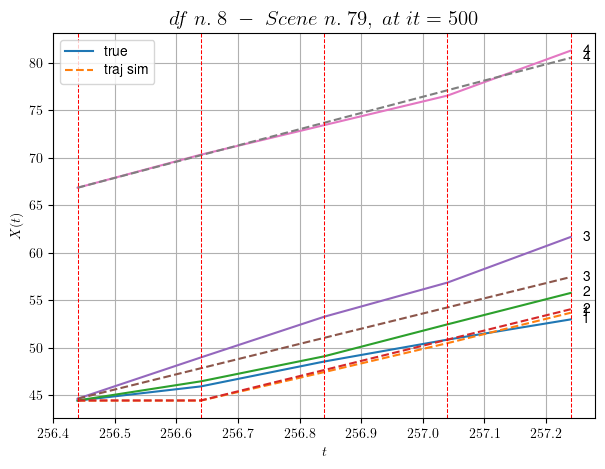

----------------------------------------------------------------------------------------------------
        For scene 5/52:
        * After LR finder: LR_NN=0.001 with mse=47.0949136684886 at it=24
        * v0 = 17.104258674666347
        * MSE = 2.329615883631507
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [105.04,105.64]


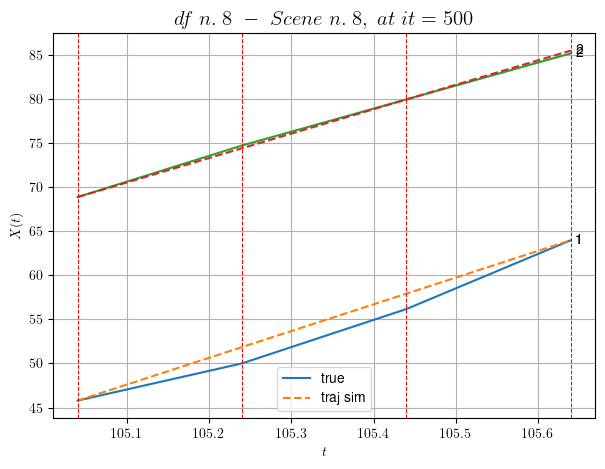

----------------------------------------------------------------------------------------------------
        For scene 6/52:
        * After LR finder: LR_NN=0.0001 with mse=1.5674113054130219 at it=24
        * v0 = 27.688024621823867
        * MSE = 0.581582546453118
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [531.84,532.84]


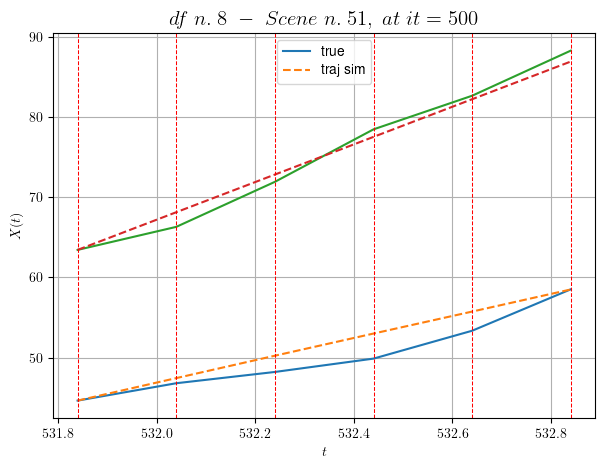

----------------------------------------------------------------------------------------------------
        For scene 7/52:
        * After LR finder: LR_NN=0.001 with mse=7.564139232695384 at it=24
        * v0 = 23.472410774642476
        * MSE = 2.2236348134214423
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [548.04,549.44]


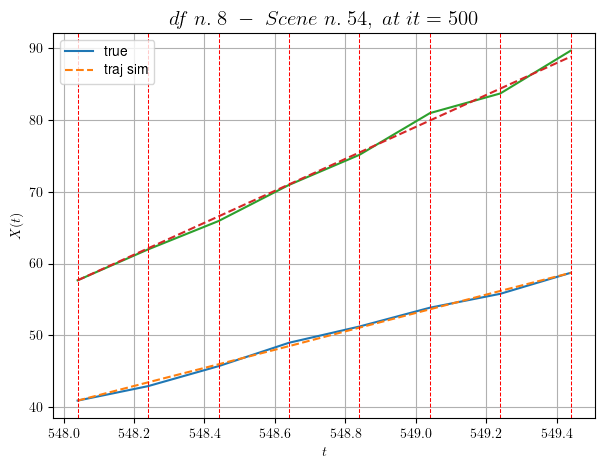

----------------------------------------------------------------------------------------------------
        For scene 8/52:
        * After LR finder: LR_NN=0.005 with mse=20.29842203693026 at it=24
        * v0 = 22.28422335728387
        * MSE = 0.2228706126289533
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/52
----------------------------------------------------------------------------------------------------
We have 11 time intervals inside [250.44,252.64]


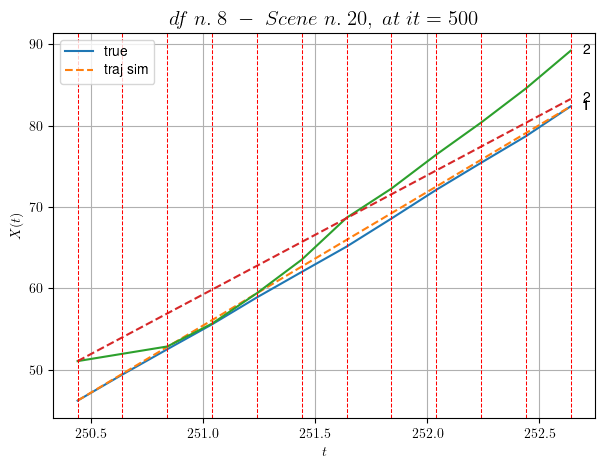

----------------------------------------------------------------------------------------------------
        For scene 9/52:
        * After LR finder: LR_NN=0.005 with mse=176.31867972270737 at it=24
        * v0 = 14.644824448517662
        * MSE = 4.174103462775158
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [227.04,227.84]


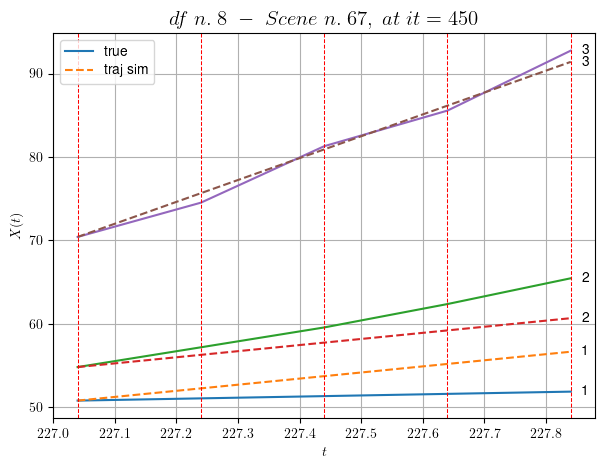

----------------------------------------------------------------------------------------------------
        For scene 10/52:
        * After LR finder: LR_NN=0.0005 with mse=2.9301339090553693 at it=24
        * v0 = 26.243156216995455
        * MSE = 5.556867814267826
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [319.44,320.44]


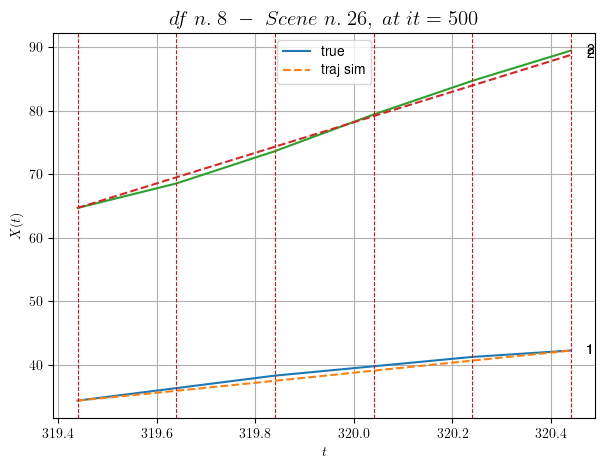

----------------------------------------------------------------------------------------------------
        For scene 11/52:
        * After LR finder: LR_NN=0.005 with mse=5.868586580914235 at it=24
        * v0 = 24.072557838554268
        * MSE = 0.3260346512203831
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/52
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [496.44,498.84]


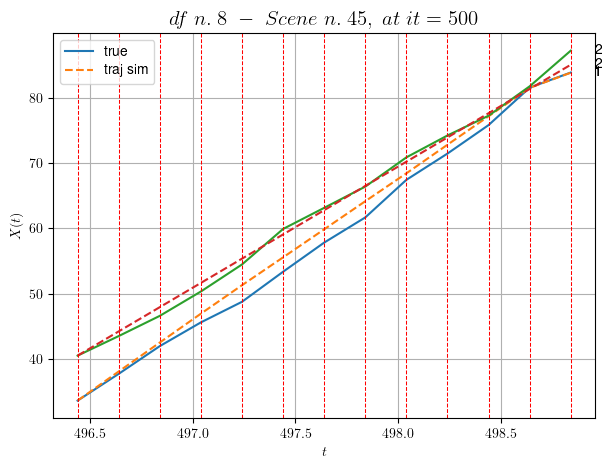

----------------------------------------------------------------------------------------------------
        For scene 12/52:
        * After LR finder: LR_NN=0.01 with mse=126.96485971106182 at it=24
        * v0 = 18.546831523765324
        * MSE = 1.3107912308827045
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [176.24,176.64]


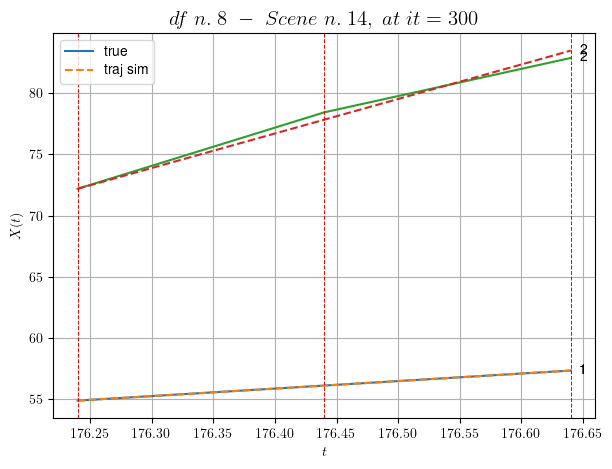

----------------------------------------------------------------------------------------------------
        For scene 13/52:
        * After LR finder: LR_NN=0.01 with mse=0.297769052974144 at it=24
        * v0 = 28.209764281783194
        * MSE = 0.11948262176130375
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [477.84,478.84]


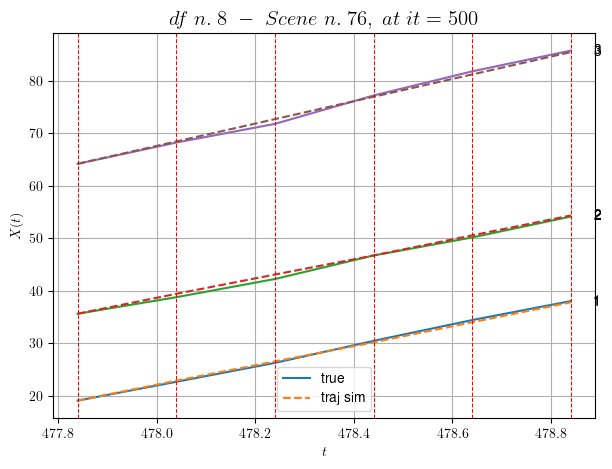

----------------------------------------------------------------------------------------------------
        For scene 14/52:
        * After LR finder: LR_NN=0.01 with mse=9.011024722813847 at it=24
        * v0 = 21.26815930217724
        * MSE = 0.16649007844652666
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [58.44,59.84]


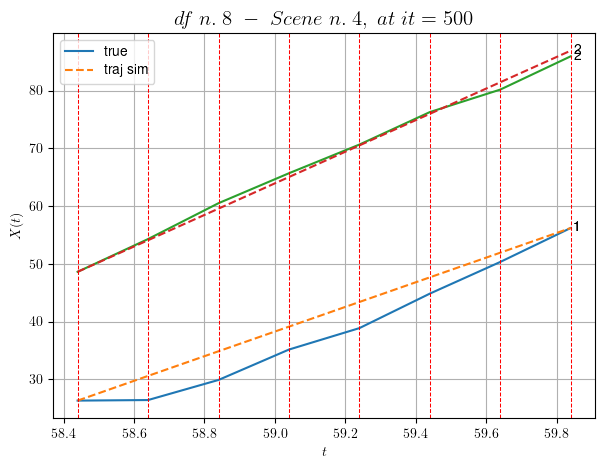

----------------------------------------------------------------------------------------------------
        For scene 15/52:
        * After LR finder: LR_NN=0.0001 with mse=7.308333431947325 at it=24
        * v0 = 27.356016886559097
        * MSE = 5.147758443382719
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [197.84,198.64]


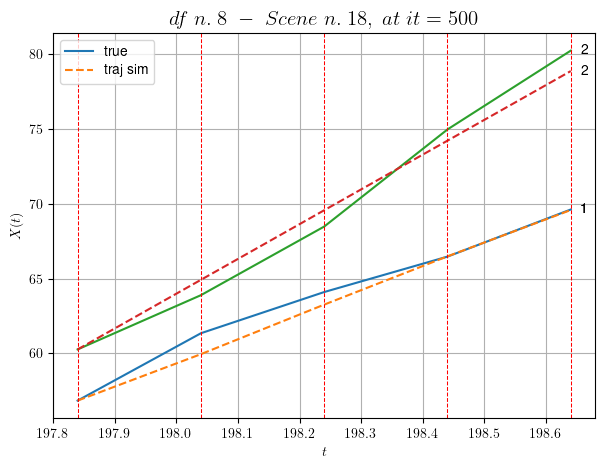

----------------------------------------------------------------------------------------------------
        For scene 16/52:
        * After LR finder: LR_NN=0.005 with mse=4.966595857433694 at it=24
        * v0 = 23.275091763732032
        * MSE = 0.6812400282269704
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [456.44,457.24]


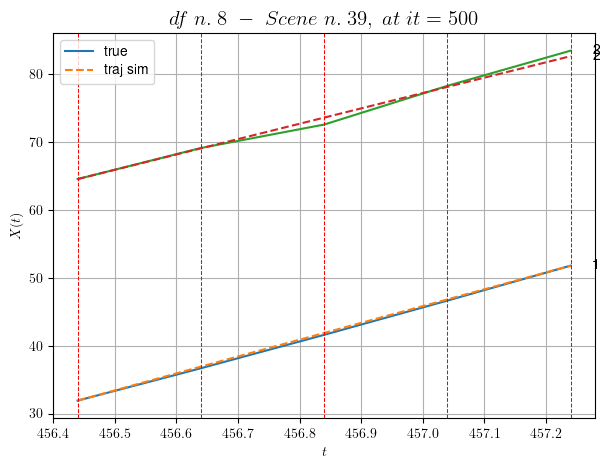

----------------------------------------------------------------------------------------------------
        For scene 17/52:
        * After LR finder: LR_NN=0.005 with mse=6.189076267076494 at it=24
        * v0 = 22.63724968833468
        * MSE = 0.18305133179149483
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [116.04,116.44]


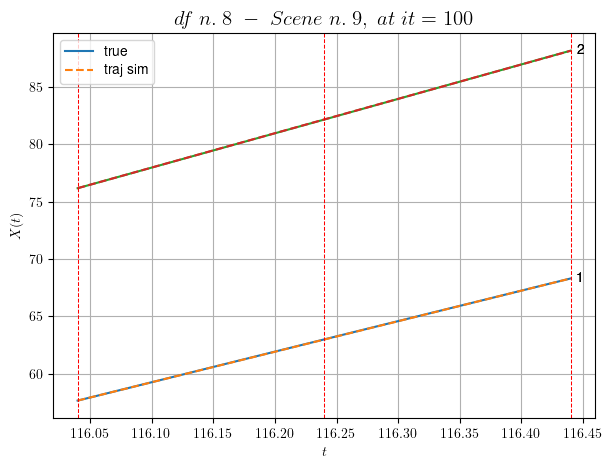

----------------------------------------------------------------------------------------------------
        For scene 18/52:
        * After LR finder: LR_NN=0.005 with mse=5.709081948682188e-05 at it=24
        * v0 = 29.99056749162664
        * MSE = 5.7297928243156876e-05
        * iterations = 100
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [225.24,226.24]


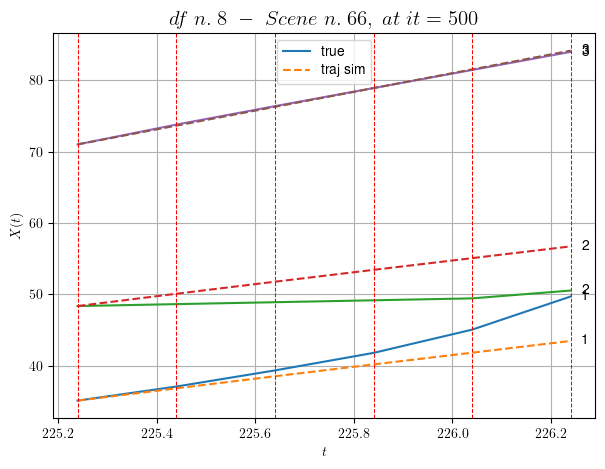

----------------------------------------------------------------------------------------------------
        For scene 19/52:
        * After LR finder: LR_NN=0.005 with mse=43.500030887974866 at it=24
        * v0 = 13.143683398703235
        * MSE = 8.400944454463804
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/52
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [101.04,103.04]


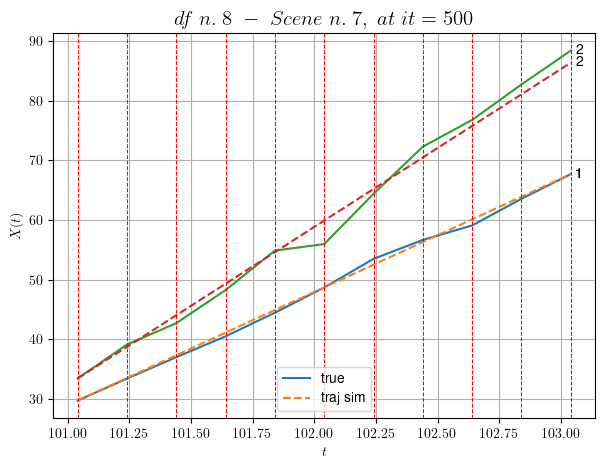

----------------------------------------------------------------------------------------------------
        For scene 20/52:
        * After LR finder: LR_NN=0.001 with mse=8.43203275592441 at it=24
        * v0 = 26.48969548240825
        * MSE = 1.4378724955749413
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/52
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [445.44,448.24]


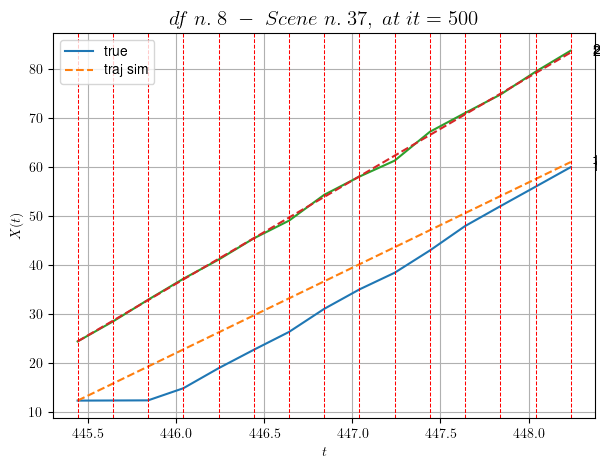

----------------------------------------------------------------------------------------------------
        For scene 21/52:
        * After LR finder: LR_NN=1e-05 with mse=111.60634362565266 at it=24
        * v0 = 21.04037373587072
        * MSE = 13.020644075835916
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [350.64,351.64]


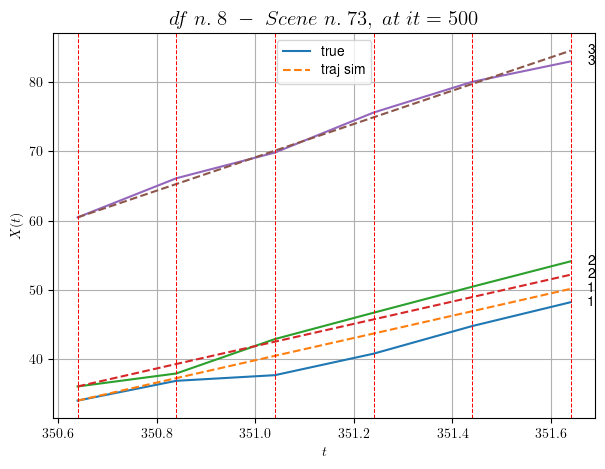

----------------------------------------------------------------------------------------------------
        For scene 22/52:
        * After LR finder: LR_NN=0.001 with mse=7.089890561145204 at it=24
        * v0 = 24.017556031657897
        * MSE = 2.064871709690196
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [36.44,37.04]


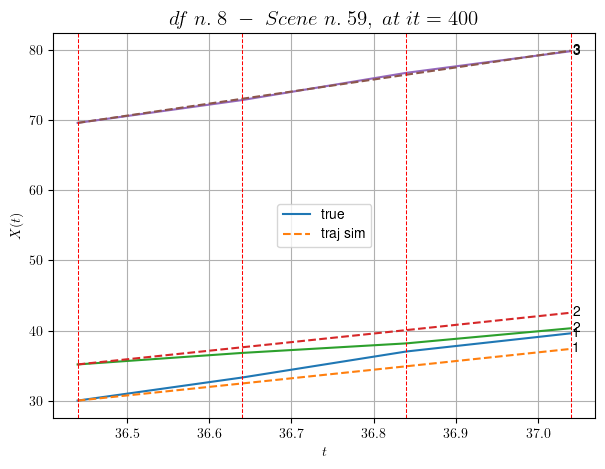

----------------------------------------------------------------------------------------------------
        For scene 23/52:
        * After LR finder: LR_NN=0.01 with mse=9.308438797164438 at it=24
        * v0 = 17.15681250011377
        * MSE = 1.6073967912377691
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [516.64,517.44]


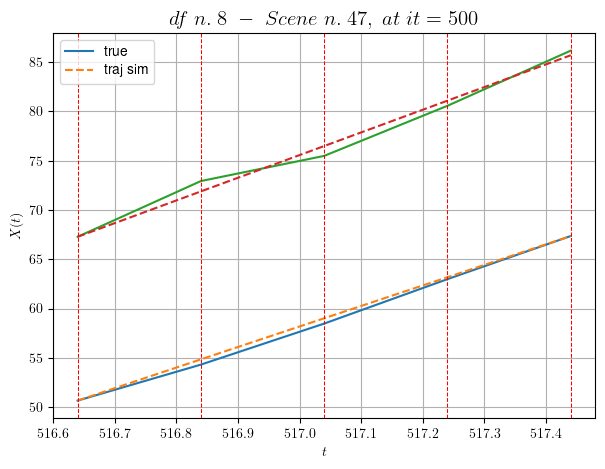

----------------------------------------------------------------------------------------------------
        For scene 24/52:
        * After LR finder: LR_NN=0.001 with mse=6.334067901387278 at it=24
        * v0 = 23.019463891835265
        * MSE = 0.3206302248475478
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [593.04,594.44]


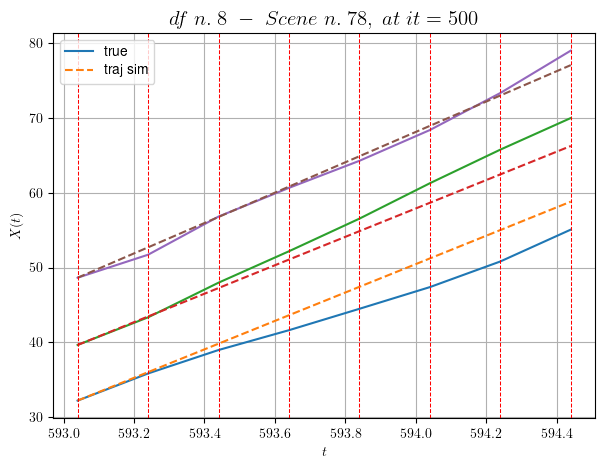

----------------------------------------------------------------------------------------------------
        For scene 25/52:
        * After LR finder: LR_NN=0.001 with mse=24.75652570440109 at it=24
        * v0 = 20.297836048725493
        * MSE = 4.21295897955367
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [190.84,191.84]


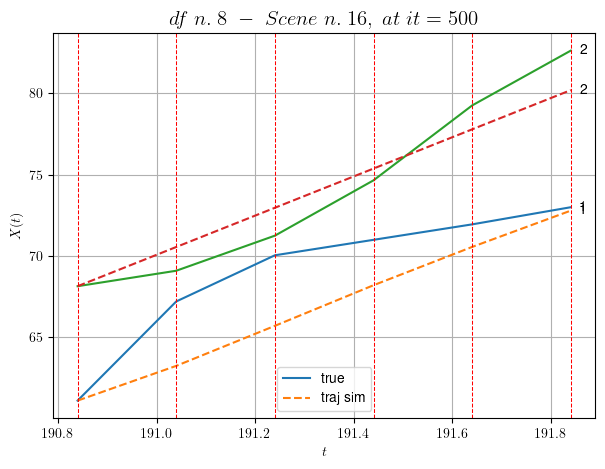

----------------------------------------------------------------------------------------------------
        For scene 26/52:
        * After LR finder: LR_NN=0.005 with mse=57.69270542251562 at it=24
        * v0 = 12.068548421445668
        * MSE = 4.836770519900687
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/52
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [327.84,329.64]


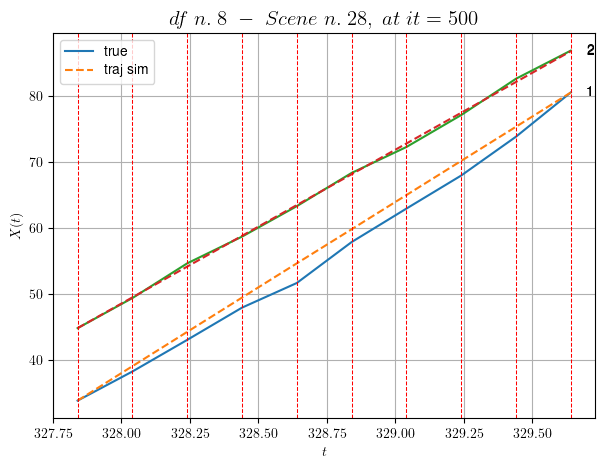

----------------------------------------------------------------------------------------------------
        For scene 27/52:
        * After LR finder: LR_NN=0.001 with mse=27.090119978592316 at it=24
        * v0 = 23.318084130194627
        * MSE = 1.4630049807972438
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.28/52
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [488.24,490.04]


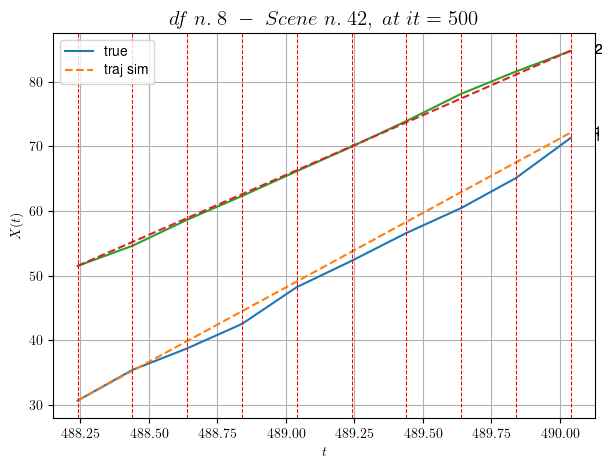

----------------------------------------------------------------------------------------------------
        For scene 28/52:
        * After LR finder: LR_NN=1e-05 with mse=74.39709622551852 at it=24
        * v0 = 18.510799599163867
        * MSE = 1.238522474763435
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.29/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [323.44,325.04]


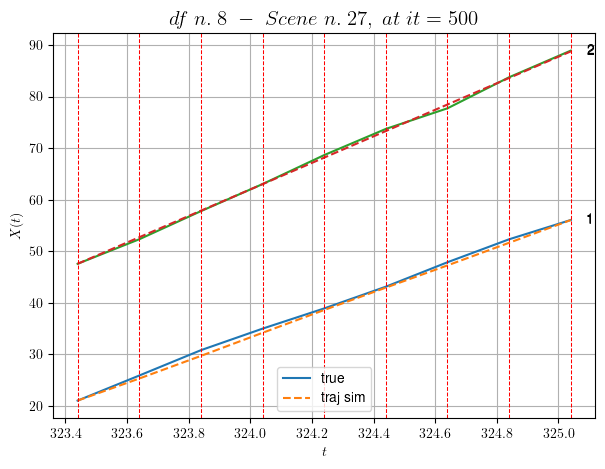

----------------------------------------------------------------------------------------------------
        For scene 29/52:
        * After LR finder: LR_NN=0.01 with mse=8.383411700687267 at it=24
        * v0 = 25.75837440985991
        * MSE = 0.23869157652676132
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.30/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [521.04,522.44]


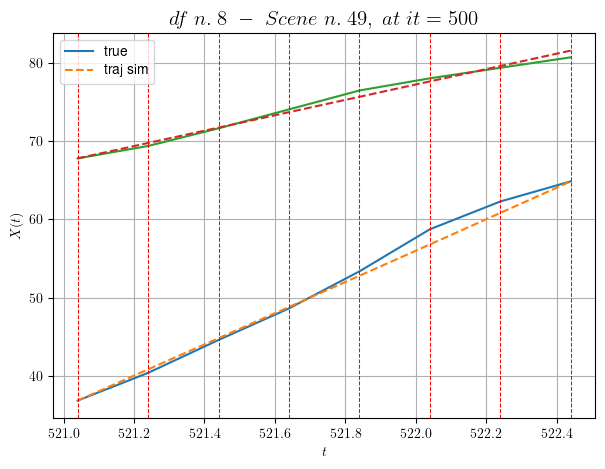

----------------------------------------------------------------------------------------------------
        For scene 30/52:
        * After LR finder: LR_NN=0.001 with mse=143.47316221551145 at it=24
        * v0 = 9.856007983844593
        * MSE = 0.5240483554460904
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.31/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [313.24,313.64]


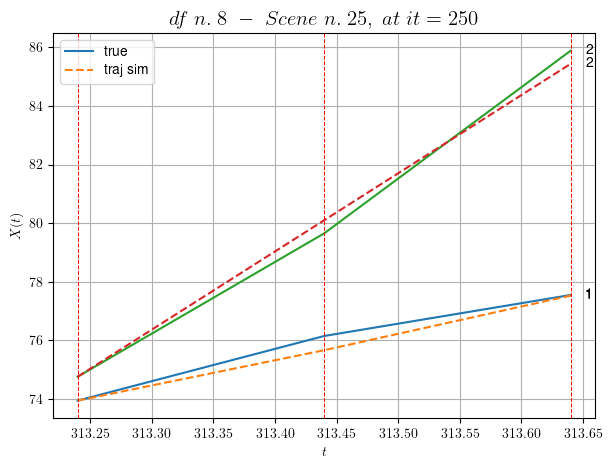

----------------------------------------------------------------------------------------------------
        For scene 31/52:
        * After LR finder: LR_NN=0.01 with mse=0.3315585958115351 at it=24
        * v0 = 26.698679535007486
        * MSE = 0.10121079371138794
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.32/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [494.44,495.84]


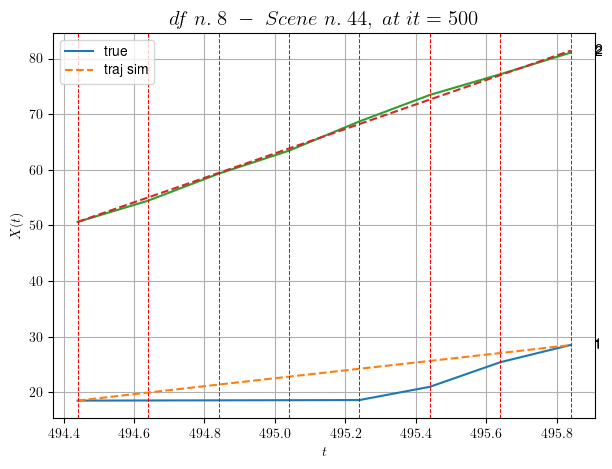

----------------------------------------------------------------------------------------------------
        For scene 32/52:
        * After LR finder: LR_NN=0.001 with mse=24.75204268993294 at it=24
        * v0 = 22.008439992316802
        * MSE = 5.304982953002664
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.33/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [522.64,523.04]


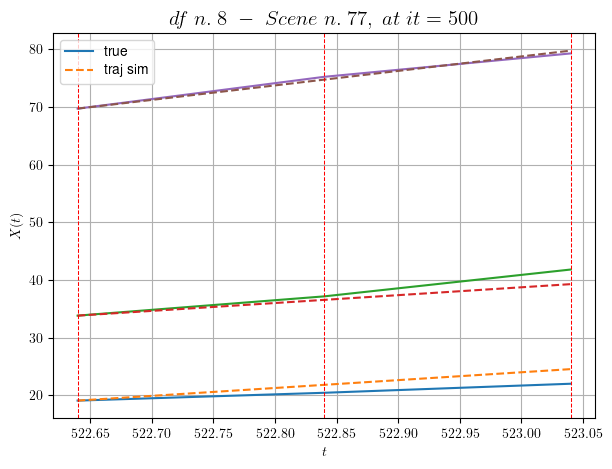

----------------------------------------------------------------------------------------------------
        For scene 33/52:
        * After LR finder: LR_NN=0.0005 with mse=0.9138164929526861 at it=24
        * v0 = 25.155972882594394
        * MSE = 1.7333299499201364
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.34/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [592.84,594.44]


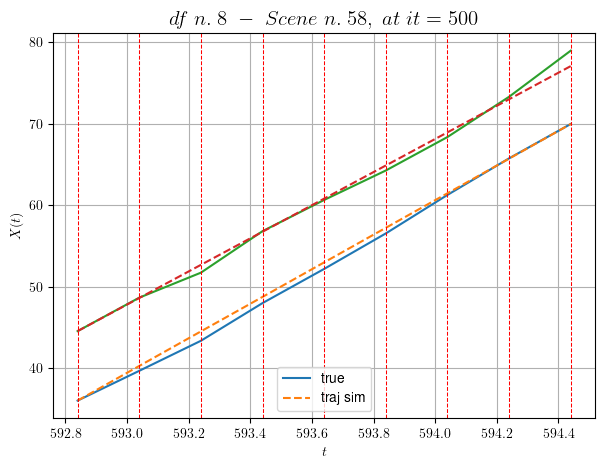

----------------------------------------------------------------------------------------------------
        For scene 34/52:
        * After LR finder: LR_NN=0.001 with mse=40.895286998045 at it=24
        * v0 = 20.35405742351383
        * MSE = 0.4650607626285994
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.35/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [154.24,154.84]


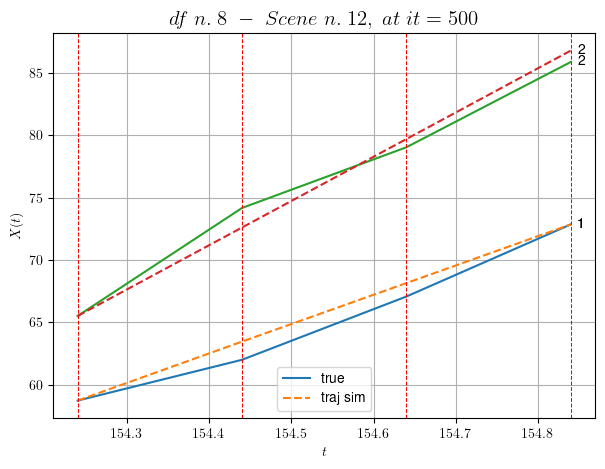

----------------------------------------------------------------------------------------------------
        For scene 35/52:
        * After LR finder: LR_NN=0.0005 with mse=1.9852802580243718 at it=24
        * v0 = 35.440393347036846
        * MSE = 0.8230480748196605
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.36/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [404.84,405.44]


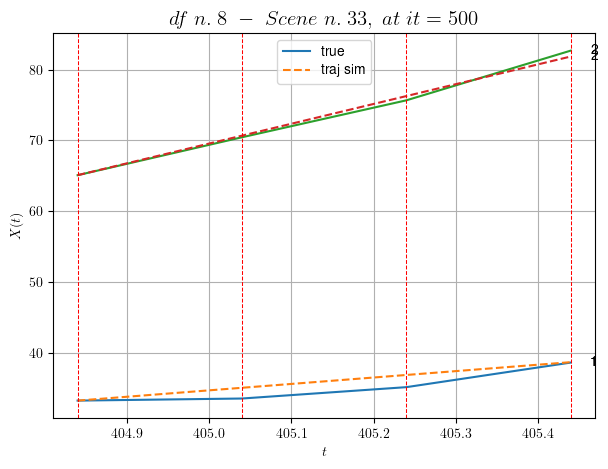

----------------------------------------------------------------------------------------------------
        For scene 36/52:
        * After LR finder: LR_NN=0.0001 with mse=1.0390288027607006 at it=24
        * v0 = 27.902766852719747
        * MSE = 0.7944073381319565
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.37/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [414.44,414.84]


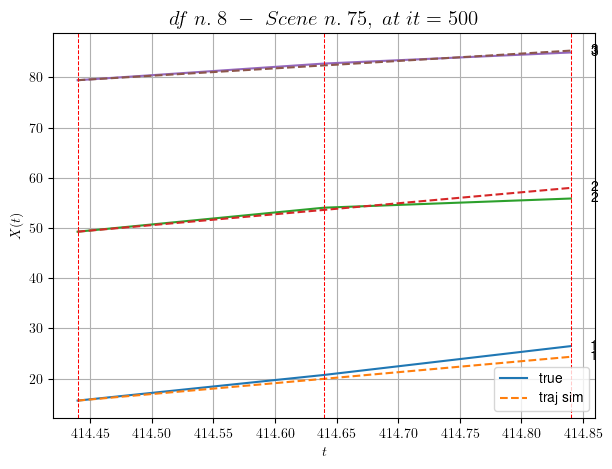

----------------------------------------------------------------------------------------------------
        For scene 37/52:
        * After LR finder: LR_NN=0.001 with mse=23.581631123259356 at it=24
        * v0 = 14.740228637605753
        * MSE = 1.1197692953176455
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.38/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [50.24,51.04]


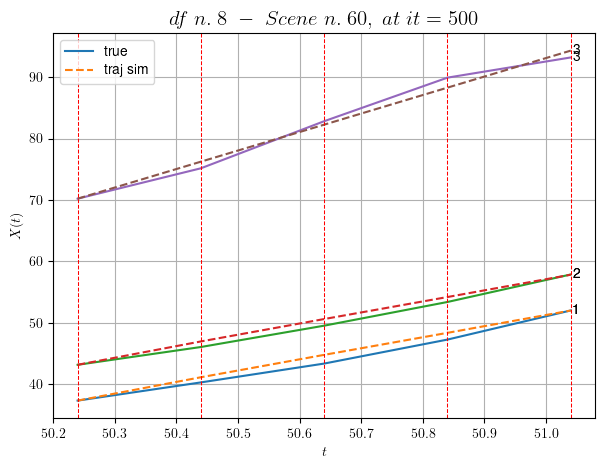

----------------------------------------------------------------------------------------------------
        For scene 38/52:
        * After LR finder: LR_NN=0.005 with mse=0.8747612562471065 at it=24
        * v0 = 30.157660974110993
        * MSE = 0.7910580998570752
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.39/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [215.24,216.24]


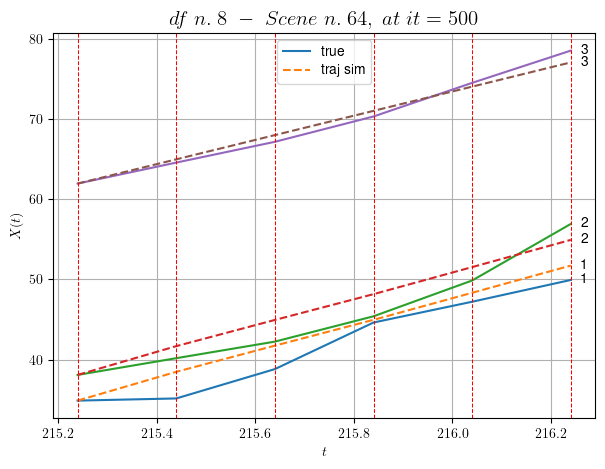

----------------------------------------------------------------------------------------------------
        For scene 39/52:
        * After LR finder: LR_NN=0.005 with mse=28.40125421087099 at it=24
        * v0 = 15.10068961055043
        * MSE = 2.8358637339617903
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.40/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [243.44,244.24]


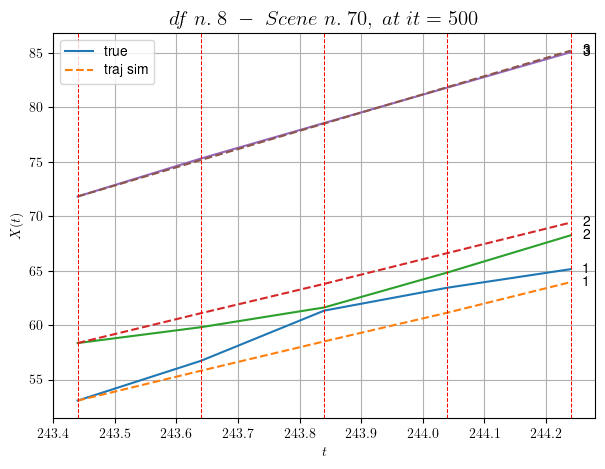

----------------------------------------------------------------------------------------------------
        For scene 40/52:
        * After LR finder: LR_NN=0.01 with mse=16.045457968313595 at it=24
        * v0 = 16.742914270050992
        * MSE = 1.7602190619148954
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.41/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [453.64,454.24]


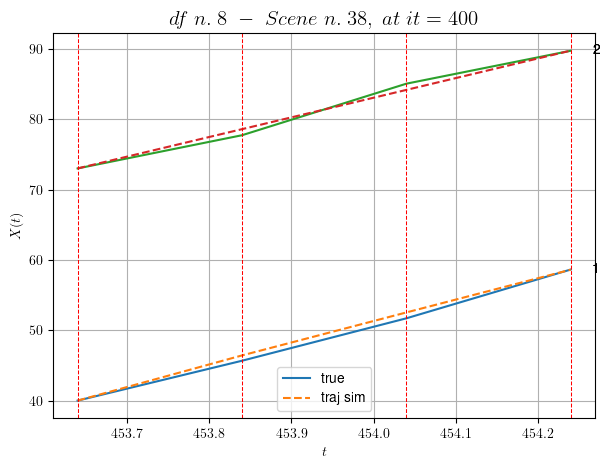

----------------------------------------------------------------------------------------------------
        For scene 41/52:
        * After LR finder: LR_NN=0.005 with mse=0.6063097339645119 at it=24
        * v0 = 27.920103287101618
        * MSE = 0.3449636084060258
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.42/52
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [366.64,369.44]


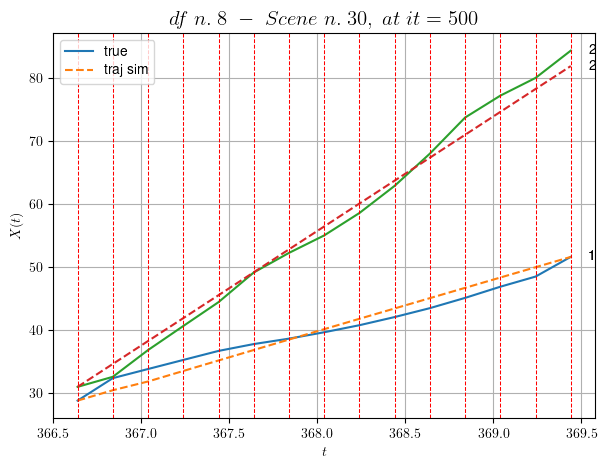

----------------------------------------------------------------------------------------------------
        For scene 42/52:
        * After LR finder: LR_NN=0.005 with mse=178.00038284990774 at it=24
        * v0 = 18.211190440756237
        * MSE = 2.0074842192871127
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.43/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [28.44,29.24]


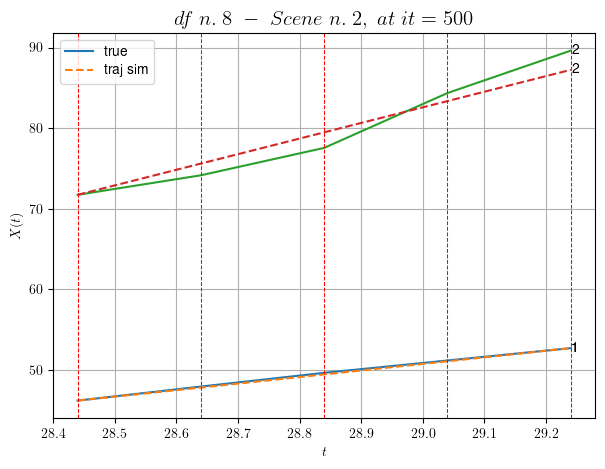

----------------------------------------------------------------------------------------------------
        For scene 43/52:
        * After LR finder: LR_NN=0.005 with mse=11.738953377581932 at it=24
        * v0 = 19.374312728051596
        * MSE = 1.0843609180322729
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.44/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [545.44,545.84]


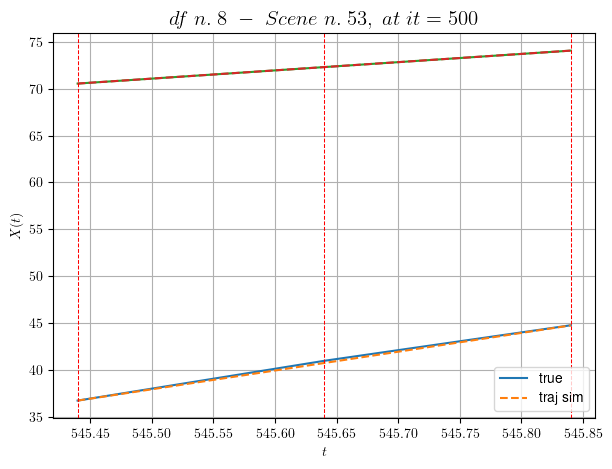

----------------------------------------------------------------------------------------------------
        For scene 44/52:
        * After LR finder: LR_NN=0.0001 with mse=14.981086919135725 at it=24
        * v0 = 8.800889061466014
        * MSE = 0.009104187660719066
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.45/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [278.64,279.64]


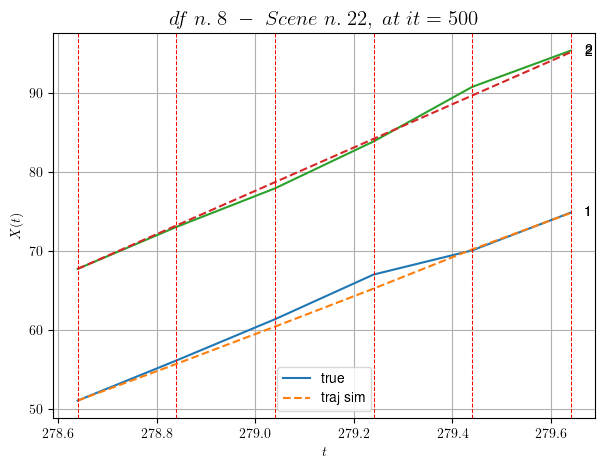

----------------------------------------------------------------------------------------------------
        For scene 45/52:
        * After LR finder: LR_NN=0.005 with mse=1.6053995553709164 at it=24
        * v0 = 27.407259315732738
        * MSE = 0.5098396011119298
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.46/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [48.04,48.84]


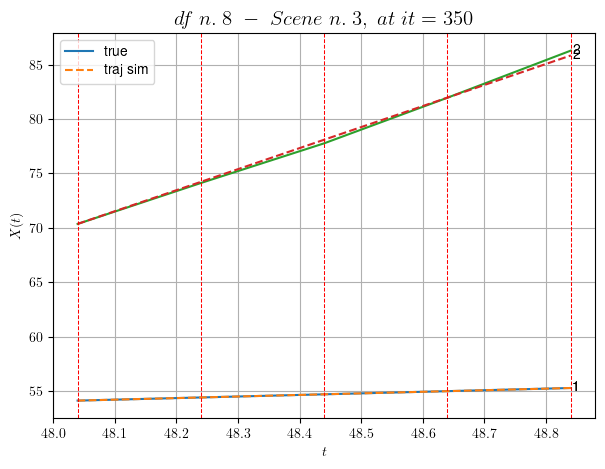

----------------------------------------------------------------------------------------------------
        For scene 46/52:
        * After LR finder: LR_NN=0.005 with mse=13.17903225678888 at it=24
        * v0 = 19.366199429857964
        * MSE = 0.028877290190691008
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.47/52
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [283.84,285.04]


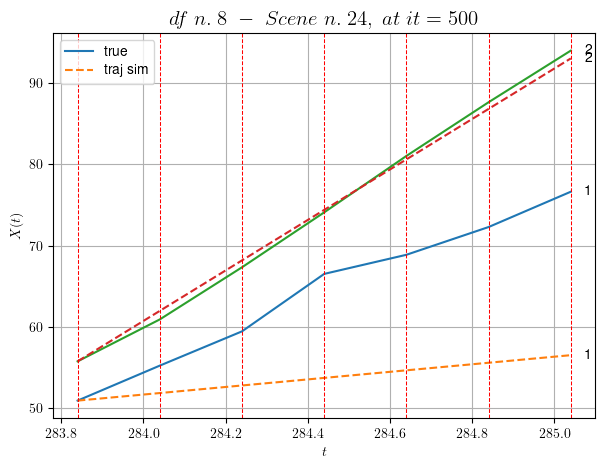

----------------------------------------------------------------------------------------------------
        For scene 47/52:
        * After LR finder: LR_NN=1e-05 with mse=37.820935842394135 at it=24
        * v0 = 31.024373752742626
        * MSE = 78.99590536711254
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.48/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [276.64,277.64]


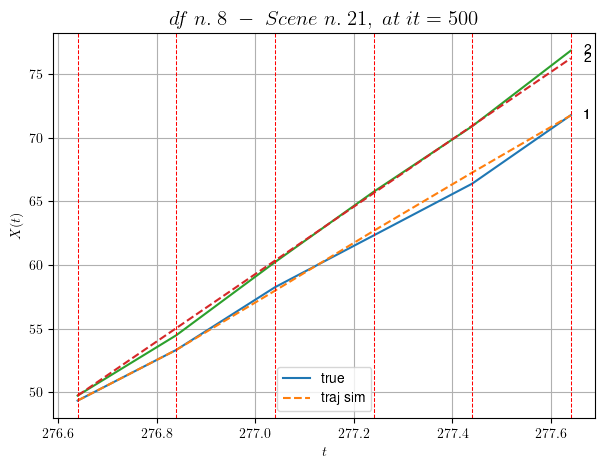

----------------------------------------------------------------------------------------------------
        For scene 48/52:
        * After LR finder: LR_NN=0.005 with mse=2.158496664854254 at it=24
        * v0 = 26.49050884606435
        * MSE = 0.13326947620950763
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.49/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [102.24,103.04]


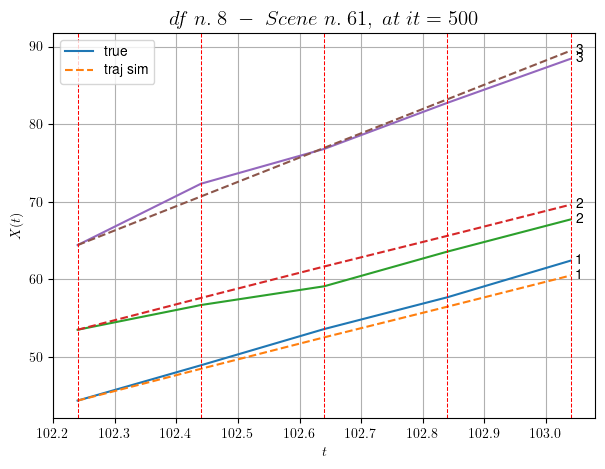

----------------------------------------------------------------------------------------------------
        For scene 49/52:
        * After LR finder: LR_NN=0.005 with mse=1.7259166308708025 at it=24
        * v0 = 31.34829198332158
        * MSE = 1.6923966423051928
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.50/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [290.84,291.44]


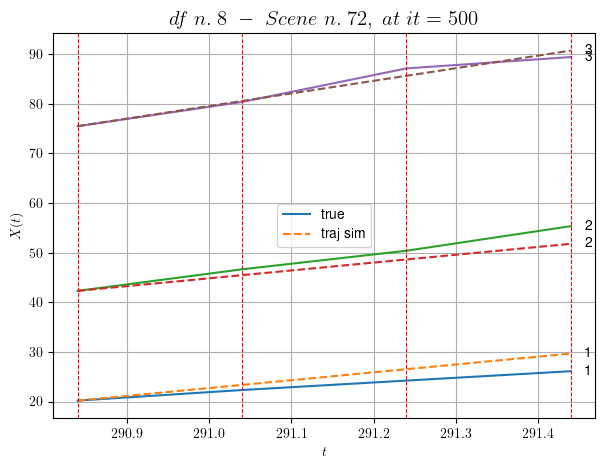

----------------------------------------------------------------------------------------------------
        For scene 50/52:
        * After LR finder: LR_NN=0.001 with mse=2.35934633793438 at it=24
        * v0 = 25.378244279773025
        * MSE = 3.336219533365211
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.51/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [178.44,179.24]


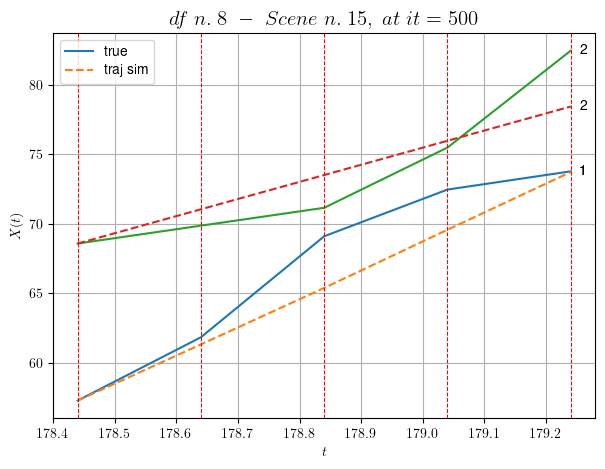

----------------------------------------------------------------------------------------------------
        For scene 51/52:
        * After LR finder: LR_NN=0.001 with mse=37.844553106452324 at it=24
        * v0 = 12.30898288993193
        * MSE = 4.496979643509876
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.52/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [536.64,537.24]


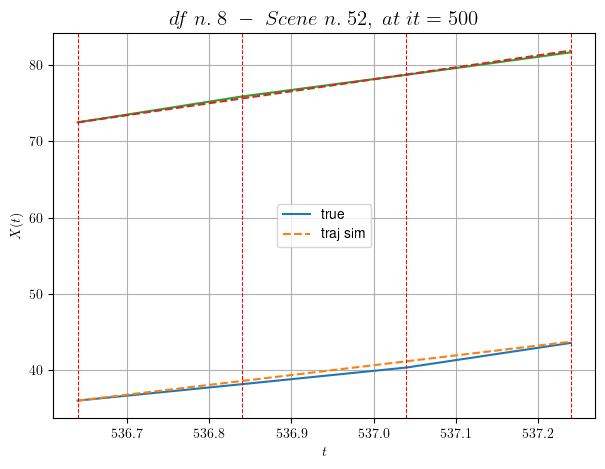

----------------------------------------------------------------------------------------------------
        For scene 52/52:
        * After LR finder: LR_NN=5e-05 with mse=14.778378100963607 at it=24
        * v0 = 15.683354883417133
        * MSE = 0.12402481272897051
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 3.339575444341677
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (27 scenes)
DataFrame n.8. Scene n.1/27


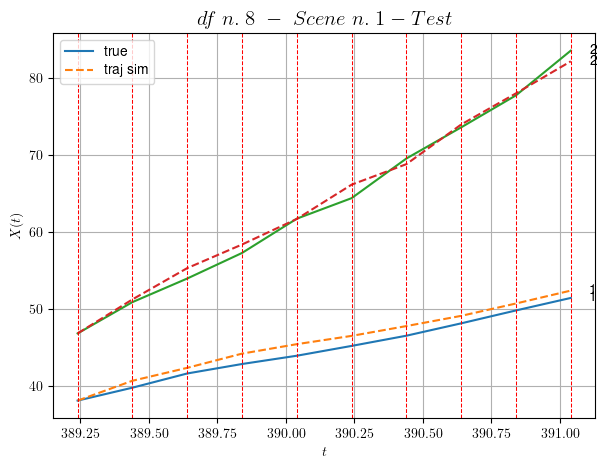

        For scene 1/27:
        * MSE = 1.0120104161976011
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/27


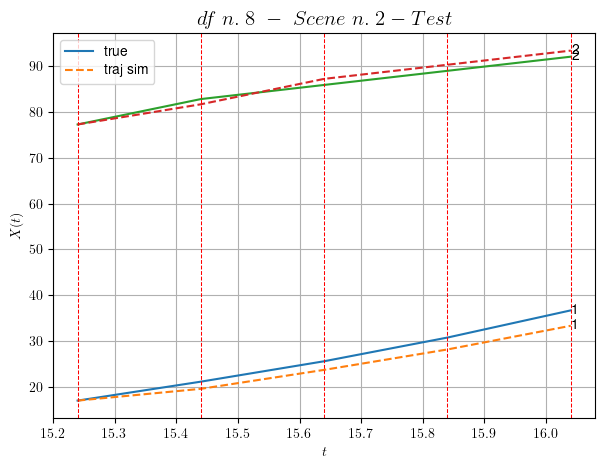

        For scene 2/27:
        * MSE = 3.069286380180876
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/27


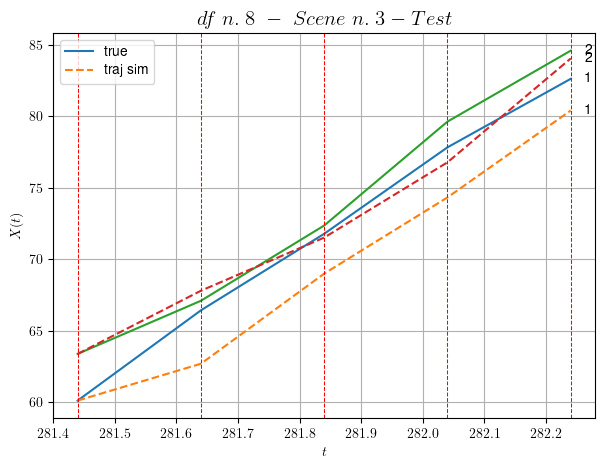

        For scene 3/27:
        * MSE = 4.841583819472605
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/27


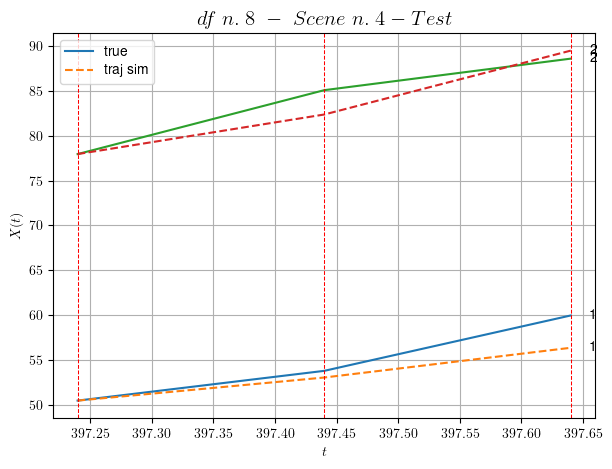

        For scene 4/27:
        * MSE = 3.6217206558532284
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/27


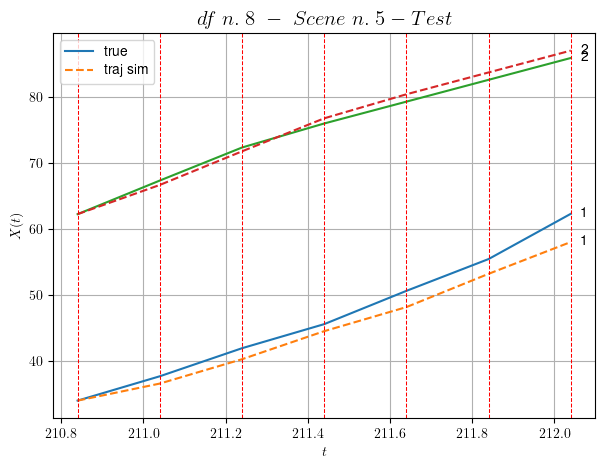

        For scene 5/27:
        * MSE = 2.81610014833423
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/27


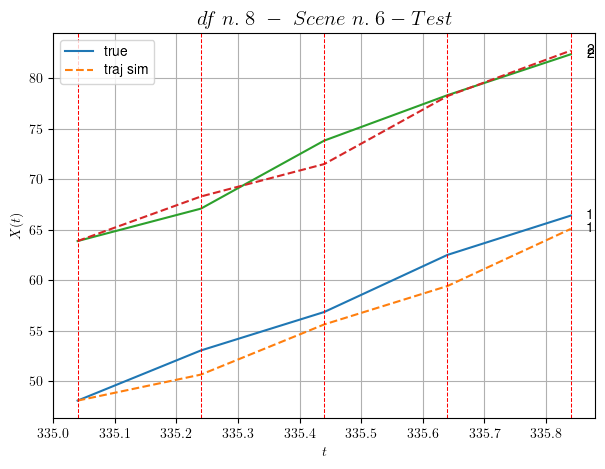

        For scene 6/27:
        * MSE = 2.5473761495935863
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/27


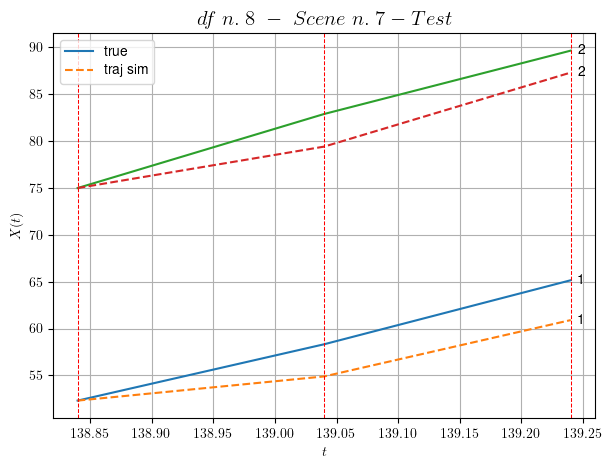

        For scene 7/27:
        * MSE = 7.882922109042955
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/27


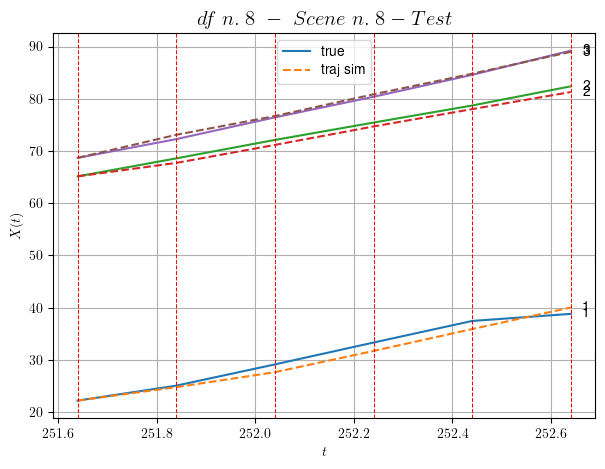

        For scene 8/27:
        * MSE = 0.7655354570531901
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/27


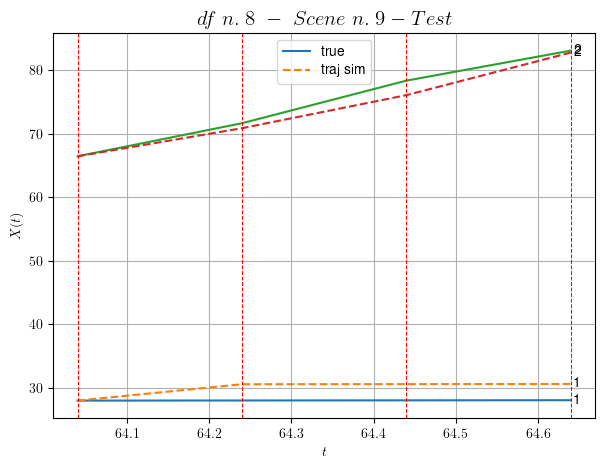

        For scene 9/27:
        * MSE = 3.191438404181771
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/27


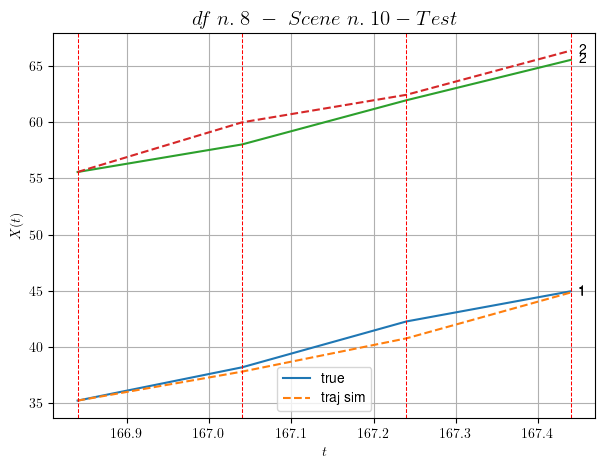

        For scene 10/27:
        * MSE = 0.8998707387174072
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/27


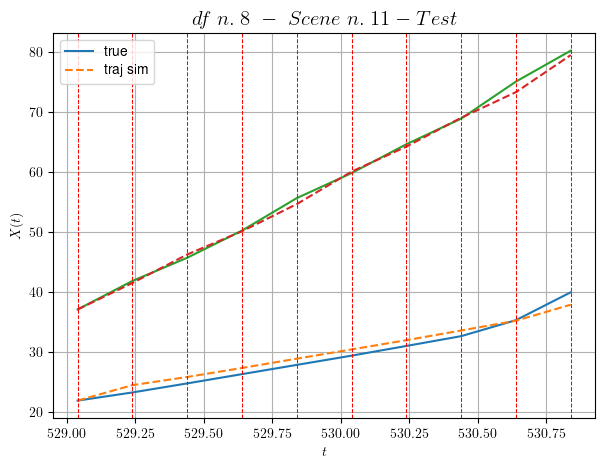

        For scene 11/27:
        * MSE = 0.8623913629162716
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/27


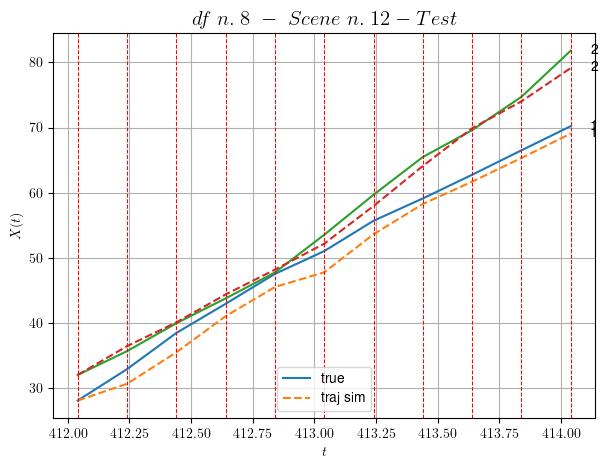

        For scene 12/27:
        * MSE = 2.5657182067911912
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/27


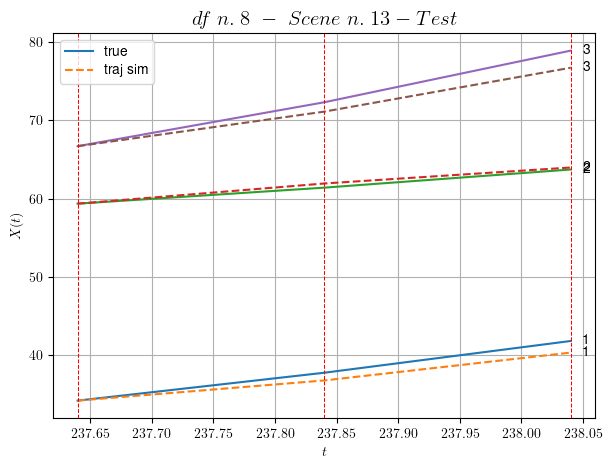

        For scene 13/27:
        * MSE = 1.079341786244827
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/27


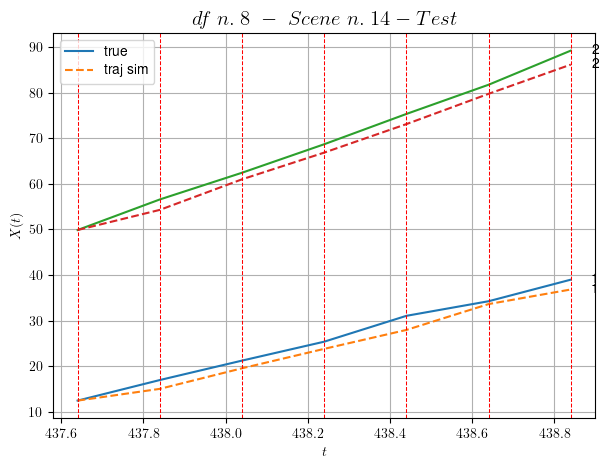

        For scene 14/27:
        * MSE = 3.759756935242652
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/27


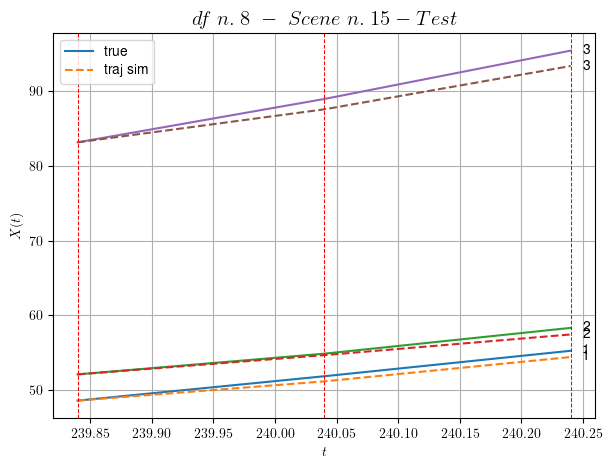

        For scene 15/27:
        * MSE = 0.9050132400410642
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/27


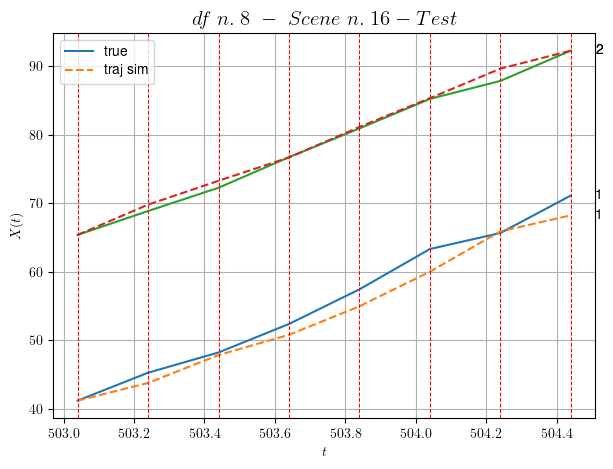

        For scene 16/27:
        * MSE = 2.21983099667496
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/27


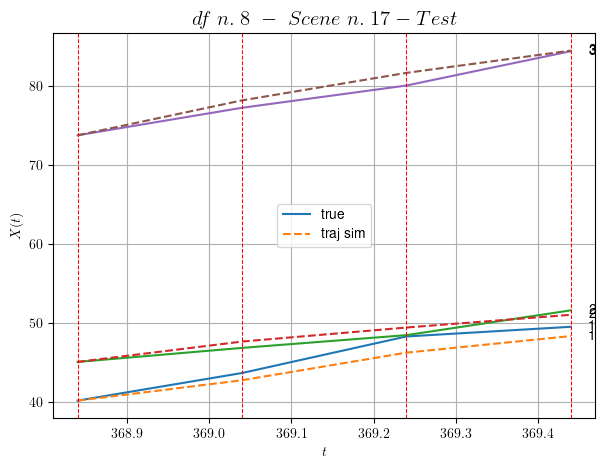

        For scene 17/27:
        * MSE = 0.9771781670025295
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/27


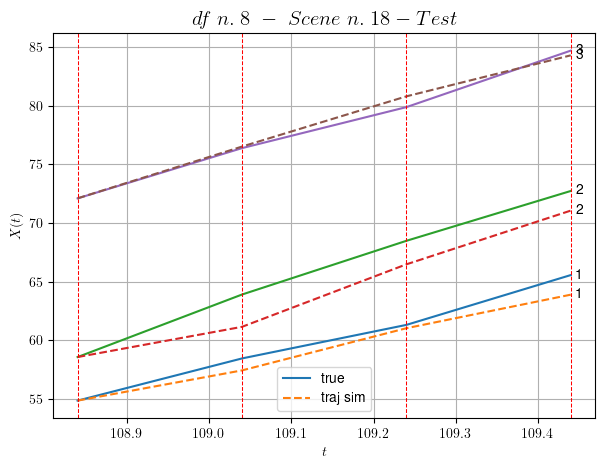

        For scene 18/27:
        * MSE = 1.611900320488017
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/27


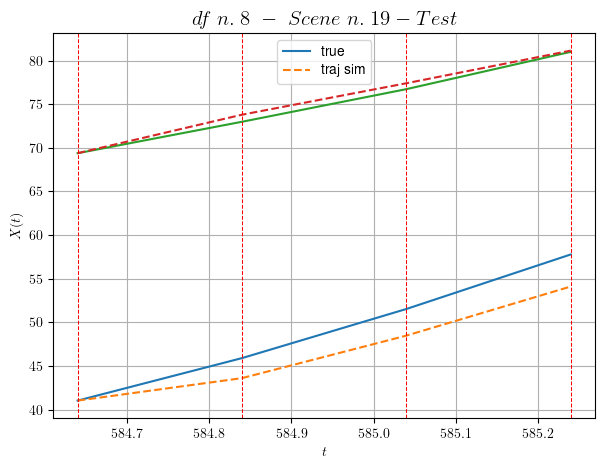

        For scene 19/27:
        * MSE = 3.6533654760160656
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/27


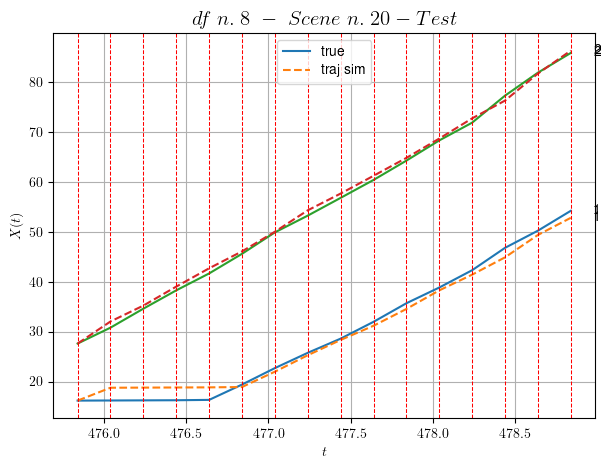

        For scene 20/27:
        * MSE = 1.4052121093310328
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/27


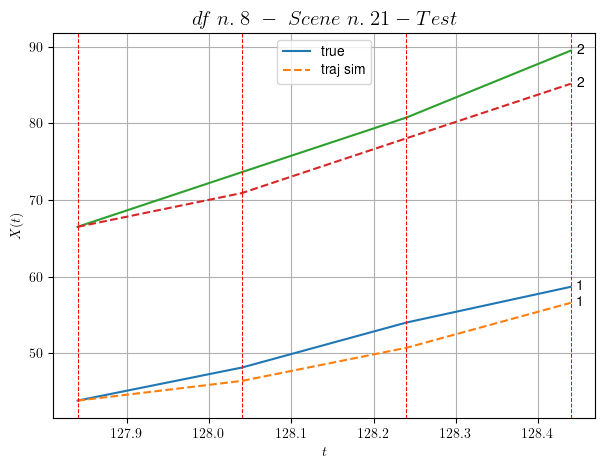

        For scene 21/27:
        * MSE = 6.478212832293023
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/27


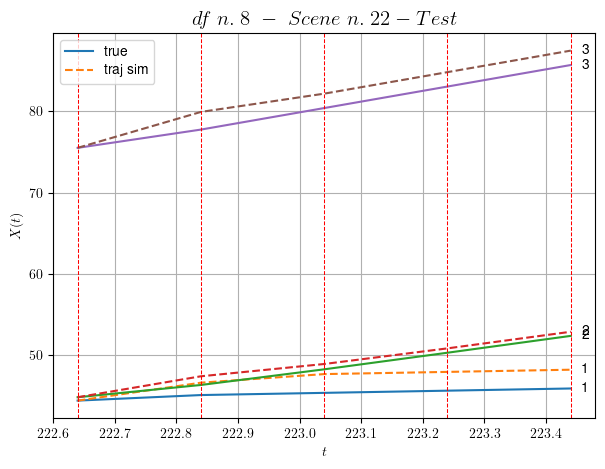

        For scene 22/27:
        * MSE = 2.299804646043509
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/27


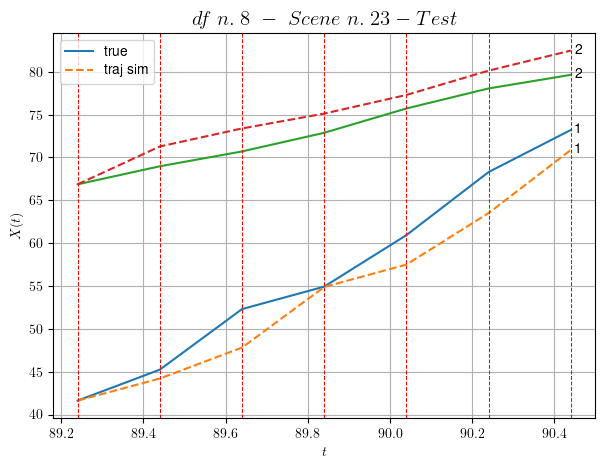

        For scene 23/27:
        * MSE = 6.697041840667231
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/27


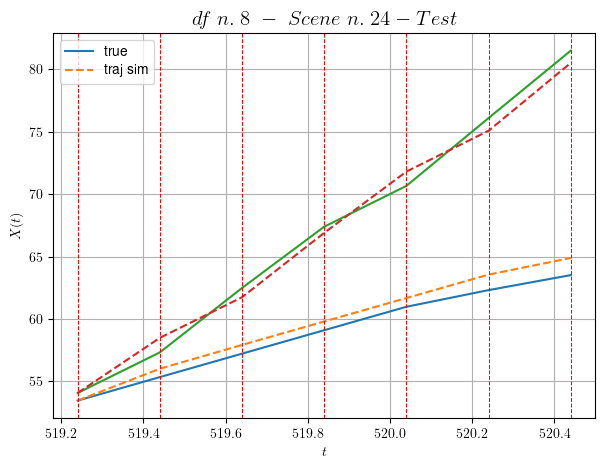

        For scene 24/27:
        * MSE = 0.7720924394280058
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/27


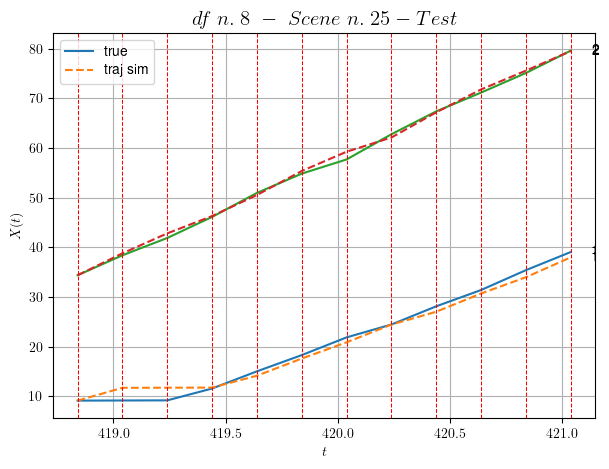

        For scene 25/27:
        * MSE = 1.049948298923783
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/27


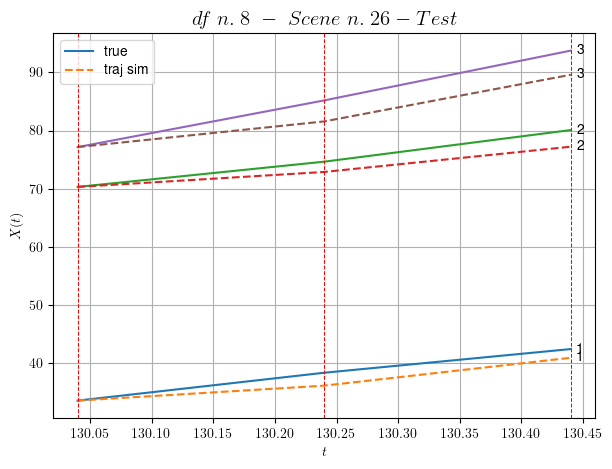

        For scene 26/27:
        * MSE = 5.43010041448304
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/27


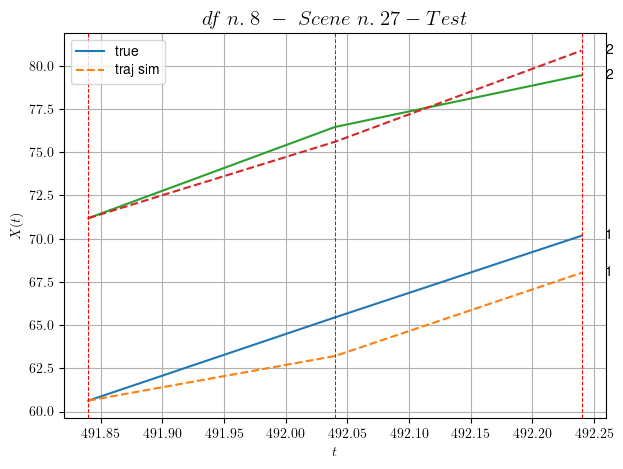

        For scene 27/27:
        * MSE = 2.0581952169921047
----------------------------------------------------------------------------------------------------


MSE test: 2.7582573543780278

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 3.339575444341677
          * MSE test: 2.7582573543780278
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 9/10 dfs.
In DataFrame n.9 we have 33 scenes.
    To train the model we use 22 scenes, the remaining 11 to test the model.

Training step. (22 scenes)
DataFrame n.9. Scene n.1/22
----------------------------------------------------------------------------------------------------
We have 18 time intervals inside [172.60,176.20]


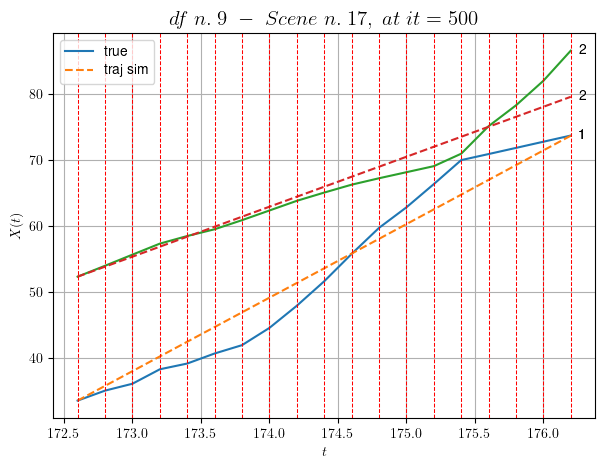

----------------------------------------------------------------------------------------------------
        For scene 1/22:
        * After LR finder: LR_NN=0.001 with mse=1106.0260965496345 at it=24
        * v0 = 7.579600948718987
        * MSE = 6.988593379138774
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [57.80,58.20]


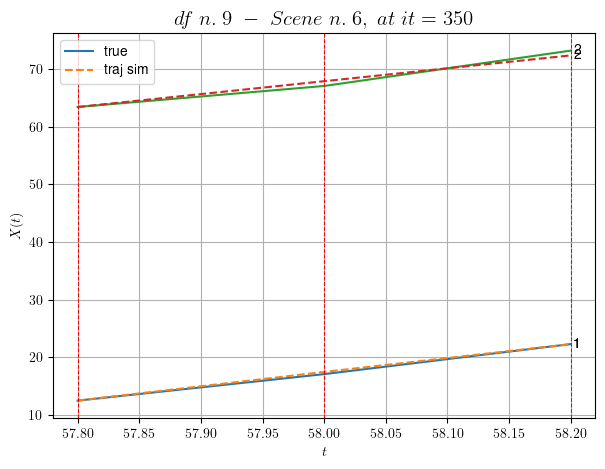

----------------------------------------------------------------------------------------------------
        For scene 2/22:
        * After LR finder: LR_NN=0.005 with mse=1.7683877980092644 at it=24
        * v0 = 22.38362178385961
        * MSE = 0.23269202522612384
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [155.40,156.40]


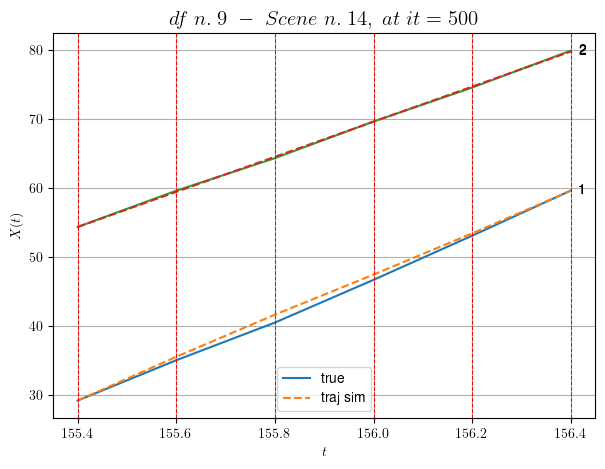

----------------------------------------------------------------------------------------------------
        For scene 3/22:
        * After LR finder: LR_NN=0.01 with mse=3.9691515672271844 at it=24
        * v0 = 25.423521542135838
        * MSE = 0.1409486274509643
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [143.60,144.00]


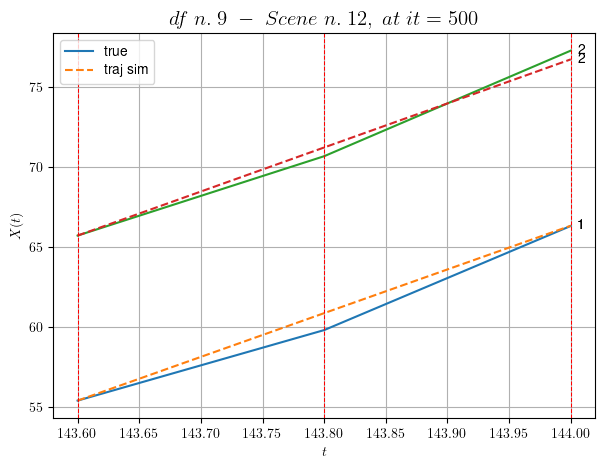

----------------------------------------------------------------------------------------------------
        For scene 4/22:
        * After LR finder: LR_NN=5e-05 with mse=18.066552931395158 at it=24
        * v0 = 27.47606787616934
        * MSE = 0.2850897918248413
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/22
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [5.40,6.00]


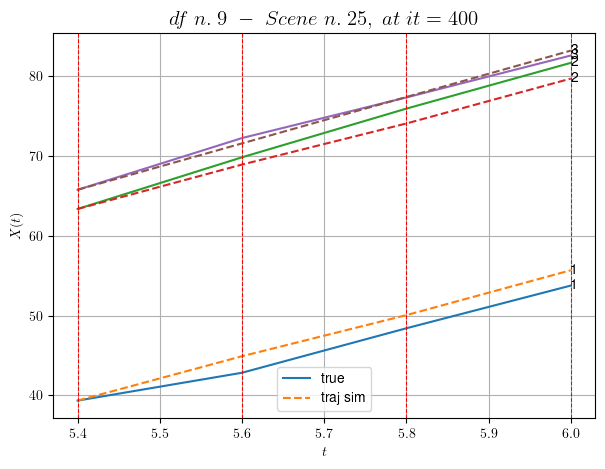

----------------------------------------------------------------------------------------------------
        For scene 5/22:
        * After LR finder: LR_NN=0.01 with mse=1.7646129936285337 at it=24
        * v0 = 29.081108265368716
        * MSE = 1.6453414751171687
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [19.80,20.20]


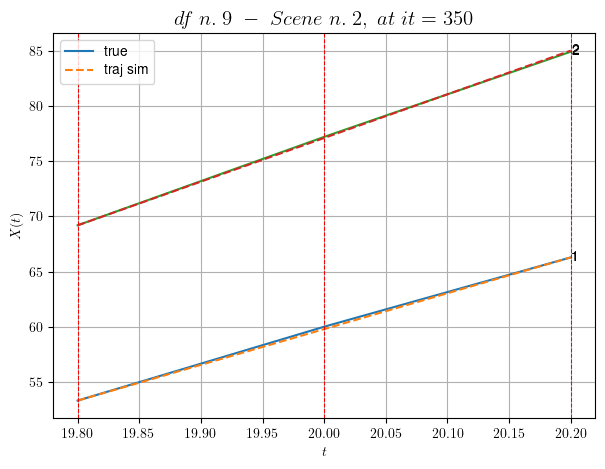

----------------------------------------------------------------------------------------------------
        For scene 6/22:
        * After LR finder: LR_NN=0.0005 with mse=4.4913349950245705 at it=24
        * v0 = 39.64570586528521
        * MSE = 0.010835209962986802
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [30.80,31.20]


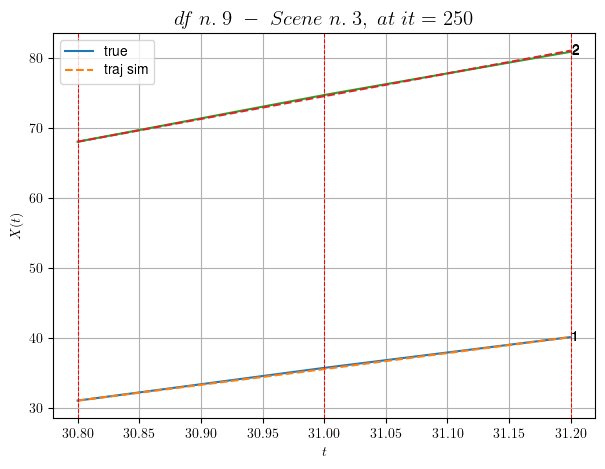

----------------------------------------------------------------------------------------------------
        For scene 7/22:
        * After LR finder: LR_NN=0.005 with mse=0.21687526992340295 at it=24
        * v0 = 32.53591560388908
        * MSE = 0.013813231008181829
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [119.20,119.60]


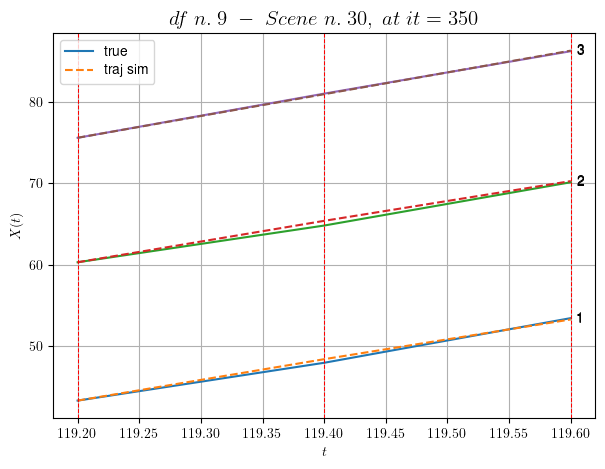

----------------------------------------------------------------------------------------------------
        For scene 8/22:
        * After LR finder: LR_NN=0.005 with mse=0.3196872496605588 at it=24
        * v0 = 26.734613425844156
        * MSE = 0.06492250855677804
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [36.60,37.60]


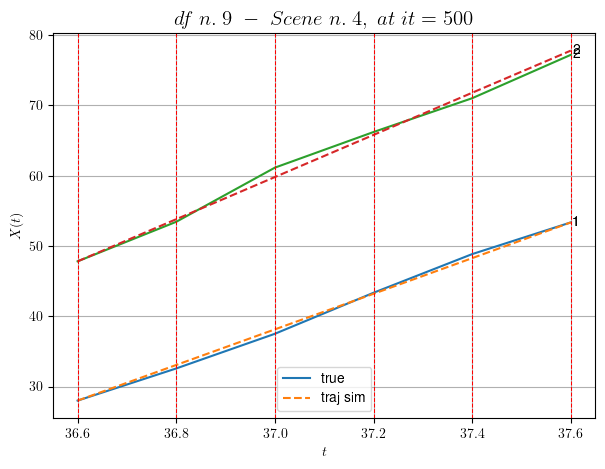

----------------------------------------------------------------------------------------------------
        For scene 9/22:
        * After LR finder: LR_NN=0.0005 with mse=0.3075474313213773 at it=24
        * v0 = 29.981948107113695
        * MSE = 0.33770607665982305
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [44.40,44.80]


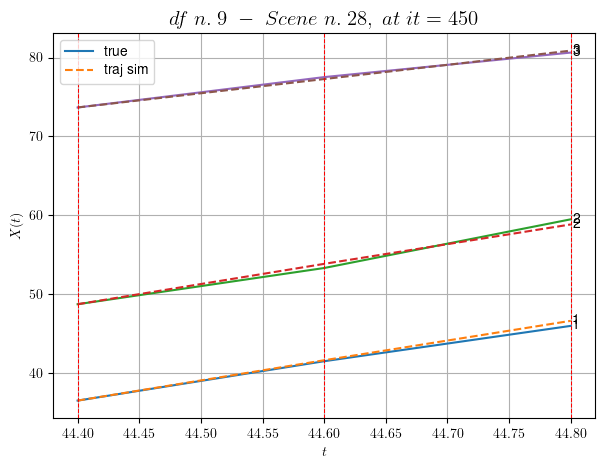

----------------------------------------------------------------------------------------------------
        For scene 10/22:
        * After LR finder: LR_NN=0.005 with mse=3.4660115650065637 at it=24
        * v0 = 18.016109118052384
        * MSE = 0.13766699533786358
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/22
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [225.20,226.00]


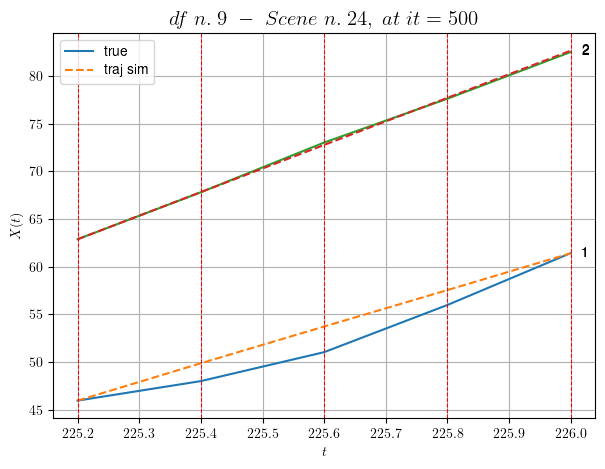

----------------------------------------------------------------------------------------------------
        For scene 11/22:
        * After LR finder: LR_NN=0.001 with mse=4.346934915476596 at it=24
        * v0 = 24.737876605773454
        * MSE = 1.3192457848041204
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.12/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [120.20,120.60]


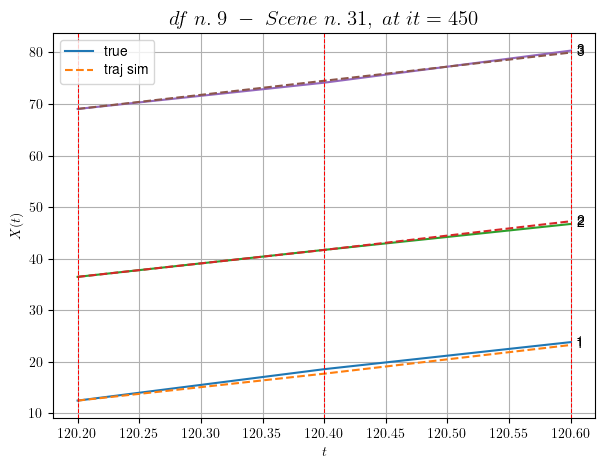

----------------------------------------------------------------------------------------------------
        For scene 12/22:
        * After LR finder: LR_NN=0.01 with mse=0.3260554135185521 at it=24
        * v0 = 27.348987837942857
        * MSE = 0.18012013538383753
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.13/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [219.80,220.20]


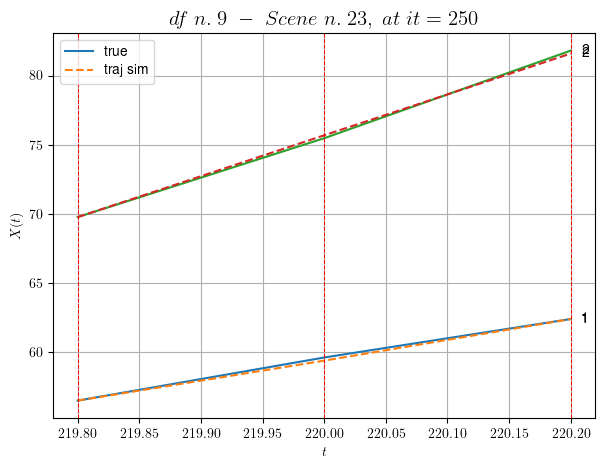

----------------------------------------------------------------------------------------------------
        For scene 13/22:
        * After LR finder: LR_NN=0.01 with mse=0.024072964875585273 at it=24
        * v0 = 29.5739937122531
        * MSE = 0.020624967899982687
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.14/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [191.20,192.20]


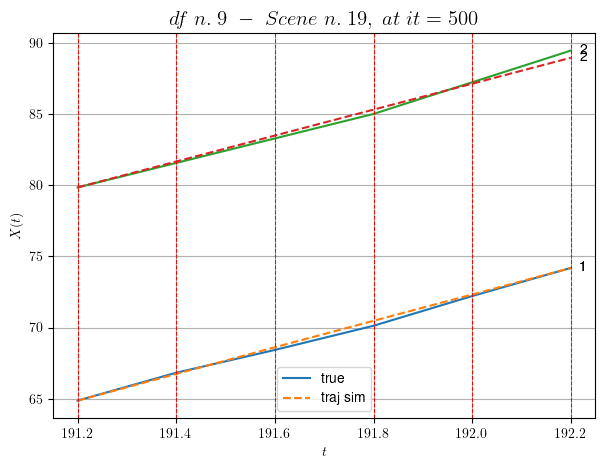

----------------------------------------------------------------------------------------------------
        For scene 14/22:
        * After LR finder: LR_NN=0.005 with mse=78.9495798193574 at it=24
        * v0 = 9.117095848783858
        * MSE = 0.04637863437575859
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.15/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [20.80,21.20]


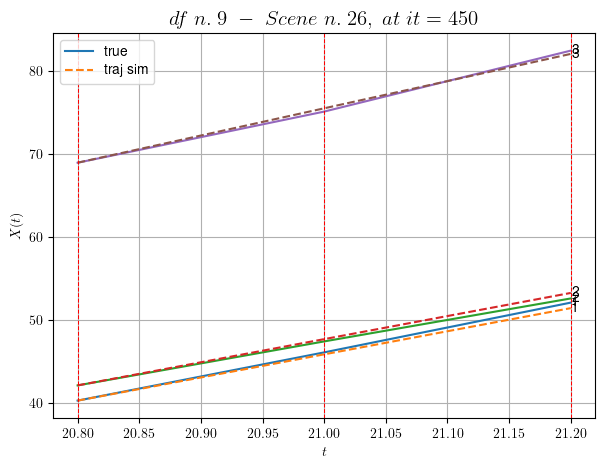

----------------------------------------------------------------------------------------------------
        For scene 15/22:
        * After LR finder: LR_NN=0.005 with mse=0.36346993754909157 at it=24
        * v0 = 32.73331102512615
        * MSE = 0.14722322621396303
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.16/22
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [82.40,84.00]


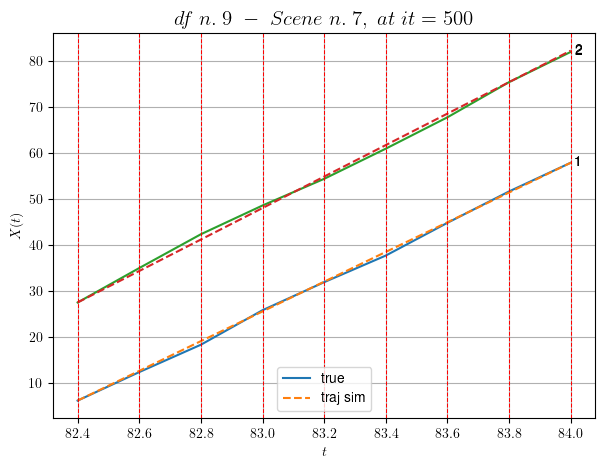

----------------------------------------------------------------------------------------------------
        For scene 16/22:
        * After LR finder: LR_NN=0.001 with mse=7.858812230540139 at it=24
        * v0 = 34.294801544759714
        * MSE = 0.266452378602145
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.17/22
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [197.60,198.80]


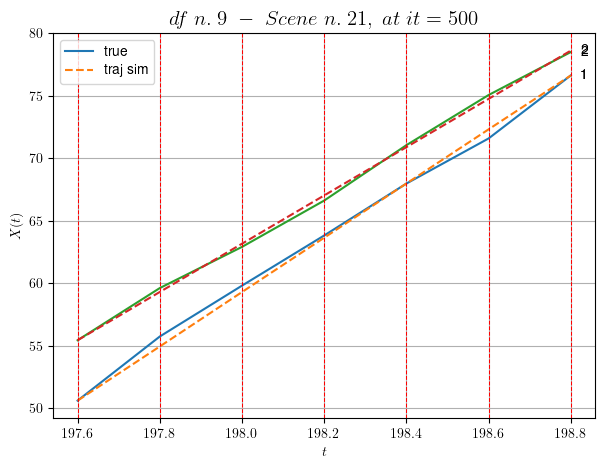

----------------------------------------------------------------------------------------------------
        For scene 17/22:
        * After LR finder: LR_NN=0.001 with mse=29.844350654401026 at it=24
        * v0 = 19.310295514409336
        * MSE = 0.13733863807938834
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.18/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [205.80,206.20]


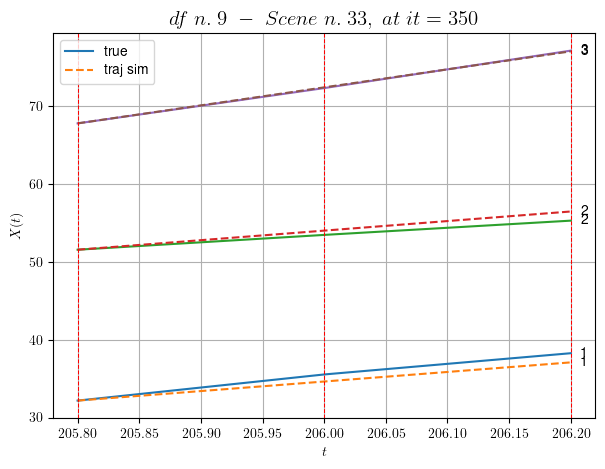

----------------------------------------------------------------------------------------------------
        For scene 18/22:
        * After LR finder: LR_NN=0.001 with mse=1.392633996258401 at it=24
        * v0 = 23.1587006104449
        * MSE = 0.43573560199364464
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.19/22
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [117.00,118.40]


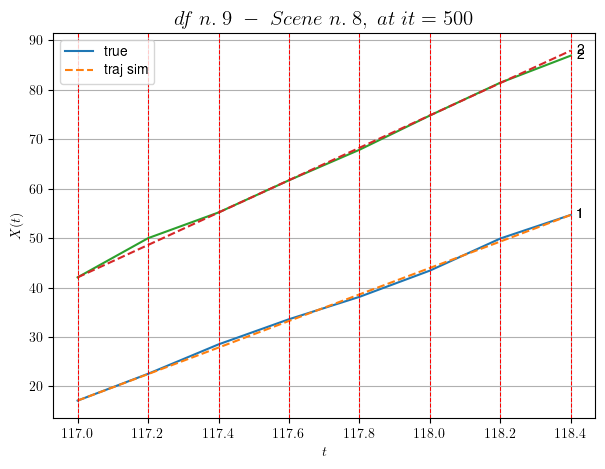

----------------------------------------------------------------------------------------------------
        For scene 19/22:
        * After LR finder: LR_NN=0.001 with mse=2.444486306805993 at it=24
        * v0 = 32.746751311389886
        * MSE = 0.26652716860885817
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.20/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [140.00,140.40]


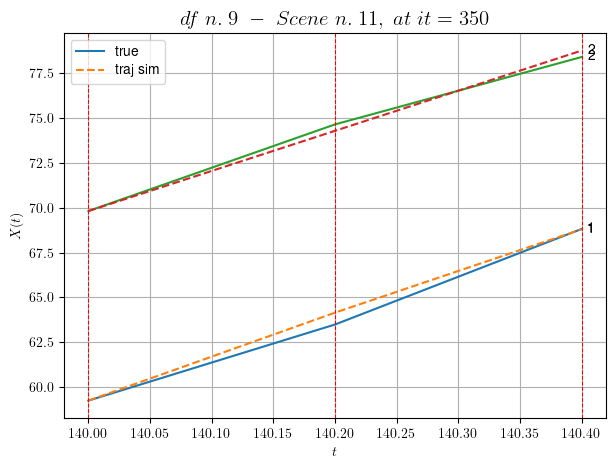

----------------------------------------------------------------------------------------------------
        For scene 20/22:
        * After LR finder: LR_NN=0.005 with mse=2.248829935769036 at it=24
        * v0 = 22.36518846468527
        * MSE = 0.11562374120632049
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.21/22
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [161.60,162.80]


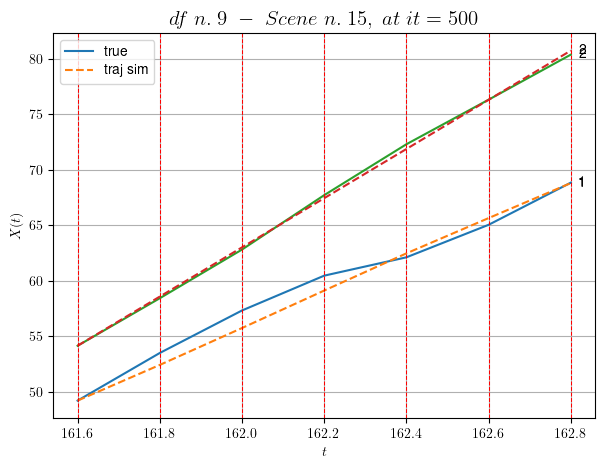

----------------------------------------------------------------------------------------------------
        For scene 21/22:
        * After LR finder: LR_NN=0.005 with mse=16.436210670493455 at it=24
        * v0 = 22.164023913692947
        * MSE = 0.4461382772243128
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.22/22
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [117.80,118.40]


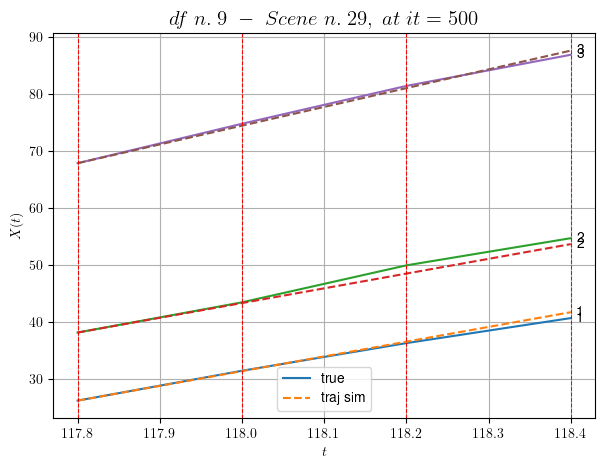

----------------------------------------------------------------------------------------------------
        For scene 22/22:
        * After LR finder: LR_NN=0.0001 with mse=8.041262465248101 at it=24
        * v0 = 32.94782563350092
        * MSE = 0.4276515279099707
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.6212122455720822
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (11 scenes)
DataFrame n.9. Scene n.1/11


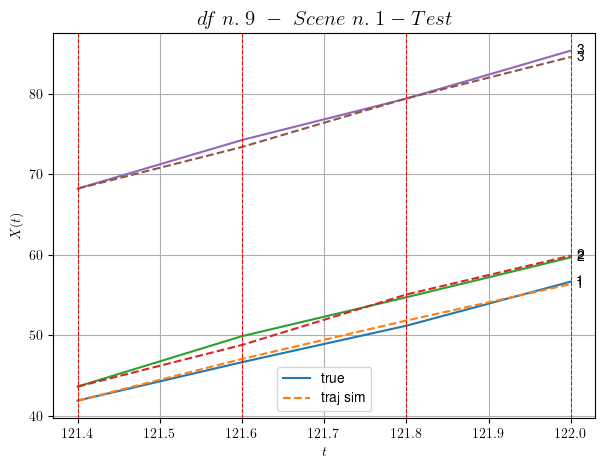

        For scene 1/11:
        * MSE = 0.28301646427311766
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/11


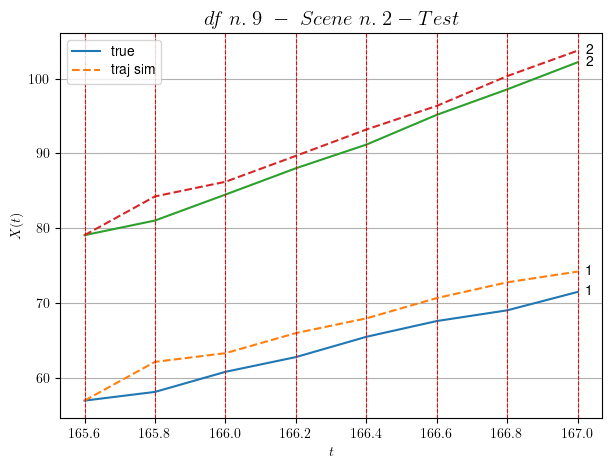

        For scene 2/11:
        * MSE = 6.035600513774794
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/11


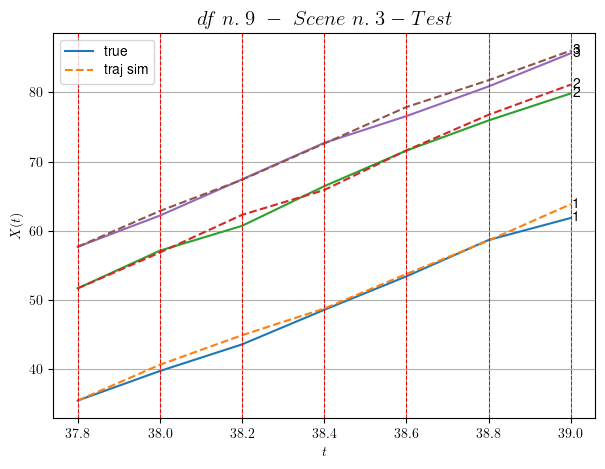

        For scene 3/11:
        * MSE = 0.713832413443631
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/11


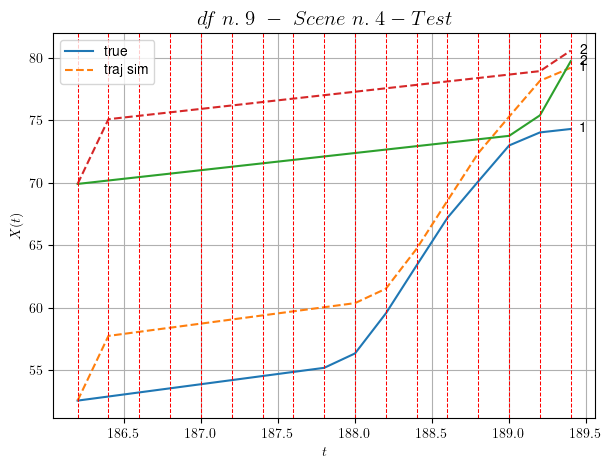

        For scene 4/11:
        * MSE = 18.01973032128734
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/11


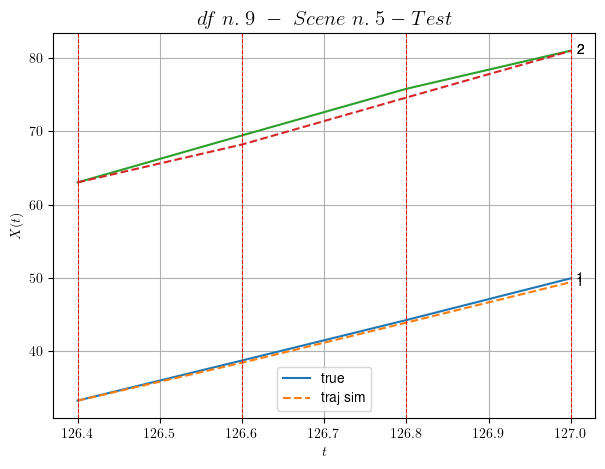

        For scene 5/11:
        * MSE = 0.43407422185551015
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/11


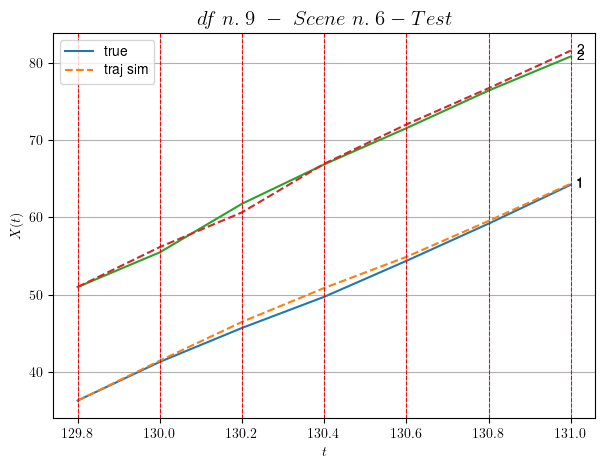

        For scene 6/11:
        * MSE = 0.3548937156539531
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/11


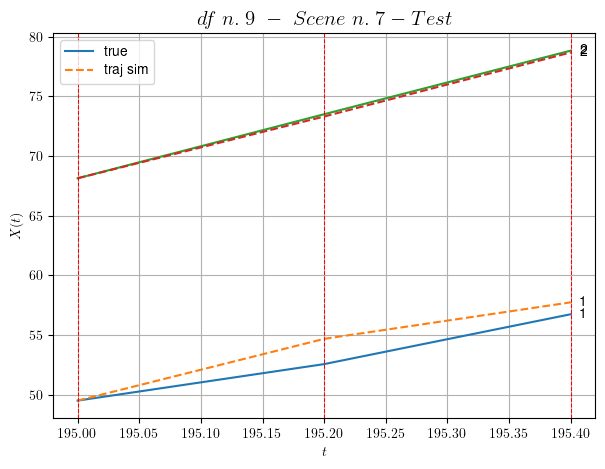

        For scene 7/11:
        * MSE = 0.9215416044166549
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/11


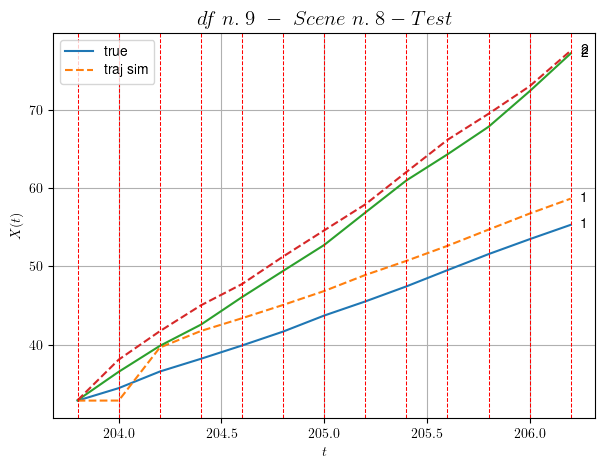

        For scene 8/11:
        * MSE = 5.834643042967551
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/11


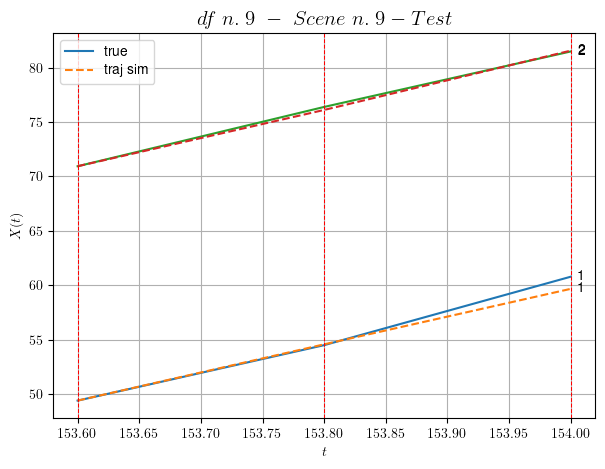

        For scene 9/11:
        * MSE = 0.22222168310114793
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/11


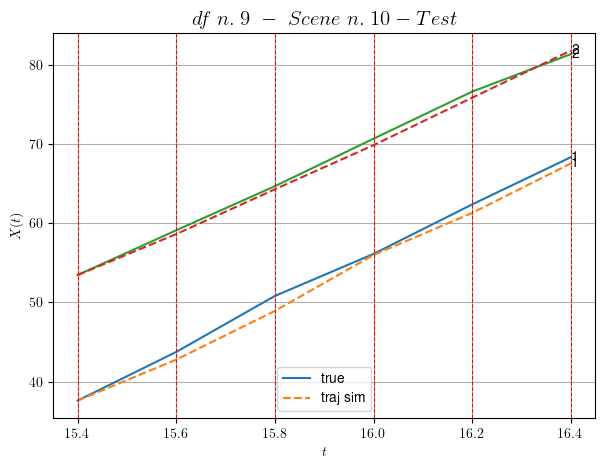

        For scene 10/11:
        * MSE = 0.6797053906177717
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/11


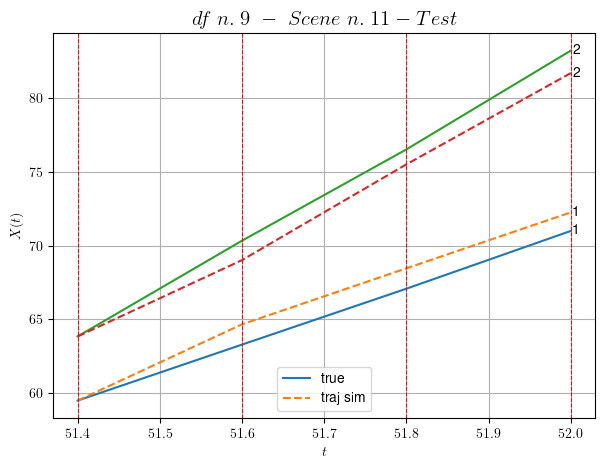

        For scene 11/11:
        * MSE = 1.3093976095388726
----------------------------------------------------------------------------------------------------


MSE test: 3.1644233619027577

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6212122455720822
          * MSE test: 3.1644233619027577
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 10/10 dfs.
In DataFrame n.10 we have 74 scenes.
    To train the model we use 49 scenes, the remaining 25 to test the model.

Training step. (49 scenes)
DataFrame n.10. Scene n.1/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [81.72,82.52]


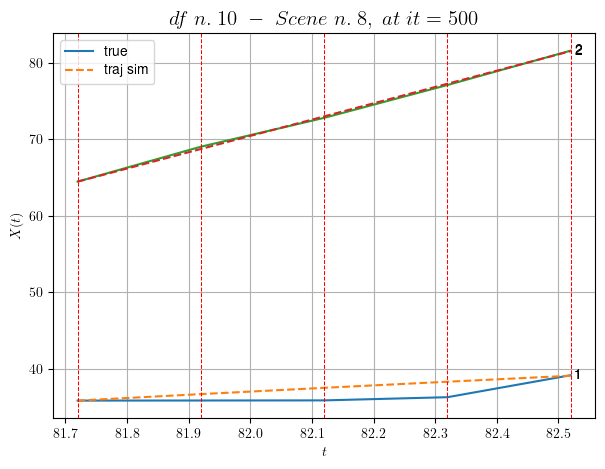

----------------------------------------------------------------------------------------------------
        For scene 1/49:
        * After LR finder: LR_NN=0.005 with mse=9.616854181263623 at it=24
        * v0 = 21.36406302671324
        * MSE = 0.754635702026962
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [194.52,195.12]


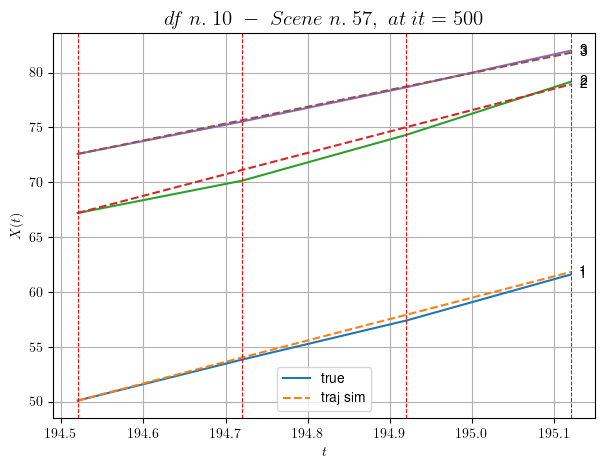

----------------------------------------------------------------------------------------------------
        For scene 2/49:
        * After LR finder: LR_NN=0.001 with mse=10.610789970425772 at it=24
        * v0 = 15.385046662987012
        * MSE = 0.16087817405257746
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [450.52,452.12]


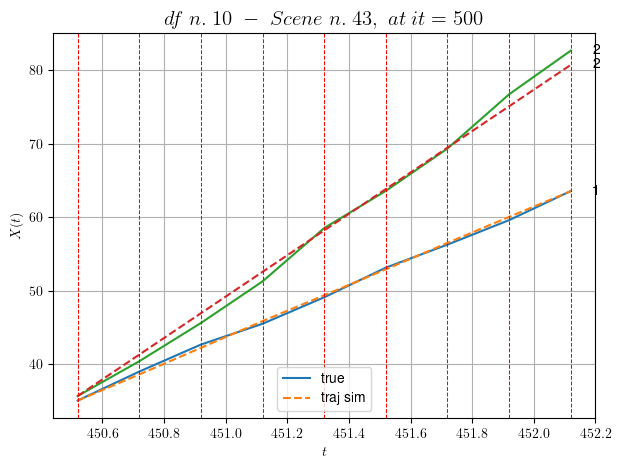

----------------------------------------------------------------------------------------------------
        For scene 3/49:
        * After LR finder: LR_NN=0.01 with mse=1.462696396718052 at it=24
        * v0 = 28.147396988326644
        * MSE = 0.5937240069723055
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [305.72,306.12]


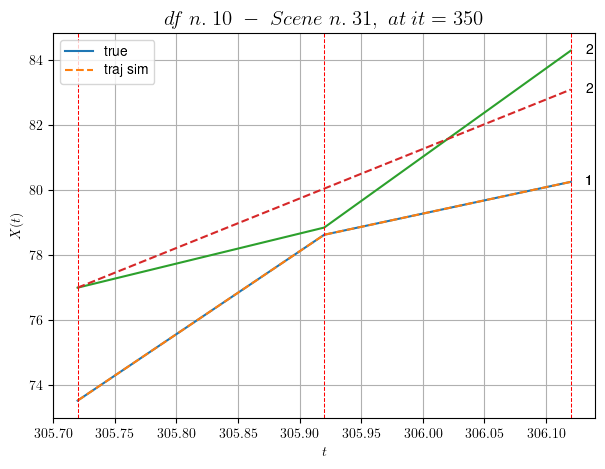

----------------------------------------------------------------------------------------------------
        For scene 4/49:
        * After LR finder: LR_NN=0.005 with mse=7.337476063766869 at it=24
        * v0 = 15.22860743168353
        * MSE = 0.43019415885761714
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [502.92,504.52]


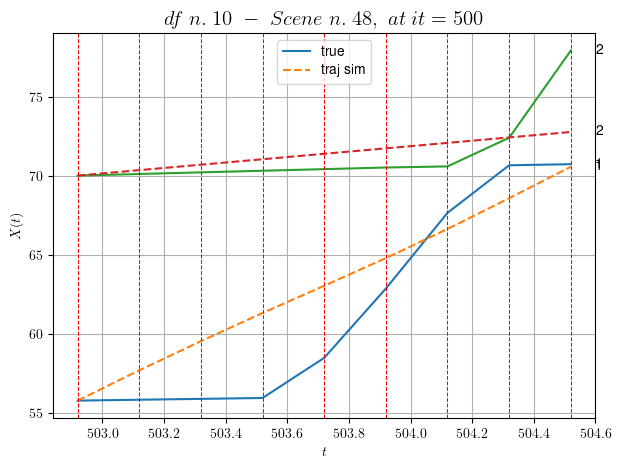

----------------------------------------------------------------------------------------------------
        For scene 5/49:
        * After LR finder: LR_NN=0.005 with mse=356.2514062148828 at it=24
        * v0 = 1.7269359387544656
        * MSE = 5.554093547790238
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [569.72,570.72]


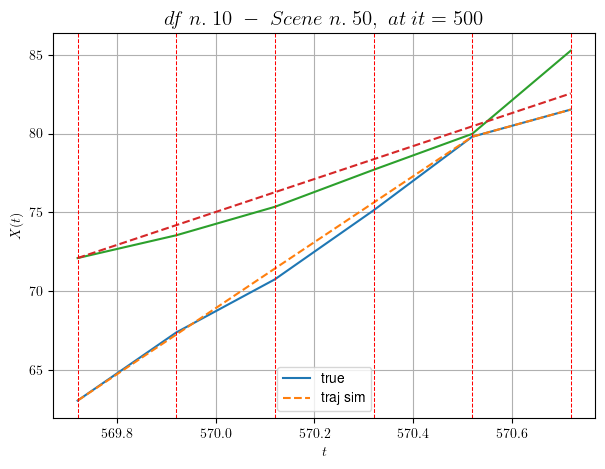

----------------------------------------------------------------------------------------------------
        For scene 6/49:
        * After LR finder: LR_NN=0.0005 with mse=91.53347449047747 at it=24
        * v0 = 10.43973796346764
        * MSE = 0.7639727031651854
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/49
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [201.32,203.12]


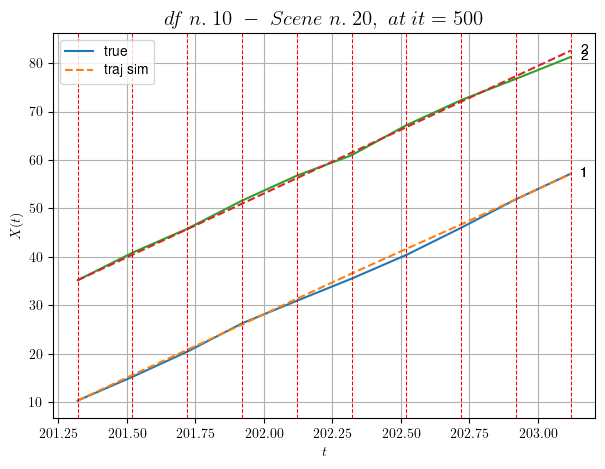

----------------------------------------------------------------------------------------------------
        For scene 7/49:
        * After LR finder: LR_NN=0.01 with mse=8.699806667286591 at it=24
        * v0 = 26.32009816116085
        * MSE = 0.2953776679615035
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.8/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [236.52,237.12]


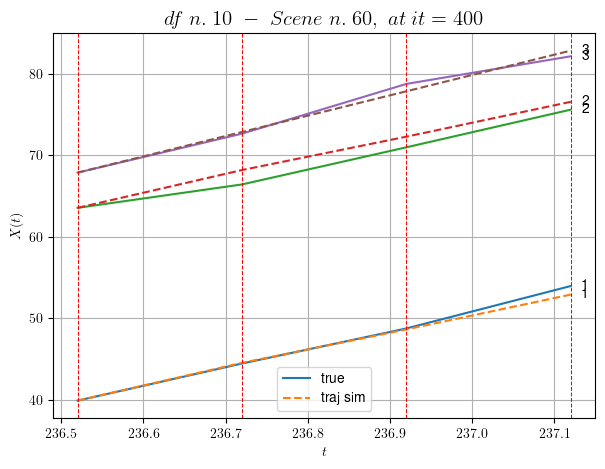

----------------------------------------------------------------------------------------------------
        For scene 8/49:
        * After LR finder: LR_NN=0.01 with mse=2.0209025417817164 at it=24
        * v0 = 24.94426727715694
        * MSE = 0.6829082496660659
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.9/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [275.92,277.12]


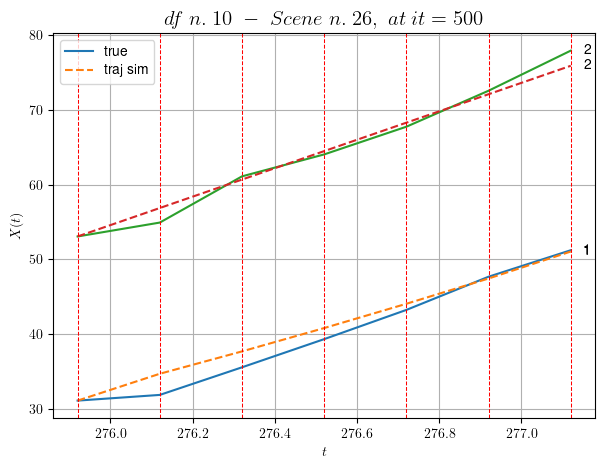

----------------------------------------------------------------------------------------------------
        For scene 9/49:
        * After LR finder: LR_NN=0.01 with mse=29.64239492223659 at it=24
        * v0 = 19.05141022652642
        * MSE = 1.4894159573570398
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.10/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [414.72,415.72]


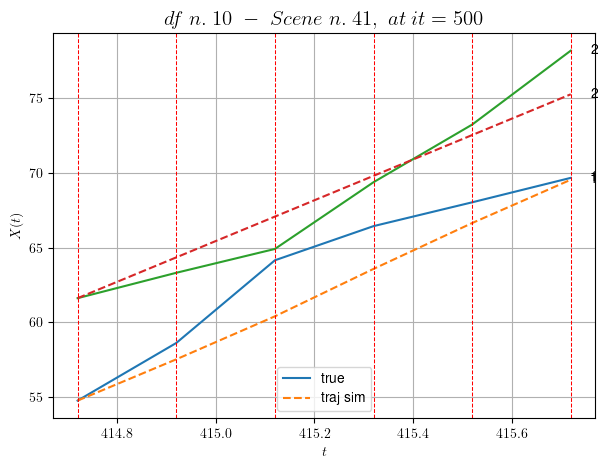

----------------------------------------------------------------------------------------------------
        For scene 10/49:
        * After LR finder: LR_NN=0.005 with mse=47.171603372966544 at it=24
        * v0 = 13.666087163341324
        * MSE = 3.3730687404907447
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.11/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [116.72,118.32]


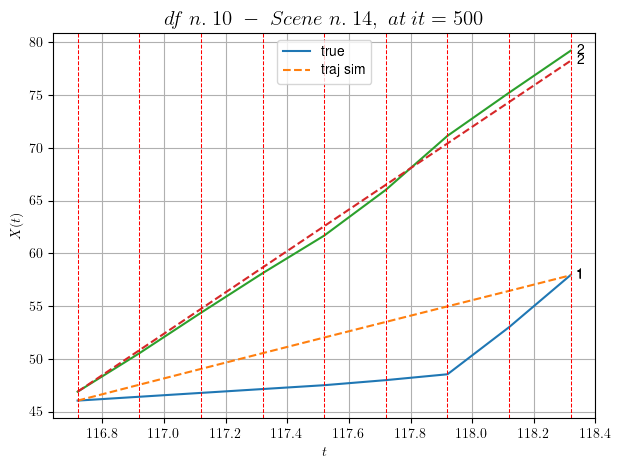

----------------------------------------------------------------------------------------------------
        For scene 11/49:
        * After LR finder: LR_NN=0.001 with mse=51.17754448520253 at it=24
        * v0 = 19.612707397568297
        * MSE = 6.938360270947554
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.12/49
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [71.72,73.12]


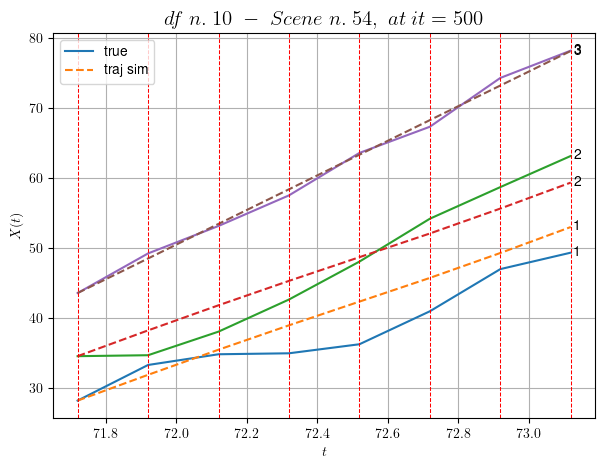

----------------------------------------------------------------------------------------------------
        For scene 12/49:
        * After LR finder: LR_NN=0.005 with mse=10.48659483190457 at it=24
        * v0 = 24.696180100224414
        * MSE = 6.530028932941761
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.13/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [41.32,41.92]


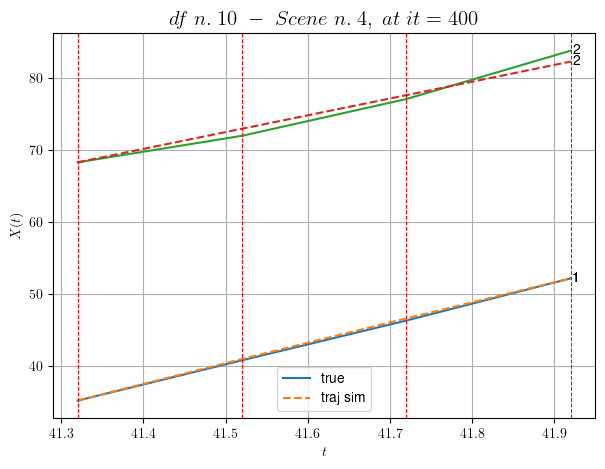

----------------------------------------------------------------------------------------------------
        For scene 13/49:
        * After LR finder: LR_NN=0.01 with mse=2.798726229223123 at it=24
        * v0 = 23.270817814815217
        * MSE = 0.4122848670160102
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.14/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [182.72,183.52]


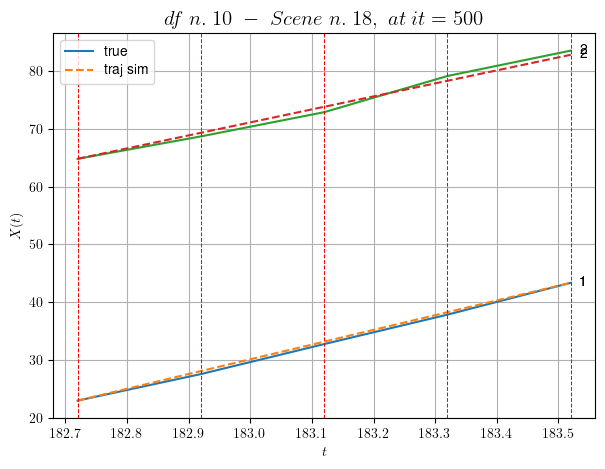

----------------------------------------------------------------------------------------------------
        For scene 14/49:
        * After LR finder: LR_NN=0.001 with mse=6.167978117227665 at it=24
        * v0 = 22.502260179113897
        * MSE = 0.2825697695665432
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.15/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [410.32,410.72]


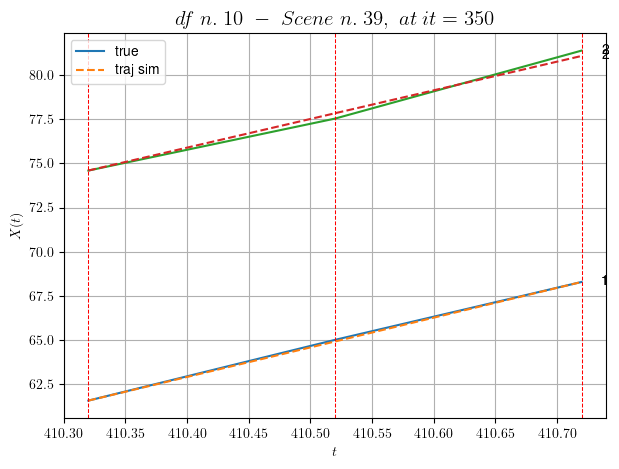

----------------------------------------------------------------------------------------------------
        For scene 15/49:
        * After LR finder: LR_NN=0.005 with mse=6.057546116513776 at it=24
        * v0 = 16.248522136796733
        * MSE = 0.02915105008240936
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.16/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [85.72,87.32]


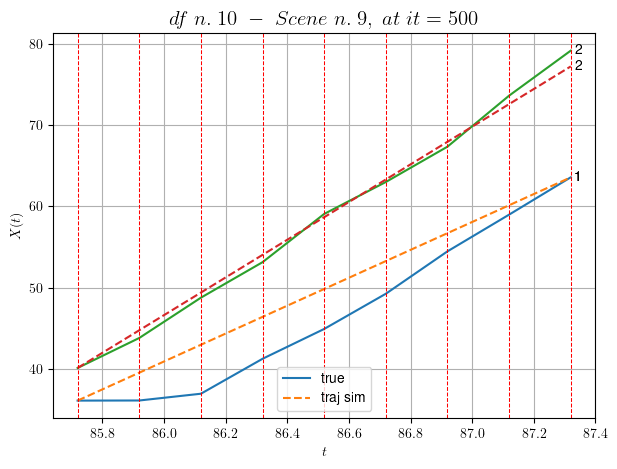

----------------------------------------------------------------------------------------------------
        For scene 16/49:
        * After LR finder: LR_NN=5e-05 with mse=21.07963638338664 at it=24
        * v0 = 23.19995130380224
        * MSE = 6.854060768277776
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.17/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [210.12,210.52]


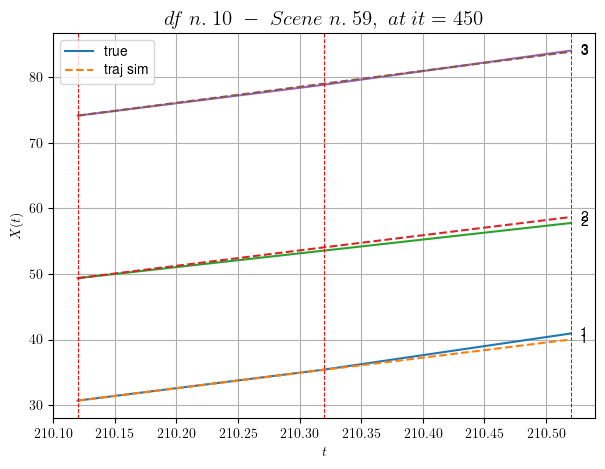

----------------------------------------------------------------------------------------------------
        For scene 17/49:
        * After LR finder: LR_NN=0.005 with mse=0.8811167606129948 at it=24
        * v0 = 24.38290054697972
        * MSE = 0.21857295587567985
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.18/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [64.92,65.92]


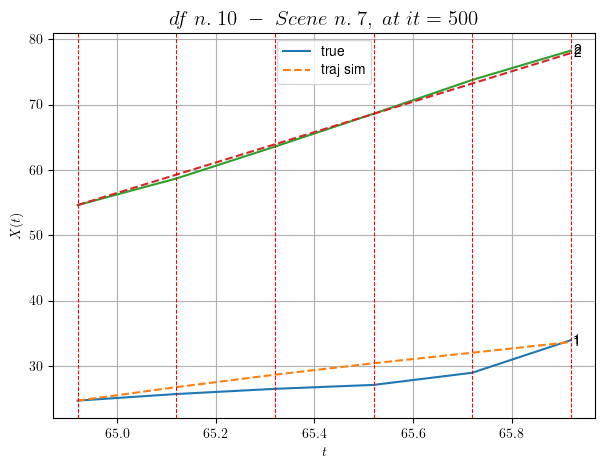

----------------------------------------------------------------------------------------------------
        For scene 18/49:
        * After LR finder: LR_NN=0.01 with mse=10.137724100685087 at it=24
        * v0 = 23.262500294243573
        * MSE = 2.1788764040091992
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.19/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [401.52,402.32]


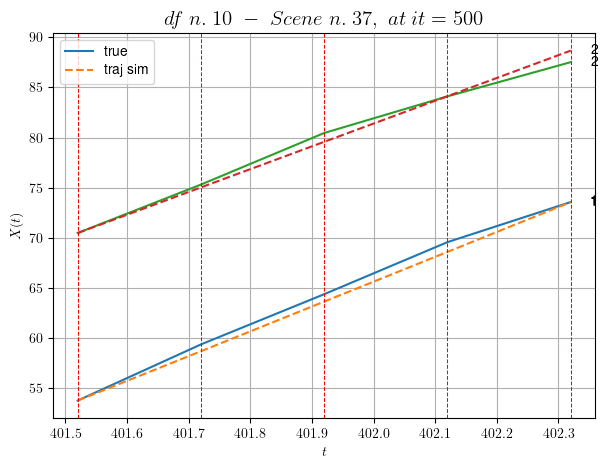

----------------------------------------------------------------------------------------------------
        For scene 19/49:
        * After LR finder: LR_NN=0.001 with mse=15.912550061343737 at it=24
        * v0 = 22.73262095038679
        * MSE = 0.41170852772077016
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.20/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [376.92,377.52]


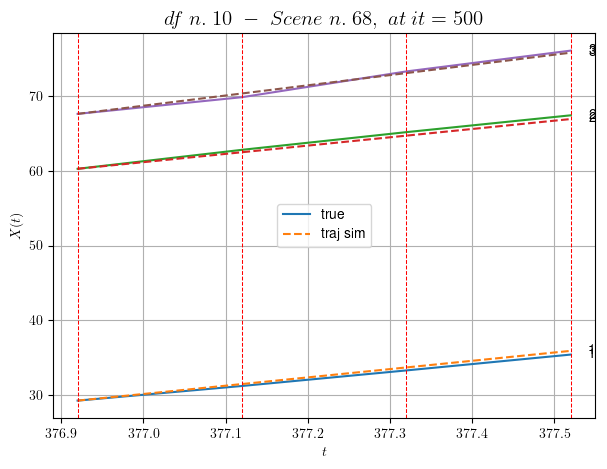

----------------------------------------------------------------------------------------------------
        For scene 20/49:
        * After LR finder: LR_NN=0.005 with mse=12.203306048381394 at it=24
        * v0 = 13.629666231204773
        * MSE = 0.11421822731298616
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.21/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [120.92,121.52]


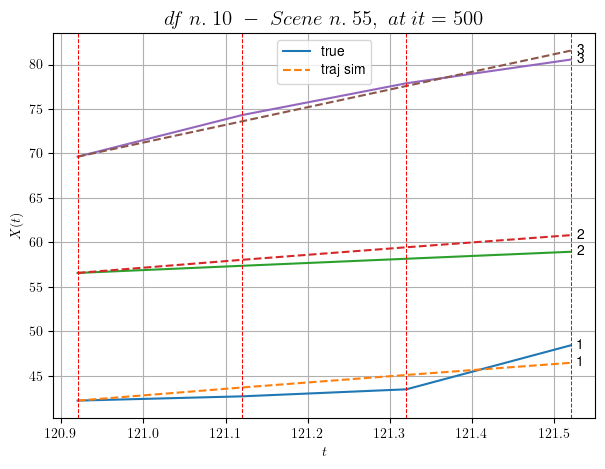

----------------------------------------------------------------------------------------------------
        For scene 21/49:
        * After LR finder: LR_NN=0.005 with mse=6.433467789294281 at it=24
        * v0 = 19.87543626344988
        * MSE = 1.2163558978881024
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.22/49
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [496.52,499.32]


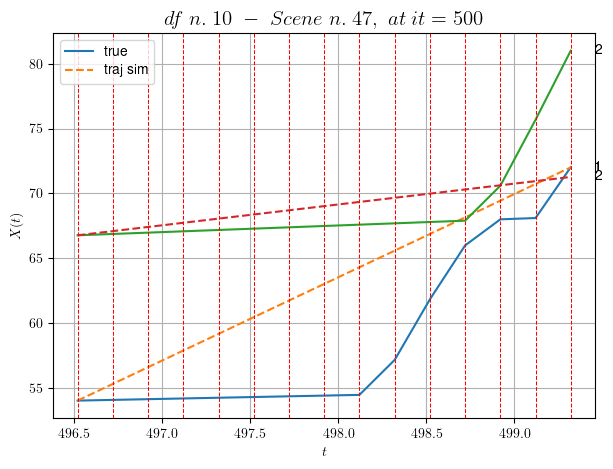

----------------------------------------------------------------------------------------------------
        For scene 22/49:
        * After LR finder: LR_NN=0.0005 with mse=1071.8955425525273 at it=24
        * v0 = 1.6060119985537775
        * MSE = 18.32786679304008
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.23/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [342.92,343.32]


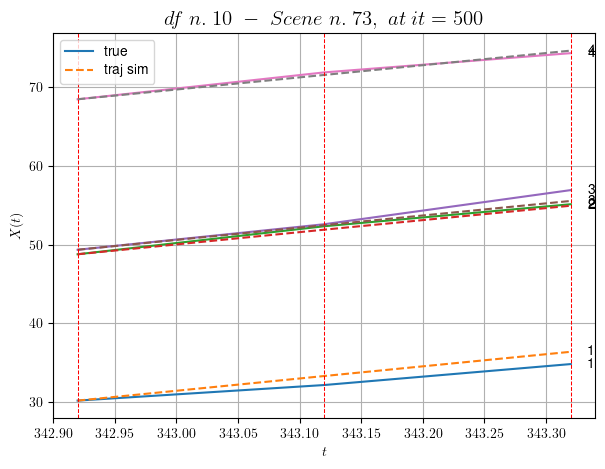

----------------------------------------------------------------------------------------------------
        For scene 23/49:
        * After LR finder: LR_NN=0.005 with mse=4.168342525645345 at it=24
        * v0 = 15.471537794287931
        * MSE = 0.5084956303026278
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.24/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [139.92,140.32]


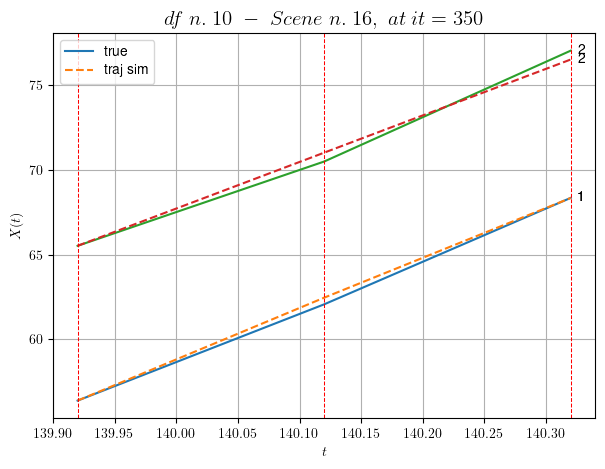

----------------------------------------------------------------------------------------------------
        For scene 24/49:
        * After LR finder: LR_NN=0.005 with mse=0.2523404682965105 at it=24
        * v0 = 27.422660991971266
        * MSE = 0.11148198126576511
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.25/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [282.72,283.52]


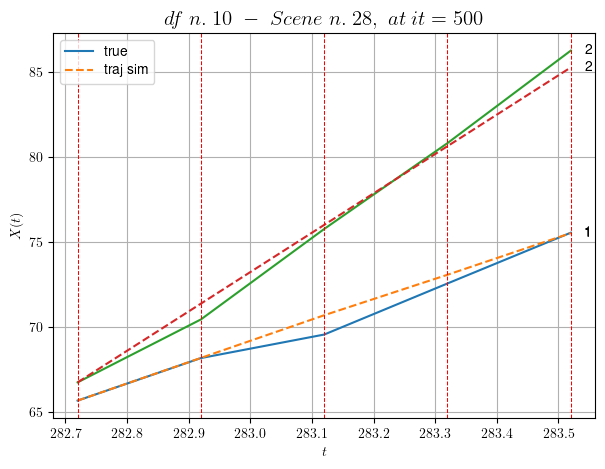

----------------------------------------------------------------------------------------------------
        For scene 25/49:
        * After LR finder: LR_NN=0.005 with mse=5.025753021049008 at it=24
        * v0 = 23.180355370996622
        * MSE = 0.33902424966491007
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.26/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [438.12,438.52]


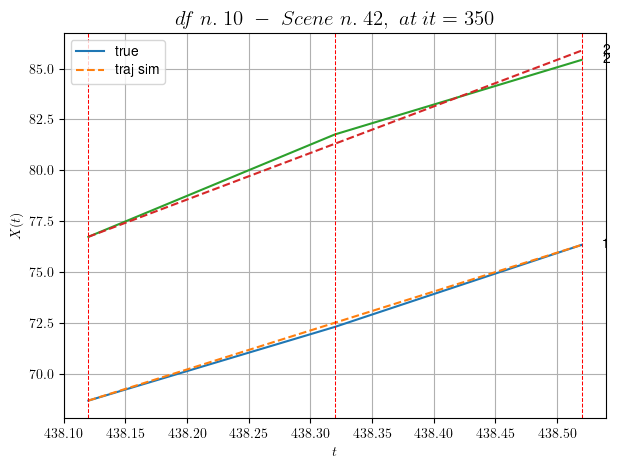

----------------------------------------------------------------------------------------------------
        For scene 26/49:
        * After LR finder: LR_NN=0.0005 with mse=13.877270310204054 at it=24
        * v0 = 22.86952718339145
        * MSE = 0.07653727434506112
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.27/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [279.52,279.92]


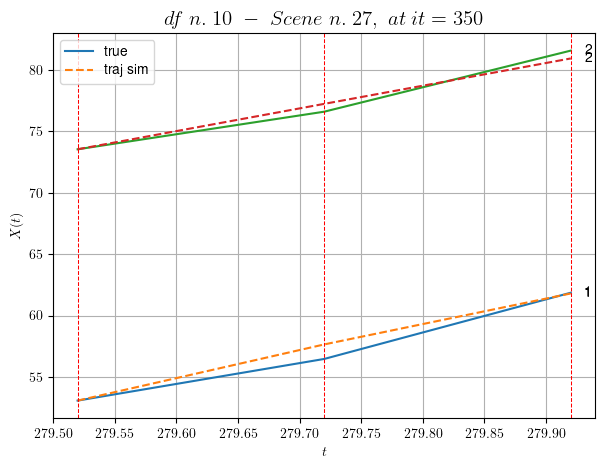

----------------------------------------------------------------------------------------------------
        For scene 27/49:
        * After LR finder: LR_NN=0.005 with mse=4.271591828253793 at it=24
        * v0 = 18.485445285461903
        * MSE = 0.3671854457777432
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.28/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [541.32,542.52]


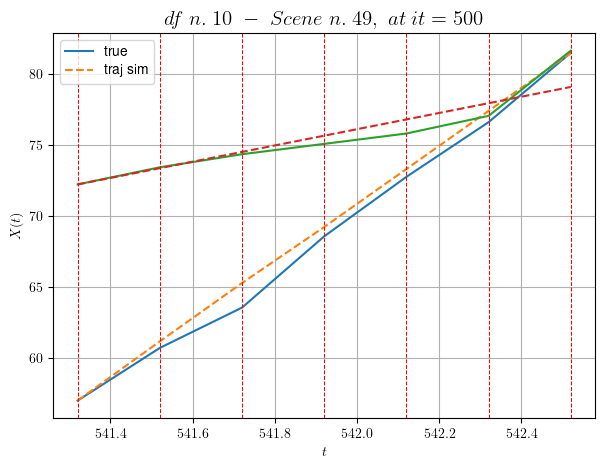

----------------------------------------------------------------------------------------------------
        For scene 28/49:
        * After LR finder: LR_NN=0.005 with mse=150.6528427774564 at it=24
        * v0 = 5.72114725084662
        * MSE = 0.936083987647066
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.29/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [264.12,264.92]


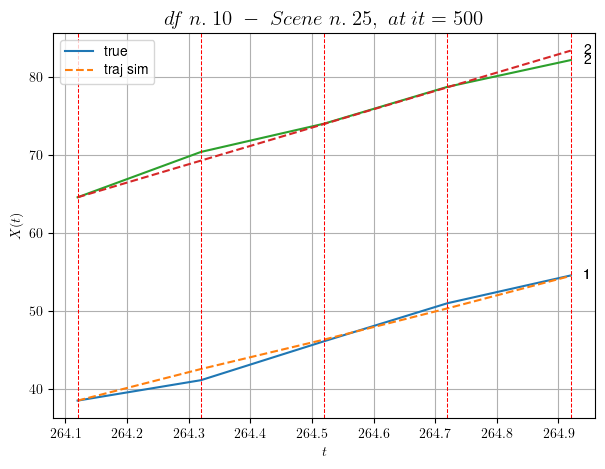

----------------------------------------------------------------------------------------------------
        For scene 29/49:
        * After LR finder: LR_NN=0.005 with mse=6.614254015231991 at it=24
        * v0 = 23.452291910892548
        * MSE = 0.522163446212218
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.30/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [321.12,321.92]


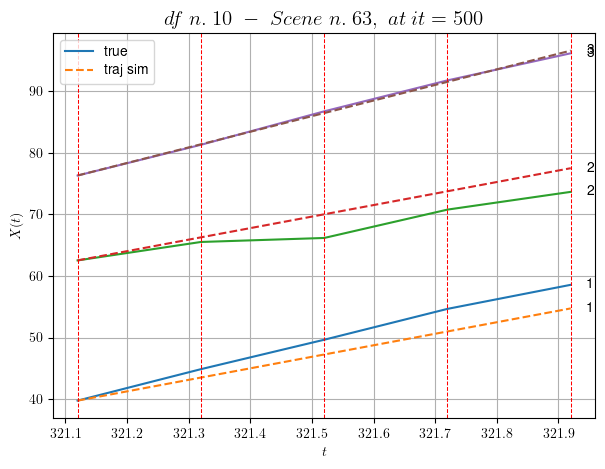

----------------------------------------------------------------------------------------------------
        For scene 30/49:
        * After LR finder: LR_NN=5e-05 with mse=5.335986425987552 at it=24
        * v0 = 25.328428635552836
        * MSE = 4.992736748591917
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.31/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [370.92,372.12]


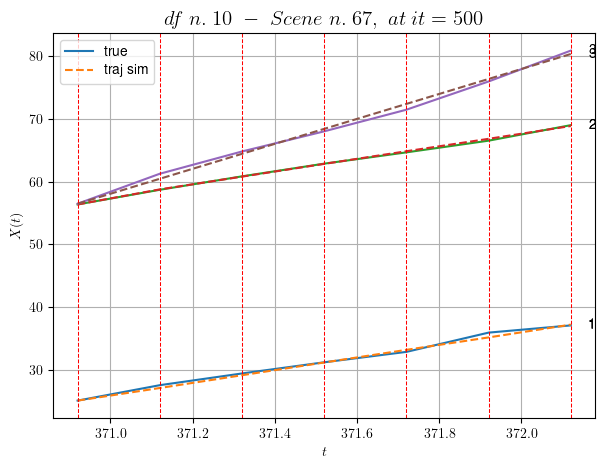

----------------------------------------------------------------------------------------------------
        For scene 31/49:
        * After LR finder: LR_NN=0.01 with mse=18.272552945162744 at it=24
        * v0 = 19.892120453787335
        * MSE = 0.16069036319597824
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.32/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [103.72,104.52]


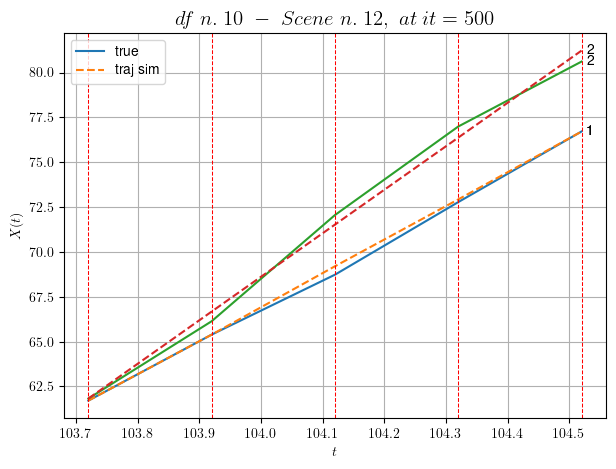

----------------------------------------------------------------------------------------------------
        For scene 32/49:
        * After LR finder: LR_NN=0.005 with mse=4.144090003088177 at it=24
        * v0 = 24.24265454583431
        * MSE = 0.15583318618494496
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.33/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [316.12,316.92]


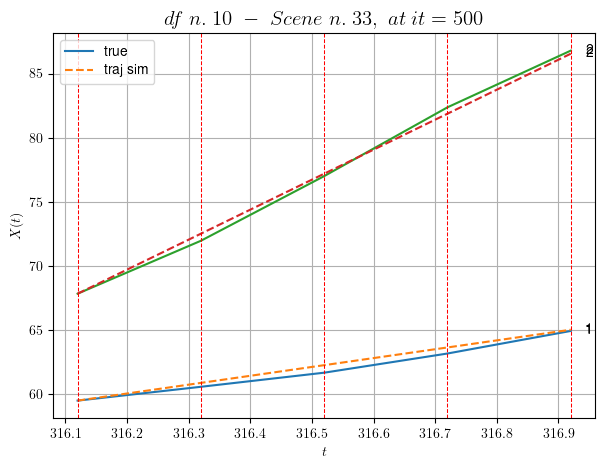

----------------------------------------------------------------------------------------------------
        For scene 33/49:
        * After LR finder: LR_NN=0.0001 with mse=4.981866178319216 at it=24
        * v0 = 23.40156520227089
        * MSE = 0.13157184601633395
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.34/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [483.92,484.32]


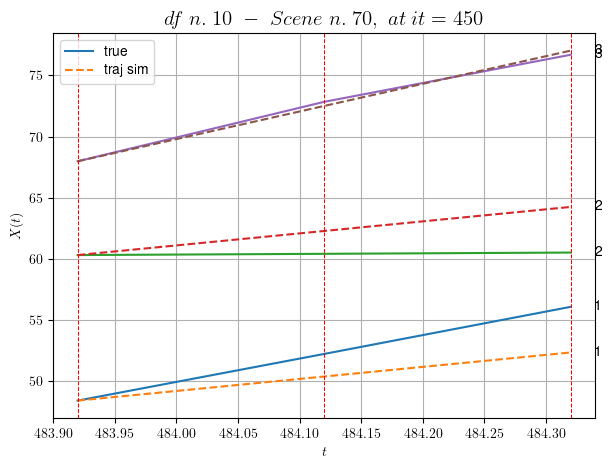

----------------------------------------------------------------------------------------------------
        For scene 34/49:
        * After LR finder: LR_NN=0.01 with mse=5.2072352398229205 at it=24
        * v0 = 22.618918416338182
        * MSE = 3.886108057649048
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.35/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [337.72,338.32]


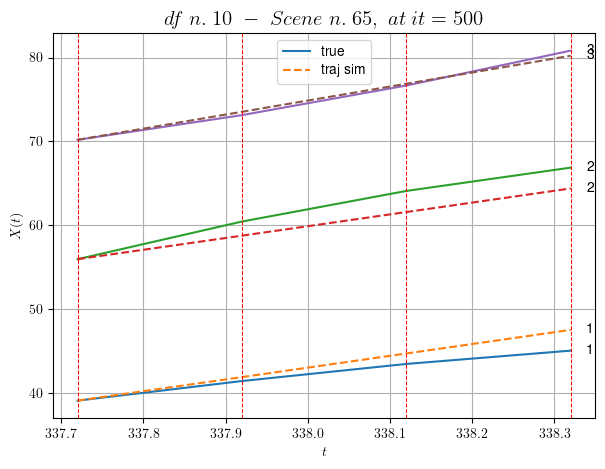

----------------------------------------------------------------------------------------------------
        For scene 35/49:
        * After LR finder: LR_NN=0.0005 with mse=24.872771310701683 at it=24
        * v0 = 16.73844444980682
        * MSE = 1.984719703423087
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.36/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [403.52,405.12]


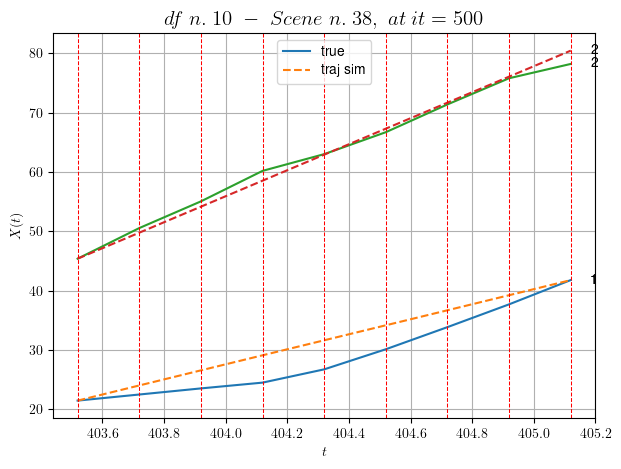

----------------------------------------------------------------------------------------------------
        For scene 36/49:
        * After LR finder: LR_NN=0.0005 with mse=34.7058000168166 at it=24
        * v0 = 21.916705677642607
        * MSE = 5.168385864839927
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.37/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [303.52,304.32]


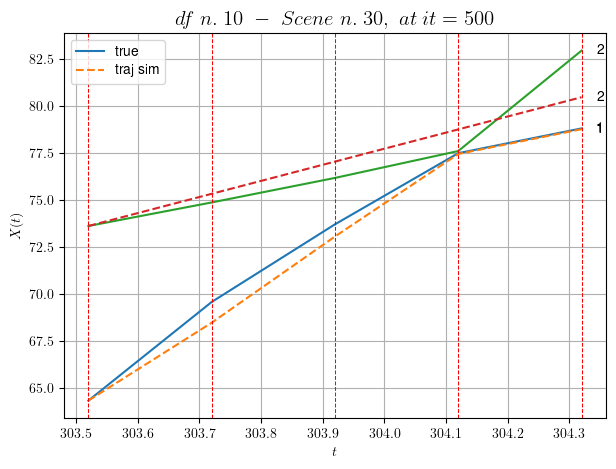

----------------------------------------------------------------------------------------------------
        For scene 37/49:
        * After LR finder: LR_NN=0.01 with mse=52.525166495973416 at it=24
        * v0 = 8.561224404570222
        * MSE = 0.9980129575857446
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.38/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [473.52,474.72]


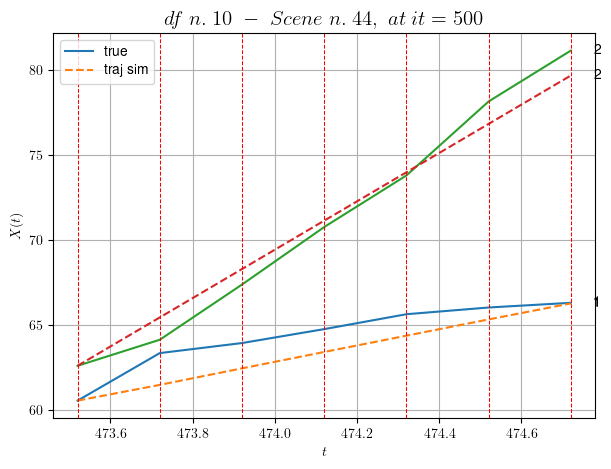

----------------------------------------------------------------------------------------------------
        For scene 38/49:
        * After LR finder: LR_NN=0.005 with mse=61.08497271099026 at it=24
        * v0 = 14.20936957568644
        * MSE = 1.1088931872665837
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.39/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [433.52,434.12]


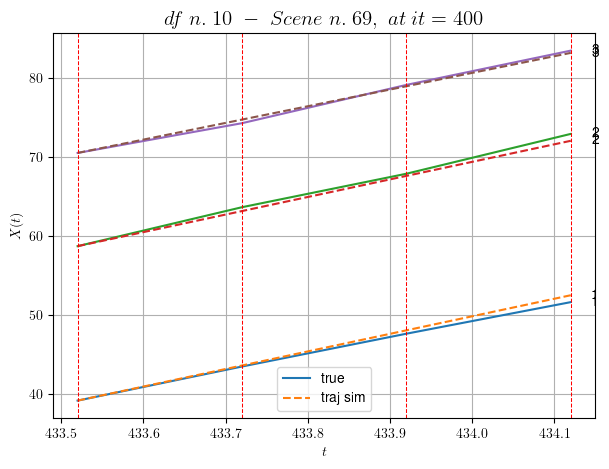

----------------------------------------------------------------------------------------------------
        For scene 39/49:
        * After LR finder: LR_NN=0.0005 with mse=8.39283733450476 at it=24
        * v0 = 21.09569000882137
        * MSE = 0.1925812142201104
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.40/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [24.52,25.52]


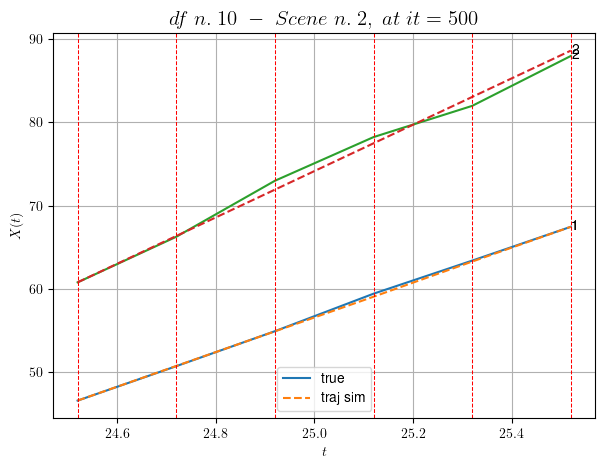

----------------------------------------------------------------------------------------------------
        For scene 40/49:
        * After LR finder: LR_NN=0.005 with mse=1.371995190249397 at it=24
        * v0 = 27.846729228086406
        * MSE = 0.28383778667854753
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.41/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [25.72,26.12]


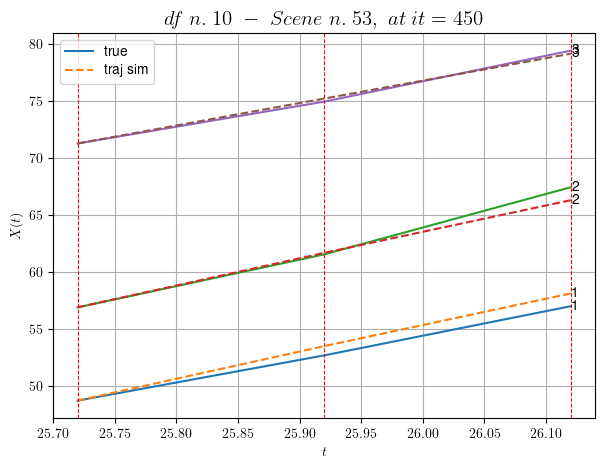

----------------------------------------------------------------------------------------------------
        For scene 41/49:
        * After LR finder: LR_NN=0.005 with mse=2.6131662033168546 at it=24
        * v0 = 19.70878564212889
        * MSE = 0.3737124859913444
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.42/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [214.72,215.32]


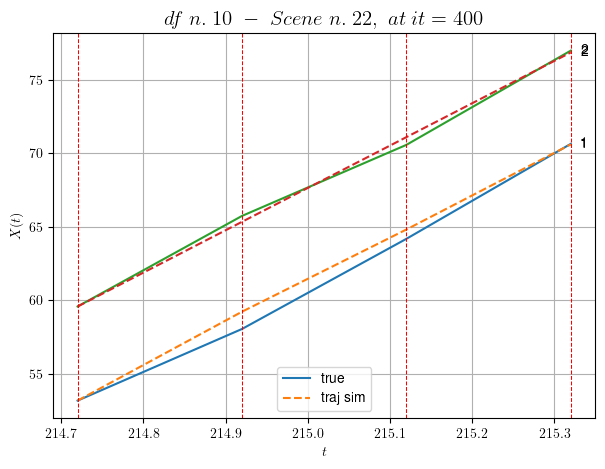

----------------------------------------------------------------------------------------------------
        For scene 42/49:
        * After LR finder: LR_NN=0.005 with mse=0.428369792219511 at it=24
        * v0 = 28.84411723302218
        * MSE = 0.2803551850536576
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.43/49
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [34.92,36.32]


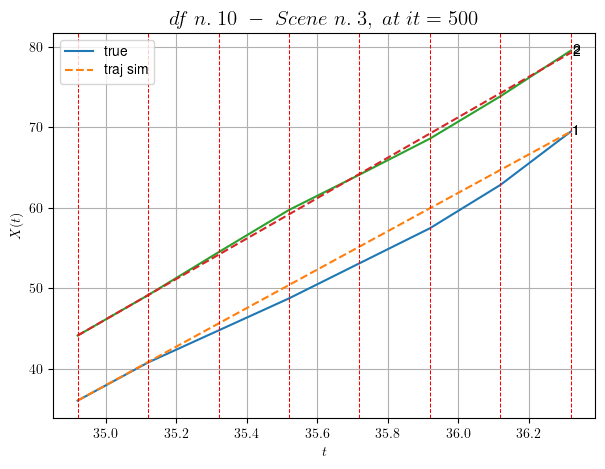

----------------------------------------------------------------------------------------------------
        For scene 43/49:
        * After LR finder: LR_NN=0.0005 with mse=9.276040272826728 at it=24
        * v0 = 25.10228996222758
        * MSE = 1.1557054593377192
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.44/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [235.52,235.92]


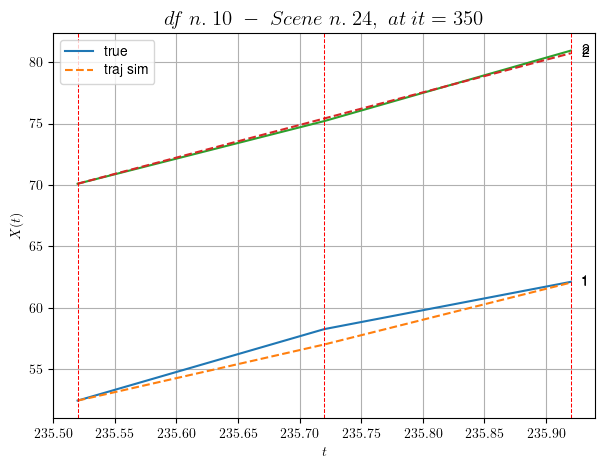

----------------------------------------------------------------------------------------------------
        For scene 44/49:
        * After LR finder: LR_NN=0.005 with mse=0.6570652139233066 at it=24
        * v0 = 26.569531431549414
        * MSE = 0.2765780363972237
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.45/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [209.32,210.52]


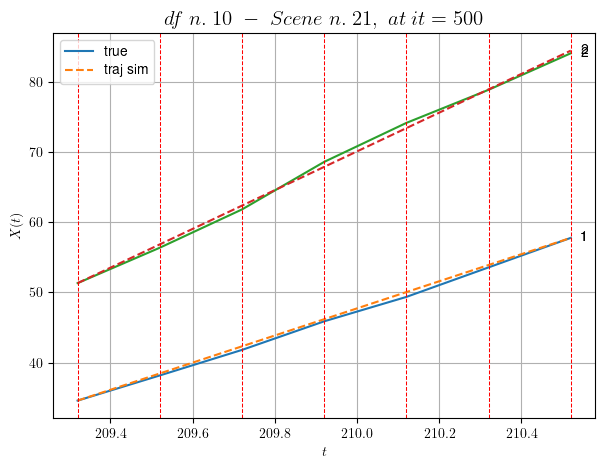

----------------------------------------------------------------------------------------------------
        For scene 45/49:
        * After LR finder: LR_NN=0.0005 with mse=1.8769607788946128 at it=24
        * v0 = 27.594562747146785
        * MSE = 0.19548691404723256
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.46/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [237.72,238.12]


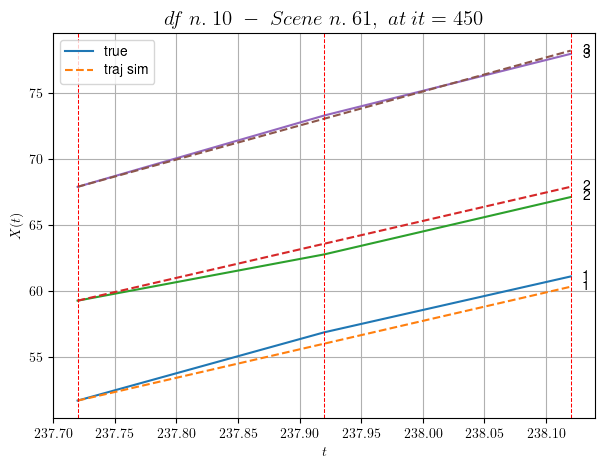

----------------------------------------------------------------------------------------------------
        For scene 46/49:
        * After LR finder: LR_NN=0.001 with mse=1.9885364377001364 at it=24
        * v0 = 25.83259327321963
        * MSE = 0.30316576459868166
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.47/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [202.52,203.12]


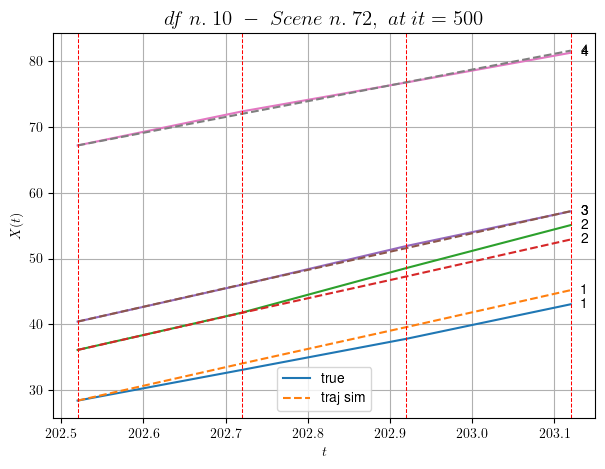

----------------------------------------------------------------------------------------------------
        For scene 47/49:
        * After LR finder: LR_NN=0.005 with mse=2.305379210591135 at it=24
        * v0 = 24.014144704150613
        * MSE = 0.9659821541545843
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.48/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [118.92,119.32]


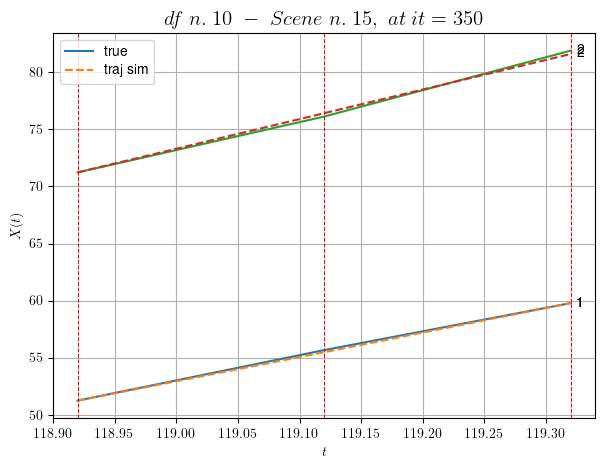

----------------------------------------------------------------------------------------------------
        For scene 48/49:
        * After LR finder: LR_NN=0.005 with mse=0.4976082406036478 at it=24
        * v0 = 25.96953448222358
        * MSE = 0.03206147972986361
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.49/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [578.92,580.52]


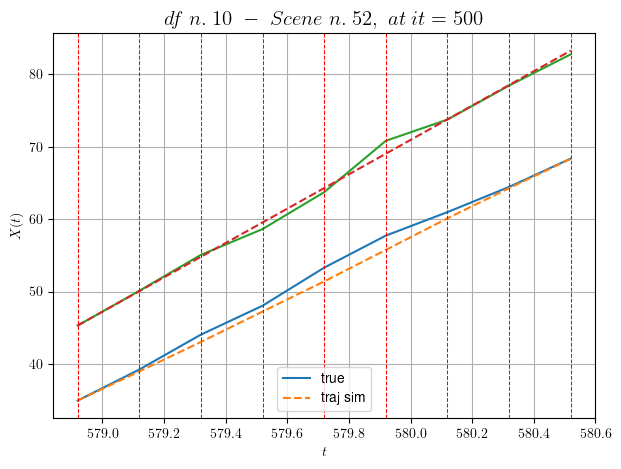

----------------------------------------------------------------------------------------------------
        For scene 49/49:
        * After LR finder: LR_NN=0.01 with mse=18.44021312106263 at it=24
        * v0 = 23.728017954300544
        * MSE = 0.6429074807782866
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.7094412502852105
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (25 scenes)
DataFrame n.10. Scene n.1/25


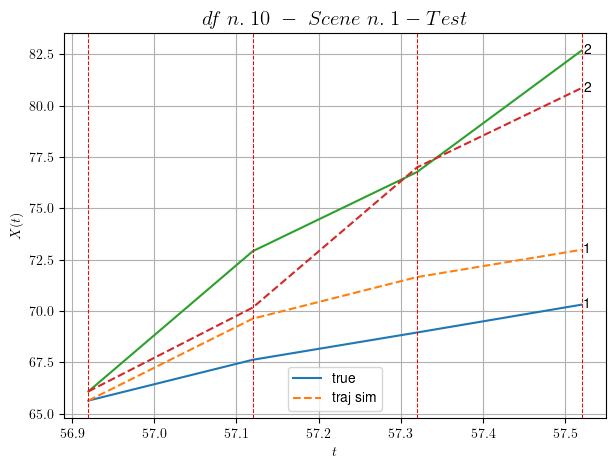

        For scene 1/25:
        * MSE = 3.670514665625097
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/25


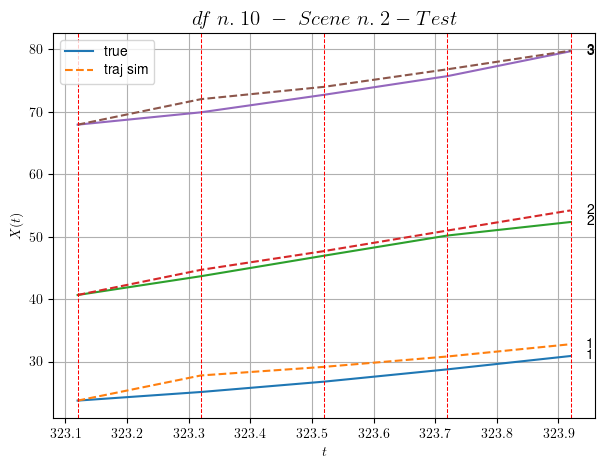

        For scene 2/25:
        * MSE = 2.225934130211613
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/25


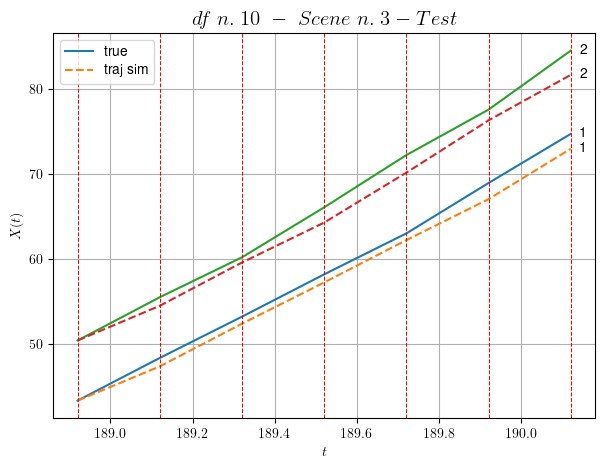

        For scene 3/25:
        * MSE = 2.0359149515055623
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/25


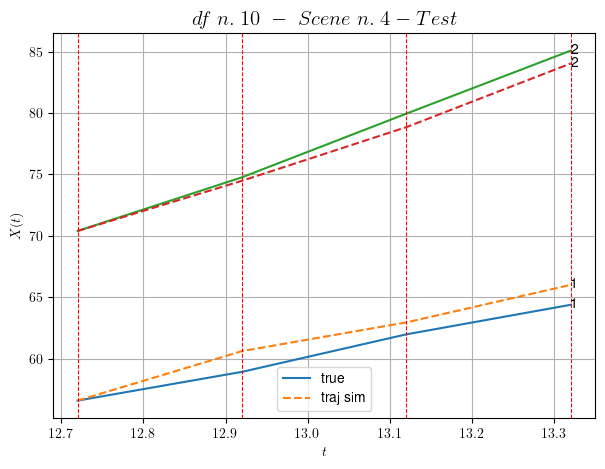

        For scene 4/25:
        * MSE = 1.1012153956621666
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/25


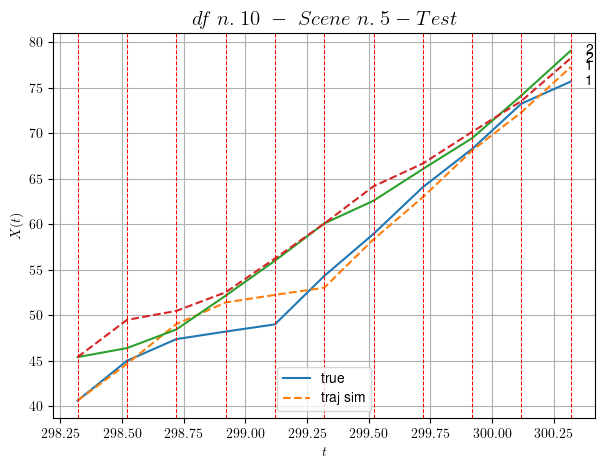

        For scene 5/25:
        * MSE = 2.2142765329529124
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/25


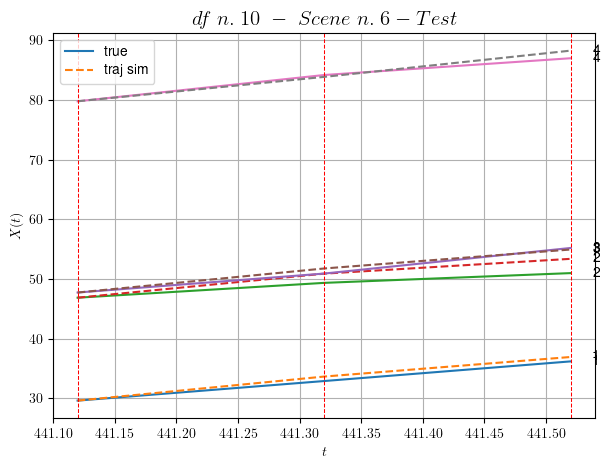

        For scene 6/25:
        * MSE = 0.9779857054062708
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/25


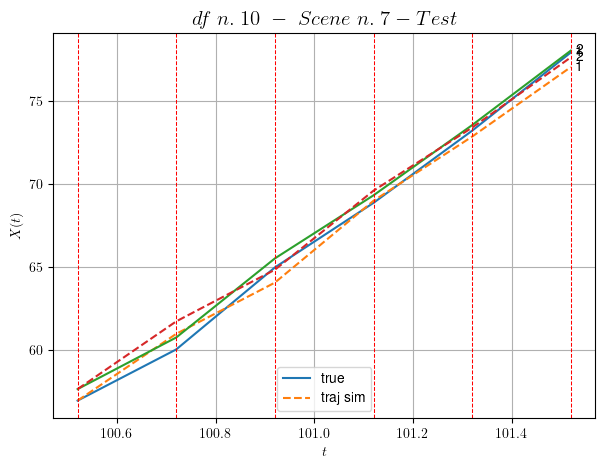

        For scene 7/25:
        * MSE = 0.35971182392205947
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.8/25


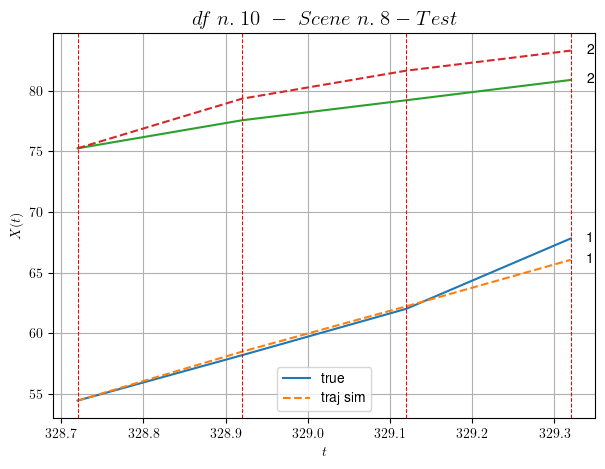

        For scene 8/25:
        * MSE = 2.268245673546096
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.9/25


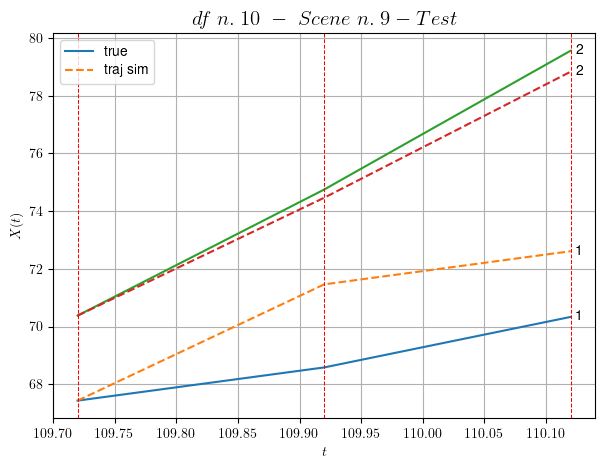

        For scene 9/25:
        * MSE = 2.3473240339088535
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.10/25


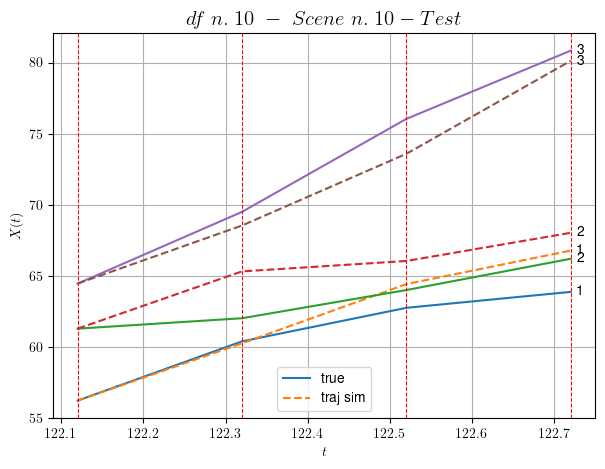

        For scene 10/25:
        * MSE = 3.0922236357426347
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.11/25


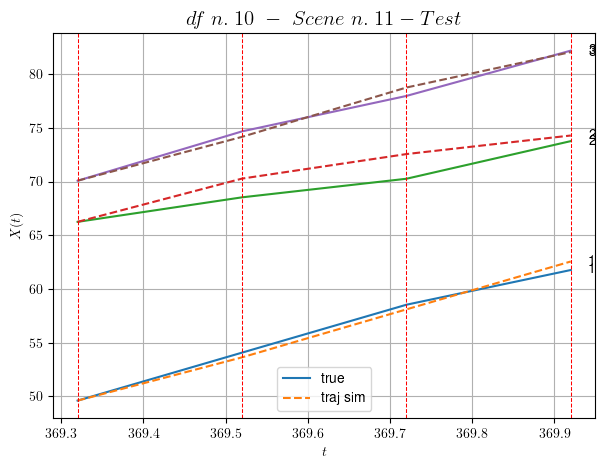

        For scene 11/25:
        * MSE = 0.8755217849338357
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.12/25


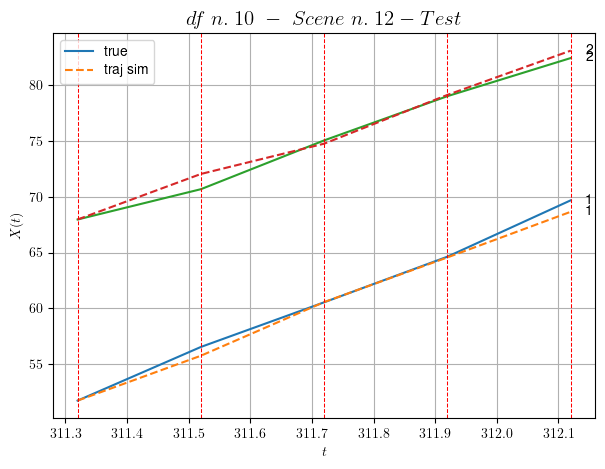

        For scene 12/25:
        * MSE = 0.40932473192351587
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.13/25


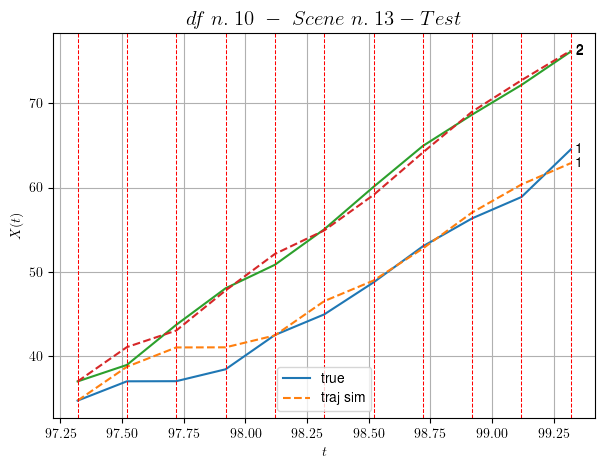

        For scene 13/25:
        * MSE = 1.9377579226543034
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.14/25


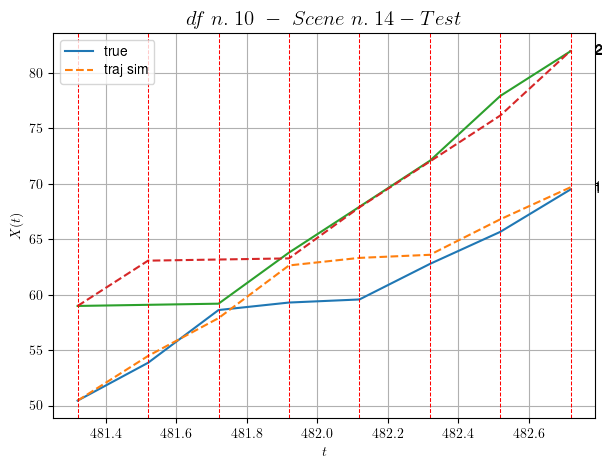

        For scene 14/25:
        * MSE = 3.9581890111698876
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.15/25


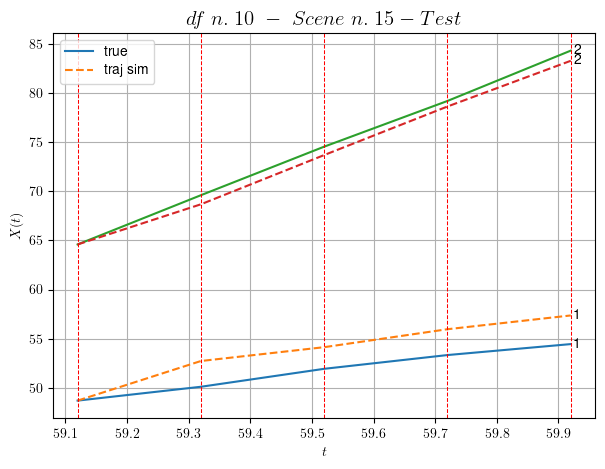

        For scene 15/25:
        * MSE = 3.0089840682101348
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.16/25


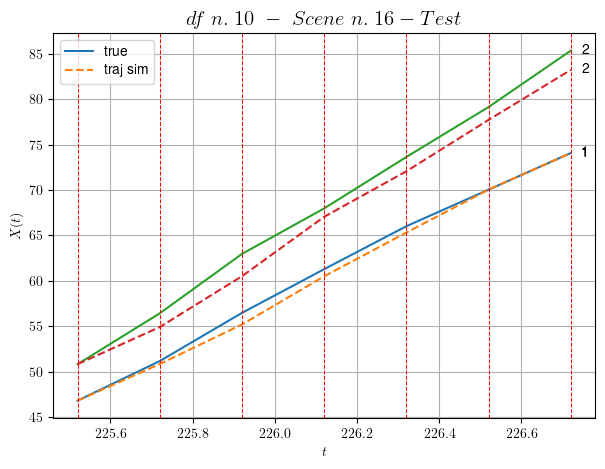

        For scene 16/25:
        * MSE = 1.5005604904149386
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.17/25


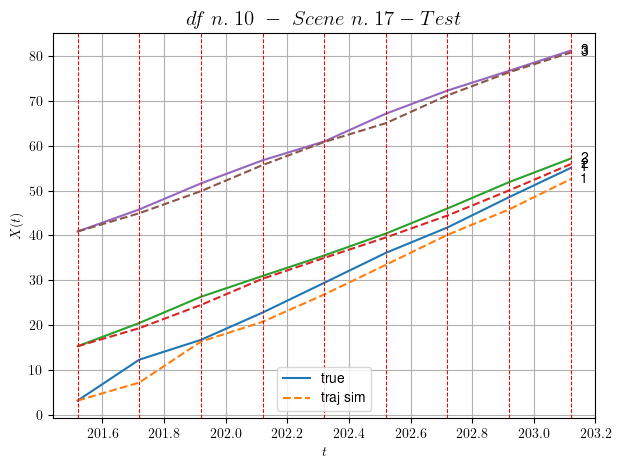

        For scene 17/25:
        * MSE = 3.155552587718379
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.18/25


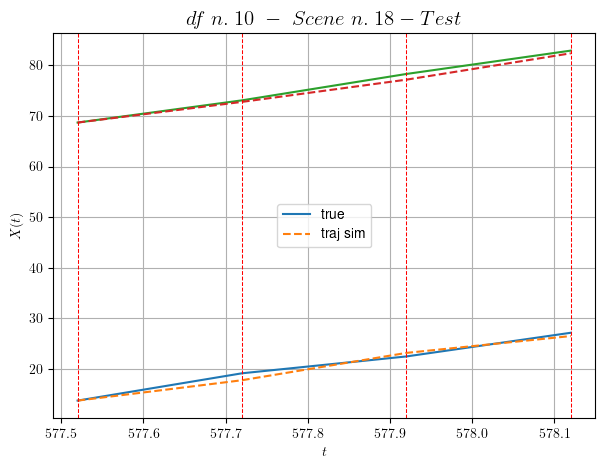

        For scene 18/25:
        * MSE = 0.5544918781118371
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.19/25


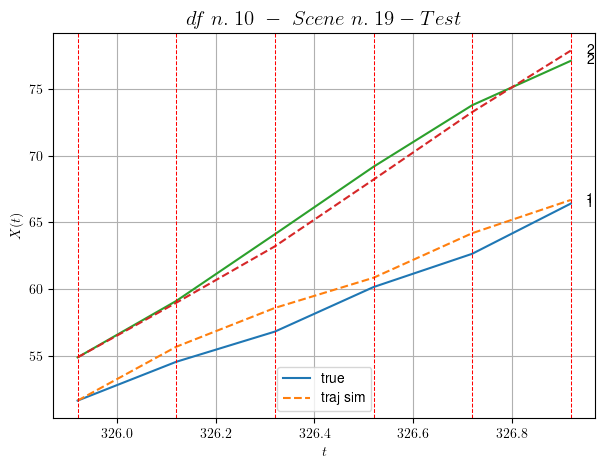

        For scene 19/25:
        * MSE = 0.8290200169170758
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.20/25


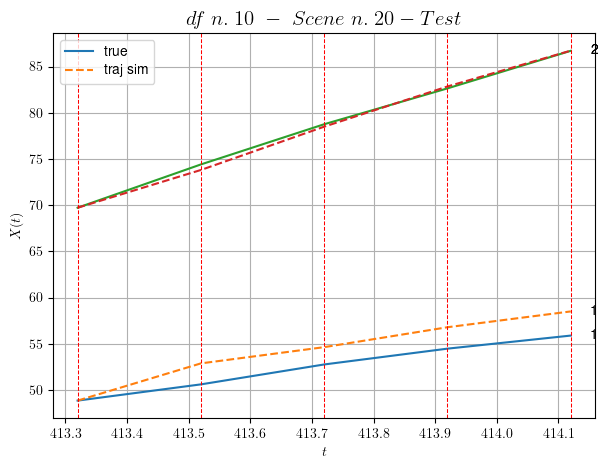

        For scene 20/25:
        * MSE = 2.135226419539679
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.21/25


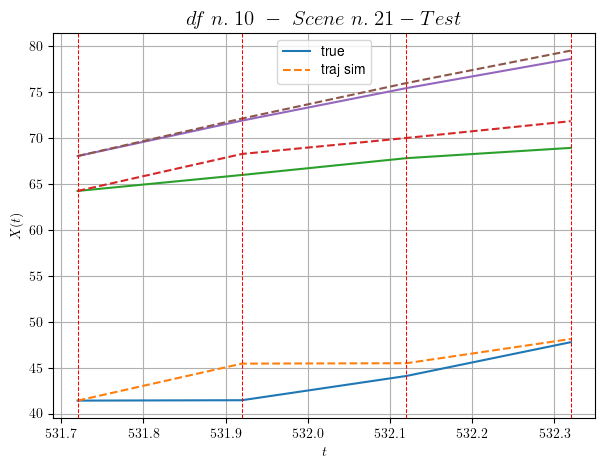

        For scene 21/25:
        * MSE = 3.1359033138071926
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.22/25


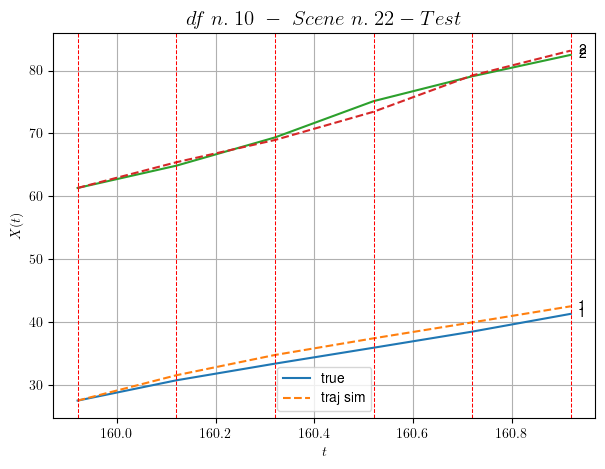

        For scene 22/25:
        * MSE = 1.0133148111469217
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.23/25


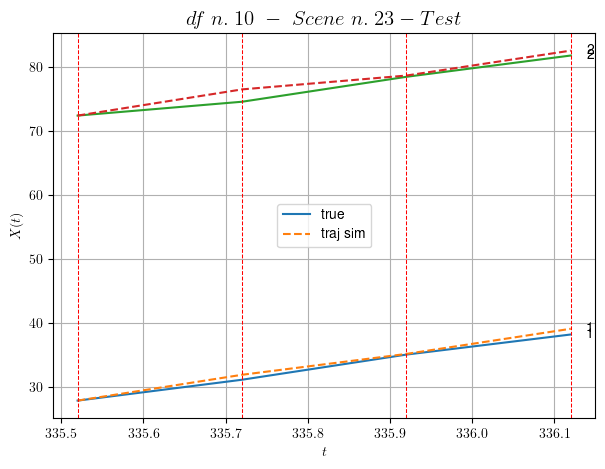

        For scene 23/25:
        * MSE = 0.717492539425171
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.24/25


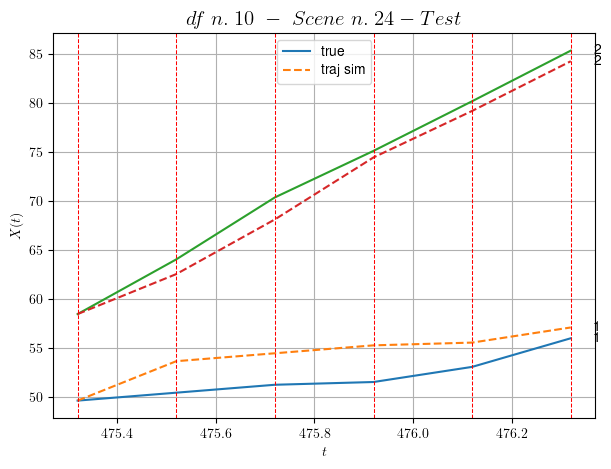

        For scene 24/25:
        * MSE = 4.340409172791402
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.25/25


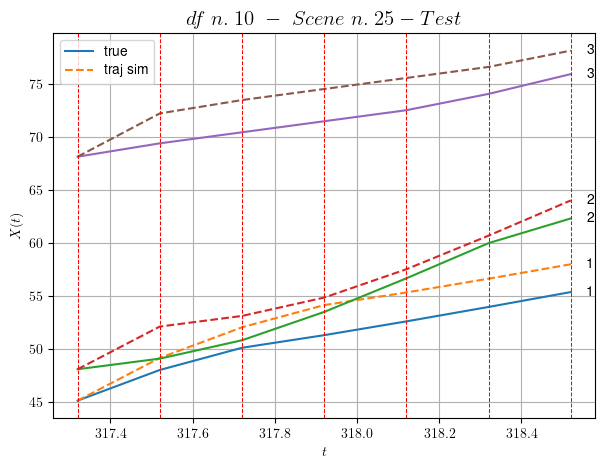

        For scene 25/25:
        * MSE = 4.86104014715328
----------------------------------------------------------------------------------------------------


MSE test: 2.1090454177760325

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.7094412502852105
          * MSE test: 2.1090454177760325
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -






In [6]:
info_nn, model_trained = solve_nn_dataset(dataset, DOE, v0, processed_flag, NUM_ITER, LEARNING_RATE_v0,
                                           test, plot_flag)

In [7]:
get_stats(model_trained)


-------------------- Model Summary --------------------
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Hidden-Layer-1 (Dense)      (None, 1)                 2         
                                                                 
 Hidden-Layer-2 (Dense)      (None, 1)                 2         
                                                                 
 Output-Layer (Dense)        (None, 1)                 1         
                                                                 
Total params: 5 (20.00 Byte)
Trainable params: 5 (20.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________

-------------------- Weights and Biases --------------------
Layer:  Hidden-Layer-1
  --Kernels (Weights): 
[[-15.644927]]
  --Biases: 
[2.9789898]

Layer:  Hidden-Layer-2
  --Kernels (Weights): 
[[-2.2508829]]
  --Biases: 
[4.392

## Plot

### Leading velocity $v_{0}$

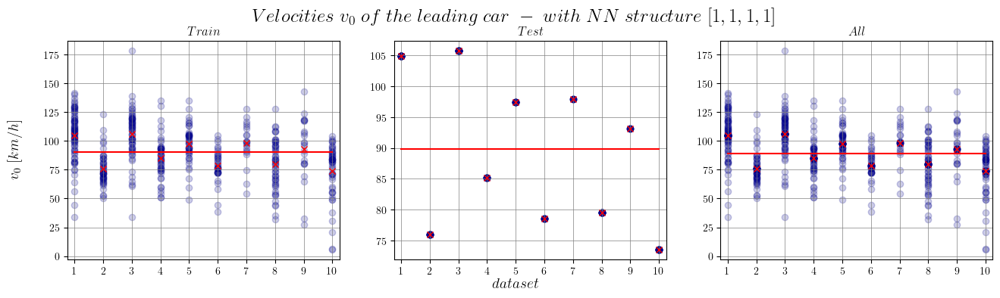

In [8]:
# Initialize the fig
nrow, ncol = 1, 3
width, height = 7, 5 # single subplot
fig, axes = plt.subplots(nrow,ncol,figsize=(width*ncol*.75,height*.75))

ms2kmh = 3.6

info_train = info_nn[info_nn["type"] == "train"]
info_test = info_nn[info_nn["type"] == "test"]
info_grouped = info_nn.groupby(['N. file', 'type']).mean(numeric_only=True)
info_grouped2 = info_nn.groupby(['N. file']).mean(numeric_only=True)
info_avg = info_nn.groupby(['type']).mean(numeric_only=True)

# For each scene, plot v0 mean
for _, scn in info_train.iterrows():
    axes[0].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');
    
for _, scn in info_test.iterrows():
    axes[1].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# Avg value
for (nf,typef), infof in info_grouped.iterrows():
    
    if typef == "train":
        axes[0].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")
        
    if typef == "test":
        axes[1].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")

# For each scene, plot v0 mean
for _, scn in info_nn.iterrows():
    axes[2].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
for nf, p in info_grouped2.iterrows():
    axes[2].plot(nf, p['v0']*ms2kmh, color = 'r', marker="x")

# Plot v0 mean over all dfs
alldfs = [a for a, _ in info_nn.groupby('N. file')]
v0_mean = np.mean([ infof['v0']*ms2kmh for _, infof in info_grouped.iterrows()])
axes[0].plot(alldfs, [info_avg['v0']['train']*ms2kmh]*len(alldfs), color = 'r')  
axes[1].plot(alldfs, [info_avg['v0']['test']*ms2kmh]*len(alldfs), color = 'r')  
axes[2].plot(alldfs, [v0_mean]*len(alldfs), color = 'r')  

# labeling     
axes[0].set_title(fr"$Train$",fontsize=12)
axes[1].set_title(fr"$Test$",fontsize=12)
axes[2].set_title(fr"$All$",fontsize=12)
fig.supxlabel(r"$data set$",fontsize=14, y=0.0005)
fig.supylabel(r"$v_{0}\ [km/h]$",fontsize=14, x = 0.075)
plt.suptitle(fr"$Velocities\ v_{0}\ of\ the\ leading\ car\ -\ with\ NN\ structure\ {str(DOE)}$",
             fontsize=18, y=1)

# Setting the values for all axes.
custom_xlim = (0.75,10.25)
custom_xticks = range(1,11)
plt.setp(axes, xlim=custom_xlim, xticks=custom_xticks)

axes[0].grid(color='grey', linestyle='-', linewidth=0.5);
axes[1].grid(color='grey', linestyle='-', linewidth=0.5);
axes[2].grid(color='grey', linestyle='-', linewidth=0.5);

plt.show()

### Test 1: `cons_dis` vs `velocities`

In [9]:
Nx = 10
Nt = 100
T = 0.5

In [10]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [11]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

In [12]:
y_pred

<tf.Tensor: shape=(9, 1), dtype=float32, numpy=
array([[ 4.2152376],
       [19.448586 ],
       [ 7.03424  ],
       [19.702965 ],
       [ 9.402333 ],
       [ 2.119559 ],
       [14.416383 ],
       [ 3.0993602],
       [17.549429 ]], dtype=float32)>

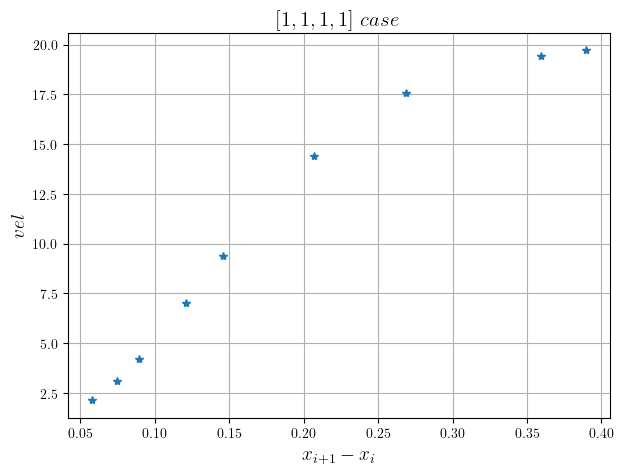

In [13]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

### Test 2: `cons_dis` vs `velocities`

In [14]:
Nx = 100
Nt = 100
T = 0.5

In [15]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [16]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

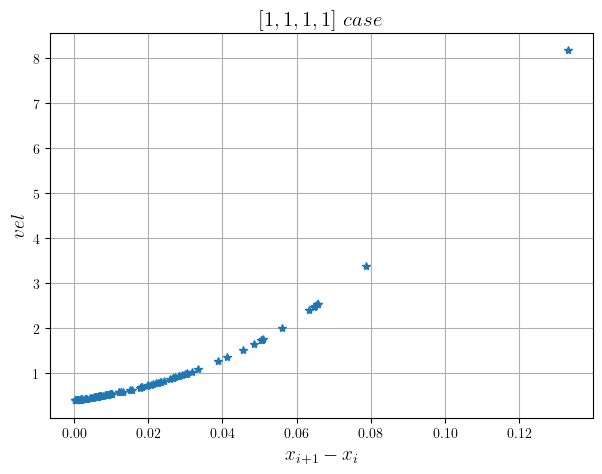

In [17]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

## Prepare the out dir

In [18]:
# Create the directory..
if flag_save:
    
    df_seen = [df['N. file'][0] for df in dataset]
    df_seen_str = '-'.join(str(x) for x in df_seen)
    
    # Create directory where to save the image
    now = datetime.now() 
    d = now.strftime(f"%Y-%m-%d_%H-%M-%S_df{df_seen_str}_{NUM_ITER}it-PRE-nn{str(DOE)}")
    
    path = 'out/' + d
    os.mkdir(path)
    
    # Save the solution in a file
    namefile = '/info_nn.txt'

    with open(path + namefile, 'w') as output:
        info_nn.to_csv(path + namefile, sep=',', index=False)
        
    # Save model in a file
    namefile_model = '/model_nn.keras'
    model_trained.compile(optimizer='SGD', loss='MAE')
    model_trained.save(path + namefile_model)  # The file needs to end with the .keras extension